<a href="https://colab.research.google.com/github/ReeNaeem/Deep-Clustering-MSC/blob/Version-History/Masters_DeepClustering_DCEC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

GDrive connect

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [ ]:
!pip install --upgrade mne

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 65.1 MB/s eta 0:00:00


In [ ]:
!pip install tensorflow-probability

In [ ]:
import keras
import tensorflow as tf


print(keras.__version__)
print(tf.__version__)

3.5.0
2.17.1


#1

In [ ]:
from datetime import datetime
start_time = datetime.now()

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

from mne.io import read_raw_bdf
import pandas as pd
import mne
import numpy as np
import scipy.io
from matplotlib import pyplot as plt
from matplotlib import ticker
# import plotly.plotly as py
import numpy as np
import os
from scipy.io import loadmat
import scipy.io
import math as m
from scipy.interpolate import griddata
import random
import math

#2

In [ ]:
person=2
def readDataset(verbose=False):

  raw = mne.io.read_raw_bdf('/content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf', preload=True)
  #print(raw)
  #print(raw.info)
  print(raw._data.shape)
  rawDataset = raw.copy()
  ch_names= ['EXG1', 'EXG2', 'EXG3', 'EXG4', 'EXG5', 'EXG6', 'EXG7', 'EXG8','Status']
  rawDataset=rawDataset.drop_channels(ch_names, on_missing='raise')
  #rawDatasetForMontageLocation=rawDataset.copy()

  channelNames = ['Fp1', 'AF3', 'F7', 'F3', 'FC1', 'FC5', 'T7', 'C3', 'CP1', 'CP5', 'P7',
          'P3', 'Pz', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'P4', 'P8', 'CP6', 'CP2',
          'C4', 'T8', 'FC6', 'FC2', 'F4', 'F8', 'AF4', 'Fp2', 'Fz', 'Cz']

  montage = mne.channels.make_standard_montage('biosemi32')


  info = mne.create_info(ch_names=channelNames, sfreq=128, ch_types='eeg')
  info.set_montage(montage)


  #A bandpass frequency filter from 4.0-45.0Hz was applied.
  rawDataset.filter(0.1, 50., fir_design='firwin')


  #pre-process data
  #downsampling to 128
  rawDataset = rawDataset.resample(sfreq=128)

  # use the average of all channels as reference
  rawDatasetReReferenced = rawDataset.copy().set_eeg_reference(ref_channels='average')
  rawDatasetForMontageLocation=rawDatasetReReferenced.copy()



  transposedDataset = np.transpose(rawDatasetReReferenced._data)
  print ("Length of data: {}".format(len(transposedDataset)))


  if (verbose):
    rawDataset.plot()
    rawDatasetReReferenced.plot()

  if (verbose):
    for i in range(10):
      randomIndex = random.randint(0,len(transposedDataset))
      print ("Random index: {}".format(randomIndex))
      fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(5,3), gridspec_kw = {'wspace':0, 'hspace':0.2})
      sampleUnderAnalysis = transposedDataset[randomIndex,:]
      #print (sampleUnderAnalysis)

      ax = axes
      ax.title.set_text('raw dataset')
      im,_ = mne.viz.topomap.plot_topomap(sampleUnderAnalysis,info,names=channelNames,axes=ax,cmap='Spectral_r',show=False)
      #ax.axis('off')

      plt.show()

  return transposedDataset,rawDatasetForMontageLocation

# All functions for converting 3D coordinates to 2D and reading the channel location
rawDataset,rawDatasetForMontageLocation= readDataset(verbose=False)
rawDatasetForMontageLocation.set_montage('biosemi32')
MontageChannelLocation=rawDatasetForMontageLocation.info['dig']

#initialisation for all required variables.
rawDatasetForMontageLocation.set_montage('biosemi32')
MontageChannelLocation=rawDatasetForMontageLocation.info['dig']
sfreq=128
NumberOfEEGChannel=32
lengthOfTopographicMap=40
StartingSamplePoint= 0
EndSamplePoint= rawDataset.shape[0]-1
EndSamplePoint= 24567
NumberOfTopomapsGenerating=EndSamplePoint-StartingSamplePoint

def getChannelNames():
  channelNames = ['Fp1', 'AF3', 'F7', 'F3', 'FC1', 'FC5', 'T7', 'C3', 'CP1', 'CP5', 'P7',
        'P3', 'Pz', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'P4', 'P8', 'CP6', 'CP2',
        'C4', 'T8', 'FC6', 'FC2', 'F4', 'F8', 'AF4', 'Fp2', 'Fz', 'Cz']
  return channelNames

def getChannellInfoForSample (channelNames, channelValues, onlyValues=False):
  i = 0
  channelValuesforCurrentSample = []
  for ch in channelNames:
    chValue = channelValues[i]
    if (onlyValues):
      channelValuesforCurrentSample.append(chValue)
    else:
      channelValuesforCurrentSample.append((ch, chValue))
    i+=1

  return channelValuesforCurrentSample


def azim_proj(pos):
    """
    Computes the Azimuthal Equidistant Projection of input point in 3D Cartesian Coordinates.
    Imagine a plane being placed against (tangent to) a globe. If
    a light source inside the globe projects the graticule onto
    the plane the result would be a planar, or azimuthal, map
    projection.

    :param pos: position in 3D Cartesian coordinates    [x, y, z]
    :return: projected coordinates using Azimuthal Equidistant Projection
    """
    [r, elev, az] = cart2sph(pos[0], pos[1], pos[2])
    return pol2cart(az, m.pi / 2 - elev)


def cart2sph(x, y, z):
    """
    Transform Cartesian coordinates to spherical
    :param x: X coordinate
    :param y: Y coordinate
    :param z: Z coordinate
    :return: radius, elevation, azimuth
    """
    x2_y2 = x**2 + y**2
    r = m.sqrt(x2_y2 + z**2)                    # r     tant^(-1)(y/x)
    elev = m.atan2(z, m.sqrt(x2_y2))            # Elevation
    az = m.atan2(y, x)                          # Azimuth
    return r, elev, az


def pol2cart(theta, rho):
    """
    Transform polar coordinates to Cartesian
    :param theta: angle value
    :param rho: radius value
    :return: X, Y
    """
    #print ('----------')
    #print (rho * m.cos(theta))
    #print (rho * m.sin(theta))
    return rho * m.cos(theta), rho * m.sin(theta)
"""
def get3DCoordinates(rawDatasetForMontageLocation):
    rawDatasetForMontageLocation.set_montage('biosemi32')
    result=rawDatasetForMontageLocation.info['dig']
    result=result[3:]
    location=[]
    for i in range(0,32):

      v=result[i].values()
      values = list(v)
      a=(values[1])*1000
      location.append(a)
    MontageLocation=np.array(location)
    #MontageLocation=trunc(MontageLocation,decs=3)
    MontageLocation= np.round(MontageLocation,1)
    MontageLocation=MontageLocation.tolist()
    return MontageLocation
"""

def getBrainRateForTimeSlice(brainRatesForChannels):
    #return (np.mean(brainRatesForChannels))
    return (np.sum(brainRatesForChannels))

def get3DCoordinates(MontageChannelLocation,EEGChannels):
    MontageChannelLocation=MontageChannelLocation[-EEGChannels:]
    location=[]
    for i in range(0,32):

      v=MontageChannelLocation[i].values()
      values = list(v)
      a=(values[1])*1000
      location.append(a)
    MontageLocation=np.array(location)
    #MontageLocation=trunc(MontageLocation,decs=3)
    MontageLocation= np.round(MontageLocation,1)
    MontageLocation=MontageLocation.tolist()
    return MontageLocation


pos_3d = get3DCoordinates(MontageChannelLocation,NumberOfEEGChannel)
def convert3DTo2D(pos_3d):
  pos_2d = []
  for e in pos_3d:
    pos_2d.append(azim_proj(e))
  return (pos_2d)


Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Length of data: 24576


#3

In [ ]:
# Create topographic map for a specific sample (of 32 channels) #nearest
def createTopographicMapFromChannelValues(channelValues, interpolationMethod = "cubic", verbose=False):
  #retrieve the names of channels
  channelNames = getChannelNames()
  #channelValues=channelValues.transpose(1,0)
  listOfChannelValues = getChannellInfoForSample(channelNames, channelValues, onlyValues=True)
  #print(listOfChannelValues)
  #create an empty (with zeros) topographic map of lengthOfTopographicMap x lengthOfTopographicMap pixels
  emptyTopographicMap = np.array(np.zeros([lengthOfTopographicMap, lengthOfTopographicMap]))
  if (verbose):
    #print the empty topographic map
    plt.imshow(emptyTopographicMap)
    plt.show()

  pos2D=np.array(convert3DTo2D(get3DCoordinates(MontageChannelLocation,NumberOfEEGChannel)))
  #print(pos2D)
  #input()
  grid_x, grid_y = np.mgrid[
                     min(pos2D[:, 0]):max( pos2D[:, 0]):lengthOfTopographicMap*1j,
                     min( pos2D[:, 1]):max( pos2D[:, 1]):lengthOfTopographicMap*1j
                     ]
  #print(grid_x)
  #print(grid_y)
  #Generate edgeless images
  min_x, min_y = np.min(pos2D, axis=0)
  max_x, max_y = np.max(pos2D, axis=0)
  locations = np.append(pos2D, np.array([[min_x, min_y], [min_x, max_y],[max_x, min_y],[max_x, max_y]]),axis=0)
  #channelValuesForSample =channelValues
  #print(locations)
  #input()
  # interpolate edgeless topographic map and show it
  interpolatedTopographicMap = griddata(pos2D, channelValues, (grid_x, grid_y), method=interpolationMethod, fill_value=0)


  #coordinates where the pixel values are zero
  CordinateYellowRegion=np.argwhere(interpolatedTopographicMap == 0.)

  if (verbose):
    i=0
    for chVal in channelValues:
      for x in range (32):
        for y in range (32):
          print ("Trying to find value {} in pixel ({},{}-{})".format(chVal, x, y, interpolatedTopographicMap[x][y] ))
          if (chVal == interpolatedTopographicMap[x][y]):
            print ("Value found at pixel ({}{}) for channel: {}".format(x, y,channelNames[i] ))
      i=i+1

  if (verbose):
    plt.imshow(interpolatedTopographicMap)
    plt.show()

  return interpolatedTopographicMap,CordinateYellowRegion


In [ ]:

def retrieveChannelInfoFromInterpolatedMap(interpolatedMap, CordinateYellowRegion,onlyValues=False):

  pixelCoordinates = get2DTopographicMapChannelIndexes(lengthOfTopographicMap,CordinateYellowRegion)
  channelInfoFromInterpolatedMap = []
  i = 0
  for c in pixelCoordinates:
    x = c[0]
    y = c[1]
    channelValue = interpolatedMap[x][y]
    if (onlyValues):
      channelInfoFromInterpolatedMap.append(channelValue)
    else:
      channelInfoFromInterpolatedMap.append((channelNames[i], channelValue))
    i+=1

  return channelInfoFromInterpolatedMap


# Compute 2D coordinates of pixels in the topographic map, as (x,y coordinates)
def getMatrixIndexesFrom2DPositions(xPos, yPos, minX, minY, maxX, maxY, numChannels, CordinateYellowRegion,verbose=False):

  #rescaling inputs coordinates into specific indexes of a numChannels X numChannels matrix, with min-max normalisation algorithm
  #remove -1 from numChannels because the indexes start with 0
  x = ((xPos - minX) * (numChannels-1 -0) ) / (maxX-minX)
  y = ((yPos - minY) * (numChannels-1 -0) ) / (maxY-minY)

  #round integer to the nearest integer
  indexX = round(x)
  indexY = round(y)


  if [indexX, indexY] not in CordinateYellowRegion.tolist() :
    indexX1, indexY1 = indexX, indexY

  elif (([indexX, indexY+1] not in CordinateYellowRegion.tolist()) and ([indexX, indexY+1] != [indexX,lengthOfTopographicMap])) :
    indexX1, indexY1 = indexX, indexY+1

  elif [indexX, indexY-1] not in CordinateYellowRegion.tolist() :
    indexX1, indexY1 = indexX, indexY-1

  elif (([indexX-1, indexY] not in CordinateYellowRegion.tolist()) and ([indexX-1, indexY] != [-1,indexY])) :
    indexX1, indexY1 = indexX-1, indexY

  else:

    indexX1, indexY1 = indexX+1, indexY

  indexX1, indexY1

  return indexX1, indexY1
  if (verbose):
    print("Tranformed positions: {},  {} - Generated matrix indeces: {}, {}".format(x, y, indexX, indexY))




def get2DTopographicMapChannelIndexes(lengthOfTopographicMap,CordinateYellowRegion):
  pos3D = get3DCoordinates(MontageChannelLocation,NumberOfEEGChannel)
  pos2D = []

  minX, maxX, minY, maxY =0,0,0,0
  for e in pos3D:
    newPos = (azim_proj(e))
    pos2D.append(newPos)

    if (newPos[0]<minX):
      minX = newPos[0]
    if (newPos[1]<minY):
      minY = newPos[1]
    if (newPos[0]>maxX):
      maxX = newPos[0]
    if (newPos[1]>maxY):
      maxY = newPos[1]

  channelLocs = np.array(pos2D)
  xMatrixIndices = []
  yMatrixIndices = []
  coordinates2dWithoutScale = []
  for ch in channelLocs:
    x,y = getMatrixIndexesFrom2DPositions(ch[0], ch[1], minX, minY, maxX, maxY, lengthOfTopographicMap, CordinateYellowRegion,verbose=False)
    xMatrixIndices.append(x)
    yMatrixIndices.append(y)
    coordinates2dWithoutScale.append((x,y))

  return coordinates2dWithoutScale



In [ ]:
#read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset,rawDatasetForMontageLocation = readDataset(verbose=False)

#extract the values of those pixels at the 32 coordinates from an interpolated topographic map
#coordinates2D = get2DTopographicMapChannelIndexes(lengthOfTopographicMap,CordinateYellowRegion)
channelNames = getChannelNames()

listOfTopographicMapsForAE = []
for i in range(StartingSamplePoint,EndSamplePoint):
  #get a random sample and load its 32 values
  channelValuesForCurrentSample = list(rawDataset[i,:])

  #create topographic map
  interpolatedTopographicMap,CordinateYellowRegion = createTopographicMapFromChannelValues(channelValuesForCurrentSample, interpolationMethod="cubic",verbose=False)
  #plt.imshow(interpolatedTopographicMap)
  #plt.show()
  listOfTopographicMapsForAE.append(interpolatedTopographicMap)

#train the autoencoder with listOfTopographicMapsForAE
listOfTopographicMapsForAE=np.array(listOfTopographicMapsForAE)
#np.save('/content/drive/MyDrive/Masters Dataset/Maps/Standard'+str(person),listOfTopographicMapsForAE)


Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Length of data: 24576


#3.5

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mne

# Read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset, rawDatasetForMontageLocation = readDataset(verbose=False)

# Extract the values of those pixels at the 32 coordinates from an interpolated topographic map
channelNames = getChannelNames()

listOfTopographicMapsForAE = []
for i in range(StartingSamplePoint, EndSamplePoint):
    # Get a random sample and load its 32 values
    channelValuesForCurrentSample = list(rawDataset[i, :])

    # Create topographic map
    interpolatedTopographicMap, CordinateYellowRegion = createTopographicMapFromChannelValues(channelValuesForCurrentSample, interpolationMethod="cubic", verbose=False)

    # Set up MNE info object for 32 channels
    n_channels = 32
    sfreq = 1000  # Sampling frequency (arbitrary for topographic visualization)
    ch_names = channelNames[:n_channels]
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')

    # Create an EvokedArray object for plotting
    data_for_mne = np.array(channelValuesForCurrentSample)[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
    evoked = mne.EvokedArray(data_for_mne, info)

    # Get channel positions from the montage
    montage = mne.channels.make_standard_montage('biosemi32')
    ch_pos = montage.get_positions()['ch_pos']

    # Convert channel positions to a NumPy array
    pos = np.array([ch_pos[ch][:2] for ch in ch_names]) # Extract x, y positions for the desired channels

    # Plot the topographic map with a color scale showing min and max values
    #fig, ax = plt.subplots()
    #im, _ = mne.viz.plot_topomap(data_for_mne.flatten(), pos=pos, axes=ax, show=False, cmap='jet') # Use 'pos' instead of 'ch_pos'

    # Create an axis for the color bar and add it
    #cbar_ax = fig.add_axes([0.85, 0.15, 0.03, 0.7])  # [left, bottom, width, height]
    #fig.colorbar(im, cax=cbar_ax)

    # Show the plot
    #plt.title(f"Topographic Map for Sample {i}")
    #plt.show()

    # Append the interpolated topographic map to the list
    listOfTopographicMapsForAE.append(interpolatedTopographicMap)

# Train the autoencoder with listOfTopographicMapsForAE
listOfTopographicMapsForAE = np.array(listOfTopographicMapsForAE)
#np.save('/content/drive/MyDrive/Masters Dataset/Maps/Standard' + str(person), listOfTopographicMapsForAE)


In [ ]:
# Extract the global min and max values across all maps
global_min = np.min(listOfTopographicMapsForAE)
global_max = np.max(listOfTopographicMapsForAE)

print(f"Global Min Value: {global_min}")
print(f"Global Max Value: {global_max}")

Global Min Value: -0.00020293263910059028
Global Max Value: 0.0005466895437634965


#4

### First 100 Maps

Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Length of data: 24576


<ipython-input-21-0489b980ef47>:74: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars


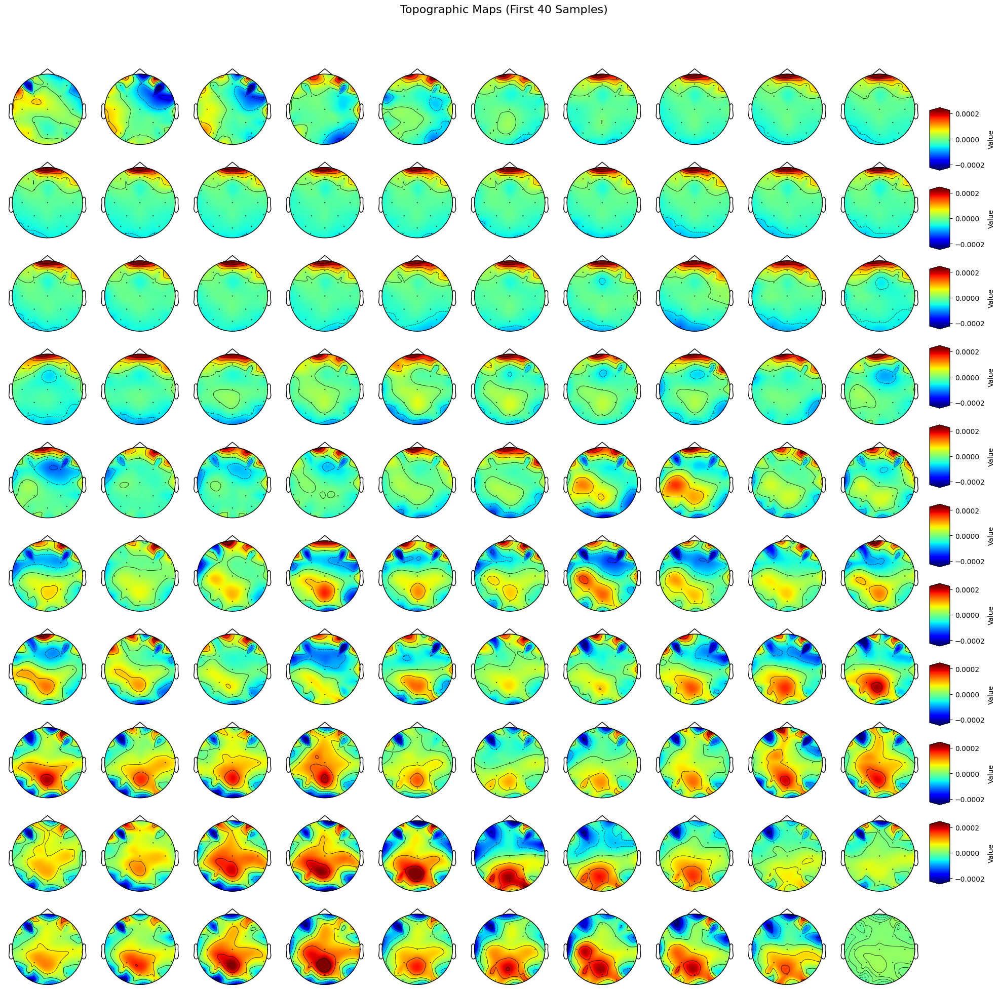

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mne

# Read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset, rawDatasetForMontageLocation = readDataset(verbose=False)

# Extract the values of those pixels at the 32 coordinates from an interpolated topographic map
channelNames = getChannelNames()

# List to store the topographic maps
listOfTopographicMapsForAE = []

# Prepare a grid for displaying the first 40 topographic maps
fig, axes = plt.subplots(10, 10, figsize=(20, 20))
fig.suptitle('Topographic Maps (First 40 Samples)', fontsize=16)

# Keep track of the maximum and minimum values for consistent color bars
vmin, vmax = None, None

for idx, i in enumerate(range(StartingSamplePoint, StartingSamplePoint + 100)):
    # Get the sample and load its 32 values
    channelValuesForCurrentSample = list(rawDataset[i, :])

    # Create topographic map
    interpolatedTopographicMap, CordinateYellowRegion = createTopographicMapFromChannelValues(
        channelValuesForCurrentSample, interpolationMethod="cubic", verbose=False
    )

    # Set up MNE info object for 32 channels
    n_channels = 32
    sfreq = 1000  # Sampling frequency (arbitrary for topographic visualization)
    ch_names = channelNames[:n_channels]
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')

    # Create an EvokedArray object for plotting
    data_for_mne = np.array(channelValuesForCurrentSample)[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
    evoked = mne.EvokedArray(data_for_mne, info)

    # Get channel positions from the montage
    montage = mne.channels.make_standard_montage('biosemi32')
    ch_pos = montage.get_positions()['ch_pos']

    # Convert channel positions to a NumPy array
    pos = np.array([ch_pos[ch][:2] for ch in ch_names])  # Extract x, y positions for the desired channels

    # Plot the topographic map in the grid
    ax = axes.flat[idx]
    im, _ = mne.viz.plot_topomap(data_for_mne.flatten(), pos=pos, axes=ax, show=False, cmap='jet')  # Use 'pos' instead of 'ch_pos'

    # Hide axes for a cleaner grid display
    ax.axis('off')

    # Update vmin and vmax for consistent color bars across the row
    if vmin is None or vmax is None:
        vmin, vmax = im.get_clim()
    else:
        current_vmin, current_vmax = im.get_clim()
        vmin = min(vmin, current_vmin)
        vmax = max(vmax, current_vmax)

# Add a color bar at the end of each row
for row in range(10):
    cbar_ax = fig.add_axes([
        axes[row, -1].get_position().x1 + 0.02,  # x position (to the right of the last column)
        axes[row, 0].get_position().y0,          # y position (aligned with the row)
        0.02,                                    # width of the color bar
        axes[row, 0].get_position().height       # height of the color bar
    ])
    fig.colorbar(im, cax=cbar_ax, orientation='vertical', label='Value', extend='both')
    im.set_clim(vmin, vmax)  # Ensure consistent scale across the row

plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars
plt.show()



###First 1000 maps

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mne

# Read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset, rawDatasetForMontageLocation = readDataset(verbose=False)

# Extract the values of those pixels at the 32 coordinates from an interpolated topographic map
channelNames = getChannelNames()

# List to store the topographic maps
listOfTopographicMapsForAE = []

# Prepare a grid for displaying the first 40 topographic maps
fig, axes = plt.subplots(100, 10, figsize=(200, 200))
fig.suptitle('Topographic Maps (First 1000 Samples)', fontsize=16)

# Keep track of the maximum and minimum values for consistent color bars
vmin, vmax = None, None

for idx, i in enumerate(range(StartingSamplePoint, StartingSamplePoint + 1000)):
    # Get the sample and load its 32 values
    channelValuesForCurrentSample = list(rawDataset[i, :])

    # Create topographic map
    interpolatedTopographicMap, CordinateYellowRegion = createTopographicMapFromChannelValues(
        channelValuesForCurrentSample, interpolationMethod="cubic", verbose=False
    )

    # Set up MNE info object for 32 channels
    n_channels = 32
    sfreq = 1000  # Sampling frequency (arbitrary for topographic visualization)
    ch_names = channelNames[:n_channels]
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')

    # Create an EvokedArray object for plotting
    data_for_mne = np.array(channelValuesForCurrentSample)[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
    evoked = mne.EvokedArray(data_for_mne, info)

    # Get channel positions from the montage
    montage = mne.channels.make_standard_montage('biosemi32')
    ch_pos = montage.get_positions()['ch_pos']

    # Convert channel positions to a NumPy array
    pos = np.array([ch_pos[ch][:2] for ch in ch_names])  # Extract x, y positions for the desired channels

    # Plot the topographic map in the grid
    ax = axes.flat[idx]
    im, _ = mne.viz.plot_topomap(data_for_mne.flatten(), pos=pos, axes=ax, show=False, cmap='jet')  # Use 'pos' instead of 'ch_pos'

    # Hide axes for a cleaner grid display
    ax.axis('off')

    # Update vmin and vmax for consistent color bars across the row
    if vmin is None or vmax is None:
        vmin, vmax = im.get_clim()
    else:
        current_vmin, current_vmax = im.get_clim()
        vmin = min(vmin, current_vmin)
        vmax = max(vmax, current_vmax)

# Add a color bar at the end of each row
for row in range(100):
    cbar_ax = fig.add_axes([
        axes[row, -1].get_position().x1 + 0.02,  # x position (to the right of the last column)
        axes[row, 0].get_position().y0,          # y position (aligned with the row)
        0.02,                                    # width of the color bar
        axes[row, 0].get_position().height       # height of the color bar
    ])
    fig.colorbar(im, cax=cbar_ax, orientation='vertical', label='Value', extend='both')
    im.set_clim(vmin, vmax)  # Ensure consistent scale across the row

plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars
plt.show()



Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Length of data: 24576


<ipython-input-30-c77c710731f7>:74: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars


### Random 100

Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Length of data: 24576


<ipython-input-10-5f770e2364d0>:78: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars


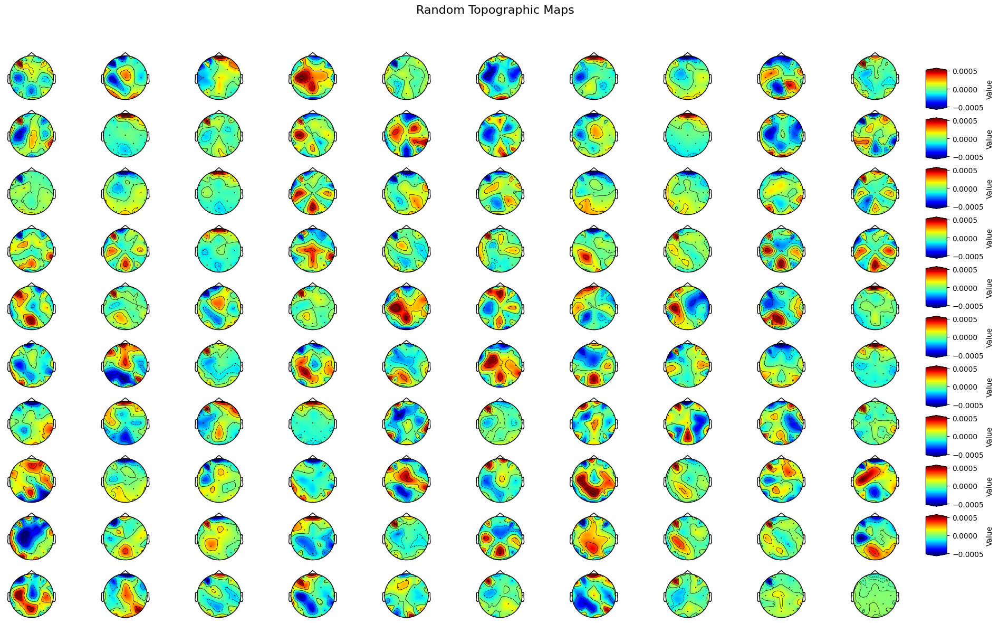

In [ ]:
import random
import numpy as np
import matplotlib.pyplot as plt
import mne

# Read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset, rawDatasetForMontageLocation = readDataset(verbose=False)

# Extract the values of those pixels at the 32 coordinates from an interpolated topographic map
channelNames = getChannelNames()

# List to store the topographic maps
listOfTopographicMapsForAE = []

# Generate 20 random samples within the specified range
randomSampleIndices = random.sample(range(StartingSamplePoint, EndSamplePoint), 100)

# Prepare a grid for displaying 20 topographic maps
fig, axes = plt.subplots(10, 10, figsize=(20, 12))
fig.suptitle('Random Topographic Maps', fontsize=16)

# Keep track of the maximum and minimum values for consistent color bars
vmin, vmax = None, None

for idx, i in enumerate(randomSampleIndices):
    # Get a random sample and load its 32 values
    channelValuesForCurrentSample = list(rawDataset[i, :])

    # Create topographic map
    interpolatedTopographicMap, CordinateYellowRegion = createTopographicMapFromChannelValues(
        channelValuesForCurrentSample, interpolationMethod="cubic", verbose=False
    )

    # Set up MNE info object for 32 channels
    n_channels = 32
    sfreq = 1000  # Sampling frequency (arbitrary for topographic visualization)
    ch_names = channelNames[:n_channels]
    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')

    # Create an EvokedArray object for plotting
    data_for_mne = np.array(channelValuesForCurrentSample)[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
    evoked = mne.EvokedArray(data_for_mne, info)

    # Get channel positions from the montage
    montage = mne.channels.make_standard_montage('biosemi32')
    ch_pos = montage.get_positions()['ch_pos']

    # Convert channel positions to a NumPy array
    pos = np.array([ch_pos[ch][:2] for ch in ch_names])  # Extract x, y positions for the desired channels

    # Plot the topographic map in the grid
    ax = axes.flat[idx]
    im, _ = mne.viz.plot_topomap(data_for_mne.flatten(), pos=pos, axes=ax, show=False, cmap='jet')  # Use 'pos' instead of 'ch_pos'

    # Hide axes for a cleaner grid display
    ax.axis('off')

    # Update vmin and vmax for consistent color bars across the row
    if vmin is None or vmax is None:
        vmin, vmax = im.get_clim()
    else:
        current_vmin, current_vmax = im.get_clim()
        vmin = min(vmin, current_vmin)
        vmax = max(vmax, current_vmax)

# Add a color bar at the end of each row
for row in range(10):
    cbar_ax = fig.add_axes([
        axes[row, -1].get_position().x1 + 0.02,  # x position (to the right of the last column)
        axes[row, 0].get_position().y0,          # y position (aligned with the row)
        0.02,                                    # width of the color bar
        axes[row, 0].get_position().height       # height of the color bar
    ])
    fig.colorbar(im, cax=cbar_ax, orientation='vertical', label='Value', extend='both')
    im.set_clim(vmin, vmax)  # Ensure consistent scale across the row

plt.tight_layout(rect=[0, 0, 0.92, 0.95])  # Adjust rect to leave space for color bars
plt.show()


### Histogram of Pixel Values

Extracting EDF parameters from /content/drive/MyDrive/Masters Dataset/ds002778/sub-hc1/ses-hc/eeg/sub-hc1_ses-hc_task-rest_eeg.bdf...
BDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 98303  =      0.000 ...   191.998 secs...
(41, 98304)
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 16897 samples (33.002 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


Length of data: 24576


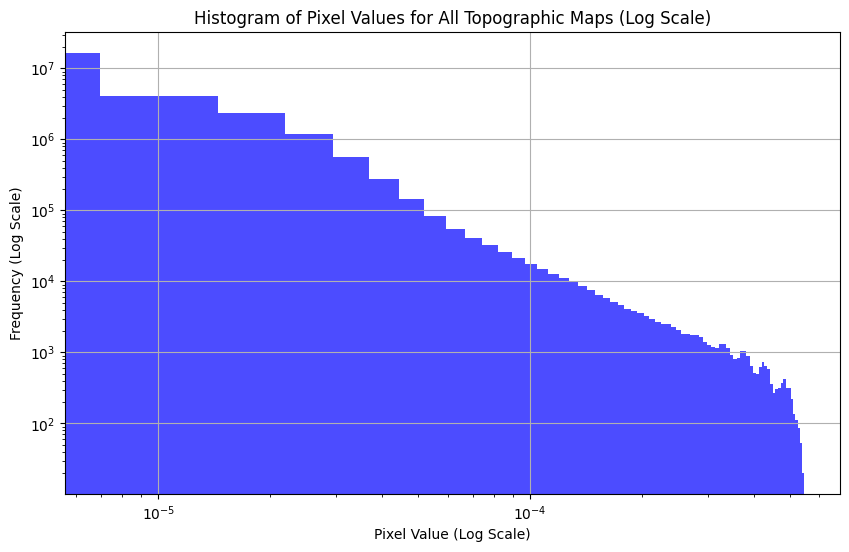

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Read dataset and generate Topographic Maps to train the autoencoder with listOfTopographicMapsForAE
rawDataset, rawDatasetForMontageLocation = readDataset(verbose=False)

# Extract the values of those pixels at the 32 coordinates from an interpolated topographic map
channelNames = getChannelNames()

listOfTopographicMapsForAE = []
for i in range(StartingSamplePoint, EndSamplePoint):
    # Get a random sample and load its 32 values
    channelValuesForCurrentSample = list(rawDataset[i, :])

    # Create topographic map
    interpolatedTopographicMap, CordinateYellowRegion = createTopographicMapFromChannelValues(channelValuesForCurrentSample, interpolationMethod="cubic", verbose=False)
    listOfTopographicMapsForAE.append(interpolatedTopographicMap)

# Convert list of topographic maps to a numpy array
listOfTopographicMapsForAE = np.array(listOfTopographicMapsForAE)

# Flatten all the pixel values from all topographic maps to create a histogram
flattened_pixel_values = listOfTopographicMapsForAE.flatten()

# Plot a histogram of the pixel values
plt.figure(figsize=(10, 6))
plt.hist(flattened_pixel_values, bins=100, color='blue', alpha=0.7)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Pixel Value (Log Scale)')
plt.ylabel('Frequency (Log Scale)')
plt.title('Histogram of Pixel Values for All Topographic Maps (Log Scale)')
plt.grid(True)
plt.show()

# Optionally save the numpy array for future use
# np.save('/content/drive/MyDrive/Masters Dataset/Maps/Standard' + str(person), listOfTopographicMapsForAE)


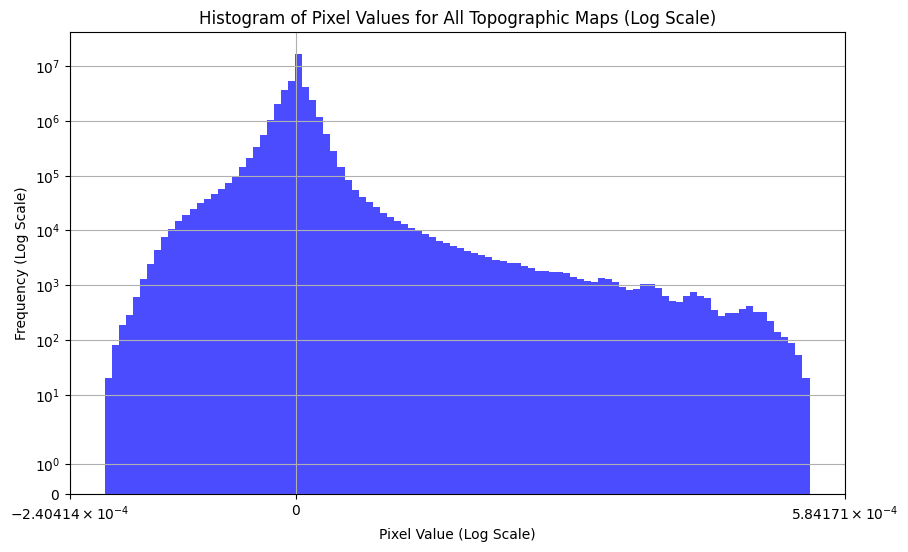

In [ ]:
# Plot a histogram of the pixel values
plt.figure(figsize=(10, 6))
plt.hist(flattened_pixel_values, bins=100, color='blue', alpha=0.7)
plt.xscale('symlog')
plt.yscale('symlog')
plt.xlabel('Pixel Value (Log Scale)')
plt.ylabel('Frequency (Log Scale)')
plt.title('Histogram of Pixel Values for All Topographic Maps (Log Scale)')
plt.grid(True)
plt.show()

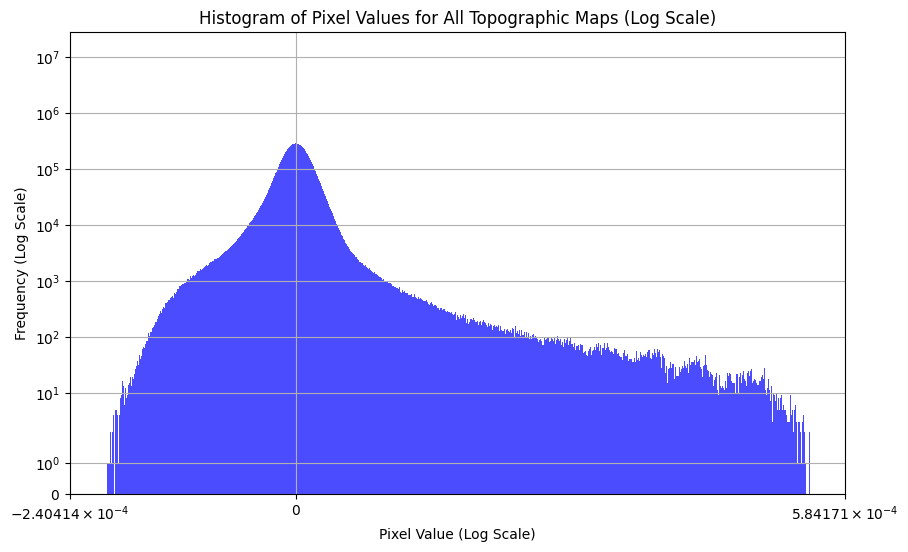

In [ ]:
# Plot a histogram of the pixel values
plt.figure(figsize=(10, 6))
plt.hist(flattened_pixel_values, bins=2000, color='blue', alpha=0.7)
plt.xscale('symlog')
plt.yscale('symlog')
plt.xlabel('Pixel Value (Log Scale)')
plt.ylabel('Frequency (Log Scale)')
plt.title('Histogram of Pixel Values for All Topographic Maps (Log Scale)')
plt.grid(True)
plt.show()

In [ ]:
from scipy.stats import shapiro, normaltest, mannwhitneyu, wilcoxon, kruskal, spearmanr

# Test for normality using the Shapiro-Wilk test
shapiro_test_stat, shapiro_p_value = shapiro(flattened_pixel_values)
print("Shapiro-Wilk Test:")
print(f"Test Statistic: {shapiro_test_stat}, p-value: {shapiro_p_value}")

# Test for normality using the D'Agostino and Pearson's test
dagostino_test_stat, dagostino_p_value = normaltest(flattened_pixel_values)
print("D'Agostino and Pearson's Test:")
print(f"Test Statistic: {dagostino_test_stat}, p-value: {dagostino_p_value}")

# Non-Parametric tests
# need two groups to compare, so I split the dataset into two halves
midpoint = len(flattened_pixel_values) // 2
sample1 = flattened_pixel_values[:midpoint]
sample2 = flattened_pixel_values[midpoint:]

# Mann-Whitney U Test (comparing two independent samples)
mannwhitney_stat, mannwhitney_p_value = mannwhitneyu(sample1, sample2, alternative='two-sided')
print("Mann-Whitney U Test:")
print(f"Test Statistic: {mannwhitney_stat}, p-value: {mannwhitney_p_value}")

# Wilcoxon Signed-Rank Test (comparing two related samples)
# Using only the first 1000 values to make samples of equal length
wilcoxon_stat, wilcoxon_p_value = wilcoxon(sample1[:1000], sample2[:1000])
print("Wilcoxon Signed-Rank Test:")
print(f"Test Statistic: {wilcoxon_stat}, p-value: {wilcoxon_p_value}")

# Kruskal-Wallis H Test (comparing more than two independent samples)
kruskal_stat, kruskal_p_value = kruskal(sample1, sample2)
print("Kruskal-Wallis H Test:")
print(f"Test Statistic: {kruskal_stat}, p-value: {kruskal_p_value}")

# Spearman Rank Correlation (measuring correlation between two variables)
spearman_corr, spearman_p_value = spearmanr(sample1, sample2)
print("Spearman Rank Correlation:")
print(f"Correlation Coefficient: {spearman_corr}, p-value: {spearman_p_value}")

/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 39307200.
  res = hypotest_fun_out(*samples, **kwds)


Shapiro-Wilk Test:
Test Statistic: 0.6839086379460585, p-value: 4.410007161373848e-185
D'Agostino and Pearson's Test:
Test Statistic: 36334578.72507025, p-value: 0.0
Mann-Whitney U Test:
Test Statistic: 192407870109575.5, p-value: 4.001903229708299e-94
Wilcoxon Signed-Rank Test:
Test Statistic: 187834.0, p-value: 3.3338705431097005e-05
Kruskal-Wallis H Test:
Test Statistic: 423.6073738208653, p-value: 4.001903262861534e-94
Spearman Rank Correlation:
Correlation Coefficient: 0.039999974857034104, p-value: 0.0


#4 Image Reconstruction model

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_69            │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_96 (Conv2D)        │ (None, 20, 20, 32)     │            544 │ input_layer_69[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_96            │ (None, 20, 20, 32)     │              0 │ conv2d_96[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_97 (Conv2D)        │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_96[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_97            │ (None, 10, 10, 64)     │              0 │ conv2d_97[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_98 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_97[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_98            │ (None, 5, 5, 128)      │              0 │ conv2d_98[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_25 (Flatten)      │ (None, 3200)           │              0 │ leaky_re_lu_98[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_71 (Dense)          │ (None, 40)             │        128,040 │ flatten_25[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_72 (Dense)          │ (None, 40)             │        128,040 │ flatten_25[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_25 (Lambda)        │ (None, 40)             │              0 │ dense_71[0][0],        │
│                           │                        │                │ dense_72[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 420,656 (1.60 MB)

 Trainable params: 420,656 (1.60 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_70 (InputLayer)          │ (None, 40)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_73 (Dense)                     │ (None, 3200)                │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_21 (Reshape)                 │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_84                  │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_85                  │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_87                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525,633 (2.01 MB)

 Trainable params: 525,633 (2.01 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_69 (InputLayer)          │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 40), (None, 40),    │         420,656 │
│                                      │ (None, 40)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         525,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 946,289 (3.61 MB)

 Trainable params: 946,289 (3.61 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 0.0067 - mmd_loss: 0.0013 - nll_loss: 0.0053 - val_loss: 0.0013 - val_mmd_loss: 9.7859e-04 - val_nll_loss: 3.6676e-04
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0012 - mmd_loss: 9.4295e-04 - nll_loss: 2.8606e-04 - val_loss: 0.0010 - val_mmd_loss: 9.2047e-04 - val_nll_loss: 1.1951e-04
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0010 - mmd_loss: 9.3413e-04 - nll_loss: 1.0873e-04 - val_loss: 0.0010 - val_mmd_loss: 9.3595e-04 - val_nll_loss: 8.6468e-05
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 9.9858e-04 - mmd_loss: 9.2135e-04 - nll_loss: 7.7232e-05 - val_loss: 9.7074e-04 - val_mmd_loss: 9.1523e-04 - val_nll_loss: 5.6447e-05
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 9.8296e-04 - mmd_loss: 9.2717e-04 - nll_loss: 5.5784e-05 - val_loss: 9.5630e-04 - val_mmd_loss: 9.1452e-04 - val_nll_loss: 4.2722e-05
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - 

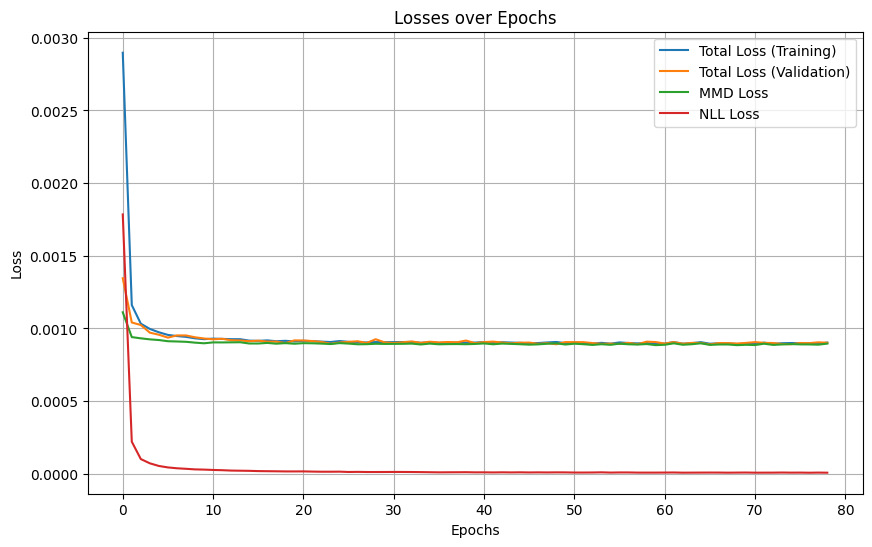

In [ ]:

dimension=[40]
#dimension=[2]
for i in dimension:
    import numpy as np
    import pandas as pd
    from matplotlib import pyplot as plt
    import math, os
    import tensorflow as tf
    from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
    from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten,Lambda
    from tensorflow.keras.models import Model
    from keras.utils import plot_model
    import pdb
    from tensorflow.keras import backend as K
    from tensorflow.keras.datasets import mnist
    from tensorflow.keras.callbacks import  EarlyStopping
    from skimage import metrics
    from sklearn.metrics import mean_absolute_error
    from sklearn.model_selection import train_test_split
    from scipy import stats
    import csv

    #Set parameters
    z_dim = i
    epoch = 200
    batch_size = 32

    #raw=np.load('testdata.npy')
    raw=listOfTopographicMapsForAE
    raw.shape

    train_ratio = 0.7
    val_ratio = 0.15
    test_ratio = 0.15

    #Normalise the data
    dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
    dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

    # First split: 70% training and 30% remaining (to be split into validation and test)
    data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

    # Second split: 15% validation and 15% testing from the remaining 30%
    data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
    #data_train.shape,data_test.shape,data_val.shape

    # Flatten the data to make it easier to compute Z-scores
    #data_train_flat = data_train.reshape(data_train.shape[0], -1)

    # Calculate Z-scores
    #z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

    # Set a Z-score threshold (e.g., 3)
    #threshold = 3

    # Identify outliers
    #outliers = np.where(z_scores > threshold)

    # Filter out the outliers
    #filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
    #data_train_filtered = data_train[filtered_indices]


    #Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
    en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1= Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    #Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
        return mu + K.exp(sigma)*eps
    latent_space = Lambda(compute_latent)([mu, sigma])

    #Build the encoder
    encoder = Model(encoder_input,[mu,sigma,latent_space], name='encoder')
    #plot_model(encoder, show_shapes=True)
    encoder.summary()

    #Design the decoder'
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1]*en_conv3.shape[2]*en_conv3.shape[3], activation='relu')(decoder_input )
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2],en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    # plot_model(decoder, show_shapes=True)
    decoder.summary()

    #Build the autoencoder for training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    ## MMD Functions
    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
        tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

    def compute_mmd(x, y, sigma_sqr=1.0):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    @tf.keras.utils.register_keras_serializable()
    class CustomLossLayer(tf.keras.layers.Layer):
        def __init__(self, **kwargs):
            super(CustomLossLayer, self).__init__(**kwargs)
            self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
            self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

        def call(self, inputs):
            latent_space, train_z, train_xr, train_x = inputs
            true_samples = tf.random.normal(tf.stack([200, z_dim]))
            loss_mmd = compute_mmd(true_samples, train_z)
            loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
            # Update the trackers
            self.mmd_tracker.update_state(loss_mmd)
            self.nll_tracker.update_state(loss_nll)

            # Add the total loss
            self.add_loss(loss_mmd + loss_nll)
            return train_xr

        def reset_states(self):  # Added for resetting at the start of each epoch
            self.mmd_tracker.reset_states()
            self.nll_tracker.reset_states()

        def compute_output_shape(self, input_shape):
            return input_shape[1]


    outputs = CustomLossLayer()([latent_space, train_z, train_xr, encoder_input])
    autoencoder = Model(encoder_input, outputs)
    autoencoder.compile(optimizer='adam')
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')


    #Train the model
    history = autoencoder.fit(
    data_train,
    epochs=epoch,
    batch_size=batch_size,
    validation_data=(data_val, None),
    callbacks=[myCallBacks]
    )

    # Save the history and model
    np.save(f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{z_dim}_history.npy', history.history)
    autoencoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{z_dim}.h5')

    # After training, plot the losses
import matplotlib.pyplot as plt

# Extract the history
history_dict = history.history
loss = history_dict['loss']
val_loss = history_dict['val_loss']

# If you explicitly track MMD and NLL losses, extract them (add these if stored in the history)
mmd_loss_values = history.history['mmd_loss']
nll_loss_values = history.history['nll_loss']  # Replace with actual key if different

# Plot the training and validation losses
plt.figure(figsize=(10, 6))
plt.plot(loss, label='Total Loss (Training)')
plt.plot(val_loss, label='Total Loss (Validation)')

# Add MMD and NLL losses if available
if mmd_loss_values:
    plt.plot(mmd_loss_values, label='MMD Loss')
if nll_loss_values:
    plt.plot(nll_loss_values, label='NLL Loss')

plt.title('Losses over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()




### b

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, 20, 20, 32)     │            544 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 20, 20, 32)     │            128 │ conv2d_8[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_8 (LeakyReLU) │ (None, 20, 20, 32)     │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_9 (Conv2D)         │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_9 (LeakyReLU) │ (None, 10, 10, 64)     │              0 │ conv2d_9[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_10 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_9[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_10            │ (None, 5, 5, 128)      │              0 │ conv2d_10[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_2 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_10[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_6 (Dense)           │ (None, 40)             │        128,040 │ flatten_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_7 (Dense)           │ (None, 40)             │        128,040 │ flatten_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_2 (Lambda)         │ (None, 40)             │              0 │ dense_6[0][0],         │
│                           │                        │                │ dense_7[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 420,784 (1.61 MB)

 Trainable params: 420,720 (1.60 MB)

 Non-trainable params: 64 (256.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, 40)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 3200)                │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_2 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_8 (Conv2DTranspose) │ (None, 10, 10, 128)         │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_9 (Conv2DTranspose) │ (None, 20, 20, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_11                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525,633 (2.01 MB)

 Trainable params: 525,633 (2.01 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 40), (None, 40),    │         420,784 │
│                                      │ (None, 40)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         525,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 946,417 (3.61 MB)

 Trainable params: 946,353 (3.61 MB)

 Non-trainable params: 64 (256.00 B)

Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step - loss: 0.0060 - mmd_loss: 4.3098e-04 - nll_loss: 0.0048 - val_loss: 3.2578e-04 - val_mmd_loss: 2.0656e-06 - val_nll_loss: 2.9917e-04
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.1731e-04 - mmd_loss: 6.9148e-07 - nll_loss: 9.9921e-05 - val_loss: 6.4651e-05 - val_mmd_loss: 6.0118e-07 - val_nll_loss: 5.6891e-05
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 5.5242e-05 - mmd_loss: 3.5652e-07 - nll_loss: 4.8425e-05 - val_loss: 2.4850e-04 - val_mmd_loss: 9.0640e-07 - val_nll_loss: 2.4347e-04
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 3.8272e-05 - mmd_loss: 2.0082e-07 - nll_loss: 3.4082e-05 - val_loss: 5.7011e-05 - val_mmd_loss: 3.5454e-07 - val_nll_loss: 5.3475e-05
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 2.7938e-05 - mmd_loss: 1.6116e-07 - nll_loss: 2.4697e-05 - val_loss: 7.3270e-05 - val_mmd_loss: 2.3328e-07 - val_nll_loss: 7.0771e-05
Epoch 6/200
538/538 ━━━━━━━━━━━

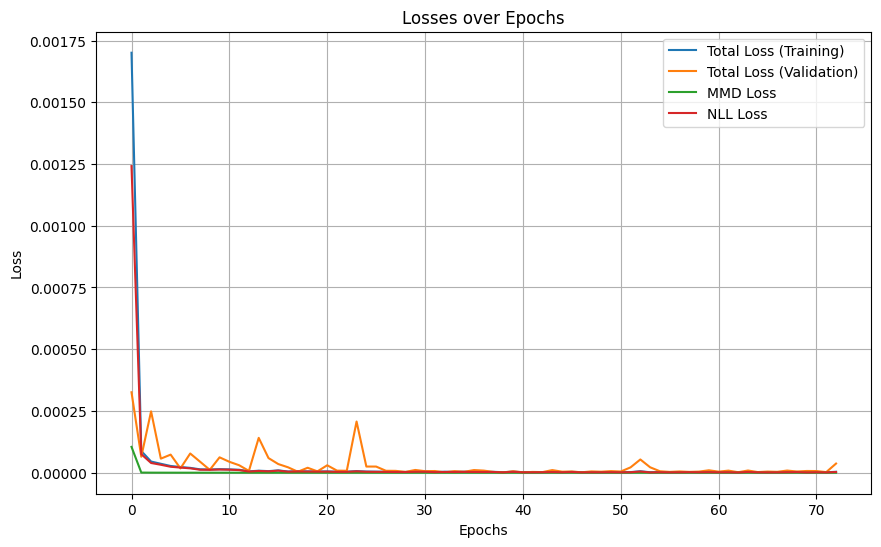

In [ ]:

dimension=[40]
#dimension=[2]
for i in dimension:
    import numpy as np
    import pandas as pd
    from matplotlib import pyplot as plt
    import math, os
    import tensorflow as tf
    from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
    from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten, Lambda, BatchNormalization, Dropout
    from tensorflow.keras.regularizers import l2
    from tensorflow.keras.models import Model
    #from keras.utils import plot_model
    import pdb
    from tensorflow.keras import backend as K
    from tensorflow.keras.datasets import mnist
    from tensorflow.keras.callbacks import  EarlyStopping
    from skimage import metrics
    from sklearn.metrics import mean_absolute_error
    from sklearn.model_selection import train_test_split
    from scipy import stats
    import csv

    #Set parameters
    z_dim = i
    epoch = 200
    batch_size = 32

    #raw=np.load('testdata.npy')
    raw=listOfTopographicMapsForAE
    raw.shape

    train_ratio = 0.7
    val_ratio = 0.15
    test_ratio = 0.15

    #Normalise the data
    dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
    dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

    # First split: 70% training and 30% remaining (to be split into validation and test)
    data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

    # Second split: 15% validation and 15% testing from the remaining 30%
    data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
    #data_train.shape,data_test.shape,data_val.shape

    # Flatten the data to make it easier to compute Z-scores
    #data_train_flat = data_train.reshape(data_train.shape[0], -1)

    # Calculate Z-scores
    #z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

    # Set a Z-score threshold (e.g., 3)
    #threshold = 3

    # Identify outliers
    #outliers = np.where(z_scores > threshold)

    # Filter out the outliers
    #filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
    #data_train_filtered = data_train[filtered_indices]


    #Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
    en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.001))(encoder_input)
    en_conv1 = BatchNormalization()(en_conv1)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1= Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    #Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
        return mu + K.exp(sigma)*eps
    latent_space = Lambda(compute_latent)([mu, sigma])

    #Build the encoder
    encoder = Model(encoder_input,[mu,sigma,latent_space], name='encoder')
    #plot_model(encoder, show_shapes=True)
    encoder.summary()

    #Design the decoder'
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1]*en_conv3.shape[2]*en_conv3.shape[3], activation='relu')(decoder_input )
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2],en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    # plot_model(decoder, show_shapes=True)
    decoder.summary()

    #Build the autoencoder for training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    ## MMD Functions
    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
        tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

    def compute_mmd(x, y, sigma_sqr=1.0):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    @tf.keras.utils.register_keras_serializable()
    class CustomLossLayer(tf.keras.layers.Layer):
        def __init__(self, **kwargs):
            super(CustomLossLayer, self).__init__(**kwargs)
            self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
            self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

        def call(self, inputs):
            latent_space, train_z, train_xr, train_x = inputs
            # true_samples = tf.random.normal(tf.stack([200, z_dim]))
            loss_mmd = compute_mmd(latent_space, train_z)
            #scale = 10000000
            #loss_mmd = mmd_loss * scale
            loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
            # Update the trackers
            self.mmd_tracker.update_state(loss_mmd)
            self.nll_tracker.update_state(loss_nll)

            # Add the total loss
            self.add_loss(loss_mmd + loss_nll)
            return train_xr

        def reset_states(self):  # Added for resetting at the start of each epoch
            self.mmd_tracker.reset_states()
            self.nll_tracker.reset_states()

        def compute_output_shape(self, input_shape):
            return input_shape[1]


    outputs = CustomLossLayer()([latent_space, train_z, train_xr, encoder_input])
    autoencoder = Model(encoder_input, outputs)
    autoencoder.compile(optimizer='adam')
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')


    #Train the model
    history = autoencoder.fit(
    data_train,
    epochs=epoch,
    batch_size=batch_size,
    validation_data=(data_val, None),
    callbacks=[myCallBacks]
    )

    # Save the history and model
    np.save(f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{z_dim}_history.npy', history.history)
    autoencoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{z_dim}.h5')

    # After training, plot the losses
import matplotlib.pyplot as plt

# Extract the history
history_dict = history.history
loss = history_dict['loss']
val_loss = history_dict['val_loss']

# If you explicitly track MMD and NLL losses, extract them (add these if stored in the history)
mmd_loss_values = history.history['mmd_loss']
nll_loss_values = history.history['nll_loss']  # Replace with actual key if different

# Plot the training and validation losses
plt.figure(figsize=(10, 6))
plt.plot(loss, label='Total Loss (Training)')
plt.plot(val_loss, label='Total Loss (Validation)')

# Add MMD and NLL losses if available
if mmd_loss_values:
    plt.plot(mmd_loss_values, label='MMD Loss')
if nll_loss_values:
    plt.plot(nll_loss_values, label='NLL Loss')

plt.title('Losses over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()




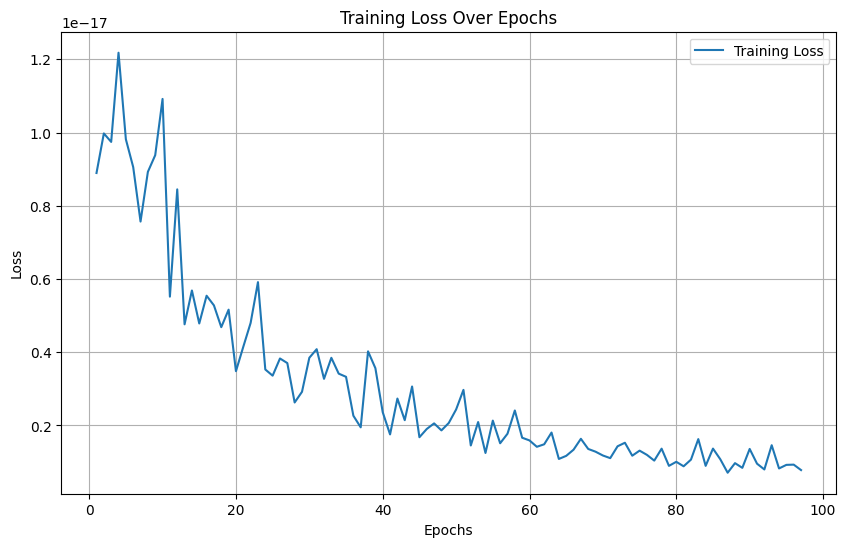

In [ ]:
import matplotlib.pyplot as plt

# Loss values extracted from your data (training and validation loss)
loss_values = [
    8.8962e-18, 9.9772e-18, 9.7456e-18, 1.2182e-17,
    9.8183e-18, 9.0578e-18, 7.5698e-18, 8.9276e-18, 9.3831e-18, 1.0920e-17,
    5.5185e-18, 8.4491e-18, 4.7627e-18, 5.6867e-18, 4.7855e-18, 5.5437e-18,
    5.2799e-18, 4.6849e-18, 5.1630e-18, 3.4821e-18, 4.1486e-18, 4.8006e-18,
    5.9148e-18, 3.5286e-18, 3.3597e-18, 3.8296e-18, 3.7034e-18, 2.6271e-18,
    2.9191e-18, 3.8487e-18, 4.0832e-18, 3.2734e-18, 3.8477e-18, 3.4155e-18,
    3.3284e-18, 2.2659e-18, 1.9483e-18, 4.0243e-18, 3.5642e-18, 2.3607e-18,
    1.7549e-18, 2.7344e-18, 2.1441e-18, 3.0645e-18, 1.6781e-18, 1.9036e-18,
    2.0562e-18, 1.8650e-18, 2.0677e-18, 2.4362e-18, 2.9716e-18, 1.4527e-18,
    2.0930e-18, 1.2479e-18, 2.1321e-18, 1.5132e-18, 1.7736e-18, 2.4089e-18,
    1.6645e-18, 1.5906e-18, 1.4170e-18, 1.4851e-18, 1.8060e-18, 1.0847e-18,
    1.1689e-18, 1.3370e-18, 1.6351e-18, 1.3577e-18, 1.2829e-18, 1.1788e-18,
    1.1068e-18, 1.4307e-18, 1.5274e-18, 1.1734e-18, 1.3118e-18, 1.1960e-18,
    1.0394e-18, 1.3657e-18, 8.9604e-19, 1.0066e-18, 8.8426e-19, 1.0661e-18,
    1.6269e-18, 8.9616e-19, 1.3677e-18, 1.0751e-18, 7.0847e-19, 9.7013e-19,
    8.4168e-19, 1.3584e-18, 9.5578e-19, 7.9760e-19, 1.4601e-18, 8.2495e-19,
    9.2287e-19, 9.2937e-19, 7.8047e-19
]

# Epoch indices
epochs = range(1, len(loss_values) + 1)

# Plot the loss values
plt.figure(figsize=(10, 6))
plt.plot(epochs, loss_values, label='Training Loss')
plt.title('Training Loss Over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()



In [ ]:
# Save the history to a file
np.save(f'/content/drive/MyDrive/Masters Dataset/New Results/topocvae_dim{z_dim}_history.npy', history.history)
# Save model
model_cvae1 = '/content/drive/MyDrive/Masters Dataset/New Results/topocvae1.h5'
autoencoder.save(model_cvae1, save_format='h5')

#saving models
    #tf.keras.models.save_model(autoencoder,'Models/Model_p2/vae_model'+str(i))
    #tf.keras.models.save_model(encoder,'Models/Model_p2/encoder_model'+str(i))
    #tf.keras.models.save_model(decoder,'Models/Model_p2/decoder_model'+str(i))

    #load models
    #model= tf.keras.models.load_model('/content/drive/MyDrive/EEG_exp2/Models/mmd-vae_1V_25D',compile=True)
    #enc_model= tf.keras.models.load_model('/content/drive/MyDrive/EEG_Data/mmd-encoder_40v_25D',compile=True)


##Predicted Images

768/768 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


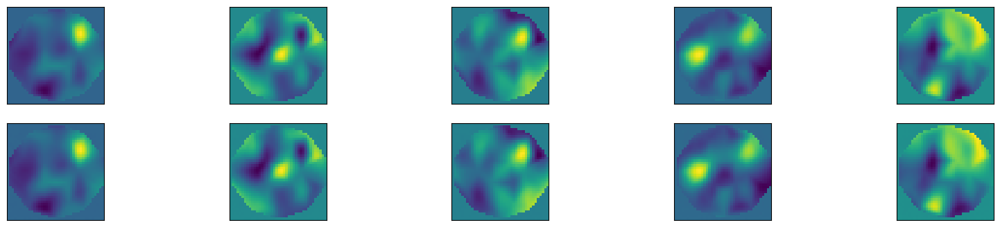

In [ ]:
# Evaluate the performance of autoencoder for training, validation, and test data
predicted_wholedataset = autoencoder.predict(dataNormReshape).reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])
predicted_train = autoencoder.predict(data_train).reshape(-1, data_train.shape[1], data_train.shape[2])
predicted_test = autoencoder.predict(data_test).reshape(-1, data_test.shape[1], data_test.shape[2])

actual_train = data_train.reshape(-1, data_train.shape[1], data_train.shape[2])
actual_test = data_test.reshape(-1, data_test.shape[1], data_test.shape[2])

# Visualize actual and predicted image
fig, axes = plt.subplots(nrows=2, ncols=5, sharex=True, sharey=True, figsize=(20, 4))
for images, row in zip([actual_test[100:105], predicted_test[100:105]], axes):
    for img, ax in zip(images, row):
        ax.imshow(img.reshape((raw.shape[1], raw.shape[2])))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
plt.savefig('ActualPredicted5Images')

# Denormalize and compare topographic map from raw data with denormalized reconstructed topographic map
outputDenormalisedData = predicted_wholedataset * (raw.max() - raw.min()) + raw.min()
outputDenormalisedData = outputDenormalisedData.reshape(-1, outputDenormalisedData.shape[1], outputDenormalisedData.shape[2])

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 391ms/step


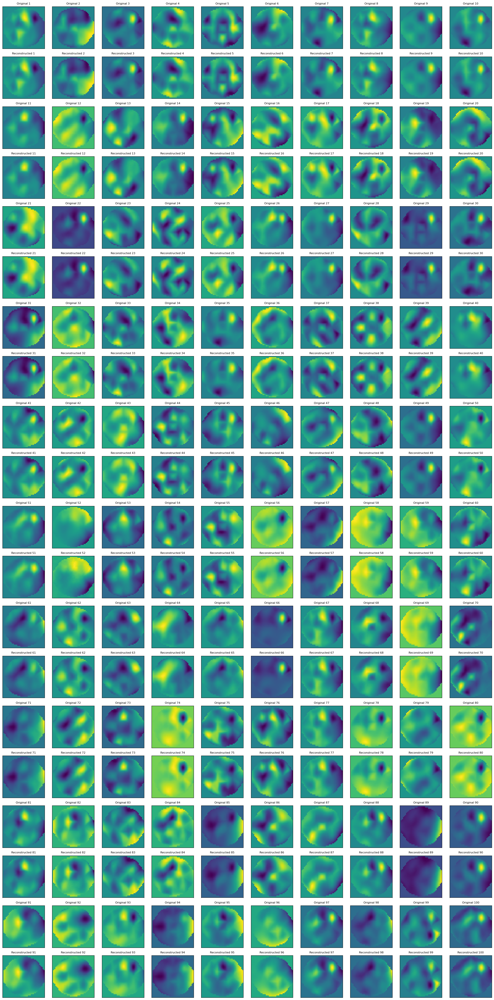

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Number of images to compare
num_images = 100

# Randomly pick indices from the training and test sets
train_indices = np.random.choice(len(data_train_filtered), num_images // 2, replace=False)
test_indices = np.random.choice(len(data_test), num_images // 2, replace=False)

# Combine the selected indices from training and test sets
selected_train_images = data_train_filtered[train_indices]
selected_test_images = data_test[test_indices]

# Combine the selected images into one dataset
selected_images = np.concatenate([selected_train_images, selected_test_images], axis=0)

# Predict the reconstructed images using the autoencoder
predicted_images = autoencoder.predict(selected_images).reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])

# Reshape the actual images for comparison
actual_images = selected_images.reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])

# Plot 100 original images vs. reconstructed images in a 10x10 grid
fig, axes = plt.subplots(nrows=20, ncols=10, sharex=True, sharey=True, figsize=(20, 40))

for i in range(num_images):
    # Original images
    ax = axes[2 * (i // 10), i % 10]
    ax.imshow(actual_images[i].squeeze(), cmap='viridis')  # Set the colormap to 'viridis'
    ax.set_title(f'Original {i+1}', fontsize=8)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # Reconstructed images
    ax = axes[2 * (i // 10) + 1, i % 10]
    ax.imshow(predicted_images[i].squeeze(), cmap='viridis')  # Set the colormap to 'viridis'
    ax.set_title(f'Reconstructed {i+1}', fontsize=8)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

plt.tight_layout()
plt.savefig('ActualVsReconstructed100Images.png')
plt.show()

# Denormalize and compare topographic map from raw data with denormalized reconstructed topographic map
outputDenormalisedData = predicted_images * (raw.max() - raw.min()) + raw.min()


## MEtrics Table

In [ ]:
from skimage.metrics import structural_similarity, mean_squared_error
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Layer
from tensorflow.keras import backend as K
import csv
from datetime import datetime

# Define functions for SSIM, MSE, MAE, MAPE with appropriate data_range for SSIM
def SSIM(actual, pred, data_range):
    ssimErrAllPair = 0
    for i in range(actual.shape[0]):
        ssimErrAllPair += structural_similarity(actual[i], pred[i], data_range=data_range) / actual.shape[0]
    return ssimErrAllPair

def MSE(actual, pred):
    mseErrAllPair = 0
    for i in range(actual.shape[0]):
        mseErrAllPair += mean_squared_error(actual[i], pred[i]) / actual.shape[0]
    return mseErrAllPair

def MAE(actual, pred):
    MA_error_all = 0
    for i in range(actual.shape[0]):
        MA_error_all += mean_absolute_error(actual[i], pred[i]) / actual.shape[0]
    return MA_error_all

def MAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.mean(percentage_errors)

def MdAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.median(percentage_errors)


# Set dimensions for evaluation
dimensions = [40]

train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

results = []
plt.figure(figsize=(14, 8))

def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
    tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
    return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))
'''
# Define the custom loss layer
class CustomLossLayer(Layer):
    def call(self, inputs):
        train_z, train_xr, train_x = inputs
        loss_mmd = self.compute_mmd(train_z, train_z)
        loss_nll = K.mean(K.square(train_xr - train_x))
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def compute_mmd(x, y):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)
'''
@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)
        self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
        self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs
        true_samples = tf.random.normal(tf.stack([200, z_dim]))
        loss_mmd = compute_mmd(true_samples, train_z)
        loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
        # Update the trackers
        self.mmd_tracker.update_state(loss_mmd)
        self.nll_tracker.update_state(loss_nll)

        # Add the total loss
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def reset_states(self):  # Added for resetting at the start of each epoch
        self.mmd_tracker.reset_states()
        self.nll_tracker.reset_states()

    def compute_output_shape(self, input_shape):
        return input_shape[1]

# Define the custom function
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps

# Loop through dimensions and load models
for dim in dimensions:
    start_time = datetime.now()

    # Load pre-trained model with custom objects
    model_file_path1 = f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{dim}.h5'
    autoencoder = load_model(model_file_path1,
                             custom_objects={'compute_latent': compute_latent,
                                             'CustomLossLayer': CustomLossLayer},
                             compile=False)


    # Load the training history
    history_path = f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{dim}_history.npy'
    history = np.load(history_path, allow_pickle=True).item()

    # Get the number of epochs used
    num_epochs = len(history['loss'])

    # Predict on training and test data
    predicted_wholedataset = autoencoder.predict(dataNormReshape).reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])
    predicted_train = autoencoder.predict(data_train).reshape(-1, data_train.shape[1], data_train.shape[2])
    predicted_test = autoencoder.predict(data_test).reshape(-1, data_test.shape[1], data_test.shape[2])

    actual_train = data_train.reshape(-1, data_train.shape[1], data_train.shape[2])
    actual_test = data_test.reshape(-1, data_test.shape[1], data_test.shape[2])

    # Compute SSIM, MSE, MAE, MAPE
    data_range = 1.0  # Since images are normalized to [0, 1]

    # Ensure that actual_train and predicted_train are denormalized before calculating MAPE
    actual_train_denorm = actual_train * (raw.max() - raw.min()) + raw.min()
    predicted_train_denorm = predicted_train * (raw.max() - raw.min()) + raw.min()

    actual_test_denorm = actual_test * (raw.max() - raw.min()) + raw.min()
    predicted_test_denorm = predicted_test * (raw.max() - raw.min()) + raw.min()

    SSIM_train = SSIM(actual_train, predicted_train, data_range)
    MSE_train = MSE(actual_train, predicted_train)
    MAE_train = MAE(actual_train, predicted_train)
    MAPE_train = MAPE(actual_train_denorm, predicted_train_denorm)  # Only 2 arguments
    MdAPE_train= MdAPE(actual_train_denorm, predicted_train_denorm)

    SSIM_test = SSIM(actual_test, predicted_test, data_range)
    MSE_test = MSE(actual_test, predicted_test)
    MAE_test = MAE(actual_test, predicted_test)
    MAPE_test = MAPE(actual_test_denorm, predicted_test_denorm)  # Only 2 arguments
    MdApe_test = MdAPE(actual_test_denorm, predicted_test_denorm)

    # Store results
    results.append({
        'Dimension': dim,
        'Epochs': num_epochs,
        'Training SSIM': SSIM_train,
        'Training MSE': MSE_train,
        'Training MAE': MAE_train,
        'Training MAPE (%)': MAPE_train,
        'Training MdAPE (%)': MdAPE_train,
        'Testing SSIM': SSIM_test,
        'Testing MSE': MSE_test,
        'Testing MAE': MAE_test,
        'Testing MAPE (%)': MAPE_test,
        'Testing MdAPE (%)': MdApe_test
    })

# Save results to a CSV file
header = ['Dimension', 'Epochs', 'Training SSIM', 'Training MSE', 'Training MAE', 'Training MAPE (%)', 'Training MdAPE (%)',
          'Testing SSIM', 'Testing MSE', 'Testing MAE', 'Testing MAPE (%)', 'Testing MdAPE (%)']
with open('metrics_table.csv', 'w', newline='') as f:
    writer = csv.DictWriter(f, fieldnames=header)
    writer.writeheader()
    for result in results:
        writer.writerow(result)

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))
print("Execution finished")


768/768 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step
Duration: 0:00:27.198853
Execution finished


<Figure size 1400x800 with 0 Axes>

## Read the Endcoder

In [ ]:
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, Lambda, LeakyReLU
import tensorflow.keras.backend as K

dimensions = [15, 20, 25, 30]  # Different latent space dimensions

for z_dim in dimensions:
    # Load the corresponding saved model
    accuracy_model = load_model(f'/content/drive/MyDrive/Masters Dataset/New Results/autoencoder_dim{z_dim}.h5')

    # Rebuild the encoder with the correct z_dim
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))

    # Encoder architecture remains the same as described earlier, with the correct z_dim
    en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + K.exp(sigma) * eps

    latent_space = Lambda(compute_latent)([mu, sigma])

    # Build the encoder model
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Load the weights into the encoder from the full model
    for layer in encoder.layers:
        try:
            layer.set_weights(accuracy_model.get_layer(layer.name).get_weights())
        except ValueError:
            pass

    # Now use the encoder to predict the latent space on your test data
    mu_train, sigma_train, latent_space_train = encoder.predict(data_train_filtered)

    # You can store or analyze the latent space output as needed
    # e.g., save latent space
    np.save(f'/content/drive/MyDrive/Masters Dataset/New Results/latent_space_train_dim{z_dim}.npy', latent_space_train)


486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


In [ ]:
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, Lambda, LeakyReLU
import tensorflow.keras.backend as K

dimensions = [2]  # Different latent space dimensions

for z_dim in dimensions:
    # Load the corresponding saved model
    accuracy_model = load_model(f'/content/drive/MyDrive/Dissertation/autoencoder_dim{z_dim}.h5')

    # Rebuild the encoder with the correct z_dim
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))

    # Encoder architecture remains the same as described earlier, with the correct z_dim
    en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + K.exp(sigma) * eps

    latent_space = Lambda(compute_latent)([mu, sigma])

    # Build the encoder model
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Load the weights into the encoder from the full model
    for layer in encoder.layers:
        try:
            layer.set_weights(accuracy_model.get_layer(layer.name).get_weights())
        except ValueError:
            pass

    # Now use the encoder to predict the latent space on your test data
    mu_train, sigma_train, latent_space_train = encoder.predict(data_train_filtered)

    # You can store or analyze the latent space output as needed
    # e.g., save latent space
    np.save(f'/content/drive/MyDrive/Dissertation/latent_space_train_dim{z_dim}.npy', latent_space_train)


In [ ]:
# Assuming `data_test` is your test dataset
mu_train, sigma_train, latent_space_train = encoder.predict(data_train_filtered)

# `latent_space_test` now contains the latent space representations for your test data
print("Latent Space Representation (Train Data):")
print(latent_space_train)


486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
Latent Space Representation (Train Data):
[[-1.4403588  -0.07462285 -2.520838   ... -0.37442243 -0.72319335
  -0.23265573]
 [ 2.4889445  -0.44761235  1.8336256  ...  0.8625295  -0.32408008
   1.025939  ]
 [-0.39582637 -0.7345219   0.6107634  ... -1.8916838   1.9959061
  -1.0488493 ]
 ...
 [ 0.77232265 -0.67882985 -0.36109555 ...  0.0901546   0.07356927
  -0.01632305]
 [-1.1242802  -0.49433115  0.4790232  ...  1.2453743   0.8891478
  -1.8179753 ]
 [-1.5958589  -0.25252527  0.14835219 ... -0.10719382  1.0482038
  -0.29790017]]


In [ ]:
import pandas as pd

# Convert the latent space array to a DataFrame
latent_space_df = pd.DataFrame(latent_space_train)

# Save the DataFrame to a CSV file
latent_space_df.to_csv('latent_space_output.csv', index=False)

print("Latent space output saved to 'latent_space_output.csv'")


Latent space output saved to 'latent_space_output.csv'


In [ ]:
import matplotlib.pyplot as plt

# Assuming latent_space_test is 2D
plt.scatter(latent_space_train[:, 0], latent_space_train[:, 1], c='blue', alpha=0.5)
plt.title("Latent Space Representation (Train Data)")
plt.xlabel("Latent Dimension 1")
plt.ylabel("Latent Dimension 2")
plt.show()


In [ ]:
from sklearn.manifold import TSNE

# Reduce dimensionality of latent space using t-SNE
latent_space_reduced = TSNE(n_components=2).fit_transform(latent_space_train)

plt.scatter(latent_space_reduced[:, 0], latent_space_reduced[:, 1], c='blue', alpha=0.5)
plt.title("Latent Space Representation (Reduced via t-SNE)")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming encoder_output is a pandas DataFrame or you convert it from another format
# For example, encoder_output = pd.DataFrame(your_output_array)
latent_space_df = pd.read_csv('latent_space_output.csv')
latent_space_df.head()
def plot_distributions(latent_space_df):
    # Set up a grid of subplots
    fig, axes = plt.subplots(6, 5, figsize=(15, 15))  # 6 rows, 5 columns for 30 dimensions

    for i, ax in enumerate(axes.flatten()):
        ax.hist(latent_space_df.iloc[:, i], bins=30, alpha=0.7, color='blue')
        ax.set_title(f'Dimension {i+1}')
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Call the function with your encoder output
plot_distributions(latent_space_df)


In [ ]:
import matplotlib.pyplot as plt

# Create a figure with subplots
fig, axs = plt.subplots(15, 2, figsize=(15, 50))  # 30 plots in a 15x2 grid
fig.suptitle('Scatter Plots for All 30 Dimensions', fontsize=20)

# Plot each dimension as a scatter plot
for i in range(30):
    row = i // 2
    col = i % 2
    axs[row, col].scatter(latent_space_df.index, latent_space_df.iloc[:, i], alpha=0.5)
    axs[row, col].set_title(f'Dimension {i+1}')
    axs[row, col].set_ylabel('Value')

plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


In [ ]:
# Create pairwise scatter plots for the first few dimensions to avoid overcrowding the visualization.
import seaborn as sns

# Plot scatter plots for first few dimensions (for better visibility, choosing first 5 dimensions)
sns.pairplot(latent_space_df.iloc[:, :5], diag_kind='kde')
plt.suptitle('Pairwise Scatter Plots of First 5 Dimensions in the Latent Space', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


In [ ]:
# Plot pairwise scatter matrix for all 30 dimensions (this will result in a large figure)
pd.plotting.scatter_matrix(latent_space_df, figsize=(30, 30), diagonal='kde')

plt.suptitle('Pairwise Scatter Plots for All 30 Dimensions', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming your latent space data is stored in 'latent_space_data'
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
latent_space_tsne = tsne.fit_transform(latent_space_data)

# Visualize the t-SNE result
plt.scatter(latent_space_tsne[:, 0], latent_space_tsne[:, 1], alpha=0.5)
plt.title('t-SNE Visualization of Latent Space')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()


In [ ]:
"""
# Use the decoder to reconstruct images from the latent space
reconstructed_data = decoder.predict(latent_space_test)

# Show an example of original vs reconstructed image
import matplotlib.pyplot as plt

n = 5  # number of examples to show
plt.figure(figsize=(10, 4))

for i in range(n):
    # Original
    plt.subplot(2, n, i + 1)
    plt.imshow(data_test[i].reshape(raw.shape[1], raw.shape[2]), cmap='gray')
    plt.title("Original")
    plt.axis('off')

    # Reconstructed
    plt.subplot(2, n, i + 1 + n)
    plt.imshow(reconstructed_data[i].reshape(raw.shape[1], raw.shape[2]), cmap='gray')
    plt.title("Reconstructed")
    plt.axis('off')

plt.show()
"""

In [ ]:
from sklearn.metrics import mean_squared_error

# Flatten original and reconstructed data for MSE calculation
original_flat = data_test.reshape(data_test.shape[0], -1)
reconstructed_flat = reconstructed_data.reshape(reconstructed_data.shape[0], -1)

# Compute MSE
mse = mean_squared_error(original_flat, reconstructed_flat)
print(f"Mean Squared Error: {mse}")


In [ ]:
import numpy as np

# Sample new latent vectors from the normal distribution
new_latent_vectors = np.random.normal(size=(5, z_dim))

# Generate new data by decoding the sampled latent vectors
new_generated_data = decoder.predict(new_latent_vectors)

# Display generated data
plt.figure(figsize=(10, 4))
for i in range(5):
    plt.subplot(1, 5, i + 1)
    plt.imshow(new_generated_data[i].reshape(raw.shape[1], raw.shape[2]), cmap='gray')
    plt.title(f"Generated {i + 1}")
    plt.axis('off')
plt.show()


###tests

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#Assuming raw is the original data before normalization
def denormalize(data, raw_min, raw_max):
    return data * (raw_max - raw_min) + raw_min

actual_train_denorm = denormalize(actual_train, raw.min(), raw.max())
predicted_train_denorm = denormalize(predicted_train, raw.min(), raw.max())

# Calculate MAPE on denormalized data
MAPE_train = MAPE(actual_train_denorm, predicted_train_denorm)

# Assuming you have actual and predicted values for the training data
actual_train_denorm = denormalize(actual_train, raw.min(), raw.max())  # Denormalize if needed
predicted_train_denorm = denormalize(predicted_train, raw.min(), raw.max())

# Calculate percentage errors for each data point
percentage_errors = np.abs((actual_train_denorm - predicted_train_denorm) / actual_train_denorm) * 100

# Identify the indices of the top 10 data points with the highest percentage errors
outlier_indices = np.argsort(percentage_errors.flatten())[::-1][:10]

# Print the top 10 percentage errors and their corresponding actual and predicted values
for idx in outlier_indices:
    print(f'Index: {idx}, Actual: {actual_train_denorm.flatten()[idx]}, Predicted: {predicted_train_denorm.flatten()[idx]}, Error (%): {percentage_errors.flatten()[idx]}')

# Plot the actual vs. predicted values for the outliers
plt.figure(figsize=(10, 6))
plt.scatter(actual_train_denorm.flatten()[outlier_indices], predicted_train_denorm.flatten()[outlier_indices], color='red', label='Outliers')
plt.plot([actual_train_denorm.min(), actual_train_denorm.max()], [actual_train_denorm.min(), actual_train_denorm.max()], color='blue', label='Perfect Prediction Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.legend()
plt.title('Actual vs. Predicted Values for Outliers')
plt.show()


In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(actual_train.flatten(), bins=50, color='blue', alpha=0.7, label='Actual Train')
plt.hist(predicted_train.flatten(), bins=50, color='red', alpha=0.5, label='Predicted Train')
plt.title('Normalized Training Data Distribution')
plt.legend()

plt.subplot(1, 2, 2)
plt.hist(actual_test.flatten(), bins=50, color='blue', alpha=0.7, label='Actual Test')
plt.hist(predicted_test.flatten(), bins=50, color='red', alpha=0.5, label='Predicted Test')
plt.title('Normalized Testing Data Distribution')
plt.legend()

plt.tight_layout()
plt.show()


In [ ]:
high_mape_indices = np.argsort(MAPE(actual_train, predicted_train, raw.min(), raw.max()))[::-1][:10]

for idx in high_mape_indices:
    print(f'Index: {idx}, Actual: {actual_train.flatten()[idx]}, Predicted: {predicted_train.flatten()[idx]}, MAPE: {percentage_errors.flatten()[idx]}')


In [ ]:
MAPE_train_normalized = MAPE(actual_train, predicted_train, 0, 1)  # No denormalization
print(f'MAPE on Normalized Data: {MAPE_train_normalized}')


In [ ]:
!python --version

!pip install --upgrade tensorflow keras


Python 3.10.12
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 615.3/615.3 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 58.8 MB/s eta 0:00:00
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.17.1
    Uninstalling tensorboard-2.17.1:
      Successfully uninstalled tensorboard-2.17.1
  Attempting uninstall: keras
    Found existing installation: keras 3.5.0
    Uninstalling keras-3.5.0:
      Successfully uninstalled keras-3.5.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.17.1
    Uninstalling tensorflow-2.17.1:
      Successfully uninstalled tensorflow-2.17.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.18.0 wh

#6 Deep Clustering

In [ ]:
print(tf. __version__)

2.17.1


#Initial Cnn-VAE

(24567, 40, 40)


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_11            │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_20 (Conv2D)        │ (None, 20, 20, 32)     │            544 │ input_layer_11[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 20, 20, 32)     │            128 │ conv2d_20[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_20            │ (None, 20, 20, 32)     │              0 │ batch_normalization_2… │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_21 (Conv2D)        │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_20[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_21            │ (None, 10, 10, 64)     │              0 │ conv2d_21[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_22 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_21[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_22            │ (None, 5, 5, 128)      │              0 │ conv2d_22[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_5 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_22[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_15 (Dense)          │ (None, 40)             │        128,040 │ flatten_5[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_16 (Dense)          │ (None, 40)             │        128,040 │ flatten_5[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_5 (Lambda)         │ (None, 40)             │              0 │ dense_15[0][0],        │
│                           │                        │                │ dense_16[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 420,784 (1.61 MB)

 Trainable params: 420,720 (1.60 MB)

 Non-trainable params: 64 (256.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_12 (InputLayer)          │ (None, 40)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_17 (Dense)                     │ (None, 3200)                │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_5 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_20                  │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_21                  │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_23                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525,633 (2.01 MB)

 Trainable params: 525,633 (2.01 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 14s 15ms/step - loss: 0.0045 - loss_mmd: 0.0024 - loss_nll: 0.0020 - val_loss: 4.9792e-04 - val_loss_mmd: 0.0149 - val_loss_nll: 4.9792e-04
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0032 - loss_mmd: 0.0023 - loss_nll: 8.9138e-04 - val_loss: 5.2200e-04 - val_loss_mmd: 0.0122 - val_loss_nll: 5.2200e-04
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0032 - loss_mmd: 0.0023 - loss_nll: 8.9385e-04 - val_loss: 5.0771e-04 - val_loss_mmd: 0.0108 - val_loss_nll: 5.0771e-04
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0031 - loss_mmd: 0.0022 - loss_nll: 8.8375e-04 - val_loss: 4.9937e-04 - val_loss_mmd: 0.0100 - val_loss_nll: 4.9937e-04
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0031 - loss_mmd: 0.0022 - loss_nll: 8.8339e-04 - val_loss: 5.1414e-04 - val_loss_mmd: 0.0101 - val_loss_nll: 5.1414e-04
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0031 - loss_mmd: 0.0022 

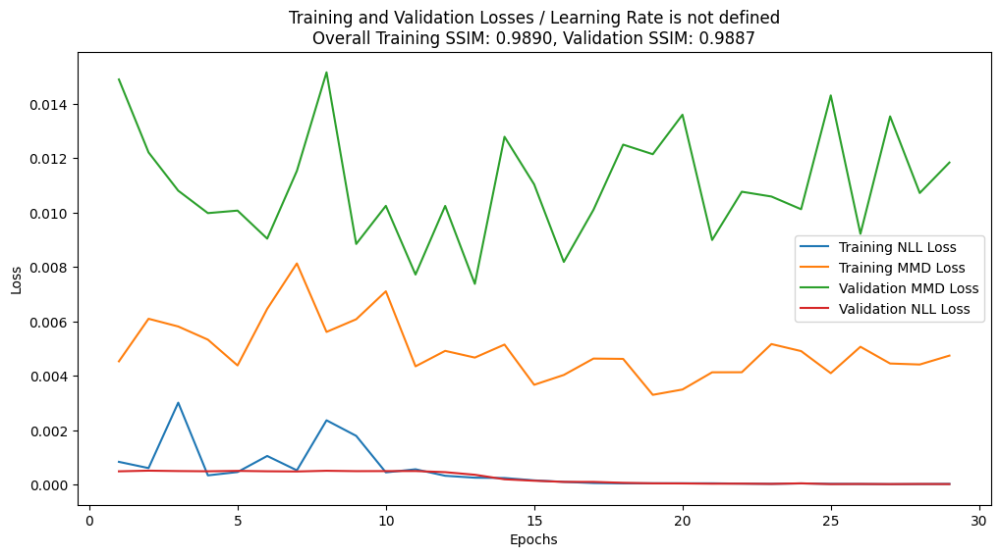

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

# Set dimension list for loop
dimension = [40]
# dimension = [2]
for i in dimension:
    # Set parameters
    z_dim = i
    total_epochs = 200
    batch_size = 32

    # Load your data
    # raw = np.load('testdata.npy')
    raw = listOfTopographicMapsForAE  # Replace with your actual data variable
    print(raw.shape)

    train_ratio = 0.7
    val_ratio = 0.15
    test_ratio = 0.15

    #Normalise the data
    dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
    dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

    # First split: 70% training and 30% remaining (to be split into validation and test)
    data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

    # Second split: 15% validation and 15% testing from the remaining 30%
    data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
    #data_train.shape,data_test.shape,data_val.shape
    '''
    # Flatten the data to make it easier to compute Z-scores
    data_train_flat = data_train.reshape(data_train.shape[0], -1)

    # Calculate Z-scores
    z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

    # Set a Z-score threshold (e.g., 3)
    threshold = 3

    # Identify outliers
    outliers = np.where(z_scores > threshold)

    # Filter out the outliers
    filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
    data_train_filtered = data_train[filtered_indices]
    '''
   #Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
    en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.001))(encoder_input)
    en_conv1 = BatchNormalization()(en_conv1)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1= Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    #Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        sigma = tf.math.softplus(sigma)  # Ensure numerical stability
        eps = K.random_normal(shape=(K.shape(mu)[0], z_dim), mean=0., stddev=1.)
        return mu + sigma * eps

    latent_space = Lambda(compute_latent)([mu, sigma])

    #Build the encoder
    encoder = Model(encoder_input,[mu,sigma,latent_space], name='encoder')
    #plot_model(encoder, show_shapes=True)
    encoder.summary()

    #Design the decoder'
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1]*en_conv3.shape[2]*en_conv3.shape[3], activation='relu')(decoder_input )
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2],en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    # plot_model(decoder, show_shapes=True)
    decoder.summary()

    ## MMD Functions
     ## MMD Functions
    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
        tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

    def compute_mmd(x, y, sigma_sqr=1.0):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    class CustomLossLayer(tf.keras.Model):
        def __init__(self, encoder, decoder):
            super(CustomLossLayer, self).__init__()
            self.encoder = encoder
            self.decoder = decoder
            self.epoch_loss_nll = []  # Track batch losses per epoch

        def train_step(self, data):
            x = data  # Since we have no labels
            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent_space = self.encoder(x)
                # Sample train_z from prior distribution
                train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
                xr = self.decoder(latent_space)

                # Custom loss
                loss_mmd = compute_mmd(latent_space, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x))
                total_loss = loss_mmd + loss_nll

            # Compute gradients
            gradients = tape.gradient(total_loss, self.trainable_variables)
            # Apply gradients
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

            # Debug: Print batch loss

            # Track batch losses for averaging at epoch level
            self.epoch_loss_nll.append(loss_mmd)  # Store the tensor

            # Return loss for progress bar
            return {'loss': total_loss, 'loss_mmd': loss_mmd, 'loss_nll': loss_nll}
        '''
        def on_epoch_end(self, epoch, logs=None):
            # Compute and log the average loss for the epoch
            average_loss_mmd = tf.reduce_mean(self.epoch_loss_mmd)  # Use TensorFlow to compute mean
            tf.print(f"Epoch {epoch + 1}: Average Loss MMD = {average_loss_mmd}")
            self.epoch_loss_mmd = []  # Reset for the next epoch
        '''

        def test_step(self, data):
            x = data  # Validation data
            mu, sigma, latent_space = self.encoder(x)
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)
            loss_mmd = compute_mmd(latent_space, train_z)
            loss_nll = tf.reduce_mean(tf.square(xr - x))
            total_loss = loss_nll

            return {'loss': total_loss, 'loss_mmd': loss_mmd, 'loss_nll': loss_nll}

        def calculate_overall_ssim(self, data):
            """
            Calculate the overall SSIM score for the dataset.
            """
            _, _, latent_space = self.encoder(data)
            reconstructed = self.decoder(latent_space)
            reconstructed = tf.cast(reconstructed, tf.float64)
            overall_ssim = tf.reduce_mean(tf.image.ssim(data, reconstructed, max_val=1.0))
            return overall_ssim.numpy()



    # Instantiate the custom autoencoder model
    autoencoder = CustomLossLayer(encoder, decoder)
    # Compile the model
    #autoencoder.compile(optimizer='adam')
    autoencoder.compile(optimizer='adam')

    # Prepare to track the losses
    loss_mmd_list = []
    loss_nll_list = []
    loss_total_list = []


    # Custom callback to store losses
    class LossHistory(tf.keras.callbacks.Callback):
        def on_epoch_end(self, epoch, logs=None):
            loss_mmd_list.append(logs.get('loss_mmd'))
            loss_nll_list.append(logs.get('loss_nll'))
            loss_total_list.append(logs.get('loss'))

    # Define callbacks
    myCallBacks = [
        EarlyStopping(monitor='loss_mmd', patience=10, mode='min'),LossHistory(),]

    # Train the model
    history = autoencoder.fit(
        data_train,
        epochs=total_epochs,
        batch_size=batch_size,
        validation_data=data_val,  # No labels needed
        callbacks=myCallBacks,
    )


    # Calculate SSIM for training and validation datasets
    overall_ssim_train = autoencoder.calculate_overall_ssim(data_train)
    overall_ssim_val = autoencoder.calculate_overall_ssim(data_val)
    print(f"Overall Training SSIM: {overall_ssim_train:.4f}")
    print(f"Overall Validation SSIM: {overall_ssim_val:.4f}")

    # Plot the losses
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/VAE'
    model_name = f'autoencoder_dim{z_dim}'
    epochs_range = range(1, len(loss_total_list) + 1)

    plt.figure(figsize=(12, 6))
    plt.plot(epochs_range, loss_nll_list, label='Training NLL Loss')
    plt.plot(epochs_range, loss_mmd_list, label='Training MMD Loss')


    # Get validation losses from history
    val_loss_nll_list = history.history.get('val_loss_nll')
    val_loss_mmd_list = history.history.get('val_loss_mmd')


    if val_loss_mmd_list is not None:
        plt.plot(epochs_range, val_loss_mmd_list, label='Validation MMD Loss')

    if val_loss_nll_list is not None:
        plt.plot(epochs_range, val_loss_nll_list, label='Validation NLL Loss')

    plt.title(f'Training and Validation Losses / Learning Rate is not defined\nOverall Training SSIM: {overall_ssim_train:.4f}, Validation SSIM: {overall_ssim_val:.4f}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plot_path = os.path.join(save_dir, f'{model_name}_loss_curves7.png')
    plt.savefig(plot_path)
    print(f"Loss plot saved to {plot_path}")
    plt.show()

    # Save the history and model
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)

###1

(24567, 40, 40)


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_136           │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_269 (Conv2D)       │ (None, 20, 20, 32)     │            544 │ input_layer_136[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_269           │ (None, 20, 20, 32)     │              0 │ conv2d_269[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_270 (Conv2D)       │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_269[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_270           │ (None, 10, 10, 64)     │              0 │ conv2d_270[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_271 (Conv2D)       │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_270[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_271           │ (None, 5, 5, 128)      │              0 │ conv2d_271[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_68 (Flatten)      │ (None, 3200)           │              0 │ leaky_re_lu_271[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_204 (Dense)         │ (None, 40)             │        128,040 │ flatten_68[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_205 (Dense)         │ (None, 40)             │        128,040 │ flatten_68[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_68 (Lambda)        │ (None, 40)             │              0 │ dense_204[0][0],       │
│                           │                        │                │ dense_205[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 420,656 (1.60 MB)

 Trainable params: 420,656 (1.60 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_137 (InputLayer)         │ (None, 40)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_206 (Dense)                    │ (None, 3200)                │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_68 (Reshape)                 │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_269                 │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_270                 │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_272                 │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525,633 (2.01 MB)

 Trainable params: 525,633 (2.01 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200


/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


135/135 ━━━━━━━━━━━━━━━━━━━━ 12s 57ms/step - loss: 0.0537 - loss_mmd: 6.1301e-04 - val_loss: 0.0536 - val_loss_mmd: 6.2203e-04
Epoch 2/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 6.1302e-04 - val_loss: 0.0540 - val_loss_mmd: 9.9051e-04
Epoch 3/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 5.7765e-04 - val_loss: 0.0538 - val_loss_mmd: 8.2552e-04
Epoch 4/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 5.8101e-04 - val_loss: 0.0537 - val_loss_mmd: 7.1311e-04
Epoch 5/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 5.8415e-04 - val_loss: 0.0537 - val_loss_mmd: 6.8164e-04
Epoch 6/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 5.8039e-04 - val_loss: 0.0540 - val_loss_mmd: 0.0011
Epoch 7/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0537 - loss_mmd: 5.8349e-04 - val_loss: 0.0535 - val_loss_mmd: 5.3418e-04
Epoch 8/200
135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - 

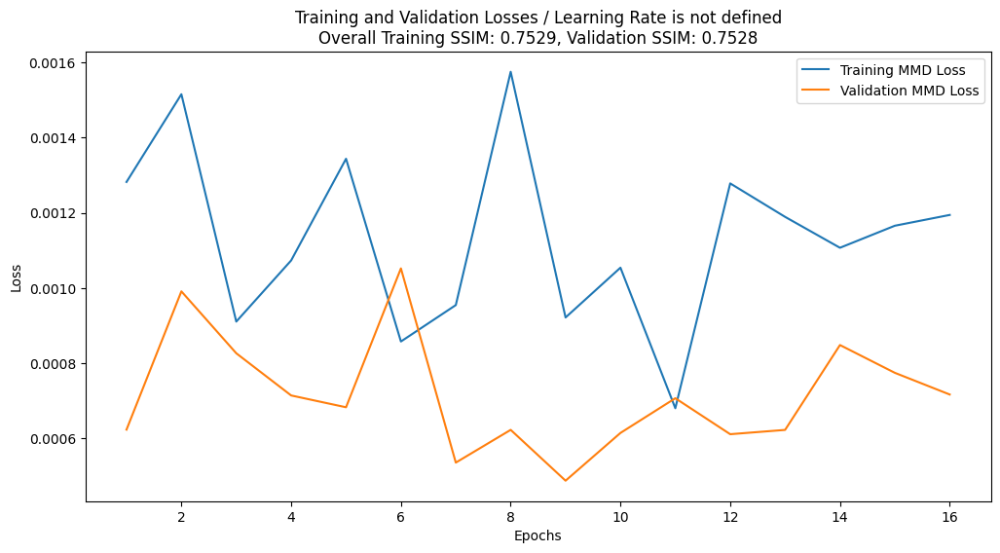

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

# Set dimension list for loop
dimension = [40]
# dimension = [2]
for i in dimension:
    # Set parameters
    z_dim = i
    total_epochs = 200
    batch_size = 128

    # Load your data
    # raw = np.load('testdata.npy')
    raw = listOfTopographicMapsForAE  # Replace with your actual data variable
    print(raw.shape)

    train_ratio = 0.7
    val_ratio = 0.15
    test_ratio = 0.15

    #Normalise the data
    dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
    dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

    # First split: 70% training and 30% remaining (to be split into validation and test)
    data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

    # Second split: 15% validation and 15% testing from the remaining 30%
    data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
    #data_train.shape,data_test.shape,data_val.shape
    '''
    # Flatten the data to make it easier to compute Z-scores
    data_train_flat = data_train.reshape(data_train.shape[0], -1)

    # Calculate Z-scores
    z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

    # Set a Z-score threshold (e.g., 3)
    threshold = 3

    # Identify outliers
    outliers = np.where(z_scores > threshold)

    # Filter out the outliers
    filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
    data_train_filtered = data_train[filtered_indices]
    '''
   #Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
    en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1= Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    #Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
        return mu + K.exp(sigma)*eps
    latent_space = Lambda(compute_latent)([mu, sigma])

    #Build the encoder
    encoder = Model(encoder_input,[mu,sigma,latent_space], name='encoder')
    #plot_model(encoder, show_shapes=True)
    encoder.summary()

    #Design the decoder'
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1]*en_conv3.shape[2]*en_conv3.shape[3], activation='relu')(decoder_input )
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2],en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    # plot_model(decoder, show_shapes=True)
    decoder.summary()

    ## MMD Functions
    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
        tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

    def compute_mmd(x, y, sigma_sqr=1.0):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    class CustomLossLayer(tf.keras.Model):
        def __init__(self, encoder, decoder):
            super(CustomLossLayer, self).__init__()
            self.encoder = encoder
            self.decoder = decoder
            self.epoch_loss_mmd = []  # Track batch losses per epoch

        def train_step(self, data):
            x = data  # Since we have no labels
            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent_space = self.encoder(x)
                # Sample train_z from prior distribution
                train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
                xr = self.decoder(latent_space)

                # Custom loss
                true_samples = tf.random.normal(tf.stack([200, z_dim]))
                loss_mmd = compute_mmd(true_samples, latent_space)
                loss_nll = tf.reduce_mean(tf.square(xr - x))
                total_loss = loss_mmd + loss_nll

            # Compute gradients
            gradients = tape.gradient(loss_mmd, self.trainable_variables)
            # Apply gradients
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

            # Debug: Print batch loss

            # Track batch losses for averaging at epoch level
            self.epoch_loss_mmd.append(loss_mmd)  # Store the tensor

            # Return loss for progress bar
            return {'loss': total_loss, 'loss_mmd': loss_mmd}
        '''
        def on_epoch_end(self, epoch, logs=None):
            # Compute and log the average loss for the epoch
            average_loss_mmd = tf.reduce_mean(self.epoch_loss_mmd)  # Use TensorFlow to compute mean
            tf.print(f"Epoch {epoch + 1}: Average Loss MMD = {average_loss_mmd}")
            self.epoch_loss_mmd = []  # Reset for the next epoch
        '''

        def test_step(self, data):
            x = data  # Validation data
            mu, sigma, latent_space = self.encoder(x)
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)
            true_samples = tf.random.normal(tf.stack([200, z_dim]))
            loss_mmd = compute_mmd(true_samples, train_z)
            loss_nll = tf.reduce_mean(tf.square(xr - x))
            total_loss = loss_mmd + loss_nll

            return {'loss': total_loss, 'loss_mmd': loss_mmd}

        def calculate_overall_ssim(self, data):
            """
            Calculate the overall SSIM score for the dataset.
            """
            _, _, latent_space = self.encoder(data)
            reconstructed = self.decoder(latent_space)
            reconstructed = tf.cast(reconstructed, tf.float64)
            overall_ssim = tf.reduce_mean(tf.image.ssim(data, reconstructed, max_val=1.0))
            return overall_ssim.numpy()



    # Instantiate the custom autoencoder model
    autoencoder = CustomLossLayer(encoder, decoder)
    # Compile the model
    #autoencoder.compile(optimizer='adam')
    autoencoder.compile(optimizer='adam')

    # Prepare to track the losses
    loss_mmd_list = []
    loss_nll_list = []
    loss_total_list = []


    # Custom callback to store losses
    class LossHistory(tf.keras.callbacks.Callback):
        def on_epoch_end(self, epoch, logs=None):
            loss_mmd_list.append(logs.get('loss_mmd'))
            loss_nll_list.append(logs.get('loss_nll'))
            loss_total_list.append(logs.get('loss'))

    # Define callbacks
    myCallBacks = [
        EarlyStopping(monitor='loss_mmd', patience=5, mode='min'),LossHistory(),]

    # Train the model
    history = autoencoder.fit(
        data_train,
        epochs=total_epochs,
        batch_size=batch_size,
        validation_data=data_val,  # No labels needed
        callbacks=myCallBacks,
    )


    # Calculate SSIM for training and validation datasets
    overall_ssim_train = autoencoder.calculate_overall_ssim(data_train)
    overall_ssim_val = autoencoder.calculate_overall_ssim(data_val)
    print(f"Overall Training SSIM: {overall_ssim_train:.4f}")
    print(f"Overall Validation SSIM: {overall_ssim_val:.4f}")

    # Plot the losses
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/VAE'
    model_name = f'autoencoder_dim{z_dim}'
    epochs_range = range(1, len(loss_mmd_list) + 1)

    plt.figure(figsize=(12, 6))
    plt.plot(epochs_range, loss_mmd_list, label='Training MMD Loss')

    # Get validation losses from history
    val_loss_mmd_list = history.history.get('val_loss_mmd')

    if val_loss_mmd_list is not None:
        plt.plot(epochs_range, val_loss_mmd_list, label='Validation MMD Loss')

    plt.title(f'Training and Validation Losses / Learning Rate is not defined\nOverall Training SSIM: {overall_ssim_train:.4f}, Validation SSIM: {overall_ssim_val:.4f}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plot_path = os.path.join(save_dir, f'{model_name}_loss_curves7.png')
    plt.savefig(plot_path)
    print(f"Loss plot saved to {plot_path}")
    plt.show()

    # Save the history and model
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)

(24567, 40, 40)


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_92            │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_181 (Conv2D)       │ (None, 20, 20, 32)     │            544 │ input_layer_92[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_181           │ (None, 20, 20, 32)     │              0 │ conv2d_181[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_182 (Conv2D)       │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_181[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_182           │ (None, 10, 10, 64)     │              0 │ conv2d_182[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_183 (Conv2D)       │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_182[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_183           │ (None, 5, 5, 128)      │              0 │ conv2d_183[0][0]       │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_46 (Flatten)      │ (None, 3200)           │              0 │ leaky_re_lu_183[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_138 (Dense)         │ (None, 40)             │        128,040 │ flatten_46[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_139 (Dense)         │ (None, 40)             │        128,040 │ flatten_46[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_46 (Lambda)        │ (None, 40)             │              0 │ dense_138[0][0],       │
│                           │                        │                │ dense_139[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 420,656 (1.60 MB)

 Trainable params: 420,656 (1.60 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_93 (InputLayer)          │ (None, 40)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_140 (Dense)                    │ (None, 3200)                │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_46 (Reshape)                 │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_181                 │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_182                 │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_184                 │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 525,633 (2.01 MB)

 Trainable params: 525,633 (2.01 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0015 - loss_mmd: 0.0015 - val_loss: 3.4444e-04 - val_loss_nll: 3.4444e-04
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.3290e-04 - loss_mmd: 1.3290e-04 - val_loss: 7.0539e-05 - val_loss_nll: 7.0539e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 4.0729e-05 - loss_mmd: 4.0729e-05 - val_loss: 3.1875e-05 - val_loss_nll: 3.1875e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 2.1746e-05 - loss_mmd: 2.1746e-05 - val_loss: 2.1697e-05 - val_loss_nll: 2.1697e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.4232e-05 - loss_mmd: 1.4232e-05 - val_loss: 1.4303e-05 - val_loss_nll: 1.4303e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 9.8107e-06 - loss_mmd: 9.8107e-06 - val_loss: 1.2789e-05 - val_loss_nll: 1.2789e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 8.0989e-06 - loss_mmd: 8.0989e-06 - val_loss: 8.4974e-06 - val_loss_nll: 8.4

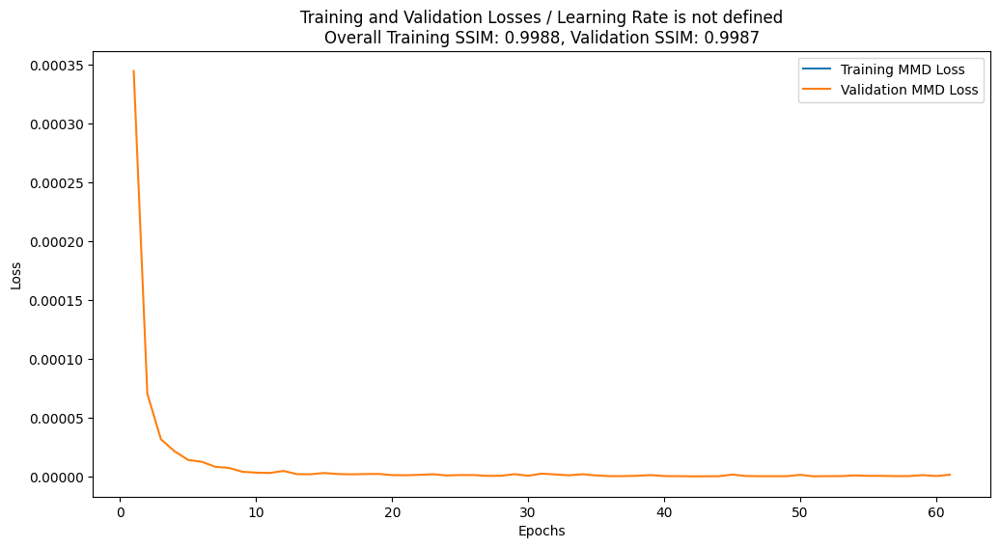

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

# Set dimension list for loop
dimension = [40]
# dimension = [2]
for i in dimension:
    # Set parameters
    z_dim = i
    total_epochs = 200
    batch_size = 32

    # Load your data
    # raw = np.load('testdata.npy')
    raw = listOfTopographicMapsForAE  # Replace with your actual data variable
    print(raw.shape)

    train_ratio = 0.7
    val_ratio = 0.15
    test_ratio = 0.15

    #Normalise the data
    dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
    dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

    # First split: 70% training and 30% remaining (to be split into validation and test)
    data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

    # Second split: 15% validation and 15% testing from the remaining 30%
    data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
    #data_train.shape,data_test.shape,data_val.shape

    # Flatten the data to make it easier to compute Z-scores
    data_train_flat = data_train.reshape(data_train.shape[0], -1)

    # Calculate Z-scores
    z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

    # Set a Z-score threshold (e.g., 3)
    threshold = 3

    # Identify outliers
    outliers = np.where(z_scores > threshold)

    # Filter out the outliers
    filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
    data_train_filtered = data_train[filtered_indices]

   #Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
    en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1= Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    #Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
        return mu + K.exp(sigma)*eps
    latent_space = Lambda(compute_latent)([mu, sigma])

    #Build the encoder
    encoder = Model(encoder_input,[mu,sigma,latent_space], name='encoder')
    #plot_model(encoder, show_shapes=True)
    encoder.summary()

    #Design the decoder'
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1]*en_conv3.shape[2]*en_conv3.shape[3], activation='relu')(decoder_input )
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2],en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    # plot_model(decoder, show_shapes=True)
    decoder.summary()

    ## MMD Functions
    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
        y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
        tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
        tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
        return tf.exp(
            -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
        )

    def compute_mmd(x, y):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return (
            tf.reduce_mean(x_kernel)
            + tf.reduce_mean(y_kernel)
            - 2 * tf.reduce_mean(xy_kernel)
        )

    class CustomLossLayer(tf.keras.Model):
        def __init__(self, encoder, decoder):
            super(CustomLossLayer, self).__init__()
            self.encoder = encoder
            self.decoder = decoder
            self.epoch_loss_nll = []  # Track batch losses per epoch

        def train_step(self, data):
            x = data  # Since we have no labels
            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent_space = self.encoder(x)
                # Sample train_z from prior distribution
                train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
                xr = self.decoder(latent_space)

                # Custom loss
                #loss_mmd = compute_mmd(latent_space, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x))
                total_loss = loss_nll

            # Compute gradients
            gradients = tape.gradient(loss_nll, self.trainable_variables)
            # Apply gradients
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

            # Debug: Print batch loss

            # Track batch losses for averaging at epoch level
            self.epoch_loss_nll.append(loss_nll)  # Store the tensor

            # Return loss for progress bar
            return {'loss': total_loss, 'loss_mmd': loss_nll}
        '''
        def on_epoch_end(self, epoch, logs=None):
            # Compute and log the average loss for the epoch
            average_loss_mmd = tf.reduce_mean(self.epoch_loss_mmd)  # Use TensorFlow to compute mean
            tf.print(f"Epoch {epoch + 1}: Average Loss MMD = {average_loss_mmd}")
            self.epoch_loss_mmd = []  # Reset for the next epoch
        '''

        def test_step(self, data):
            x = data  # Validation data
            mu, sigma, latent_space = self.encoder(x)
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)
            #loss_mmd = compute_mmd(latent_space, train_z)
            loss_nll = tf.reduce_mean(tf.square(xr - x))
            total_loss = loss_nll

            return {'loss': total_loss, 'loss_nll': loss_nll}

        def calculate_overall_ssim(self, data):
            """
            Calculate the overall SSIM score for the dataset.
            """
            _, _, latent_space = self.encoder(data)
            reconstructed = self.decoder(latent_space)
            reconstructed = tf.cast(reconstructed, tf.float64)
            overall_ssim = tf.reduce_mean(tf.image.ssim(data, reconstructed, max_val=1.0))
            return overall_ssim.numpy()



    # Instantiate the custom autoencoder model
    autoencoder = CustomLossLayer(encoder, decoder)
    # Compile the model
    #autoencoder.compile(optimizer='adam')
    autoencoder.compile(optimizer='adam')

    # Prepare to track the losses
    #loss_mmd_list = []
    loss_nll_list = []
    loss_total_list = []


    # Custom callback to store losses
    class LossHistory(tf.keras.callbacks.Callback):
        def on_epoch_end(self, epoch, logs=None):
            #loss_mmd_list.append(logs.get('loss_mmd'))
            loss_nll_list.append(logs.get('loss_nll'))
            loss_total_list.append(logs.get('loss'))

    # Define callbacks
    myCallBacks = [
        EarlyStopping(monitor='loss_mmd', patience=10, mode='min'),LossHistory(),]

    # Train the model
    history = autoencoder.fit(
        data_train_filtered,
        epochs=total_epochs,
        batch_size=batch_size,
        validation_data=data_val,  # No labels needed
        callbacks=myCallBacks,
    )


    # Calculate SSIM for training and validation datasets
    overall_ssim_train = autoencoder.calculate_overall_ssim(data_train)
    overall_ssim_val = autoencoder.calculate_overall_ssim(data_val)
    print(f"Overall Training SSIM: {overall_ssim_train:.4f}")
    print(f"Overall Validation SSIM: {overall_ssim_val:.4f}")

    # Plot the losses
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/VAE'
    model_name = f'autoencoder_dim{z_dim}'
    epochs_range = range(1, len(loss_nll_list) + 1)

    plt.figure(figsize=(12, 6))
    plt.plot(epochs_range, loss_nll_list, label='Training MMD Loss')

    # Get validation losses from history
    val_loss_nll_list = history.history.get('val_loss_nll')

    if val_loss_nll_list is not None:
        plt.plot(epochs_range, val_loss_nll_list, label='Validation MMD Loss')

    plt.title(f'Training and Validation Losses / Learning Rate is not defined\nOverall Training SSIM: {overall_ssim_train:.4f}, Validation SSIM: {overall_ssim_val:.4f}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plot_path = os.path.join(save_dir, f'{model_name}_loss_curves7.png')
    plt.savefig(plot_path)
    print(f"Loss plot saved to {plot_path}")
    plt.show()

    # Save the history and model
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)

## Predicted images

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


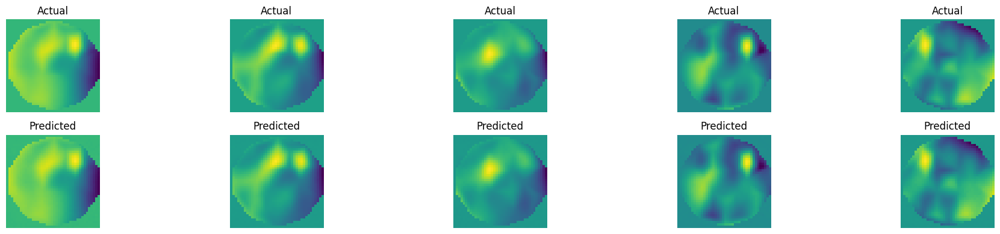

In [ ]:
# Select a subset of actual images from the test set
num_images = 5  # Number of images to display per row
actual_images = data_test[:num_images]

# Generate predicted images for the selected actual images
_, _, latent_vectors = encoder.predict(actual_images)
predicted_images = decoder.predict(latent_vectors)

# Visualize the actual and predicted images
fig, axes = plt.subplots(nrows=2, ncols=num_images, sharex=True, sharey=True, figsize=(20, 4))

# First row: actual images
for i, ax in enumerate(axes[0]):
    ax.imshow(actual_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
    ax.set_title("Actual")
    ax.axis('off')

# Second row: predicted images
for i, ax in enumerate(axes[1]):
    ax.imshow(predicted_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
    ax.set_title("Predicted")
    ax.axis('off')

plt.tight_layout()
plt.savefig('Actual_vs_Predicted_Comparison.png')
plt.show()

# Optional: Save denormalized predicted images for further evaluation
denormalized_predicted_images = (
    predicted_images * (raw.max() - raw.min())
) + raw.min()


###not needed


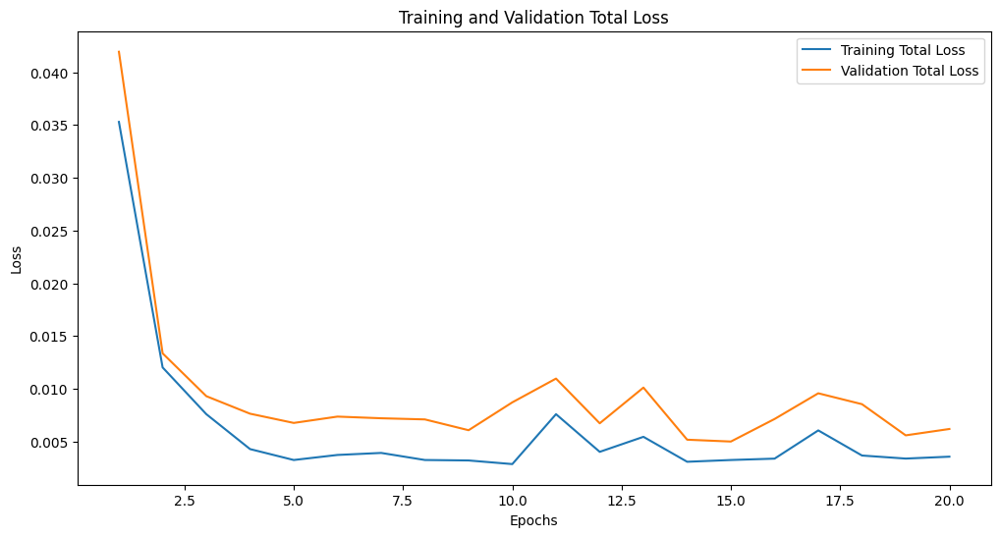

In [ ]:
# Plot the total losses
# Access total training and validation losses
total_loss_list = history.history['loss']
val_total_loss_list = history.history.get('val_loss')

epochs_range = range(1, len(total_loss_list) + 1)

plt.figure(figsize=(12, 6))
plt.plot(epochs_range, total_loss_list, label='Training Total Loss')
if val_total_loss_list is not None:
    plt.plot(epochs_range, val_total_loss_list, label='Validation Total Loss')

plt.title('Training and Validation Total Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [ ]:
loss_mmd_list = history.history['loss_mmd']
loss_nll_list = history.history['loss_nll']

val_loss_mmd_list = history.history.get('val_loss_mmd')
val_loss_nll_list = history.history.get('val_loss_nll')


In [ ]:
print("MMD Loss History:", loss_tracker.mmd_losses)
print("NLL Loss History:", loss_tracker.nll_losses)


NameError: name 'loss_tracker' is not defined

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten,Lambda
from tensorflow.keras.models import Model
from keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.datasets import mnist
from tensorflow.keras.callbacks import  EarlyStopping, Callback
from skimage import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

epochs = 200
batch_size = 32

# Normalising the data and splitting
raw = listOfTopographicMapsForAE
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - 0.7), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=0.15/(0.15 + 0.15), random_state=42, shuffle=True)

# Set a Z-score threshold
#threshold = 3

# Filter outliers
#z_scores = np.abs(stats.zscore(data_train.reshape(data_train.shape[0], -1), axis=0))
#outliers = np.where(z_scores > threshold)
#threshold = 3
#filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
#data_train_filtered = data_train[filtered_indices]

dimensions = [40]
for z_dim in dimensions:
    # Define encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))
    en_conv1 = Conv2D(32, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(encoder_input)
    en_conv2 = Conv2D(64, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv1)
    en_conv3 = Conv2D(128, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv2)
    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    # Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = tf.shape(mu)[0]
        eps = tf.random.normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + tf.exp(sigma) * eps

    latent_space = Lambda(compute_latent, name='embedding')([mu, sigma])

    # Build the encoder
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Define decoder
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(128, 4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(64, 4, strides=2, activation='relu', padding='same')(de_conv1)
    decoder_output = Conv2DTranspose(1, 4, strides=2, activation='sigmoid', padding='same')(de_conv2)
    decoder = Model(decoder_input, decoder_output, name='decoder')

    # Build the autoencoder for training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
        y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
        tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
        tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32'))

    def compute_mmd(x, y):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    #function for loss function
    def custom_loss(latent_space, train_z, train_xr, train_x):
        loss_mmd = compute_mmd(latent_space, train_z)
        'Then, also get the reconstructed loss'
        loss_nll = K.mean(K.square(train_xr - train_x))
        'Add them together, then you can get the final loss'
        loss = loss_nll + loss_mmd
        return loss

    outputs = custom_loss(latent_space, train_z, train_xr, encoder_input)
    autoencoder = Model(encoder_input, outputs)
    autoencoder.compile(optimizer='adam')
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')

    # Custom callback to track individual losses
    class LossHistory(Callback):
        def on_train_begin(self, logs=None):
            self.mmd_losses = []
            self.nll_losses = []
        def on_epoch_end(self, epoch, logs=None):
            batch = data_train[np.random.randint(0, data_train.shape[0], batch_size)]
            batch = tf.convert_to_tensor(batch, dtype=tf.float32)
            mu, sigma, train_z = encoder(batch)
            train_xr = decoder(train_z)
            loss_mmd = compute_mmd(latent_space, train_z)
            loss_nll = tf.reduce_mean(tf.square(train_xr - batch))
            self.mmd_losses.append(loss_mmd.numpy())
            self.nll_losses.append(loss_nll.numpy())

    loss_history = LossHistory()

    # Train the model
    history = autoencoder.fit(
        data_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(data_val, None),
        callbacks=[myCallBacks, loss_history]
    )

    # Plot the loss values over each epoch
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Total Training Loss')
    if 'val_loss' in history.history:
        plt.plot(history.history['val_loss'], label='Total Validation Loss')
    plt.plot(loss_history.mmd_losses, label='MMD Loss')
    plt.plot(loss_history.nll_losses, label='NLL Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Loss vs Epochs')
    plt.show()

    # Save the history and model
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
    model_name = f'autoencoder_dim{z_dim}'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)


Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_80 (InputLayer)          │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 40), (None, 40),    │         420,656 │
│                                      │ (None, 40)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         525,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 946,289 (3.61 MB)

 Trainable params: 946,289 (3.61 MB)

 Non-trainable params: 0 (0.00 B)

ValueError: A KerasTensor cannot be used as input to a TensorFlow function. A KerasTensor is a symbolic placeholder for a shape and dtype, used when constructing Keras Functional models or Keras Functions. You can only use it as input to a Keras layer or a Keras operation (from the namespaces `keras.layers` and `keras.operations`). You are likely doing something like:

```
x = Input(...)
...
tf_fn(x)  # Invalid.
```

What you should do instead is wrap `tf_fn` in a layer:

```
class MyLayer(Layer):
    def call(self, x):
        return tf_fn(x)

x = MyLayer()(x)
```


In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten,Lambda
from tensorflow.keras.models import Model
from keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.datasets import mnist
from tensorflow.keras.callbacks import  EarlyStopping, Callback
from skimage import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

epochs = 200
batch_size = 32

# Normalising the data and splitting
raw = listOfTopographicMapsForAE
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - 0.7), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=0.15/(0.15 + 0.15), random_state=42, shuffle=True)

# Set a Z-score threshold
#threshold = 3

# Filter outliers
#z_scores = np.abs(stats.zscore(data_train.reshape(data_train.shape[0], -1), axis=0))
#outliers = np.where(z_scores > threshold)
#threshold = 3
#filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
#data_train_filtered = data_train[filtered_indices]

dimensions = [40]
for z_dim in dimensions:
    # Define encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))
    en_conv1 = Conv2D(32, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(encoder_input)
    en_conv2 = Conv2D(64, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv1)
    en_conv3 = Conv2D(128, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv2)
    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    # Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = tf.shape(mu)[0]
        eps = tf.random.normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + tf.exp(sigma) * eps

    latent_space = Lambda(compute_latent, name='embedding')([mu, sigma])

    # Build the encoder
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Define decoder
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(128, 4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(64, 4, strides=2, activation='relu', padding='same')(de_conv1)
    decoder_output = Conv2DTranspose(1, 4, strides=2, activation='sigmoid', padding='same')(de_conv2)
    decoder = Model(decoder_input, decoder_output, name='decoder')

    # Build the autoencoder for training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    def compute_kernel(x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
        tiled_y = tf.tile(tf.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
        return K.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32'))

    def compute_mmd(x, y):
        x_kernel = compute_kernel(x, x)
        y_kernel = compute_kernel(y, y)
        xy_kernel = compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    @tf.keras.utils.register_keras_serializable()
    class CustomLossLayer(tf.keras.layers.Layer):
        def compute_output_shape(self, input_shape):
            return input_shape[1]
        def call(self, inputs):
            train_z, train_xr, train_x = inputs
            batch_size = tf.shape(train_z)[0]
            latent_dim = tf.shape(train_z)[1]
            reference_samples = tf.random.normal(shape=(batch_size, latent_dim), mean=0., stddev=1.0)
            loss_mmd = compute_mmd(reference_samples, train_z)
            loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
            self.add_loss(loss_mmd)
            self.add_loss(loss_nll)
            return train_xr

    outputs = CustomLossLayer()([train_z, train_xr, encoder_input])
    autoencoder = Model(encoder_input, outputs)
    autoencoder.compile(optimizer='adam')
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')

    # Custom callback to track individual losses
    class LossHistory(Callback):
        def on_train_begin(self, logs=None):
            self.mmd_losses = []
            self.nll_losses = []
        def on_epoch_end(self, epoch, logs=None):
            batch = data_train[np.random.randint(0, data_train.shape[0], batch_size)]
            batch = tf.convert_to_tensor(batch, dtype=tf.float32)
            mu, sigma, train_z = encoder(batch)
            train_xr = decoder(train_z)
            latent_dim = tf.shape(train_z)[1]
            reference_samples = tf.random.normal(shape=(batch_size, latent_dim), mean=0., stddev=1.0)
            loss_mmd = compute_mmd(reference_samples, train_z)
            loss_nll = tf.reduce_mean(tf.square(train_xr - batch))
            self.mmd_losses.append(loss_mmd.numpy())
            self.nll_losses.append(loss_nll.numpy())

    loss_history = LossHistory()

    # Train the model
    history = autoencoder.fit(
        data_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(data_val, None),
        callbacks=[myCallBacks, loss_history]
    )

    # Plot the loss values over each epoch
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Total Training Loss')
    if 'val_loss' in history.history:
        plt.plot(history.history['val_loss'], label='Total Validation Loss')
    plt.plot(loss_history.mmd_losses, label='MMD Loss')
    plt.plot(loss_history.nll_losses, label='NLL Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Loss vs Epochs')
    plt.show()

    # Save the history and model
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
    model_name = f'autoencoder_dim{z_dim}'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)


Model: "functional_93"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_87 (InputLayer)          │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 40), (None, 40),    │         420,656 │
│                                      │ (None, 40)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         525,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 946,289 (3.61 MB)

 Trainable params: 946,289 (3.61 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200


KeyboardInterrupt: 

###test

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten,Lambda
from tensorflow.keras.models import Model
from keras.utils import plot_model
import pdb
from tensorflow.keras import backend as K
from tensorflow.keras.datasets import mnist
from tensorflow.keras.callbacks import  EarlyStopping, Callback
from skimage import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from scipy import stats
import csv

epochs = 200
batch_size = 32

# Normalising the data and splitting
raw = listOfTopographicMapsForAE
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - 0.7), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=0.15/(0.15 + 0.15), random_state=42, shuffle=True)

# Set a Z-score threshold
#threshold = 3

# Filter outliers
#z_scores = np.abs(stats.zscore(data_train.reshape(data_train.shape[0], -1), axis=0))
#outliers = np.where(z_scores > threshold)
#threshold = 3
#filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
#data_train_filtered = data_train[filtered_indices]

class CustomLossLayer(Layer):
    def __init__(self, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)

    def compute_kernel(self, x, y):
        x_size = tf.shape(x)[0]
        y_size = tf.shape(y)[0]
        dim = tf.shape(x)[1]
        tiled_x = tf.tile(tf.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
        tiled_y = tf.tile(tf.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
        return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32'))

    def compute_mmd(self, x, y):
        x_kernel = self.compute_kernel(x, x)
        y_kernel = self.compute_kernel(y, y)
        xy_kernel = self.compute_kernel(x, y)
        return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs  # Assuming these are your inputs
        loss_mmd = self.compute_mmd(latent_space, train_z)
        loss_nll = K.mean(K.square(train_xr - train_x))
        # Ensure loss_mmd is not None before adding it to the losses
        if loss_mmd is not None:
            self.add_loss(loss_mmd)
        self.add_loss(loss_nll)  # Add reconstruction loss to the model's losses
        return train_xr  # Return the reconstructed output

class LossHistory(Callback):
    def on_train_begin(self, logs={}):
        self.mmd_losses = []
        self.nll_losses = []
        self.total_losses = []
    def on_epoch_end(self, epoch, logs={}):
        # Calculate total loss using your custom_loss function
        batch = data_train[np.random.randint(0, data_train.shape[0], batch_size)]
        batch = tf.convert_to_tensor(batch, dtype=tf.float32)

        mu, sigma, latent_space_batch = encoder(batch)
        train_xr_batch = decoder(latent_space_batch)

        total_loss = custom_loss(latent_space_batch, latent_space_batch, train_xr_batch, batch).numpy()
        self.total_losses.append(total_loss)  # Store total loss

        # Calculate MMD loss using mmd_layer
        loss_mmd = CustomLossLayer.compute_mmd(latent_space_batch, latent_space_batch).numpy()
        self.mmd_losses.append(loss_mmd)

        loss_nll = np.mean(np.square(train_xr_batch.numpy() - batch.numpy()))  # NumPy calculation here
        self.nll_losses.append(loss_nll)

        # Calculate reconstruction loss (total loss - MMD loss)
        total_loss = loss_mmd + loss_nll
        self.total_losses.append(total_loss)

dimensions = [40]
for z_dim in dimensions:
    # Define encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))
    en_conv1 = Conv2D(32, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(encoder_input)
    en_conv2 = Conv2D(64, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv1)
    en_conv3 = Conv2D(128, 4, strides=2, padding='same', activation=LeakyReLU(0.1))(en_conv2)
    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    # Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = tf.shape(mu)[0]
        eps = tf.random.normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + tf.exp(sigma) * eps

    latent_space = Lambda(compute_latent, name='embedding')([mu, sigma])

    # Build the encoder
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Define decoder
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(128, 4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(64, 4, strides=2, activation='relu', padding='same')(de_conv1)
    decoder_output = Conv2DTranspose(1, 4, strides=2, activation='sigmoid', padding='same')(de_conv2)
    decoder = Model(decoder_input, decoder_output, name='decoder')

    # Build the autoencoder for training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    custom_loss_layer = CustomLossLayer()
    outputs = custom_loss_layer([latent_space, train_z, train_xr, encoder_input])
    autoencoder.compile(optimizer='adam',  loss=lambda y_true, y_pred: y_pred)
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')

    loss_history = LossHistory()

    # Train the model
    history = autoencoder.fit(
        data_train,
        epochs=epochs,
        batch_size=batch_size,
        validation_data=(data_val, None),
        callbacks=[myCallBacks, loss_history]
    )

    # Plot the loss values over each epoch
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Total Training Loss')
    if 'val_loss' in history.history:
        plt.plot(history.history['val_loss'], label='Total Validation Loss')
    plt.plot(loss_history.mmd_losses, label='MMD Loss')
    plt.plot(loss_history.nll_losses, label='NLL Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Loss vs Epochs')
    plt.show()

    # Save the history and model
    save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
    model_name = f'autoencoder_dim{z_dim}'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    autoencoder.save(f'{save_dir}/{model_name}.h5')
    autoencoder.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')
    np.save(f'{save_dir}/{model_name}_history.npy', history.history)


Model: "functional_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_100 (InputLayer)         │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 40), (None, 40),    │         420,656 │
│                                      │ (None, 40)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         525,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 946,289 (3.61 MB)

 Trainable params: 946,289 (3.61 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200


ValueError: None values not supported.

#Clustering Loss only

Training DCEC with z_dim=40 and n_clusters=20...
...Pretraining autoencoder...
Epoch 1/200


/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 9ms/step - loss: 0.0024 - loss_mmd: 0.0024
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 9/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 10/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 11/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 12/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/ste

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.01401944, Unweighted Clustering Loss: 0.01401944
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 0.01557286, Unweighted Clustering Loss: 0.01557286
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 0.01220440, Unweighted Clustering Loss: 0.01220440
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 3, Unweighted Total Loss: 0.01237827, Unweighted Clustering Loss: 0.01237827
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 4, Unweighted Total Loss: 0.01319533, Unweighted Clustering Loss: 0.01319533
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluste

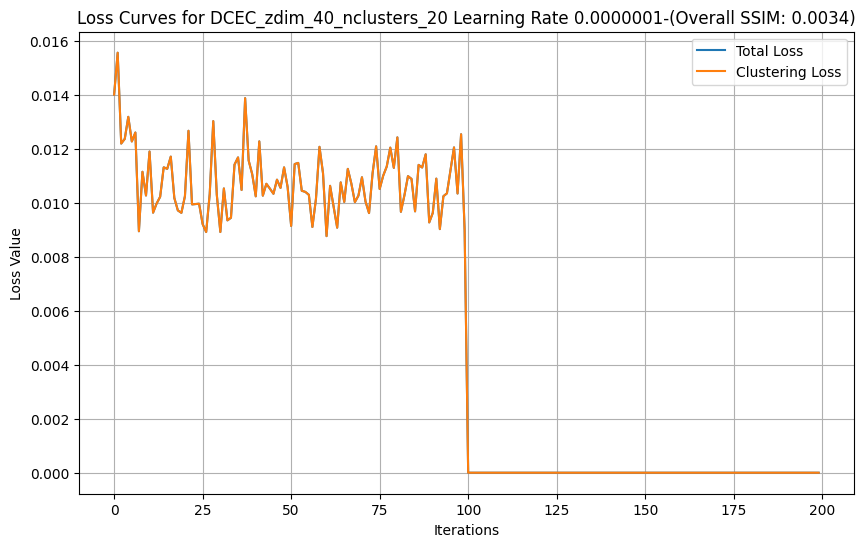

Model saved for z_dim=40 and n_clusters=20


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/Clustering Loss'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

        # Ensure the variables of encoder and decoder are tracked
        self._trainable_variables = self.encoder.trainable_variables + self.decoder.trainable_variables


    @property
    def trainable_variables(self):
        return self._trainable_variables

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)

            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)

            # Dynamic weight adjustment

            mmd_loss = loss_mmd
            total_loss = mmd_loss
            # Dynamically scale NLL
            #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)

        # Compute gradients
        gradients = tape.gradient(total_loss, self.trainable_variables)
        # Apply gradients
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Log dynamic weights for debugging
        #tf.print("Epoch", self.current_epoch + 1, ": w1=", w1, ", w2=", w2, ", loss=", total_loss)
        # Return a dictionary mapping metric names to current value
        return {'loss': total_loss, 'loss_mmd': mmd_loss}

    def on_epoch_end(self, epoch, logs=None):
        # Update current epoch at the end of each epoch
        self.current_epoch += 1

    def test_step(self, data):
        x = data  # Validation data

        # Forward pass
        mu, sigma, latent_space = self.encoder(x)
        train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
        xr = self.decoder(latent_space)

        # Compute losses
        loss_mmd = compute_mmd(latent_space, train_z)

        total_loss = loss_mmd
        # Dynamically scale NLL
        #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)
        return {'loss': total_loss, 'loss_mmd': mmd_loss}

# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam', learning_rate=0.0000001):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv1)
        en_conv2 = BatchNormalization()(en_conv2)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv2)
        en_conv3 = BatchNormalization()(en_conv3)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters=256, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.01))(en_conv3)
        en_conv4 = BatchNormalization()(en_conv4)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1 = Flatten()(en_conv4)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        def compute_latent(x):
            mu, sigma = x
            batch = tf.shape(mu)[0]
            eps = tf.random.normal(shape=(batch, self.z_dim), mean=0., stddev=1.)
            return mu + tf.exp(sigma) * eps

        latent_space = Lambda(compute_latent, name='latent_space')([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(
            en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu'
        )(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(
            filters=128, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_fc2)
        de_conv2 = Conv2DTranspose(
            filters=64, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv1)
        de_conv3 = Conv2DTranspose(
            filters=32, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv2)
        decoder_output = Conv2DTranspose(
            filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same'
        )(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=32, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # Build autoencoder model for pretraining
        autoencoder = CustomLossLayer(self.encoder, self.decoder, total_epochs = epochs)
        autoencoder.compile(optimizer=optimizer)

        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        p = weight / weight_sum
        return p

    def fit(self, x, y=None, batch_size=32, maxiter=200, tol=1e-2, update_interval=100, save_dir='save_dir', patience=10):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_loss_list = []
        clustering_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_loss = loss_clustering

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))


                # Track unweighted losses
                total_loss_list.append(total_loss.numpy())
                clustering_loss_list.append(loss_clustering.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_loss.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}")

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(total_loss_list, clustering_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, total_loss_list, clustering_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/Clustering Loss'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(total_loss_list, label='Total Loss')
        plt.plot(clustering_loss_list, label='Clustering Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate 0.0000001-(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_loss_curves_6.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = [20]

for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=32, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=32, update_interval=100, save_dir='save_dir', patience=10)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/Clustering Loss'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')


#DCEC with joint training

In [ ]:
from sklearn.model_selection import train_test_split

# Load your data
# raw = np.load('testdata.npy')
raw = listOfTopographicMapsForAE  # Replace with your actual data variable
print(raw.shape)

train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

# Normalize the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

# Split the data into training, validation, and test sets
data_train, data_remaining = train_test_split(
    dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True
)
data_val, data_test = train_test_split(
    data_remaining,
    test_size=test_ratio / (test_ratio + val_ratio),
    random_state=42,
    shuffle=True,
)

(24567, 40, 40)


## V1

In [ ]:
from sklearn.cluster import KMeans
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.keras.models import Model
import tensorflow.keras.backend as K
from tensorflow.keras.callbacks import  EarlyStopping
import numpy as np
import os

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(name='clusters', shape=(self.n_clusters, input_dim), initializer='glorot_uniform')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q


#Add custom loss layer
## MMD Functions
def compute_kernel(x, y):
    x_size = K.shape(x)[0]
    y_size = K.shape(y)[0]
    dim = K.shape(x)[1]
    tiled_x = K.tile(K.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
    tiled_y = K.tile(K.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
    return K.exp(-K.mean(K.square(tiled_x - tiled_y), axis=2) / K.cast(dim, 'float32'))

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return K.mean(x_kernel) + K.mean(y_kernel) - 2 * K.mean(xy_kernel)

# MMD Functions
@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def __init__(self, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)
        self.loss_mmd = None  # Initialize to None
        self.loss_nll = None  # Initialize to None

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs
        #Compute MMD
        self.loss_mmd = compute_mmd(latent_space, train_z)
        #Compute NLL
        self.loss_nll = K.mean(K.square(train_xr - train_x))
        #Add both losses
        self.add_loss(self.loss_mmd + self.loss_nll)
        return train_xr

# Define DCEC with Custom Loss Layer
class DCEC:
    def __init__(self, z_dim, encoder, decoder, n_clusters=10, alpha=1.0):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.z_dim = z_dim
        self.encoder = encoder
        self.decoder = decoder

        # Extract the encoder input
        encoder_input = self.encoder.input

        # Define compute_latent function
        def compute_latent(x):
            mu, sigma = x
            batch = K.shape(mu)[0]
            eps = K.random_normal(shape=(batch, self.z_dim), mean=0., stddev=1.)
            return mu + K.exp(sigma) * eps

        # Compute latent space
        mu = Dense(z_dim, name='mu_layer')(en_fc1)
        sigma = Dense(z_dim, name='sigma_layer')(en_fc1)  # Assuming a layer named 'sigma_layer' for sigma
        latent_space = Lambda(compute_latent, name='embedding')([mu, sigma])

        # Build the autoencoder for training
        train_z = self.encoder(encoder_input)[2]  # Get the latent representation
        train_xr = self.decoder(train_z)  # Reconstruct the input

        # Clustering layer on top of the latent space
        clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')(train_z)

        # Use custom loss layer to combine latent, reconstruction, and input
        self.custom_loss_layer = CustomLossLayer(name='custom_loss_layer')
        reconstruction_output = self.custom_loss_layer([latent_space, train_z, train_xr, encoder_input])

        # Define the complete model with clustering and reconstruction
        self.model = Model(inputs=encoder_input, outputs=[clustering_layer, reconstruction_output])

    def pretrain(self, x, batch_size=32, epochs=200, optimizer='adam', save_dir='/content/drive/MyDrive/Masters Dataset/DCEC'):
        # Pretraining the autoencoder with the custom loss
        print('...Pretraining autoencoder with custom loss...')
        # Use encoder and decoder to build an autoencoder with CustomLossLayer
        latent = self.encoder.get_layer(name='embedding').output
        reconstruction = self.decoder(latent)
        reconstruction_output = self.custom_loss_layer([latent, reconstruction, self.encoder.input])
        autoencoder = Model(self.encoder.input, reconstruction)

        # Adding the early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

        autoencoder.compile(optimizer=optimizer, loss='mse')  # CustomLossLayer handles the loss internally
        autoencoder.fit(x, x, batch_size=batch_size, epochs=epochs, callbacks=[early_stopping])
        autoencoder.save(save_dir + f'/pretrained_autoencoder_dim{self.z_dim}.h5')
        print(f'Pretrained weights saved to {save_dir}/pretrained_autoencoder_dim{self.z_dim}.h5')

    def compile(self, optimizer='adam'):
        # Compile the model using Kullback-Leibler divergence for clustering and the custom loss for reconstruction
        self.model.compile(optimizer=optimizer, loss=['kld', None], loss_weights=[1, 1])

    def fit(self, x, y=None, batch_size=32, maxiter=200, tol=1e-3, update_interval=100, patience=10):
        print('...Initializing cluster centers using k-means...')
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(self.encoder.predict(x)[-1])
        self.model.get_layer(name='clustering').set_weights([kmeans.cluster_centers_])

        # Compile the model
        self.compile()

        # Dictionary to keep track of losses
        history = {
            'kld_loss': [],
            'mmd_loss': [],
            'nll_loss': []
        }

        # Early stopping for joint training
        early_stopping = EarlyStopping(monitor='loss', patience=patience, restore_best_weights=True)

        # Training loop
        for ite in range(int(maxiter)):
            # Update the target distribution
            if ite % update_interval == 0:
                q, _ = self.model.predict(x, verbose=0)
                p = self.target_distribution(q)

            # Train on batch
            idx = np.random.randint(0, x.shape[0], batch_size)
            loss_values = self.model.train_on_batch(x=x[idx], y=[p[idx], x[idx]])

            # Manually compute the MMD and NLL loss from the custom loss layer
            latent_batch = self.encoder.predict(x[idx])[-1]
            reconstruction_batch = self.decoder.predict(latent_batch)
            mmd_loss_value = compute_mmd(latent_batch, latent_batch)
            nll_loss_value = np.mean(np.square(reconstruction_batch - x[idx]))

            # Record losses
            history['kld_loss'].append(loss_values[1])  # Index 1 is the clustering (KLD) loss
            history['mmd_loss'].append(K.eval(mmd_loss_value))  # Convert Tensor to scalar
            history['nll_loss'].append(nll_loss_value)

            # Early stopping condition
            if len(history['kld_loss']) > patience and all(
                    history['kld_loss'][-patience:] >= min(history['kld_loss'][:-patience])):
                print(f"Early stopping at iteration {ite} due to no improvement in loss")
                break

            if ite % update_interval == 0:
                print(f'Iteration {ite}, kld_loss: {loss_values[1]}, mmd_loss: {history["mmd_loss"][-1]}, nll_loss: {history["nll_loss"][-1]}')

        # Save the history to be used for plots
        self.history = history
        return history


    @staticmethod
    def target_distribution(q):
        weight = q ** 2 / q.sum(0)
        return (weight.T / weight.sum(1)).T

# Train DCEC for different dimensions and number of clusters
dimensions = [40]
K_values = range(2, 21)

for z_dim in dimensions:
    # Load pretrained encoder and decoder for each z_dim
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))
    en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    # Latent space
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        eps = K.random_normal(shape=(batch, z_dim), mean=0., stddev=1.0)
        return mu + K.exp(sigma) * eps

    latent_space = Lambda(compute_latent, name='embedding')([mu, sigma])

    # Build the encoder
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Design the decoder
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')

    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')
        dcec = DCEC(z_dim=z_dim, encoder=encoder, decoder=decoder, n_clusters=k)
        dcec.pretrain(data_train, batch_size=32, epochs=200)
        history = dcec.fit(data_train, maxiter=200)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        dcec.model.save(f'{save_dir}/{model_name}.h5')
        dcec.model.save_weights(f'{save_dir}/{model_name}_weights.weights.h5')

        # Assuming training history is available
        if history:
            np.save(f'{save_dir}/{model_name}_history.npy', history)
        # Save cluster centroids
        cluster_layer = dcec.model.get_layer(name='clustering')
        cluster_centroids = cluster_layer.get_weights()[0] if cluster_layer is not None else None
        if cluster_centroids is not None:
            np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)


Training DCEC with z_dim=40 and n_clusters=2...
...Pretraining autoencoder with custom loss...


ValueError: Exception encountered when calling CustomLossLayer.call().

[1mCould not automatically infer the output shape / dtype of 'custom_loss_layer' (of type CustomLossLayer). Either the `CustomLossLayer.call()` method is incorrect, or you need to implement the `CustomLossLayer.compute_output_spec() / compute_output_shape()` method. Error encountered:

not enough values to unpack (expected 4, got 3)[0m

Arguments received by CustomLossLayer.call():
  • args=(['<KerasTensor shape=(None, 40), dtype=float32, sparse=False, name=keras_tensor_2958>', '<KerasTensor shape=(None, 40, 40, 1), dtype=float32, sparse=False, name=keras_tensor_2978>', '<KerasTensor shape=(None, 40, 40, 1), dtype=float32, sparse=False, name=keras_tensor_2945>'],)
  • kwargs=<class 'inspect._empty'>

In [ ]:
# Import statements
from sklearn.cluster import KMeans
import tensorflow as tf
from tensorflow.keras.layers import Layer, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model

class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(name='clusters', shape=(self.n_clusters, input_dim), initializer='glorot_uniform')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# Instantiate and test
clustering_layer = ClusteringLayer(n_clusters=10)
print(hasattr(clustering_layer, 'save_weights'))  # Should output: True

# Build the layer
dummy_input = tf.random.normal((1, 64))
clustering_layer(dummy_input)

# Save weights
clustering_layer.save_weights('clustering.weights.h5')


False


AttributeError: 'ClusteringLayer' object has no attribute 'save_weights'

##V2

Training DCEC with z_dim=40 and n_clusters=20...
...Pretraining autoencoder...
Epoch 1/200


/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


269/269 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - loss: 0.0014 - loss_mmd: 0.0014
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0014 - loss_mmd: 0.0014
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 9/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 10/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 11/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0013 - loss_mmd: 0.0013
Epoch 12/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/st

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.02536640, Unweighted Clustering Loss: 0.02385781, Unweighted MMD Loss: 0.00150859
Iter 0, Weighted Total Loss: 0.01268320, Weighted Clustering Loss: 0.01192890, Weighted MMD Loss: 0.00075430
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 0.02925345, Unweighted Clustering Loss: 0.02779040, Unweighted MMD Loss: 0.00146306
Iter 1, Weighted Total Loss: 0.01462673, Weighted Clustering Loss: 0.01389520, Weighted MMD Loss: 0.00073153
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 0.02626363, Unweighted Clustering Loss: 0.02464286, Unweighted MMD Loss: 0.00162077
Iter 2, Weighted Total Loss: 0.00271733, Weighted Clustering Loss: 0.00117376, Weighted MMD Loss: 0.00154357
Training completed for z_dim=40 and n_clusters=20.
Model weights, training histo

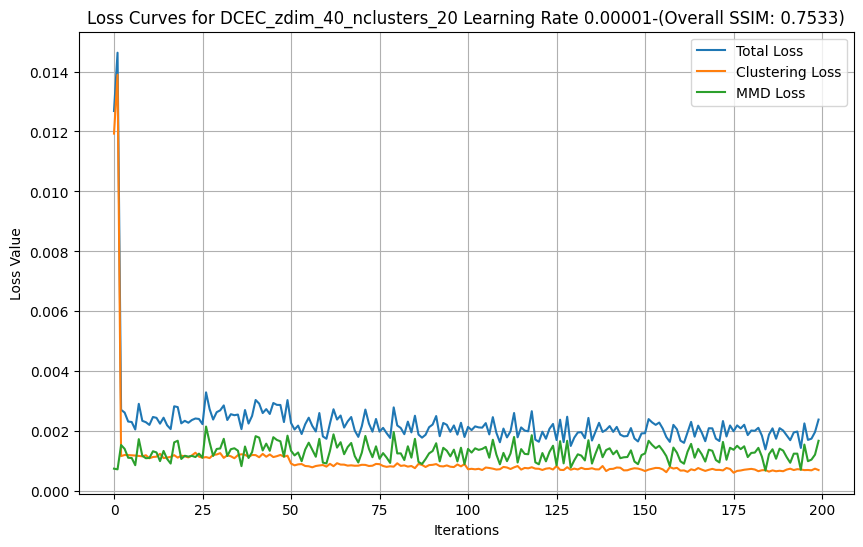

Model saved for z_dim=40 and n_clusters=20


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

        # Ensure the variables of encoder and decoder are tracked
        self._trainable_variables = self.encoder.trainable_variables + self.decoder.trainable_variables


    @property
    def trainable_variables(self):
        return self._trainable_variables

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)

            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)

            # Dynamic weight adjustment

            mmd_loss = loss_mmd
            total_loss = mmd_loss
            # Dynamically scale NLL
            #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)

        # Compute gradients
        gradients = tape.gradient(total_loss, self.trainable_variables)
        # Apply gradients
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Log dynamic weights for debugging
        #tf.print("Epoch", self.current_epoch + 1, ": w1=", w1, ", w2=", w2, ", loss=", total_loss)
        # Return a dictionary mapping metric names to current value
        return {'loss': total_loss, 'loss_mmd': mmd_loss}

    def on_epoch_end(self, epoch, logs=None):
        # Update current epoch at the end of each epoch
        self.current_epoch += 1

    def test_step(self, data):
        x = data  # Validation data

        # Forward pass
        mu, sigma, latent_space = self.encoder(x)
        train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
        xr = self.decoder(latent_space)

        # Compute losses
        loss_mmd = compute_mmd(latent_space, train_z)

        total_loss = loss_mmd
        # Dynamically scale NLL
        #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)
        return {'loss': total_loss, 'loss_mmd': mmd_loss}

# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam', learning_rate=0.00001):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv1)
        en_conv2 = BatchNormalization()(en_conv2)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv2)
        en_conv3 = BatchNormalization()(en_conv3)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters=256, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.01))(en_conv3)
        en_conv4 = BatchNormalization()(en_conv4)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1 = Flatten()(en_conv4)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        def compute_latent(x):
            mu, sigma = x
            batch = tf.shape(mu)[0]
            eps = tf.random.normal(shape=(batch, self.z_dim), mean=0., stddev=1.)
            return mu + tf.exp(sigma) * eps

        latent_space = Lambda(compute_latent, name='latent_space')([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(
            en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu'
        )(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(
            filters=128, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_fc2)
        de_conv2 = Conv2DTranspose(
            filters=64, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv1)
        de_conv3 = Conv2DTranspose(
            filters=32, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv2)
        decoder_output = Conv2DTranspose(
            filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same'
        )(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=32, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # Build autoencoder model for pretraining
        autoencoder = CustomLossLayer(self.encoder, self.decoder, total_epochs = epochs)
        autoencoder.compile(optimizer=optimizer)

        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        p = weight / weight_sum
        return p

    def fit(self, x, y=None, batch_size=64, maxiter=200, tol=1e-3, update_interval=50, save_dir='save_dir', patience=5):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = 1 - (1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0  # Calculate a single value

            # Update stats for l
            x_l = l
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            #update stats for L
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            #computing weights based off of Coefficient of Variation
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)
            # Apply penalty to clustering loss weight
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])  # Penalize clustering loss weight

            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_loss)
            l = L / tf.maximum(self.running_mean_l, 1e-8)

            #update running stats
            if self.current_iter == 0:
              self.running_mean_L = L
            else:
              self.update_stats(L, l)

            #computing weights
            if self.current_iter > 1:
              self.compute_weights()

            #Weighted Loss
            weighted_loss = [self.alphas[i] * unweighted_loss[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=2)  # 2 because of the MMD and clustering losses

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses
                loss_mmd = compute_mmd(latent, train_z)
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_losses = loss_mmd + loss_clustering

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_clustering]
                total_loss = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))


                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}, Unweighted MMD Loss: {loss_mmd.numpy():.8f}")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd = weights[1], weights[0]
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                print(f"Iter {ite}, Weighted Total Loss: {total_loss:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}")

                # Track unweighted losses
                w_total_loss_list.append(total_loss.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss)

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate 0.00001-(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_loss_curves15.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = [20]


for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=64, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=64, update_interval=50, save_dir='save_dir', patience=5)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')


## V3

Training DCEC with z_dim=40 and n_clusters=2...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0116 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.9841e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7709e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3739e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.3193e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.5793e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.1407e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0680e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.6945e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.8221e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.4633e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.7199e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.2868e-05
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.6199e-05 - mmd_loss: 0.0000e+00 - nll_l

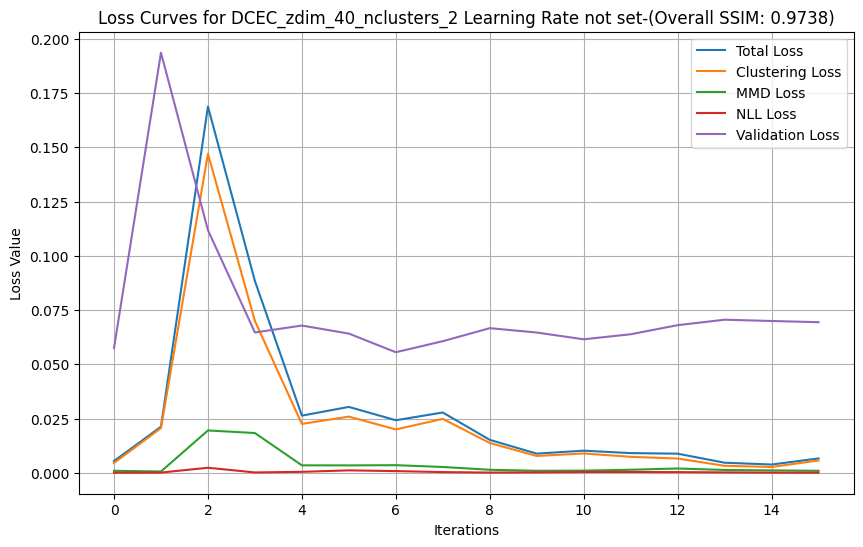

Model saved for z_dim=40 and n_clusters=2
Complete model saved for z_dim=40 and n_clusters=2
Model saved for z_dim=40 and n_clusters=2
Training DCEC with z_dim=40 and n_clusters=3...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0116 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.7075e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.5571e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.2088e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.1624e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.5361e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.0574e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.2056e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.7654e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.9346e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.5305e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.9456e-05 - mmd_loss: 0

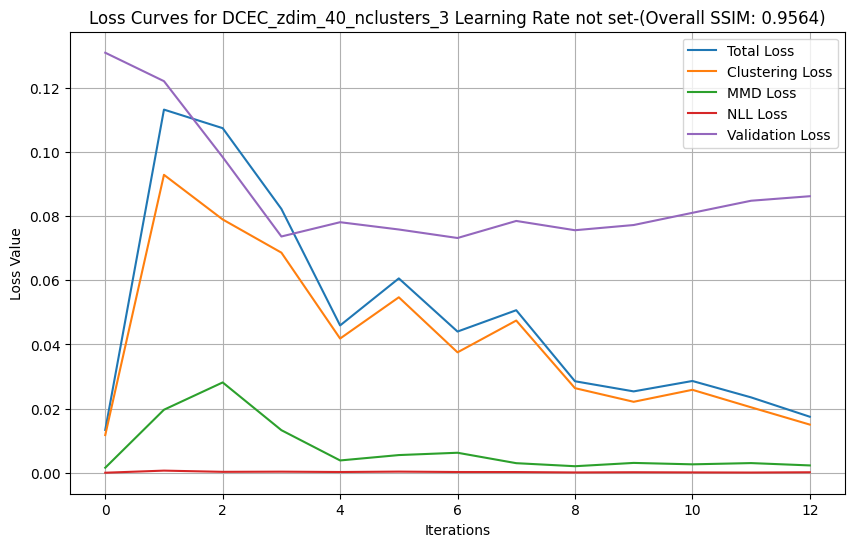

Model saved for z_dim=40 and n_clusters=3
Complete model saved for z_dim=40 and n_clusters=3
Model saved for z_dim=40 and n_clusters=3
Training DCEC with z_dim=40 and n_clusters=4...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0116 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.1437e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.9491e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.6296e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.5782e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.1082e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.6437e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.9632e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.5778e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.9010e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.5265e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.7211e-05 - mmd_loss: 0

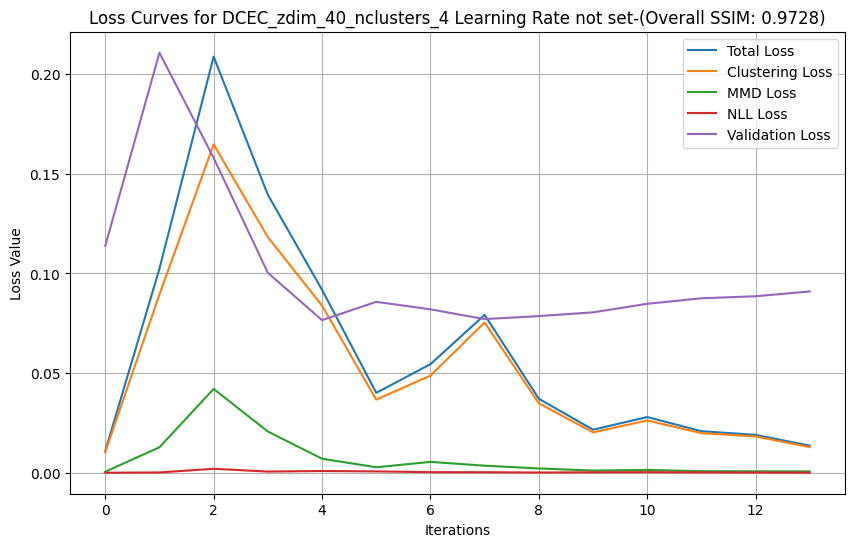

Model saved for z_dim=40 and n_clusters=4
Complete model saved for z_dim=40 and n_clusters=4
Model saved for z_dim=40 and n_clusters=4
Training DCEC with z_dim=40 and n_clusters=5...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0108 - mmd_loss: 0.0000e+00 - nll_loss: 0.0071
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.8252e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7432e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.4997e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.4534e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.3343e-05 - mmd_loss: 0.0000e+00 - nll_loss: 6.9020e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0125e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.4870e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.0604e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.6697e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.9079e-05 - mmd_loss: 0

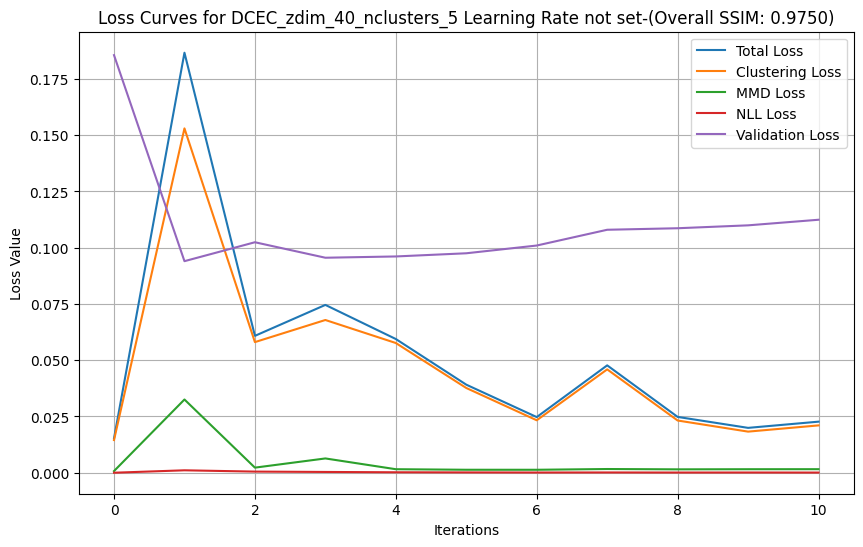

Model saved for z_dim=40 and n_clusters=5
Complete model saved for z_dim=40 and n_clusters=5
Model saved for z_dim=40 and n_clusters=5
Training DCEC with z_dim=40 and n_clusters=6...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0100 - mmd_loss: 0.0000e+00 - nll_loss: 0.0064
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.8066e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7187e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.2977e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2507e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.6997e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.2513e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0288e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.6199e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.7118e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.3547e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.8344e-05 - mmd_loss: 0

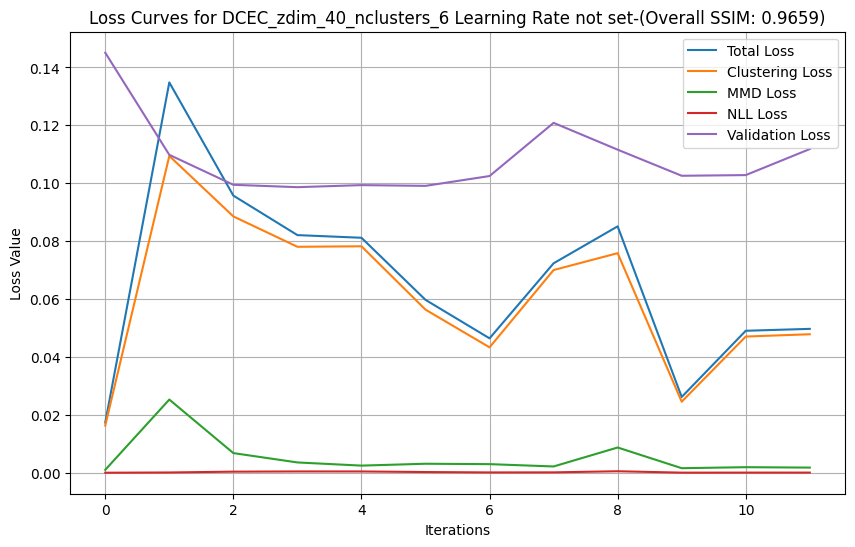

Model saved for z_dim=40 and n_clusters=6
Complete model saved for z_dim=40 and n_clusters=6
Model saved for z_dim=40 and n_clusters=6
Training DCEC with z_dim=40 and n_clusters=7...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 20ms/step - loss: 0.0114 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.9771e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.8581e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.4751e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.4312e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.9655e-05 - mmd_loss: 0.0000e+00 - nll_loss: 8.5754e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.8950e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.5473e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.0997e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.7104e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.3664e-05 - mmd_loss: 0

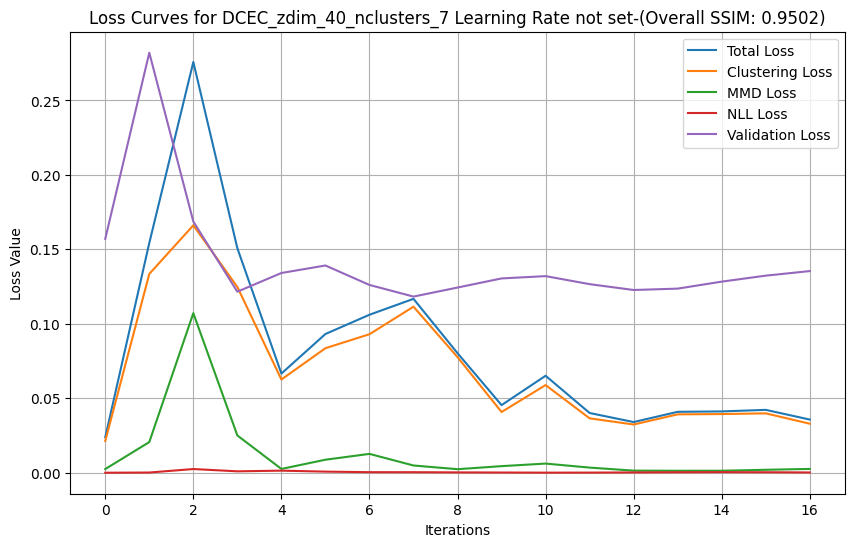

Model saved for z_dim=40 and n_clusters=7
Complete model saved for z_dim=40 and n_clusters=7
Model saved for z_dim=40 and n_clusters=7
Training DCEC with z_dim=40 and n_clusters=8...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0116 - mmd_loss: 0.0000e+00 - nll_loss: 0.0075
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.9535e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7947e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.5005e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.4535e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.8662e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.4040e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.2219e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.7954e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.2781e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.8550e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.3513e-05 - mmd_loss: 0

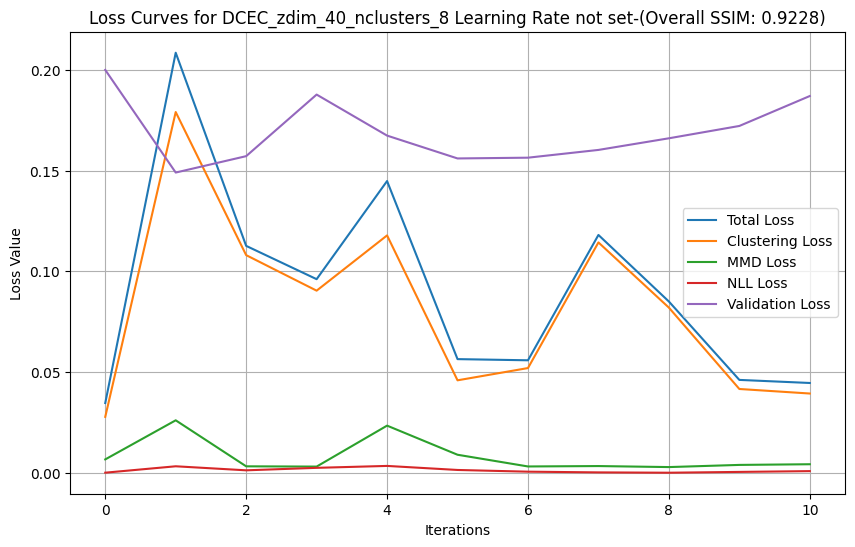

Model saved for z_dim=40 and n_clusters=8
Complete model saved for z_dim=40 and n_clusters=8
Model saved for z_dim=40 and n_clusters=8
Training DCEC with z_dim=40 and n_clusters=9...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0110 - mmd_loss: 0.0000e+00 - nll_loss: 0.0074
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.7639e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.6451e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.5067e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.4577e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.9917e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.5425e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.7406e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.3254e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.6299e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.2819e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.0088e-05 - mmd_loss: 0

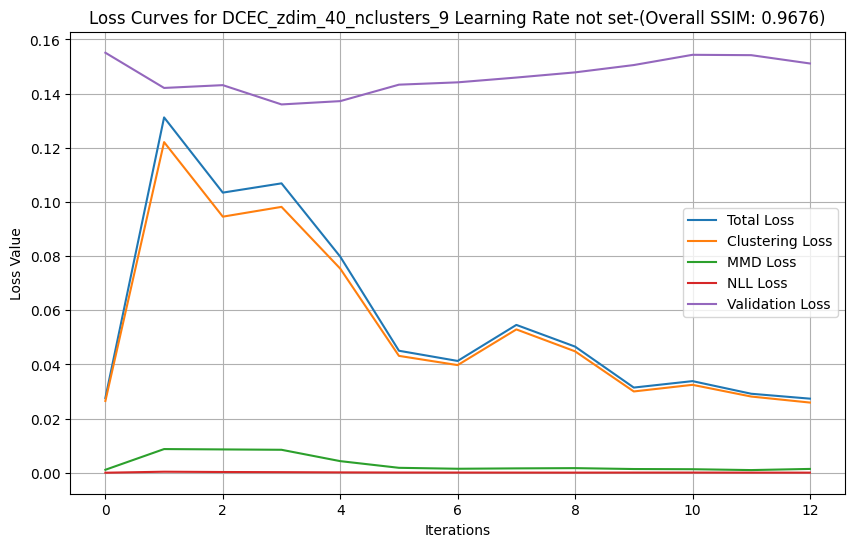

Model saved for z_dim=40 and n_clusters=9
Complete model saved for z_dim=40 and n_clusters=9
Model saved for z_dim=40 and n_clusters=9
Training DCEC with z_dim=40 and n_clusters=10...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0099 - mmd_loss: 0.0000e+00 - nll_loss: 0.0063
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.7909e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7022e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.2922e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2425e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.4025e-05 - mmd_loss: 0.0000e+00 - nll_loss: 6.9135e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.3939e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.0321e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7266e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.2432e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.7250e-05 - mmd_loss: 

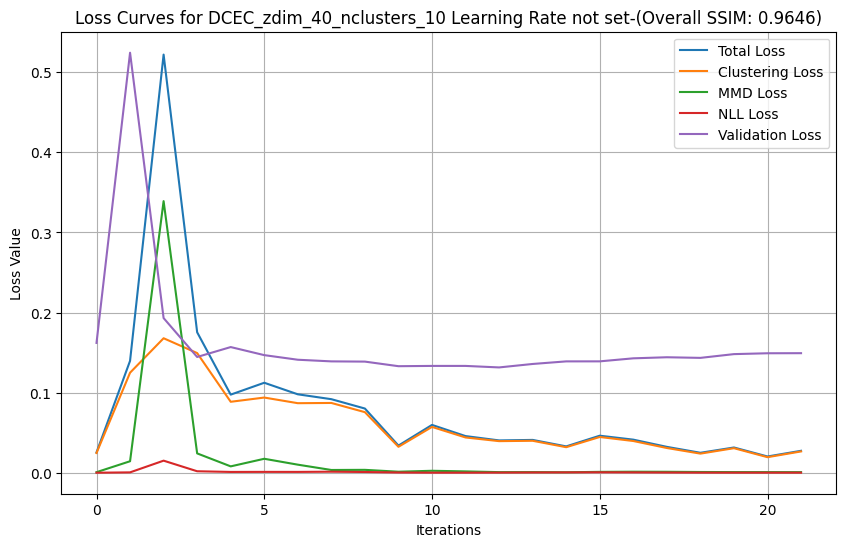

Model saved for z_dim=40 and n_clusters=10
Complete model saved for z_dim=40 and n_clusters=10
Model saved for z_dim=40 and n_clusters=10
Training DCEC with z_dim=40 and n_clusters=11...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0119 - mmd_loss: 0.0000e+00 - nll_loss: 0.0079
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.5884e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.4676e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.2986e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2446e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.4645e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.0152e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.6299e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.2388e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.6629e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.2955e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.6780e-05 - mmd_los

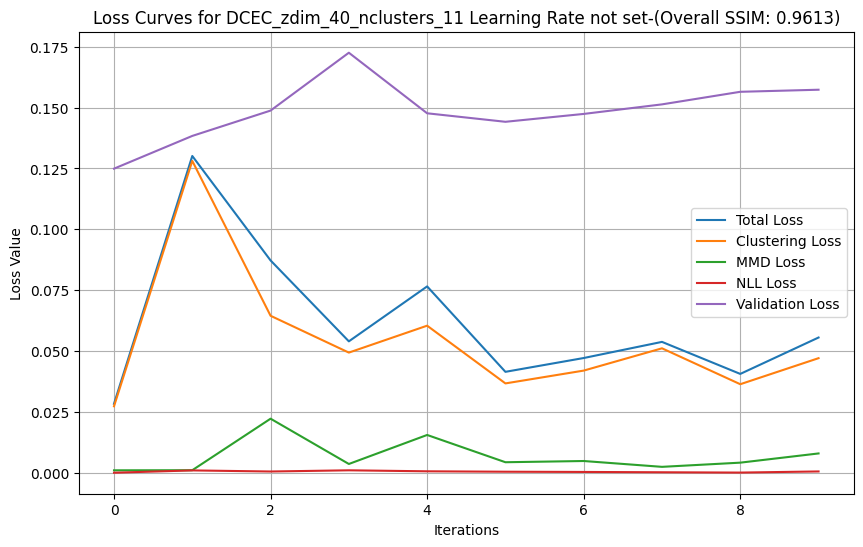

Model saved for z_dim=40 and n_clusters=11
Complete model saved for z_dim=40 and n_clusters=11
Model saved for z_dim=40 and n_clusters=11
Training DCEC with z_dim=40 and n_clusters=12...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0102 - mmd_loss: 0.0000e+00 - nll_loss: 0.0064
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.8240e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7446e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.4613e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.4095e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.1870e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.6873e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.4962e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.1118e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.4760e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.1226e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.3744e-05 - mmd_los

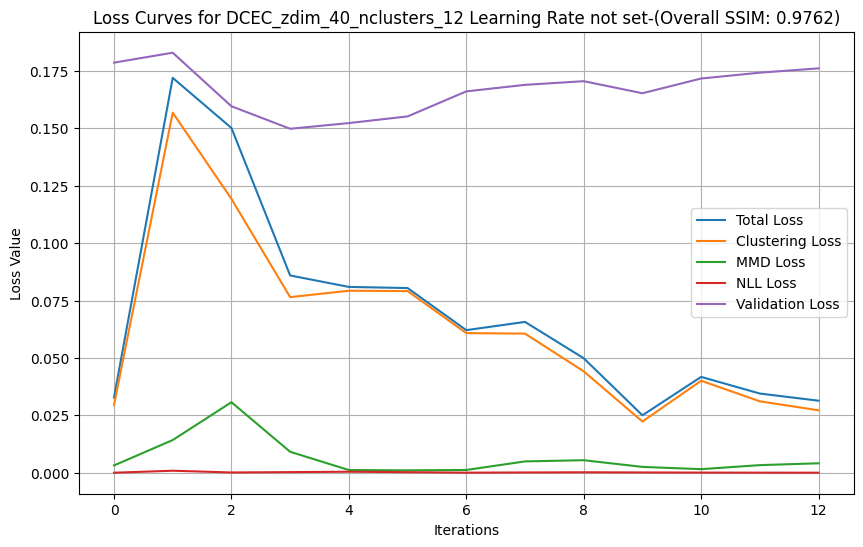

Model saved for z_dim=40 and n_clusters=12
Complete model saved for z_dim=40 and n_clusters=12
Model saved for z_dim=40 and n_clusters=12
Training DCEC with z_dim=40 and n_clusters=13...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0107 - mmd_loss: 0.0000e+00 - nll_loss: 0.0068
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.8837e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.7698e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.5582e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.5090e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.2109e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.7342e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.4035e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.9269e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0538e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.5006e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.6266e-05 - mmd_los

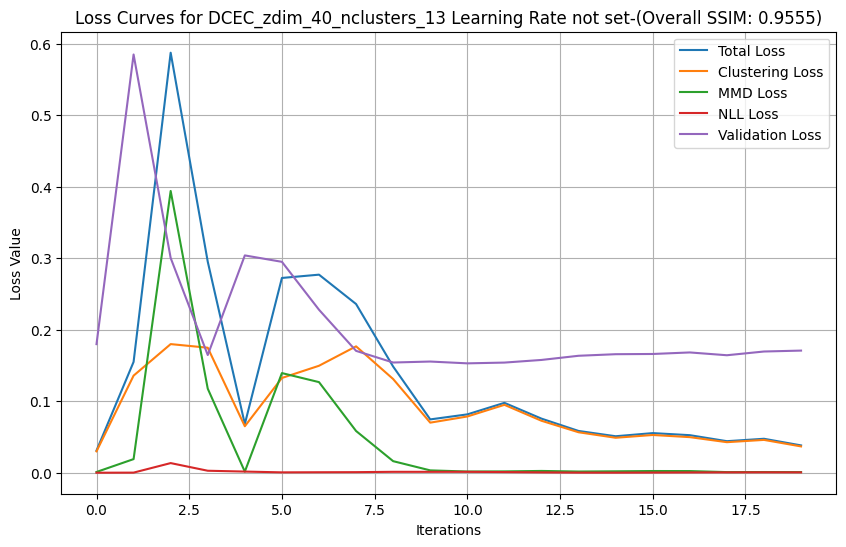

Model saved for z_dim=40 and n_clusters=13
Complete model saved for z_dim=40 and n_clusters=13
Model saved for z_dim=40 and n_clusters=13
Training DCEC with z_dim=40 and n_clusters=14...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0102 - mmd_loss: 0.0000e+00 - nll_loss: 0.0066
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.7438e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.6551e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3806e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.3309e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.6395e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.9681e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.8729e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.4481e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.5735e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.2142e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.1255e-05 - mmd_los

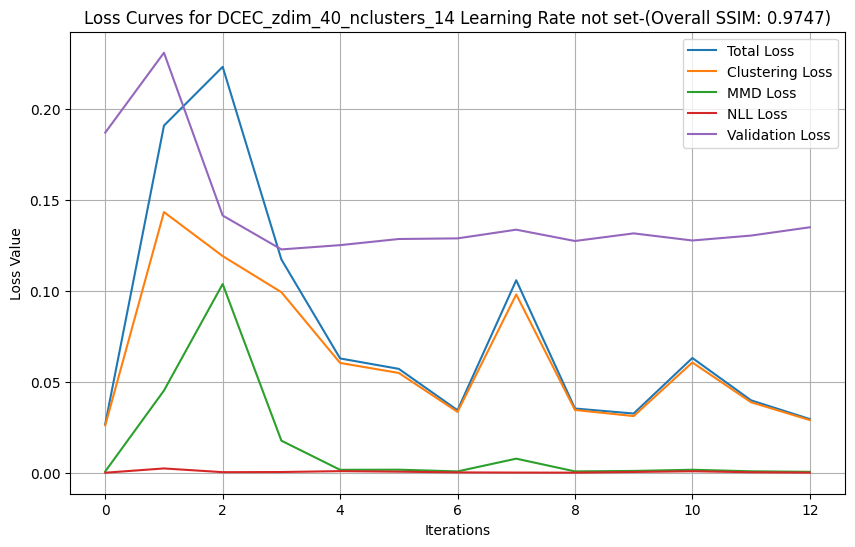

Model saved for z_dim=40 and n_clusters=14
Complete model saved for z_dim=40 and n_clusters=14
Model saved for z_dim=40 and n_clusters=14
Training DCEC with z_dim=40 and n_clusters=15...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0115 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.1400e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.9066e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3026e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2468e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.4321e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.9712e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.1937e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.8224e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.2701e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.8368e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.5143e-05 - mmd_los

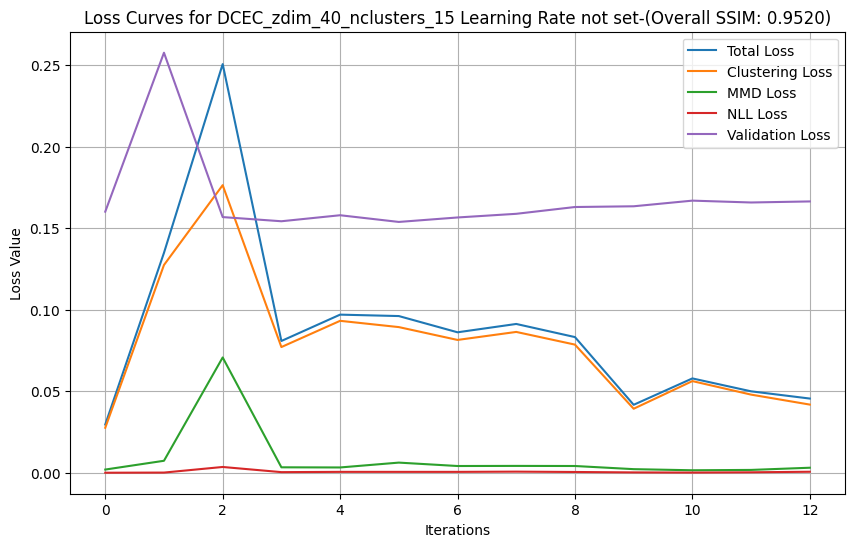

Model saved for z_dim=40 and n_clusters=15
Complete model saved for z_dim=40 and n_clusters=15
Model saved for z_dim=40 and n_clusters=15
Training DCEC with z_dim=40 and n_clusters=16...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0112 - mmd_loss: 0.0000e+00 - nll_loss: 0.0074
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.8912e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.8127e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3897e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.3352e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.5872e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.1869e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0453e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.6036e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.7475e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.2096e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.0451e-05 - mmd_los

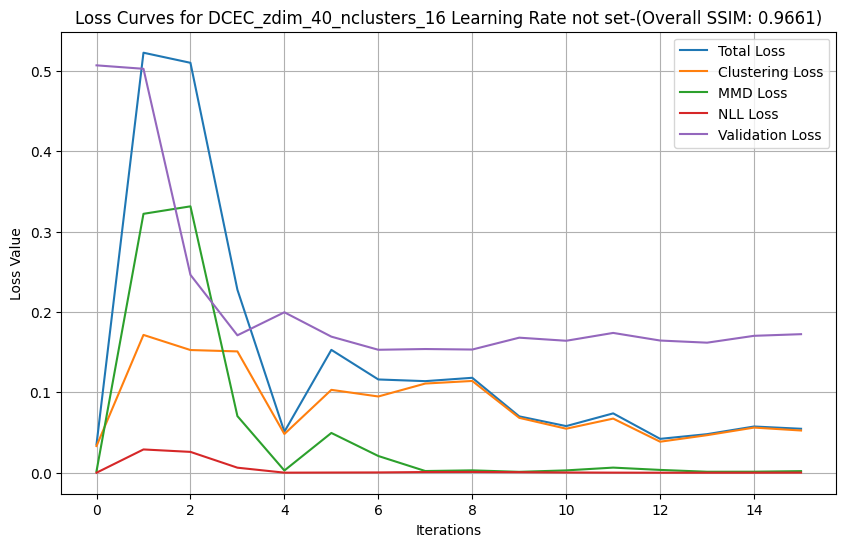

Model saved for z_dim=40 and n_clusters=16
Complete model saved for z_dim=40 and n_clusters=16
Model saved for z_dim=40 and n_clusters=16
Training DCEC with z_dim=40 and n_clusters=17...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 16s 21ms/step - loss: 0.0116 - mmd_loss: 0.0000e+00 - nll_loss: 0.0074
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.1389e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.9062e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.4438e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.3882e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.4115e-05 - mmd_loss: 0.0000e+00 - nll_loss: 6.9230e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.7401e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.3256e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.7176e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.3038e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.9842e-05 - mmd_los

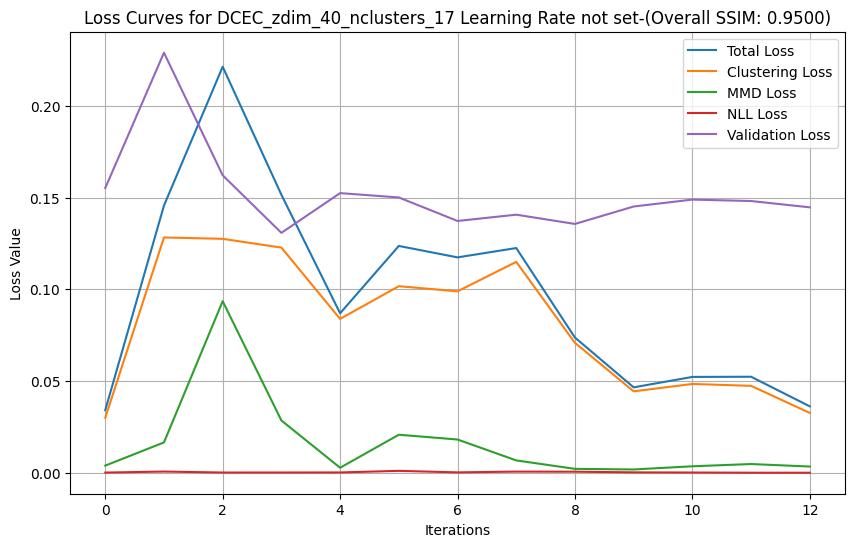

Model saved for z_dim=40 and n_clusters=17
Complete model saved for z_dim=40 and n_clusters=17
Model saved for z_dim=40 and n_clusters=17
Training DCEC with z_dim=40 and n_clusters=18...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0117 - mmd_loss: 0.0000e+00 - nll_loss: 0.0073
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.5048e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.9735e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3827e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.3160e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.7942e-05 - mmd_loss: 0.0000e+00 - nll_loss: 8.2759e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.0854e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.6745e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.1149e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.7425e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.3641e-05 - mmd_los

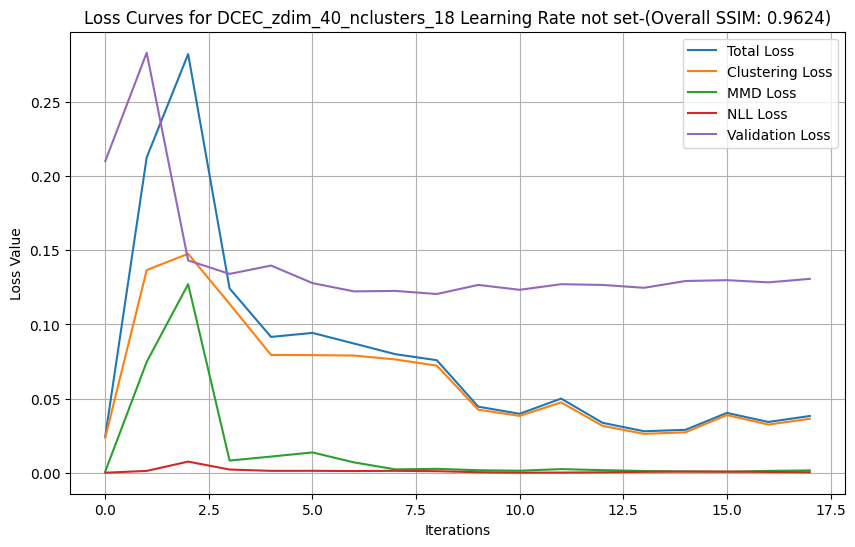

Model saved for z_dim=40 and n_clusters=18
Complete model saved for z_dim=40 and n_clusters=18
Model saved for z_dim=40 and n_clusters=18
Training DCEC with z_dim=40 and n_clusters=19...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0113 - mmd_loss: 0.0000e+00 - nll_loss: 0.0076
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.0486e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.8916e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.3205e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2493e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 8.3661e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.7849e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.1926e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.7453e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.0842e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.6533e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 4.3888e-05 - mmd_los

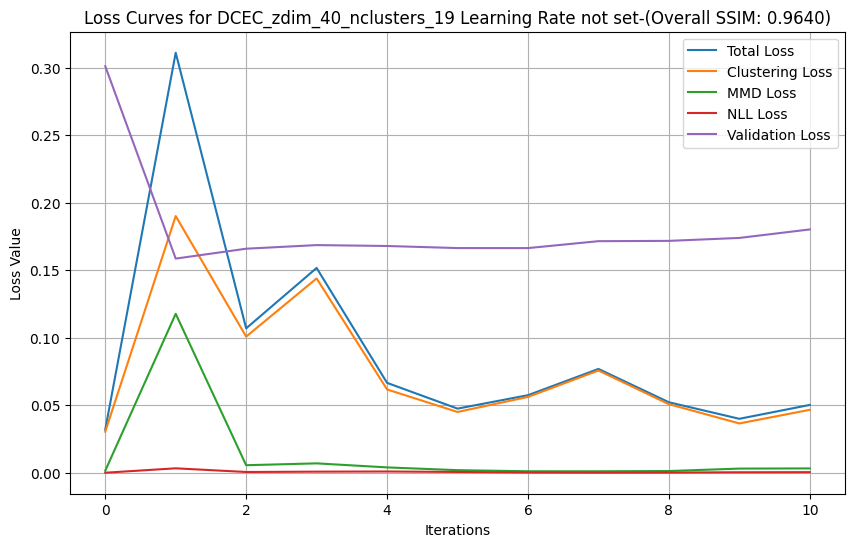

Model saved for z_dim=40 and n_clusters=19
Complete model saved for z_dim=40 and n_clusters=19
Model saved for z_dim=40 and n_clusters=19
Training DCEC with z_dim=40 and n_clusters=20...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 14s 21ms/step - loss: 0.0118 - mmd_loss: 0.0000e+00 - nll_loss: 0.0082
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 2.7730e-04 - mmd_loss: 0.0000e+00 - nll_loss: 2.6772e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 1.2985e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.2471e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 7.4206e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.0154e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 6.2484e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.7514e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 5.4685e-05 - mmd_loss: 0.0000e+00 - nll_loss: 5.0251e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 3.9607e-05 - mmd_los

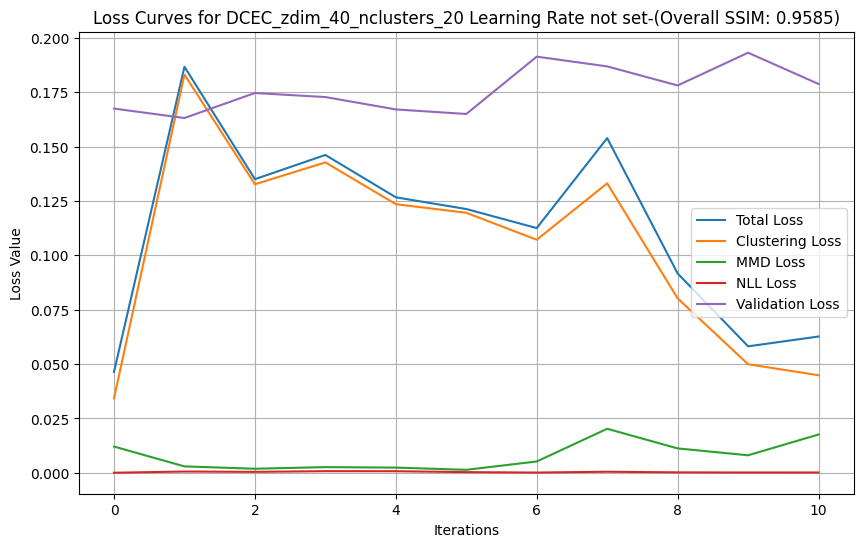

Model saved for z_dim=40 and n_clusters=20
Complete model saved for z_dim=40 and n_clusters=20
Model saved for z_dim=40 and n_clusters=20


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
@tf.keras.utils.register_keras_serializable()
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        # Expand inputs for broadcasting
        inputs_expanded = K.expand_dims(inputs, axis=1)  # (batch_size, 1, latent_dim)
        cluster_expanded = K.expand_dims(self.clusters, axis=0)  # (1, n_clusters, latent_dim)
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q


# Define the CustomLossLayer
## MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
    tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
    return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

def compute_mmd(x, y, sigma_sqr=1.0):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def __init__(self, encoder, decoder, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
        self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs
        # true_samples = tf.random.normal(tf.stack([200, z_dim]))
        loss_mmd = compute_mmd(latent_space, train_z)
        loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
        # Update the trackers
        self.mmd_tracker.update_state(loss_mmd)
        self.nll_tracker.update_state(loss_nll)

        # Add the total loss
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def reset_states(self):  # Added for resetting at the start of each epoch
        self.mmd_tracker.reset_states()
        self.nll_tracker.reset_states()

    def compute_output_shape(self, input_shape):
        return input_shape[1]


# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam'):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
        en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.005))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)
        en_conv1 = Dropout(0.2)(en_conv1)

        en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
        en_conv2 = LeakyReLU(0.1)(en_conv2)
        en_conv2 = Dropout(0.2)(en_conv2)

        en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
        en_conv3 = LeakyReLU(0.1)(en_conv3)
        en_conv3 = Dropout(0.3)(en_conv3)

        en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
        en_conv4 = LeakyReLU(0.1)(en_conv4)
        en_conv4 = Dropout(0.3)(en_conv4)

        en_fc1= Flatten()(en_conv3)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        #Compute latent using mean and variance
        @tf.keras.utils.register_keras_serializable(package="Custom", name="compute_latent")
        def compute_latent(x):
            mu, sigma = x
            batch = K.shape(mu)[0]
            dim = K.int_shape(mu)[1]
            eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
            return mu + K.exp(sigma)*eps
        latent_space = Lambda(compute_latent)([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
        de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
        de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
        decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=64, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # For pre training build the autoencoder by combining encoder, CustomLossLayer, and decoder
        latent_space, train_z, train_xr, train_x = self.encoder.output[2], self.encoder.output[2], self.decoder(self.encoder.output[2]), self.encoder.input
        autoencoder_output = CustomLossLayer(self.encoder, self.decoder)([latent_space, train_z, train_xr, train_x])
        autoencoder = tf.keras.Model(inputs=self.encoder.input, outputs=autoencoder_output, name='autoencoder')

        # Add encoder and decoder as attributes of the model
        autoencoder.encoder = self.encoder
        autoencoder.decoder = self.decoder
        # Compile the autoencoder
        optimizer = tf.keras.optimizers.Adam()
        autoencoder.compile(optimizer=optimizer)
        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        print("weight_numerator shape:", weight_numerator.shape)

        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        print("weight_denominator shape:", weight_denominator.shape)

        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        print("weight shape:", weight.shape)

        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        print("weight_sum shape:", weight_sum.shape)

        p = weight / weight_sum
        print("p shape:", p.shape)
        return p

    def fit(self, x, y=None, batch_size=64, maxiter=200, tol=1e-3, update_interval=50, save_dir='save_dir', patience=10, test_data=None):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables for early stopping
        best_loss = float('inf')  # Best observed loss
        no_improve_count = 0  # Counter for early stopping

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []
        nll_loss_list = []

        #Loss list for val
        val_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []
        w_nll_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        if test_data is not None:
            if not isinstance(test_data, tf.Tensor):
                test_data = tf.convert_to_tensor(test_data, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses=3, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = (1. - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0  # Calculate a single value

            # Update stats for l
            x_l = l
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            #update stats for L
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            #computing weights based off of Coefficient of Variation
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)
            # Apply penalty to clustering loss weight
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])  # Penalize clustering loss weight

            # normalise weights
            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_loss)
            epsilon = 1e-6  # Increase epsilon to ensure stability

            # Clamp running_mean_l for stability
            self.running_mean_l = tf.maximum(self.running_mean_l, epsilon)

            # Calculate normalized losses (l)
            l = tf.divide(L, self.running_mean_l)  # Normalize losses
            #print("Normalized losses (l):", l.numpy())  # Debugging

            # Update running statistics
            if self.current_iter == 0:
                self.running_mean_L = L
            else:
                self.update_stats(L, l)

            # Compute weights using CoV
            if self.current_iter > 1:
                self.compute_weights()

            # Weighted loss
            weighted_loss = [self.alphas[i] * unweighted_loss[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=3)  # 2 because of the MMD and clustering losses

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses * 1e6
                loss_mmd = compute_mmd(latent, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x_batch))
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                #total_losses = loss_mmd + loss_nll + loss_clustering

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_nll, loss_clustering]
                total_losses = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_losses, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))

                # Evaluate test loss if test data is provided
                if test_data is not None:
                    mu, sigma, latent = self.encoder(test_data)
                    xr_test = self.decoder(latent)
                    train_z_test = tf.random.normal(shape=(tf.shape(test_data)[0], self.z_dim), mean=0.0, stddev=1.0)

                    test_loss_mmd = compute_mmd(latent, train_z_test)
                    test_loss_nll = tf.reduce_mean(tf.square(xr_test - test_data))

                    # Extract the corresponding subset of p for the validation batch
                    val_p_batch = tf.gather(p, tf.range(tf.shape(latent)[0]))

                    test_loss_clustering = tf.reduce_mean(
                        tf.keras.losses.KLD(val_p_batch, self.clustering_layer(latent))
                    )

                    # Retrieve the latest computed weights
                    weights = cov_weighting.get_weights()
                    weight_mmd, weight_nll, weight_clustering = weights[0], weights[1], weights[2]

                    # Apply the weights explicitly to validation losses
                    weighted_test_loss_mmd = weight_mmd * test_loss_mmd
                    weighted_test_loss_nll = weight_nll * test_loss_nll
                    weighted_test_loss_clustering = weight_clustering * test_loss_clustering

                    # Compute the final weighted validation loss
                    val_loss_weighted = weighted_test_loss_mmd + weighted_test_loss_nll + weighted_test_loss_clustering

                    # Track the weighted validation loss for plotting
                    #val_loss_list.append(val_loss_weighted.numpy())

                    print(f"Iter {ite}, Weighted Total Validation Loss: {val_loss_weighted.numpy():.8f}")


                # Check for improvement
                if val_loss_weighted.numpy() < best_loss - tol:  # Improvement threshold
                    best_loss = val_loss_weighted.numpy()
                    no_improve_count = 0
                else:
                    no_improve_count += 1

                # Stop if patience is exceeded
                if no_improve_count >= patience:
                    print(f"Early stopping at iteration {ite}. Best loss: {best_loss:.8f}")
                    break

                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())
                nll_loss_list.append(loss_nll.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}, "
                      f"Unweighted MMD Loss: {loss_mmd.numpy():.8f}, Unweighted NLL Loss: {loss_nll.numpy():.8f},")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd, weight_nll = weights[1], weights[0], weights[2]
                #scaled_mmd = loss_mmd * 1e5
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                weighted_nll_loss = weight_nll * loss_nll
                w_total_losses = weighted_clustering_loss + weighted_mmd_loss + weighted_nll_loss
                print(f"Iter {ite}, Weighted Total Loss: {w_total_losses:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}, Weighted NLL Loss: {weighted_nll_loss},"
                      f"Total Validation Loss: {val_loss_weighted.numpy():.8f}")

                # Track unweighted losses
                w_total_loss_list.append(w_total_losses.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss.numpy())
                w_nll_loss_list.append(weighted_nll_loss.numpy())
                val_loss_list.append(val_loss_weighted.numpy())

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, val_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, val_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.plot(w_nll_loss_list, label='NLL Loss')
        plt.plot(val_loss_list, label='Validation Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate not set-(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_all_loss_curves.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = range(2, 21)

for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=64, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=64, update_interval=50, save_dir='save_dir', patience=10, test_data=data_val)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')

        # Save the complete model
        input_data = Input(shape=dcec.encoder.input_shape[1:])
        mu, sigma, latent = dcec.encoder(input_data)
        clustering_output = dcec.clustering_layer(latent)
        decoded_output = dcec.decoder(latent)

        # Create the full model
        full_model = Model(inputs=input_data, outputs=[clustering_output, decoded_output], name="DCEC_Model")
        full_model.save(f'{save_dir}/{model_name}_full_model.h5')
        print(f"Complete model saved for z_dim={z_dim} and n_clusters={k}")

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')



In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os

# Define the range of k values
k_values = range(2, 21)  # k from 2 to 20
dim = 40  # Set the appropriate latent dimension

# Define the output directory
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/reconstruction'
os.makedirs(output_dir, exist_ok=True)

# Select a subset of actual images from the test set
num_images = 5  # Number of images to display per row
actual_images = data_test[:num_images]

for k in k_values:
    print(f"Processing model with k = {k}...")

    # Define model file paths
    encoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_encoder.h5'
    decoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_decoder.h5'

    # Check if both models exist
    if not os.path.exists(encoder_file_path) or not os.path.exists(decoder_file_path):
        print(f"Skipping k={k}, model files not found.")
        continue

    # Load encoder and decoder models
    encoder = tf.keras.models.load_model(encoder_file_path, compile=False)
    decoder = tf.keras.models.load_model(decoder_file_path, compile=False)

    # Get latent vectors from encoder
    latent_vectors = encoder.predict(actual_images)

    # Handle possible multiple outputs from encoder (e.g., VAE case)
    if isinstance(latent_vectors, list) and len(latent_vectors) > 1:
        latent_vectors = latent_vectors[2]  # Adjust based on encoder output

    # Generate reconstructed images
    predicted_images = decoder.predict(latent_vectors)

    # Visualize actual and reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=num_images, sharex=True, sharey=True, figsize=(20, 4))

    # First row: Actual images
    for i, ax in enumerate(axes[0]):
        ax.imshow(actual_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
        ax.set_title("Actual")
        ax.axis('off')

    # Second row: Reconstructed images
    for i, ax in enumerate(axes[1]):
        ax.imshow(predicted_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
        ax.set_title("Reconstructed")
        ax.axis('off')

    plt.tight_layout()

    # Save the comparison image in the specified output directory
    output_path = os.path.join(output_dir, f'Actual_vs_Reconstructed_k{k}.png')
    plt.savefig(output_path)
    plt.close()

    print(f"Saved reconstructed images for k = {k} at {output_path}")

print("Reconstruction process completed for all k values.")


Processing model with k = 2...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 596ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
Saved reconstructed images for k = 2 at /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/reconstruction/Actual_vs_Reconstructed_k2.png
Processing model with k = 3...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 268ms/step
Saved reconstructed images for k = 3 at /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/reconstruction/Actual_vs_Reconstructed_k3.png
Processing model with k = 4...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 615ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
Saved reconstructed images for k = 4 at /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/reconstruction/Actual_vs_Reconstructed_k4.png
Processing model with k = 5...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
Saved reconstructed images for k = 5 at /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/reconstruc

## V3.5 early stop without validation data

Training DCEC with z_dim=40 and n_clusters=3...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 10s 14ms/step - loss: 0.0083 - mmd_loss: 0.0000e+00 - nll_loss: 0.0072
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5511e-04 - mmd_loss: 0.0000e+00 - nll_loss: 1.8756e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.7199e-05 - mmd_loss: 0.0000e+00 - nll_loss: 7.3560e-05
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6548e-05 - mmd_loss: 0.0000e+00 - nll_loss: 4.0800e-05
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0292e-05 - mmd_loss: 0.0000e+00 - nll_loss: 3.6794e-05
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7771e-05 - mmd_loss: 0.0000e+00 - nll_loss: 2.5276e-05
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5638e-05 - mmd_loss: 0.0000e+00 - nll_loss: 2.3796e-05
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0672e-05 - mmd_loss: 0.0000e+00 - nll_l

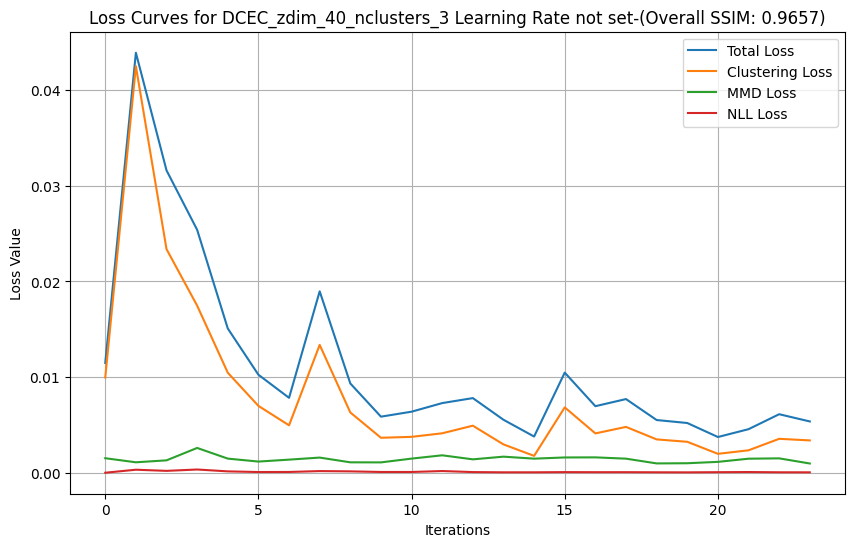

Model saved for z_dim=40 and n_clusters=3
Complete model saved for z_dim=40 and n_clusters=3
Model saved for z_dim=40 and n_clusters=3


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        # Expand inputs for broadcasting
        inputs_expanded = K.expand_dims(inputs, axis=1)  # (batch_size, 1, latent_dim)
        cluster_expanded = K.expand_dims(self.clusters, axis=0)  # (1, n_clusters, latent_dim)
        # Clustering Assignmnets
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q


# Define the CustomLossLayer
## MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
    tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
    return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

def compute_mmd(x, y, sigma_sqr=1.0):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def __init__(self, encoder, decoder, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
        self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs
        # true_samples = tf.random.normal(tf.stack([200, z_dim]))
        loss_mmd = compute_mmd(latent_space, train_z)
        loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
        # Update the trackers
        self.mmd_tracker.update_state(loss_mmd)
        self.nll_tracker.update_state(loss_nll)

        # Add the total loss
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def reset_states(self):  # Added for resetting at the start of each epoch
        self.mmd_tracker.reset_states()
        self.nll_tracker.reset_states()

    def compute_output_shape(self, input_shape):
        return input_shape[1]


# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam'):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
        en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.001))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1= Flatten()(en_conv3)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        #Compute latent using mean and variance
        @tf.keras.utils.register_keras_serializable()
        def compute_latent(x):
            mu, sigma = x
            batch = K.shape(mu)[0]
            dim = K.int_shape(mu)[1]
            eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
            return mu + K.exp(sigma)*eps
        latent_space = Lambda(compute_latent)([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
        de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
        de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
        decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=64, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # For pre training build the autoencoder by combining encoder, CustomLossLayer, and decoder
        latent_space, train_z, train_xr, train_x = self.encoder.output[2], self.encoder.output[2], self.decoder(self.encoder.output[2]), self.encoder.input
        autoencoder_output = CustomLossLayer(self.encoder, self.decoder)([latent_space, train_z, train_xr, train_x])
        autoencoder = tf.keras.Model(inputs=self.encoder.input, outputs=autoencoder_output, name='autoencoder')

        # Add encoder and decoder as attributes of the model
        autoencoder.encoder = self.encoder
        autoencoder.decoder = self.decoder
        # Compile the autoencoder
        optimizer = tf.keras.optimizers.Adam()
        autoencoder.compile(optimizer=optimizer)
        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        print("weight_numerator shape:", weight_numerator.shape)

        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        print("weight_denominator shape:", weight_denominator.shape)

        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        print("weight shape:", weight.shape)

        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        print("weight_sum shape:", weight_sum.shape)

        p = weight / weight_sum
        print("p shape:", p.shape)
        return p

    def fit(self, x, y=None, batch_size=64, maxiter=200, tol=1e-3, update_interval=50, save_dir='save_dir', patience=10):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables for early stopping
        best_loss = float('inf')  # Best observed loss
        no_improve_count = 0  # Counter for early stopping

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []
        nll_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []
        w_nll_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses=3, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = (1. - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0  # Calculate a single value

            # Update stats for l
            x_l = l
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            #update stats for L
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            #computing weights based off of Coefficient of Variation
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)
            # Apply penalty to clustering loss weight
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])  # Penalize clustering loss weight

            # normalise weights
            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_loss)
            epsilon = 1e-6  # Increase epsilon to ensure stability

            # Clamp running_mean_l for stability
            self.running_mean_l = tf.maximum(self.running_mean_l, epsilon)

            # Calculate normalized losses (l)
            l = tf.divide(L, self.running_mean_l)  # Normalize losses
            print("Normalized losses (l):", l.numpy())  # Debugging

            # Update running statistics
            if self.current_iter == 0:
                self.running_mean_L = L
            else:
                self.update_stats(L, l)

            # Compute weights using CoV
            if self.current_iter > 1:
                self.compute_weights()

            # Weighted loss
            weighted_loss = [self.alphas[i] * unweighted_loss[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=3)  # 2 because of the MMD and clustering losses

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses * 1e6
                loss_mmd = compute_mmd(latent, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x_batch))
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_losses = loss_mmd + loss_nll + loss_clustering

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_nll, loss_clustering]
                total_loss = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))

                # Check for improvement
                if total_loss.numpy() < best_loss - tol:  # Improvement threshold
                    best_loss = total_loss.numpy()
                    no_improve_count = 0
                else:
                    no_improve_count += 1

                # Stop if patience is exceeded
                if no_improve_count >= patience:
                    print(f"Early stopping at iteration {ite}. Best loss: {best_loss:.8f}")
                    break

                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())
                nll_loss_list.append(loss_nll.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}, "
                      f"Unweighted MMD Loss: {loss_mmd.numpy():.8f}, Unweighted NLL Loss: {loss_nll.numpy():.8f}")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd, weight_nll = weights[1], weights[0], weights[2]
                #scaled_mmd = loss_mmd * 1e5
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                weighted_nll_loss = weight_nll * loss_nll
                print(f"Iter {ite}, Weighted Total Loss: {total_loss:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}, Weighted NLL Loss: {weighted_nll_loss}")

                # Track unweighted losses
                w_total_loss_list.append(total_loss.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss.numpy())
                w_nll_loss_list.append(weighted_nll_loss.numpy())

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.plot(w_nll_loss_list, label='NLL Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate not set-(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_all_loss_curves.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = [3]

for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=64, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=64, update_interval=50, save_dir='save_dir', patience=10)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')

        # Save the complete model
        input_data = Input(shape=dcec.encoder.input_shape[1:])
        mu, sigma, latent = dcec.encoder(input_data)
        clustering_output = dcec.clustering_layer(latent)
        decoded_output = dcec.decoder(latent)

        # Create the full model
        full_model = Model(inputs=input_data, outputs=[clustering_output, decoded_output], name="DCEC_Model")
        full_model.save(f'/content/drive/MyDrive/Masters Dataset/DCEC/DCEC_dim{z_dim}_clusters_{k}.h5')
        print(f"Complete model saved for z_dim={z_dim} and n_clusters={k}")

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')



## V4

Training DCEC with z_dim=40 and n_clusters=2...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 12s 17ms/step - loss: 0.0046 - loss_mmd: 0.0015 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.4035e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9674e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9249e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8843e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8807e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8742e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0023 - loss_mmd: 0.0014 - loss_nll: 8.8632e-04
Epoch 9/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 

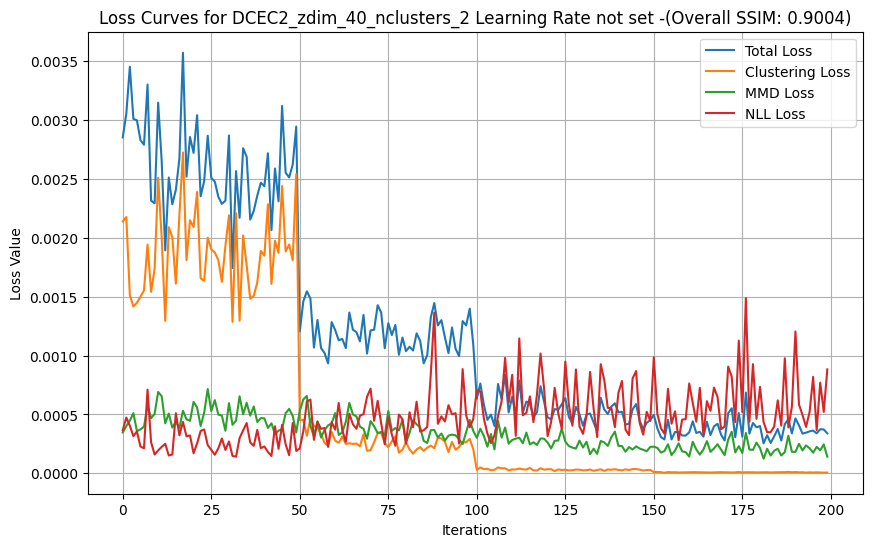

Model saved for z_dim=40 and n_clusters=2
Training DCEC with z_dim=40 and n_clusters=3...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 9.3434e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9149e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9488e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9065e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8542e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8753e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8934e-04
Ep

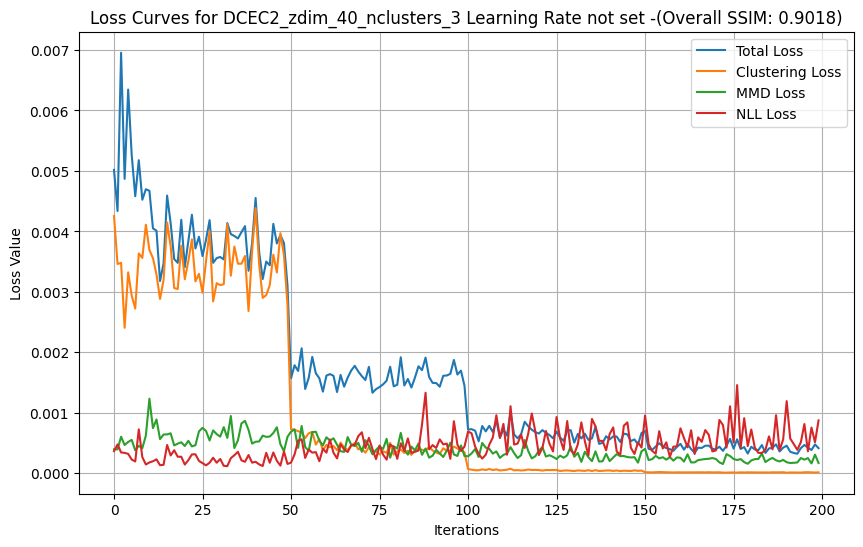

Model saved for z_dim=40 and n_clusters=3
Training DCEC with z_dim=40 and n_clusters=4...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 12s 17ms/step - loss: 0.0047 - loss_mmd: 0.0014 - loss_nll: 0.0033
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.2292e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9458e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8984e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9008e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8632e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8911e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8510e-04
Ep

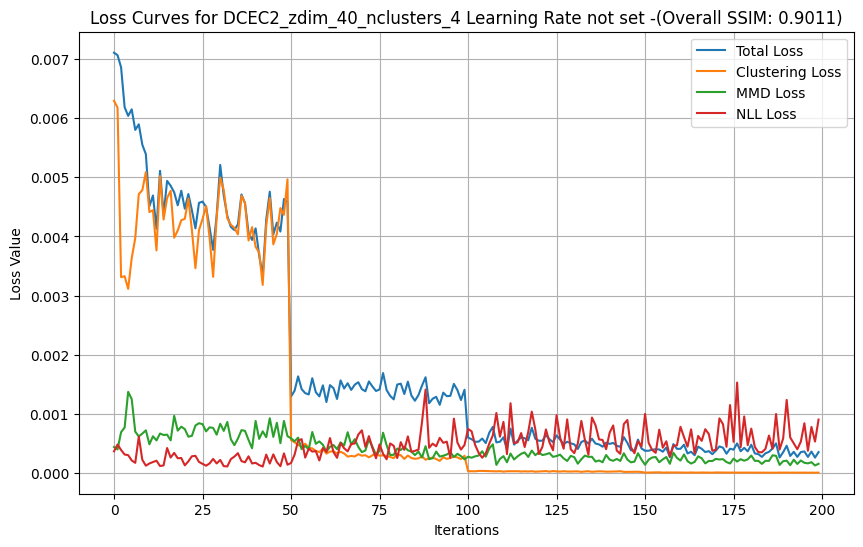

Model saved for z_dim=40 and n_clusters=4
Training DCEC with z_dim=40 and n_clusters=5...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0014 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.2350e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9293e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8894e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8866e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8559e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8635e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8698e-04
Ep

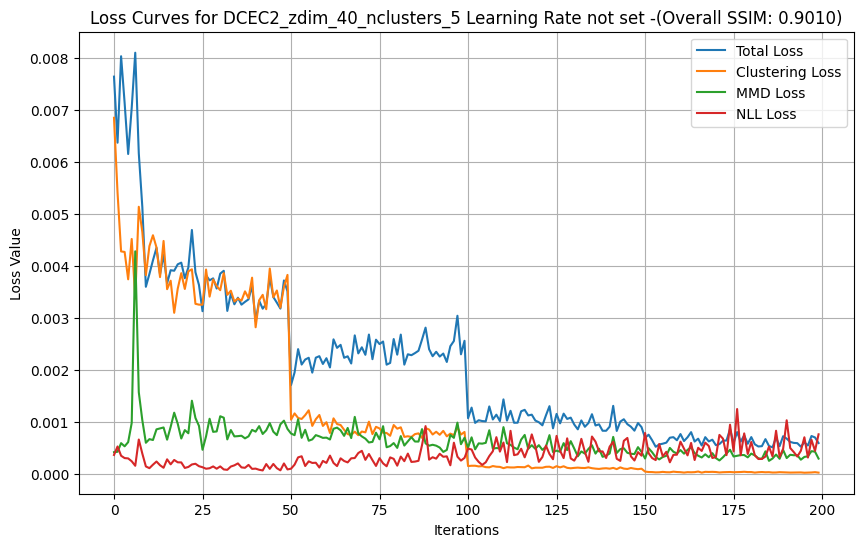

Model saved for z_dim=40 and n_clusters=5
Training DCEC with z_dim=40 and n_clusters=6...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.3637e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9195e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9109e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8676e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9141e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8782e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8414e-04
Ep

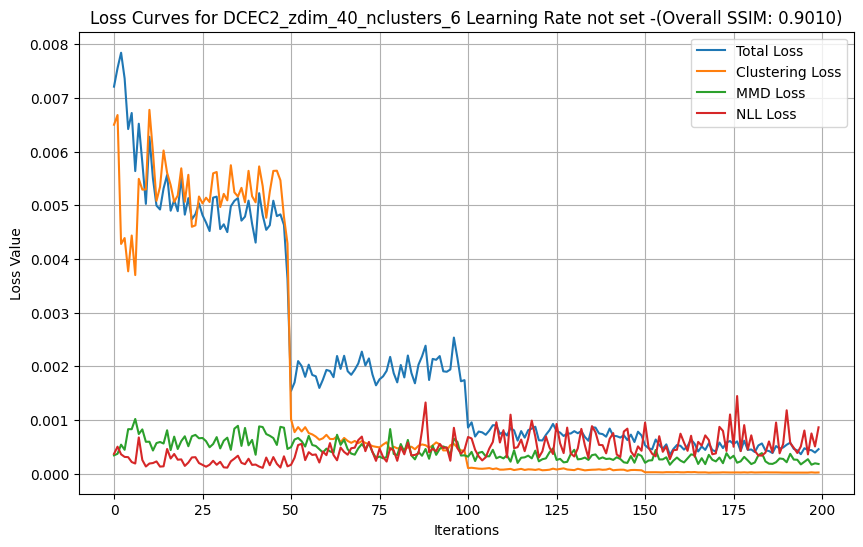

Model saved for z_dim=40 and n_clusters=6
Training DCEC with z_dim=40 and n_clusters=7...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 12s 17ms/step - loss: 0.0046 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.1810e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9072e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8780e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.9480e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8724e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8518e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8694e-04
Ep

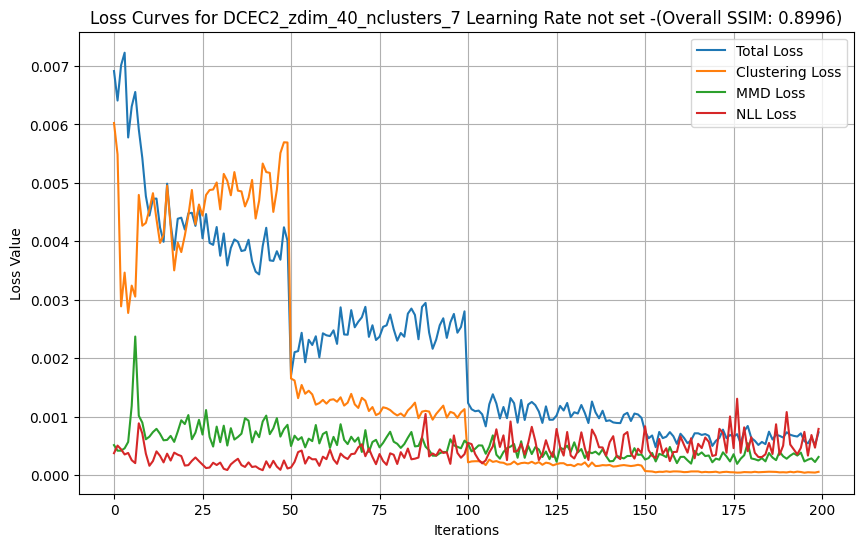

Model saved for z_dim=40 and n_clusters=7
Training DCEC with z_dim=40 and n_clusters=8...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0044 - loss_mmd: 0.0015 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.2701e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9473e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9085e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8683e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8685e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8527e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8542e-04
Ep

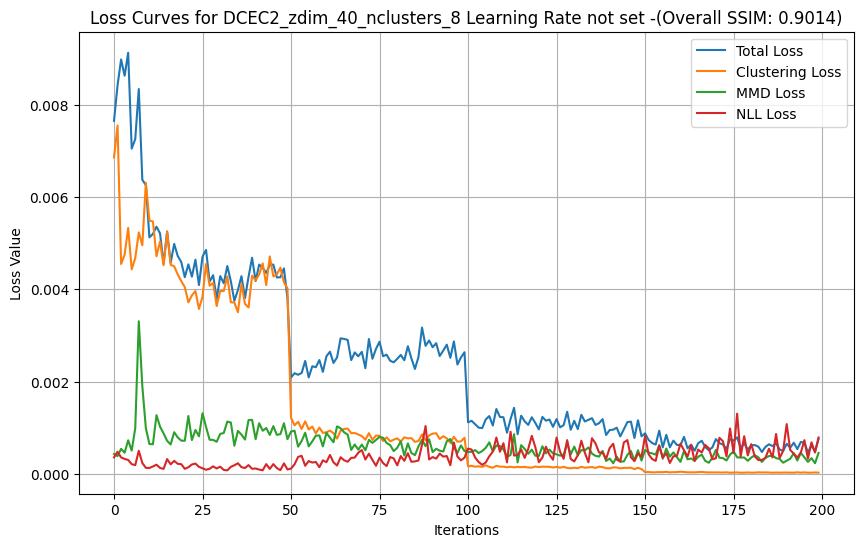

Model saved for z_dim=40 and n_clusters=8
Training DCEC with z_dim=40 and n_clusters=9...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0015 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.4743e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9937e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8761e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8823e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8656e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8454e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8608e-04
Ep

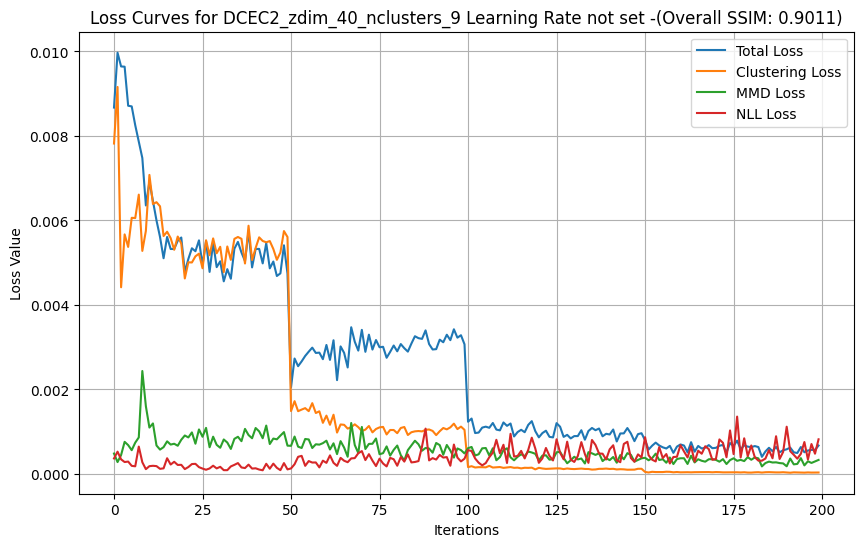

Model saved for z_dim=40 and n_clusters=9
Training DCEC with z_dim=40 and n_clusters=10...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0015 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.4921e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0023 - loss_mmd: 0.0014 - loss_nll: 8.9362e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9123e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8743e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8692e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8864e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8945e-04
E

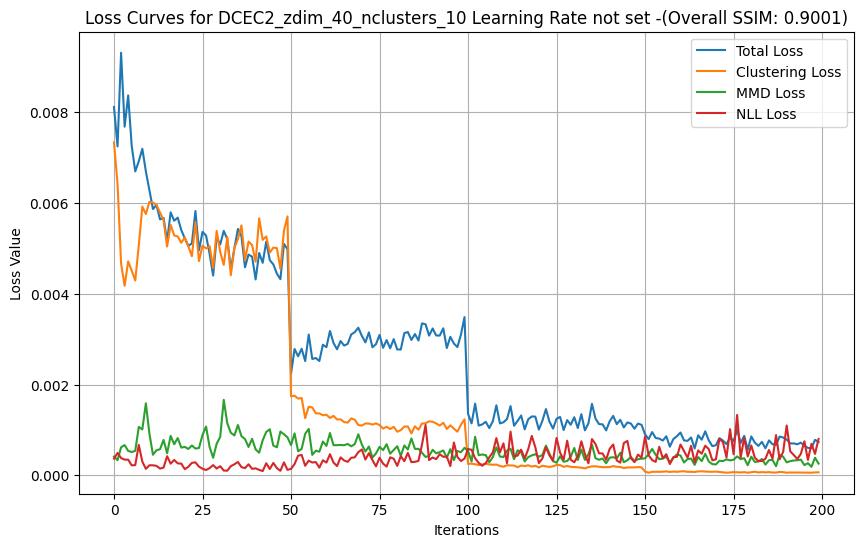

Model saved for z_dim=40 and n_clusters=10
Training DCEC with z_dim=40 and n_clusters=11...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0015 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.3982e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9676e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8861e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8907e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8765e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9048e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8734e-04


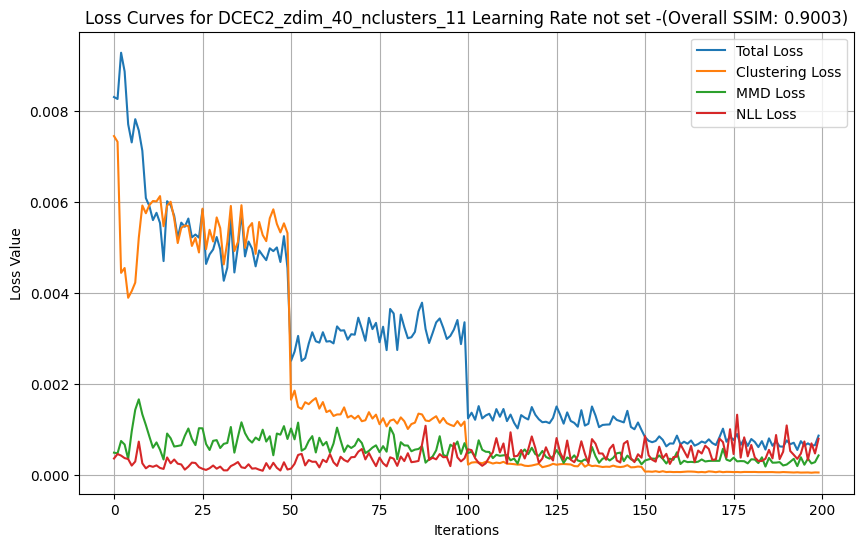

Model saved for z_dim=40 and n_clusters=11
Training DCEC with z_dim=40 and n_clusters=12...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0044 - loss_mmd: 0.0015 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.5554e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9550e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8890e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9080e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8757e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8877e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8806e-04


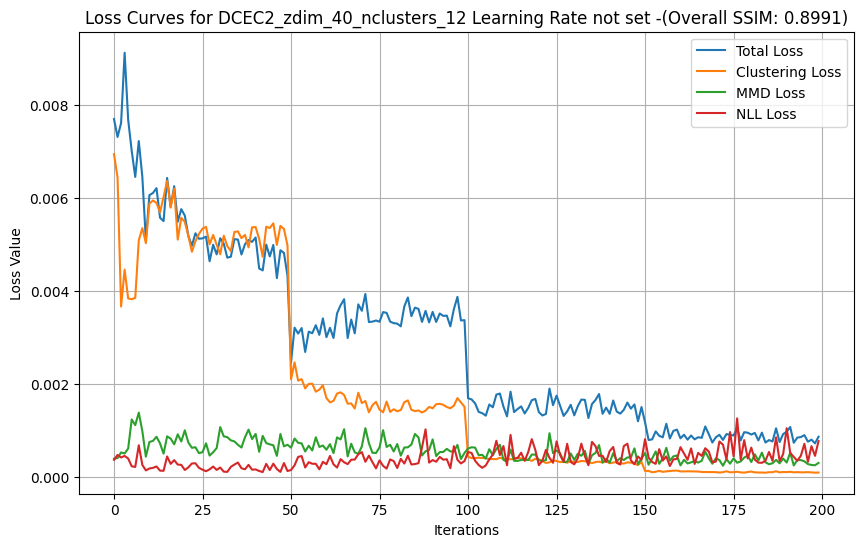

Model saved for z_dim=40 and n_clusters=12
Training DCEC with z_dim=40 and n_clusters=13...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0015 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0014 - loss_nll: 9.6409e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9811e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9132e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8739e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8654e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8954e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8720e-04


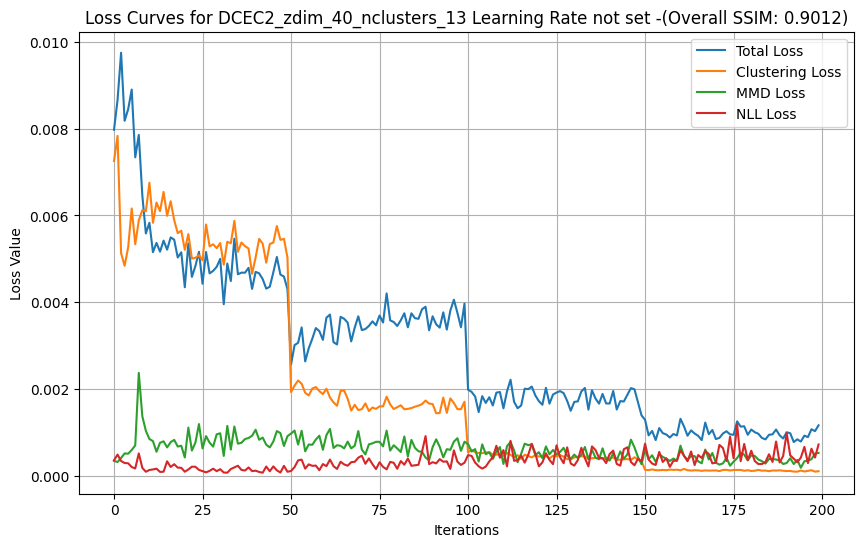

Model saved for z_dim=40 and n_clusters=13
Training DCEC with z_dim=40 and n_clusters=14...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - loss: 0.0023 - loss_mmd: 0.0014 - loss_nll: 9.2086e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 9.0387e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9256e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8946e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8606e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8962e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8462e-04


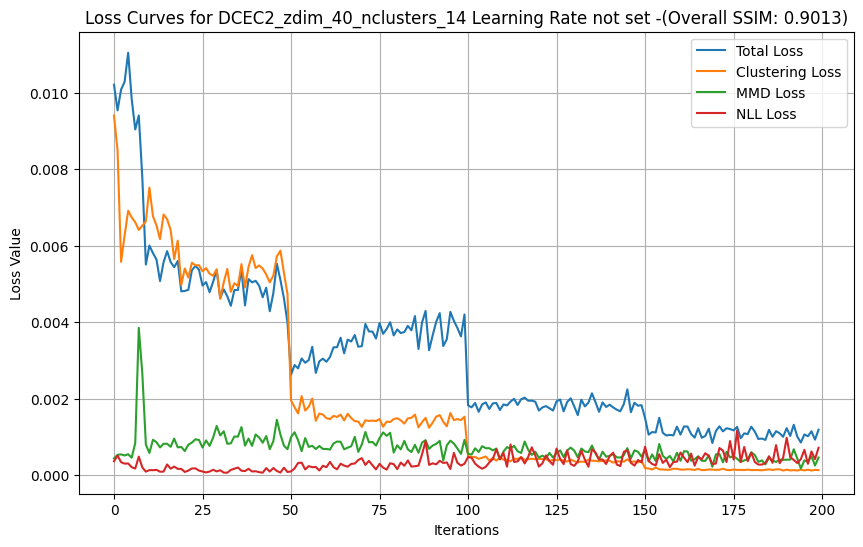

Model saved for z_dim=40 and n_clusters=14
Training DCEC with z_dim=40 and n_clusters=15...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 12s 17ms/step - loss: 0.0042 - loss_mmd: 0.0014 - loss_nll: 0.0028
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 9.1767e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9479e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9621e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8917e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8869e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8691e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8718e-04


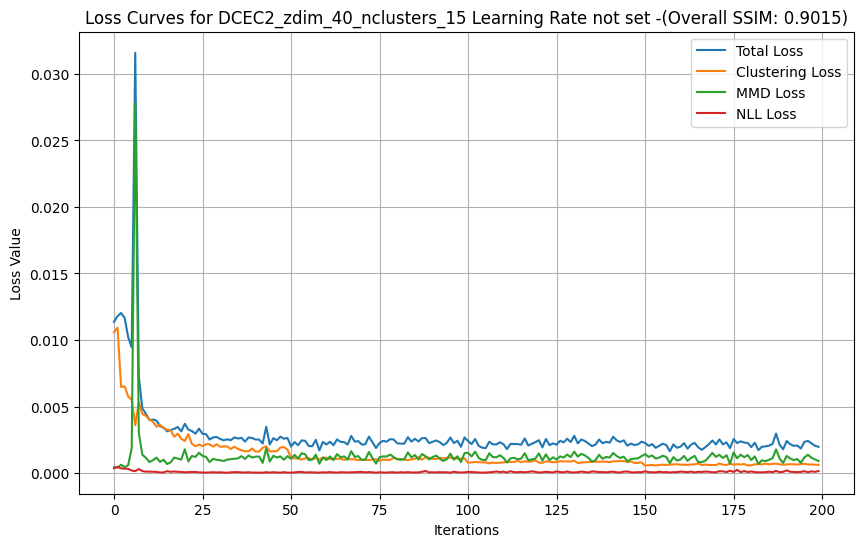

Model saved for z_dim=40 and n_clusters=15
Training DCEC with z_dim=40 and n_clusters=16...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.4939e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9516e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9149e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8711e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8980e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8599e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8707e-04


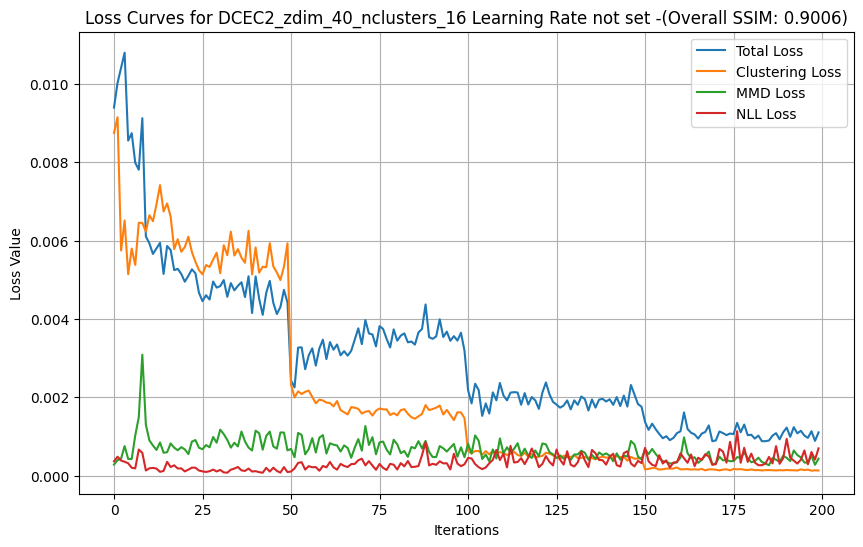

Model saved for z_dim=40 and n_clusters=16
Training DCEC with z_dim=40 and n_clusters=17...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0044 - loss_mmd: 0.0014 - loss_nll: 0.0029
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.5120e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9133e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8918e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8577e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8779e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8754e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8393e-04


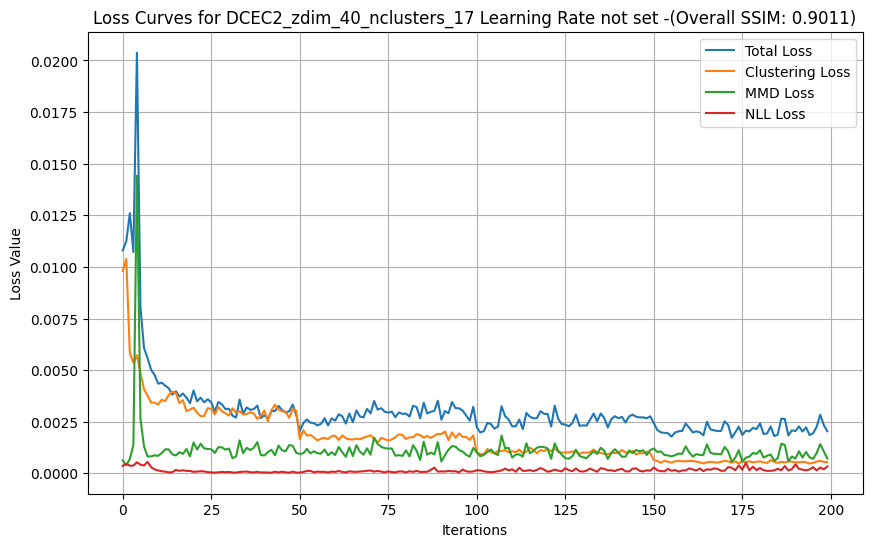

Model saved for z_dim=40 and n_clusters=17
Training DCEC with z_dim=40 and n_clusters=18...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0014 - loss_nll: 0.0030
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.3519e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9222e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9290e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8980e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9126e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9030e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8480e-04


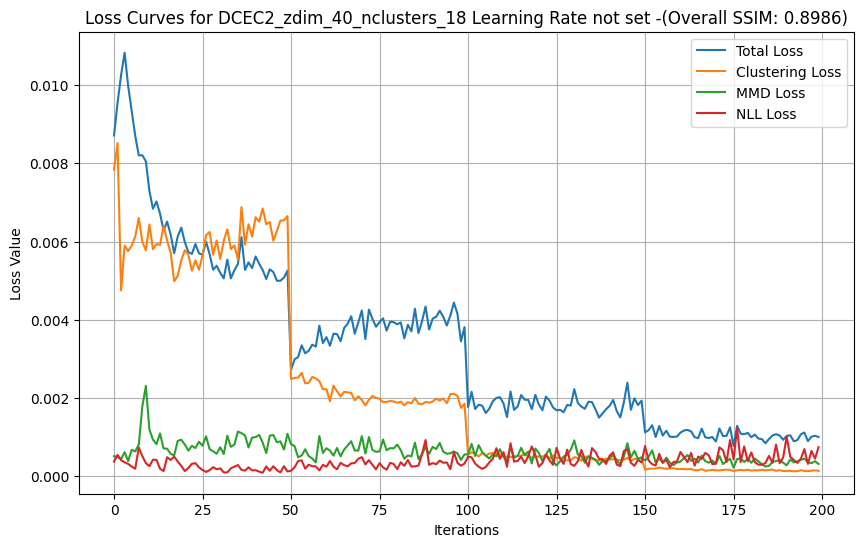

Model saved for z_dim=40 and n_clusters=18
Training DCEC with z_dim=40 and n_clusters=19...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0045 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0013 - loss_nll: 9.4084e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9486e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9203e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8760e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8971e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0014 - loss_nll: 8.8788e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8443e-04


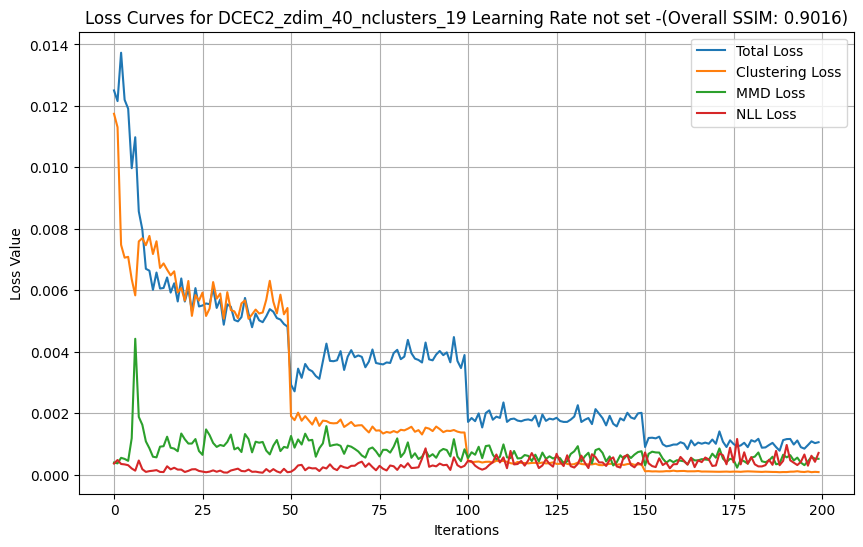

Model saved for z_dim=40 and n_clusters=19
Training DCEC with z_dim=40 and n_clusters=20...
...Pretraining autoencoder...
Epoch 1/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 11s 17ms/step - loss: 0.0046 - loss_mmd: 0.0014 - loss_nll: 0.0031
Epoch 2/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 9.1622e-04
Epoch 3/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.9357e-04
Epoch 4/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8832e-04
Epoch 5/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0014 - loss_nll: 8.9223e-04
Epoch 6/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8652e-04
Epoch 7/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8598e-04
Epoch 8/200
269/269 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0022 - loss_mmd: 0.0013 - loss_nll: 8.8470e-04


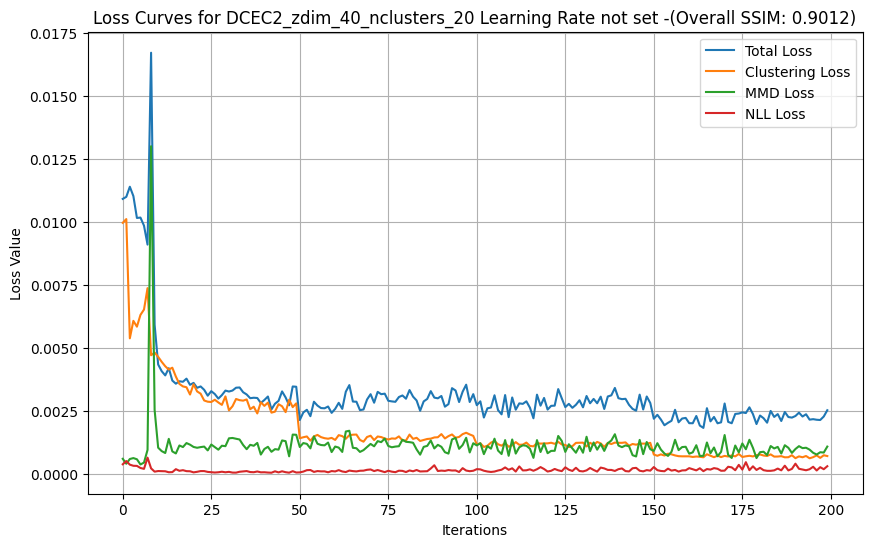

Model saved for z_dim=40 and n_clusters=20


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

        # Ensure the variables of encoder and decoder are tracked
        self._trainable_variables = self.encoder.trainable_variables + self.decoder.trainable_variables


    @property
    def trainable_variables(self):
        return self._trainable_variables

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)
            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)
            loss_nll = tf.reduce_mean(tf.square(xr - x))
            total_loss = loss_mmd + loss_nll

            # Compute gradients
            gradients = tape.gradient(total_loss, self.trainable_variables)
            # Apply gradients
            self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

            # Debug: Print batch loss

            # Track batch losses for averaging at epoch level
            #self.epoch_loss_mmd.append(loss_mmd)  # Store the tensor
            #self.epoch_loss_nll.append(loss_nll)  # Store the tensor

            # Return loss for progress bar
            return {'loss': total_loss, 'loss_mmd': loss_mmd, 'loss_nll': loss_nll}

# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam'):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv1)
        en_conv2 = BatchNormalization()(en_conv2)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv2)
        en_conv3 = BatchNormalization()(en_conv3)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters=256, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.01))(en_conv3)
        en_conv4 = BatchNormalization()(en_conv4)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1 = Flatten()(en_conv4)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        def compute_latent(x):
            mu, sigma = x
            batch = tf.shape(mu)[0]
            eps = tf.random.normal(shape=(batch, self.z_dim), mean=0., stddev=1.)
            return mu + tf.exp(sigma) * eps

        latent_space = Lambda(compute_latent, name='latent_space')([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(
            en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu'
        )(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(
            filters=128, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_fc2)
        de_conv2 = Conv2DTranspose(
            filters=64, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv1)
        de_conv3 = Conv2DTranspose(
            filters=32, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv2)
        decoder_output = Conv2DTranspose(
            filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same'
        )(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=64, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # Build autoencoder model for pretraining
        autoencoder = CustomLossLayer(self.encoder, self.decoder, total_epochs = epochs)
        autoencoder.compile(optimizer=optimizer)

        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        p = weight / weight_sum
        return p

    def fit(self, x, y=None, batch_size=64, maxiter=200, tol=1e-3, update_interval=50, save_dir='save_dir', patience=5):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []
        nll_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []
        w_nll_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses=3, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = (1. - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0

            # Update stats for each loss (loop through all losses)
            x_l = l  # Loss ratios
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            # Update running mean for absolute loss values
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            # Calculate CoV for each loss
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)

            # Penalize clustering loss if its magnitude is higher
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # Assuming index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])

            # Normalize weights
            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_losses)
            l = L / tf.maximum(self.running_mean_L, 1e-8)  # Loss ratios

            # Update running statistics
            if self.current_iter == 0:
                self.running_mean_L = L
            else:
                self.update_stats(L, l)

            # Compute weights dynamically
            if self.current_iter > 1:
                self.compute_weights()

            # Weighted Loss
            weighted_loss = [self.alphas[i] * unweighted_losses[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=3)  # 2 because of the MMD and clustering losses

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses
                loss_mmd = compute_mmd(latent, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x_batch))
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_losses = loss_mmd + loss_clustering + loss_nll

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_nll, loss_clustering]
                total_loss = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))

                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())
                nll_loss_list.append(loss_nll.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f},"
                      f"Unweighted MMD Loss: {loss_mmd.numpy():.8f}, Unweighted NLL Loss: {loss_nll.numpy():.8f}")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd, weight_nll = weights[1], weights[0], weights[2]
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                weighted_nll_loss = weight_nll * loss_nll
                #weighted_total_loss = weighted_clustering_loss + weighted_mmd_loss + weighted_nll_loss
                print(f"Iter {ite}, Weighted Total Loss: {total_loss:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}, Weighted NLL Loss: {weighted_nll_loss.numpy():.8f}")

                # Track unweighted losses
                w_total_loss_list.append(total_loss.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss)
                w_nll_loss_list.append(weighted_nll_loss.numpy())

            # Plot losses at the end of training
            model_name = f"DCEC2_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.plot(w_nll_loss_list, label='NLL Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate not set -(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_loss_curves.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = range(2, 21)


for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=64, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=64, update_interval=50, save_dir='save_dir', patience=5)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4'
        model_name = f'DCEC2_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')


## Final

Training DCEC with z_dim=40 and n_clusters=2...
...Pretraining autoencoder...
Epoch 1/200


/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 7ms/step - loss: 0.0024 - loss_mmd: 0.0024
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0023 - loss_mmd: 0.0023
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 9/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 10/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 11/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0022 - loss_mmd: 0.0022
Epoch 12/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/ste

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00797745, Unweighted Clustering Loss: 0.00515839, Unweighted MMD Loss: 0.00281906
Iter 0, Weighted Total Loss: 0.00398872, Weighted Clustering Loss: 0.00257919, Weighted MMD Loss: 0.00140953
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 0.00990566, Unweighted Clustering Loss: 0.00755843, Unweighted MMD Loss: 0.00234723
Iter 1, Weighted Total Loss: 0.00495283, Weighted Clustering Loss: 0.00377922, Weighted MMD Loss: 0.00117362
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 0.00621907, Unweighted Clustering Loss: 0.00435702, Unweighted MMD Loss: 0.00186205
Iter 2, Weighted Total Loss: 0.00234000, Weighted Clustering Loss: 0.00083465, Weighted MMD Loss: 0.00150534
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history,

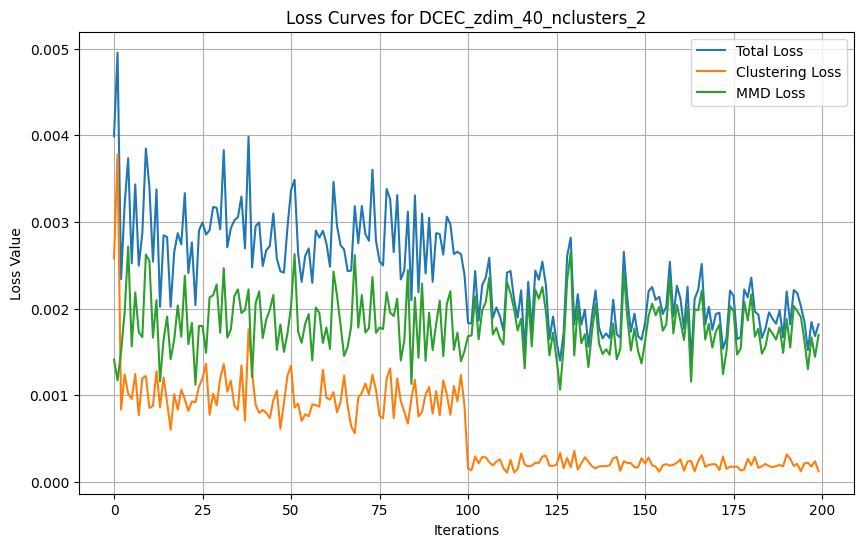

AttributeError: 'DCEC' object has no attribute 'save_model'

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        # Expand inputs for broadcasting
        inputs_expanded = K.expand_dims(inputs, axis=1)  # (batch_size, 1, latent_dim)
        cluster_expanded = K.expand_dims(self.clusters, axis=0)  # (1, n_clusters, latent_dim)
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q


# Define the CustomLossLayer
## MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    tiled_x = tf.tile(tf.reshape(x, tf.stack([x_size, 1, dim])), tf.stack([1, y_size, 1]))
    tiled_y = tf.tile(tf.reshape(y, tf.stack([1, y_size, dim])), tf.stack([x_size, 1, 1]))
    return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, tf.float32))

def compute_mmd(x, y, sigma_sqr=1.0):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def __init__(self, encoder, decoder, **kwargs):
        super(CustomLossLayer, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.mmd_tracker = tf.keras.metrics.Mean(name="mmd_loss")
        self.nll_tracker = tf.keras.metrics.Mean(name="nll_loss")

    def call(self, inputs):
        latent_space, train_z, train_xr, train_x = inputs
        # true_samples = tf.random.normal(tf.stack([200, z_dim]))
        loss_mmd = compute_mmd(latent_space, train_z)
        loss_nll = tf.reduce_mean(tf.square(train_xr - train_x))
        # Update the trackers
        self.mmd_tracker.update_state(loss_mmd)
        self.nll_tracker.update_state(loss_nll)

        # Add the total loss
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def reset_states(self):  # Added for resetting at the start of each epoch
        self.mmd_tracker.reset_states()
        self.nll_tracker.reset_states()

    def compute_output_shape(self, input_shape):
        return input_shape[1]


# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam'):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        encoder_input = Input(shape=(raw.shape[1], raw.shape[2],1))
        en_conv1 = Conv2D(filters = 32, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.001))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters = 64, kernel_size=4, strides=2, padding='same')(en_conv1)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters = 128, kernel_size=4, strides=2, padding='same')(en_conv2)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters = 256, kernel_size=4, strides=2, padding='same')(en_conv3)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1= Flatten()(en_conv3)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        #Compute latent using mean and variance
        @tf.keras.utils.register_keras_serializable()
        def compute_latent(x):
            mu, sigma = x
            batch = K.shape(mu)[0]
            dim = K.int_shape(mu)[1]
            eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
            return mu + K.exp(sigma)*eps
        latent_space = Lambda(compute_latent)([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
        de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
        de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
        decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')
        self.current_epoch = 0

    @property
    def trainable_variables(self):
        # Combine trainable variables from encoder, decoder, and clustering layer
        return (
            self.encoder.trainable_variables
            + self.decoder.trainable_variables
            + self.clustering_layer.trainable_variables
        )

    def pretrain(self, x, batch_size=64, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # For pre training build the autoencoder by combining encoder, CustomLossLayer, and decoder
        latent_space, train_z, train_xr, train_x = self.encoder.output[2], self.encoder.output[2], self.decoder(self.encoder.output[2]), self.encoder.input
        autoencoder_output = CustomLossLayer(self.encoder, self.decoder)([latent_space, train_z, train_xr, train_x])
        autoencoder = tf.keras.Model(inputs=self.encoder.input, outputs=autoencoder_output, name='autoencoder')

        # Add encoder and decoder as attributes of the model
        autoencoder.encoder = self.encoder
        autoencoder.decoder = self.decoder
        # Compile the autoencoder
        optimizer = tf.keras.optimizers.Adam()
        autoencoder.compile(optimizer=optimizer)
        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        print("weight_numerator shape:", weight_numerator.shape)

        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        print("weight_denominator shape:", weight_denominator.shape)

        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        print("weight shape:", weight.shape)

        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        print("weight_sum shape:", weight_sum.shape)

        p = weight / weight_sum
        print("p shape:", p.shape)
        return p

    def fit(self, x, y=None, batch_size=64, maxiter=200, tol=1e-3, update_interval=50, save_dir='save_dir', patience=5):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        initial_cluster_weights = [kmeans.cluster_centers_] # Storing the initial cluster weights for safety
        self.clustering_layer.set_weights(initial_cluster_weights)

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0
        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []
        nll_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []
        w_nll_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses=3, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = (1. - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0  # Calculate a single value

            # Update stats for l
            x_l = l
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            #update stats for L
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            #computing weights based off of Coefficient of Variation
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)
            # Apply penalty to clustering loss weight
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])  # Penalize clustering loss weight

            # normalise weights
            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_loss)
            epsilon = 1e-6  # Increase epsilon to ensure stability

            # Clamp running_mean_l for stability
            self.running_mean_l = tf.maximum(self.running_mean_l, epsilon)

            # Calculate normalized losses (l)
            l = tf.divide(L, self.running_mean_l)  # Normalize losses
            print("Normalized losses (l):", l.numpy())  # Debugging

            # Update running statistics
            if self.current_iter == 0:
                self.running_mean_L = L
            else:
                self.update_stats(L, l)

            # Compute weights using CoV
            if self.current_iter > 1:
                self.compute_weights()

            # Weighted loss
            weighted_loss = [self.alphas[i] * unweighted_loss[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=3)  # 2 because of the MMD and clustering losses

        # Training loop
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses * 1e6
                loss_mmd = compute_mmd(latent, train_z)
                loss_nll = tf.reduce_mean(tf.square(xr - x_batch))
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_losses = loss_mmd + loss_nll + loss_clustering

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_nll, loss_clustering]
                total_loss = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))


                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())
                nll_loss_list.append(loss_nll.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}, "
                      f"Unweighted MMD Loss: {loss_mmd.numpy():.8f}, Unweighted NLL Loss: {loss_nll.numpy():.8f}")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd, weight_nll = weights[1], weights[0], weights[2]
                #scaled_mmd = loss_mmd * 1e5
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                weighted_nll_loss = weight_nll * loss_nll
                print(f"Iter {ite}, Weighted Total Loss: {total_loss:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}, Weighted NLL Loss: {weighted_nll_loss}")

                # Track unweighted losses
                w_total_loss_list.append(total_loss.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss.numpy())
                w_nll_loss_list.append(weighted_nll_loss.numpy())

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        overall_ssim = self.calculate_overall_ssim(x)
        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim)

    def calculate_overall_ssim(self, x):
        """
        Calculate the overall SSIM score for the dataset.
        Args:
            x: The input dataset (original images).
        Returns:
            The overall SSIM score.
        """
        _, _, latent_space = self.encoder(x)
        xr = self.decoder(latent_space)
        overall_ssim = tf.reduce_mean(tf.image.ssim(x, xr, max_val=1.0))  # Assuming pixel values are normalized
        return overall_ssim.numpy()

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, w_nll_loss_list, save_dir, model_name, overall_ssim):
        """
        Plot and save loss curves after training.
        """
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'

        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.plot(w_nll_loss_list, label='NLL Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name} Learning Rate not set-(Overall SSIM: {overall_ssim:.4f})')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_all_loss_curves.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()

input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = [2]

for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=64, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        history = dcec.fit(data_train, maxiter=200, batch_size=64, update_interval=50, save_dir='save_dir', patience=5)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')

        # Save the complete model
        input_data = Input(shape=dcec.encoder.input_shape[1:])
        mu, sigma, latent = dcec.encoder(input_data)
        clustering_output = dcec.clustering_layer(latent)
        decoded_output = dcec.decoder(latent)

        # Create the full model
        full_model = Model(inputs=input_data, outputs=[clustering_output, decoded_output], name="DCEC_Model")
        full_model.save(f'/content/drive/MyDrive/Masters Dataset/DCEC/DCEC_dim{z_dim}_clusters_{k}.h5')
        print(f"Complete model saved for z_dim={z_dim} and n_clusters={k}")

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')



### Get Cluster Assignments

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope

# Base directory for saved models and weights
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'

# Parameters (adjust as needed)
dimensions = [40]  # Latent space dimensions
K_values = range(2, 21)  # Number of clusters

# Define the compute_latent function before loading the model
@tf.keras.utils.register_keras_serializable()  # This decorator is crucial
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, 40), mean=0., stddev=1.)  # z_dim replaced with 40
    return mu + K.exp(sigma) * eps

# Loop through each model (z_dim, k)
for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        encoder_path = os.path.join(save_dir, f'{model_name}_encoder.h5')
        clustering_weights_path = os.path.join(save_dir, f'{model_name}_clustering_weights.npy')
        cluster_assignments_path = os.path.join(save_dir, f'{model_name}_cluster_assignments.npy')

        # Check if the required files exist
        if not (os.path.exists(encoder_path) and os.path.exists(clustering_weights_path)):
            print(f"Missing files for z_dim={z_dim}, k={k}. Skipping...")
            continue

        print(f"Processing z_dim={z_dim}, k={k}...")

        # Load encoder model
        with custom_object_scope({'ClusteringLayer': ClusteringLayer}):
            encoder = load_model(encoder_path, compile=False)

        # Initialize and load clustering layer
        clustering_layer = ClusteringLayer(n_clusters=k)
        clustering_layer.build(input_shape=(None, z_dim))  # Build with appropriate shape

        # Load and reshape clustering weights
        clustering_weights = np.load(clustering_weights_path)  # Load weights
        if clustering_weights.ndim == 3 and clustering_weights.shape[0] == 1:
            clustering_weights = clustering_weights[0]  # Remove extra dimension
        clustering_layer.set_weights([clustering_weights])  # Set weights
        # Compute latent space representations
        latent_space = encoder.predict(data_train)[2]  # Ensure you select the correct encoder output

        # Compute cluster assignments
        q = clustering_layer(latent_space)  # Soft assignments
        cluster_assignments = tf.argmax(q, axis=1).numpy()  # Convert to hard assignments

        # Save cluster assignments
        np.save(cluster_assignments_path, cluster_assignments)
        print(f"Cluster assignments saved to {cluster_assignments_path}")


Processing z_dim=40, k=2...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_2_cluster_assignments.npy
Processing z_dim=40, k=3...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_3_cluster_assignments.npy
Processing z_dim=40, k=4...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_4_cluster_assignments.npy
Processing z_dim=40, k=5...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_5_cluster_assignments.npy
Processing z_dim=40, k=6...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_6_cluster_assignments.npy
Processing z_dim=40, k=7...
538/538 ━━━━━━━━━

### CLustering assignments table


In [ ]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model
from scipy.spatial.distance import cdist
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Define paths and parameters
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
model_name = 'DCEC_zdim_40_nclusters_3'  # Update with your specific model name
encoder_path = f'{save_dir}/{model_name}_encoder.h5'
cluster_centroids_path = f'{save_dir}/{model_name}_cluster_centroids.npy'
test_data_path = '/content/drive/MyDrive/test_data.npy'  # Update with your test data path
results_dir = f"{save_dir}/test_results"

# Ensure results directory exists
if not os.path.exists(results_dir):
    os.makedirs(results_dir)

# Load test data

# Load the encoder
print(f'Loading encoder from {encoder_path}...')
encoder = load_model(encoder_path, compile=False)

# Load cluster centroids
print(f'Loading cluster centroids from {cluster_centroids_path}...')
cluster_centroids = np.load(cluster_centroids_path)

# Get latent space and clustering probabilities
print('Computing latent space and cluster assignments...')
latent_mu, latent_sigma, latent_space = encoder.predict(data_test)
cluster_assignments = np.argmin(cdist(latent_space, cluster_centroids), axis=1)

# Save cluster assignments as a CSV
print('Saving cluster assignments...')
assignments_df = pd.DataFrame({
    'Sample Index': np.arange(len(data_test)),
    'Assigned Cluster': cluster_assignments
})
assignments_csv_path = f"{results_dir}/{model_name}_test_data_cluster_assignments.csv"
assignments_df.to_csv(assignments_csv_path, index=False)
print(f"Cluster assignments saved to {assignments_csv_path}")
'''
# Plot topographic input map
print('Generating topographic input map...')
def plot_topographic_map(latent_space, cluster_assignments, save_path):
    """
    Generate a 2D topographic input map for the test data.

    Args:
        latent_space: Latent representations of the test data.
        cluster_assignments: Cluster indices for each test sample.
        save_path: Path to save the plot.
    """
    # Use the first two latent dimensions for visualization
    latent_2d = latent_space[:, :2]

    plt.figure(figsize=(10, 8))
    sns.scatterplot(
        x=latent_2d[:, 0],
        y=latent_2d[:, 1],
        hue=cluster_assignments,
        palette='tab10',
        legend="full"
    )
    plt.title("Topographic Input Map - Test Data")
    plt.xlabel("Latent Dimension 1")
    plt.ylabel("Latent Dimension 2")
    plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)

    # Save and show the plot
    plt.savefig(save_path, bbox_inches='tight')
    plt.show()

# Save the plot
topographic_map_path = f"{results_dir}/{model_name}_test_data_cluster_plot.png"
plot_topographic_map(latent_space, cluster_assignments, topographic_map_path)
print(f"Topographic input map saved to {topographic_map_path}")
'''

Loading encoder from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_40_nclusters_3_encoder.h5...
Loading cluster centroids from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_40_nclusters_3_cluster_centroids.npy...
Computing latent space and cluster assignments...
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Saving cluster assignments...
Cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/test_results/DCEC_zdim_40_nclusters_3_test_data_cluster_assignments.csv


'\n# Plot topographic input map\nprint(\'Generating topographic input map...\')\ndef plot_topographic_map(latent_space, cluster_assignments, save_path):\n    """\n    Generate a 2D topographic input map for the test data.\n\n    Args:\n        latent_space: Latent representations of the test data.\n        cluster_assignments: Cluster indices for each test sample.\n        save_path: Path to save the plot.\n    """\n    # Use the first two latent dimensions for visualization\n    latent_2d = latent_space[:, :2]\n\n    plt.figure(figsize=(10, 8))\n    sns.scatterplot(\n        x=latent_2d[:, 0],\n        y=latent_2d[:, 1],\n        hue=cluster_assignments,\n        palette=\'tab10\',\n        legend="full"\n    )\n    plt.title("Topographic Input Map - Test Data")\n    plt.xlabel("Latent Dimension 1")\n    plt.ylabel("Latent Dimension 2")\n    plt.legend(title="Cluster", bbox_to_anchor=(1.05, 1), loc=\'upper left\')\n    plt.grid(True)\n\n    # Save and show the plot\n    plt.savefig(sa

### v2

In [ ]:
import numpy as np
import tensorflow as tf
import pandas as pd
from sklearn.metrics import silhouette_score
import os

# Define the assign_clusters function
def assign_clusters(model, test_data, save_dir, model_name):
    """
    Assign clusters to test data and save results.

    Args:
        model: Trained DCEC model (encoder and clustering layer).
        test_data: Test data for cluster assignment.
        save_dir: Directory to save results.
        model_name: Identifier for saving the output files.

    Returns:
        latent_vectors: Latent vectors for the test data.
        cluster_assignments: Cluster assignments for the test data.
    """
    # Extract latent space and cluster probabilities
    _, _, latent_space = model.encoder.predict(data_test)
    cluster_probs = model.clustering_layer(latent_space)
    cluster_assignments = tf.argmax(cluster_probs, axis=1).numpy()

    # Save latent vectors and cluster assignments
    np.save(f'{save_dir}/{model_name}_test_latent_vectors.npy', latent_space)
    np.save(f'{save_dir}/{model_name}_test_cluster_assignments.npy', cluster_assignments)

    # Create a DataFrame for easier analysis
    results_df = pd.DataFrame({
        'Sample_Index': range(len(cluster_assignments)),
        'Cluster_Assignment': cluster_assignments
    })
    results_df.to_csv(f'{save_dir}/{model_name}_test_cluster_results.csv', index=False)
    print(f"Results saved to {save_dir}/{model_name}_test_cluster_results.csv")

    return latent_space, cluster_assignments

#initializing empty data frame for results
cluster_results = pd.DataFrame()


# Loop through all combinations of z_dim and k
dimensions = [40]  # Add more dimensions if applicable
K_values = range(2, 21)  # Range of cluster numbers
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'

# Prepare the test dataset (ensure it is loaded and normalized)

for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        print(f"Evaluating model: {model_name}")

        # Load the full trained model
        full_model_path = f'{save_dir}/{model_name}_full_model.h5'
        if not os.path.exists(full_model_path):
            print(f"Model for z_dim={z_dim}, k={k} not found. Skipping...")
            continue

        full_model = tf.keras.models.load_model(
            full_model_path,
            custom_objects={'ClusteringLayer': ClusteringLayer}
        )

        # Extract the encoder and clustering layer from the full model
        encoder = full_model.get_layer(name='encoder')
        clustering_layer = full_model.get_layer(name='clustering')

        # Assign clusters to test data
        _, _, latent_space = encoder.predict(data_test)
        cluster_probs = clustering_layer(latent_space)
        cluster_assignments = tf.argmax(cluster_probs, axis=1).numpy()

        # Add cluster assignments to the consolidated DataFrame
        cluster_results[f'Cluster Assignment k={k}'] = cluster_assignments

        # Optionally compute metrics
        silhouette_avg = silhouette_score(latent_space, cluster_assignments)
        print(f"Silhouette Score for {model_name}: {silhouette_avg}")

# Add sample indices to the consolidated DataFrame
cluster_results.insert(0, 'Sample_Index', range(len(data_test)))

# Save consolidated cluster assignments to a single CSV
output_path = f'{save_dir}/test_cluster_assignments_consolidated.csv'
cluster_results.to_csv(output_path, index=False)
print(f"Consolidated cluster assignments saved to {output_path}")



Evaluating model: DCEC_zdim_40_nclusters_2
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_2: 0.7209328413009644
Evaluating model: DCEC_zdim_40_nclusters_3


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_3: 0.24310395121574402
Evaluating model: DCEC_zdim_40_nclusters_4


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_4: 0.23181553184986115
Evaluating model: DCEC_zdim_40_nclusters_5


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_5: 0.19484741985797882
Evaluating model: DCEC_zdim_40_nclusters_6


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_6: 0.1322634369134903
Evaluating model: DCEC_zdim_40_nclusters_7


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_7: 0.14226482808589935
Evaluating model: DCEC_zdim_40_nclusters_8


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_8: 0.13513758778572083
Evaluating model: DCEC_zdim_40_nclusters_9


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_9: 0.12345778942108154
Evaluating model: DCEC_zdim_40_nclusters_10


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_10: 0.11408649384975433
Evaluating model: DCEC_zdim_40_nclusters_11


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_11: 0.11074796319007874
Evaluating model: DCEC_zdim_40_nclusters_12


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_12: 0.12175410240888596
Evaluating model: DCEC_zdim_40_nclusters_13


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_13: 0.12449084967374802
Evaluating model: DCEC_zdim_40_nclusters_14


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_14: 0.11781616508960724
Evaluating model: DCEC_zdim_40_nclusters_15


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_15: 0.10823091119527817
Evaluating model: DCEC_zdim_40_nclusters_16


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_16: 0.11668599396944046
Evaluating model: DCEC_zdim_40_nclusters_17


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_17: 0.1163298711180687
Evaluating model: DCEC_zdim_40_nclusters_18


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_18: 0.11859983950853348
Evaluating model: DCEC_zdim_40_nclusters_19


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_19: 0.09910072386264801
Evaluating model: DCEC_zdim_40_nclusters_20


116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
Silhouette Score for DCEC_zdim_40_nclusters_20: 0.1080475002527237
Consolidated cluster assignments saved to /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/test_cluster_assignments_consolidated.csv


In [ ]:
tf.print("Weights:", weights)

NameError: name 'weights' is not defined

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step


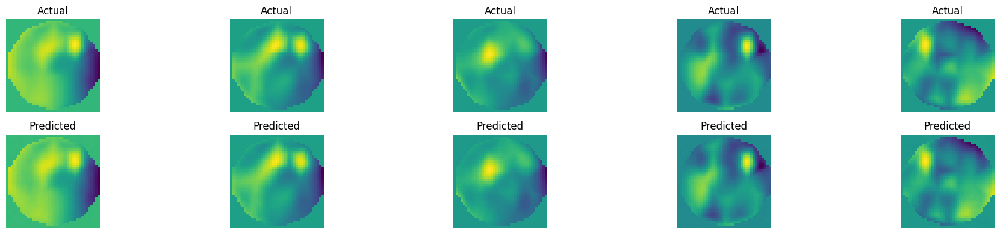

In [ ]:
# Select a subset of actual images from the test set
num_images = 5  # Number of images to display per row
actual_images = data_test[:num_images]  # Assuming data_test is normalized and has the same shape as the input

# Generate predicted images for the selected actual images
mu, sigma, latent_vectors = dcec.encoder.predict(actual_images)  # Use the encoder to get latent representations
predicted_images = dcec.decoder.predict(latent_vectors)  # Use the decoder to reconstruct the images

# Visualize the actual and predicted images
fig, axes = plt.subplots(nrows=2, ncols=num_images, sharex=True, sharey=True, figsize=(20, 4))

# First row: actual images
for i, ax in enumerate(axes[0]):
    ax.imshow(actual_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
    ax.set_title("Actual")
    ax.axis('off')

# Second row: predicted images
for i, ax in enumerate(axes[1]):
    ax.imshow(predicted_images[i].reshape((raw.shape[1], raw.shape[2])), cmap='viridis')
    ax.set_title("Predicted")
    ax.axis('off')

plt.tight_layout()
plt.savefig('Actual_vs_Predicted_Comparison.png')
plt.show()

# Optional: Save denormalized predicted images for further evaluation
denormalized_predicted_images = (
    predicted_images * (raw.max() - raw.min())
) + raw.min()

# Save the denormalized images for future reference
np.save('denormalized_predicted_images.npy', denormalized_predicted_images)


## Gaussian Layer

Training DCEC with z_dim=40 and n_clusters=2...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.2875 - loss_mmd: 0.0028 - loss_nll: 0.2847
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0229 - loss_mmd: 0.0014 - loss_nll: 0.0215
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0071 - loss_mmd: 0.0012 - loss_nll: 0.0060
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0046 - loss_mmd: 0.0011 - loss_nll: 0.0035
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0036 - loss_mmd: 0.0011 - loss_nll: 0.0025
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0035 - loss_mmd: 0.0011 - loss_nll: 0.0024
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 9/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0027 - los

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00211895, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00211895
Iter 0, Weighted Total Loss: 0.00105947, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00105947
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 0.00223041, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00223041
Iter 1, Weighted Total Loss: 0.00111520, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00111520
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 0.50564808, Unweighted Clustering Loss: 0.50359720, Unweighted MMD Loss: 0.00205088
Iter 2, Weighted Total Loss: 0.00425270, Weighted Clustering Loss: 0.00221082, Weighted MMD Loss: 0.00204187
Training completed for z_dim=40 and n_clusters=2.
Model weights, training history,

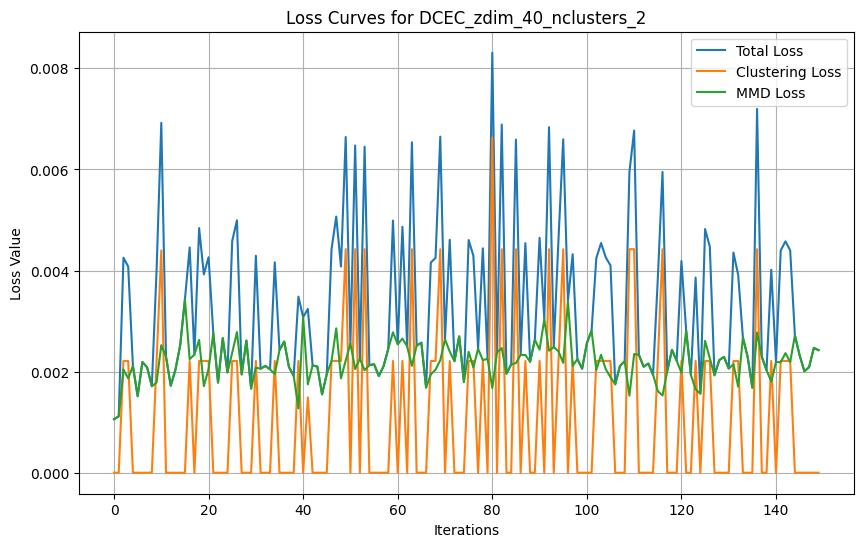

Model saved for z_dim=40 and n_clusters=2
Training DCEC with z_dim=40 and n_clusters=3...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.3328 - loss_mmd: 0.0024 - loss_nll: 0.3304
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0207 - loss_mmd: 0.0013 - loss_nll: 0.0194
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0072 - loss_mmd: 0.0011 - loss_nll: 0.0061
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0043 - loss_mmd: 0.0011 - loss_nll: 0.0032
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0036 - loss_mmd: 0.0011 - loss_nll: 0.0025
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.01338348, Unweighted Clustering Loss: 0.01107368, Unweighted MMD Loss: 0.00230980
Iter 0, Weighted Total Loss: 0.00669174, Weighted Clustering Loss: 0.00553684, Weighted MMD Loss: 0.00115490
Training completed for z_dim=40 and n_clusters=3.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 2.01619864, Unweighted Clustering Loss: 2.01491404, Unweighted MMD Loss: 0.00128460
Iter 1, Weighted Total Loss: 1.00809932, Weighted Clustering Loss: 1.00745702, Weighted MMD Loss: 0.00064230
Training completed for z_dim=40 and n_clusters=3.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 6.55020905, Unweighted Clustering Loss: 6.54797268, Unweighted MMD Loss: 0.00223637
Iter 2, Weighted Total Loss: 0.00640426, Weighted Clustering Loss: 0.00416931, Weighted MMD Loss: 0.00223494
Training completed for z_dim=40 and n_clusters=3.
Model weights, training history,

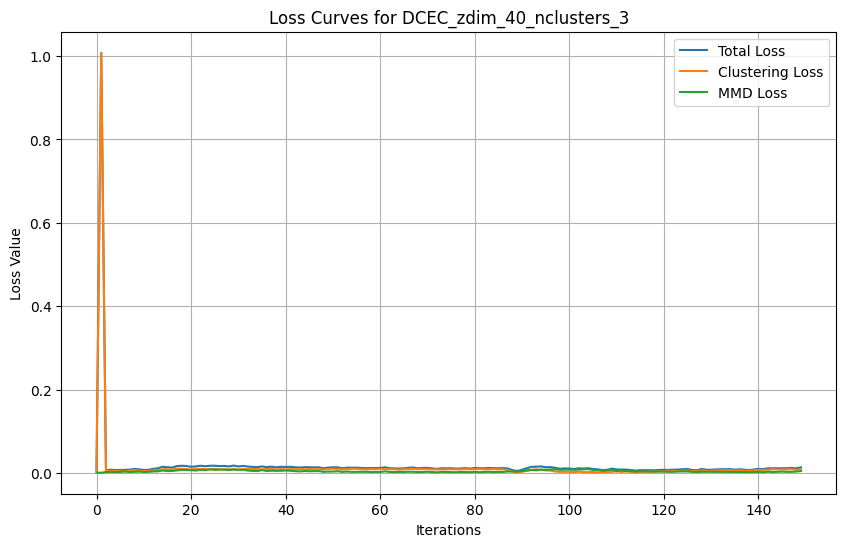

Model saved for z_dim=40 and n_clusters=3
Training DCEC with z_dim=40 and n_clusters=4...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.2763 - loss_mmd: 0.0033 - loss_nll: 0.2730
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0169 - loss_mmd: 0.0015 - loss_nll: 0.0154
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0062 - loss_mmd: 0.0012 - loss_nll: 0.0050
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0041 - loss_mmd: 0.0011 - loss_nll: 0.0029
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0034 - loss_mmd: 0.0011 - loss_nll: 0.0023
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0024 - loss_mmd: 0.0011 - loss_nll: 0.0013
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00178790, Unweighted Clustering Loss: 0.00001228, Unweighted MMD Loss: 0.00177562
Iter 0, Weighted Total Loss: 0.00089395, Weighted Clustering Loss: 0.00000614, Weighted MMD Loss: 0.00088781
Training completed for z_dim=40 and n_clusters=4.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 8.06152821, Unweighted Clustering Loss: 8.05904675, Unweighted MMD Loss: 0.00248158
Iter 1, Weighted Total Loss: 4.03076410, Weighted Clustering Loss: 4.02952337, Weighted MMD Loss: 0.00124079
Training completed for z_dim=40 and n_clusters=4.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 7.05434132, Unweighted Clustering Loss: 7.05166054, Unweighted MMD Loss: 0.00268078
Iter 2, Weighted Total Loss: 0.00485000, Weighted Clustering Loss: 0.00217004, Weighted MMD Loss: 0.00267995
Training completed for z_dim=40 and n_clusters=4.
Model weights, training history,

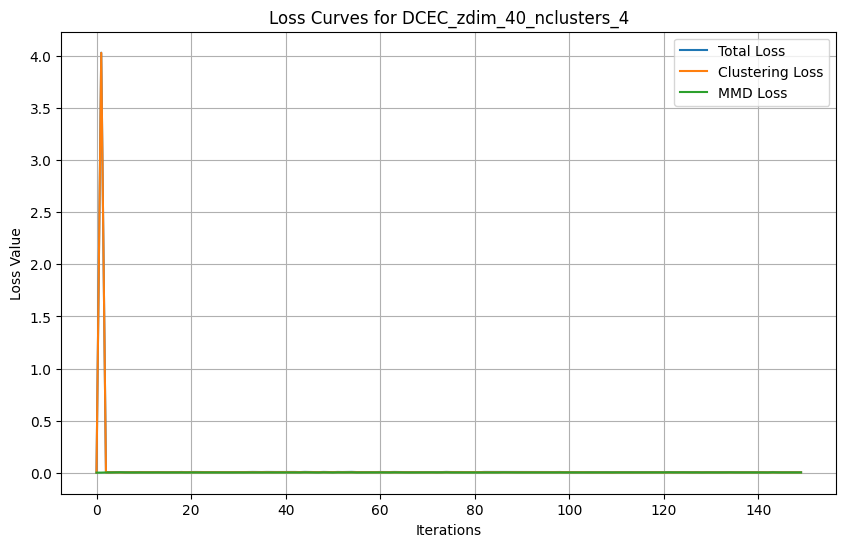

Model saved for z_dim=40 and n_clusters=4
Training DCEC with z_dim=40 and n_clusters=5...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2930 - loss_mmd: 0.0029 - loss_nll: 0.2902
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0188 - loss_mmd: 0.0015 - loss_nll: 0.0173
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0064 - loss_mmd: 0.0012 - loss_nll: 0.0053
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0043 - loss_mmd: 0.0011 - loss_nll: 0.0032
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0011 - loss_nll: 0.0012
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00239182, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00239182
Iter 0, Weighted Total Loss: 0.00119591, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00119591
Training completed for z_dim=40 and n_clusters=5.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 11.08402061, Unweighted Clustering Loss: 11.08118629, Unweighted MMD Loss: 0.00283384
Iter 1, Weighted Total Loss: 5.54201031, Weighted Clustering Loss: 5.54059315, Weighted MMD Loss: 0.00141692
Training completed for z_dim=40 and n_clusters=5.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 9.57263851, Unweighted Clustering Loss: 9.57011795, Unweighted MMD Loss: 0.00252056
Iter 2, Weighted Total Loss: 0.00496608, Weighted Clustering Loss: 0.00244616, Weighted MMD Loss: 0.00251992
Training completed for z_dim=40 and n_clusters=5.
Model weights, training histor

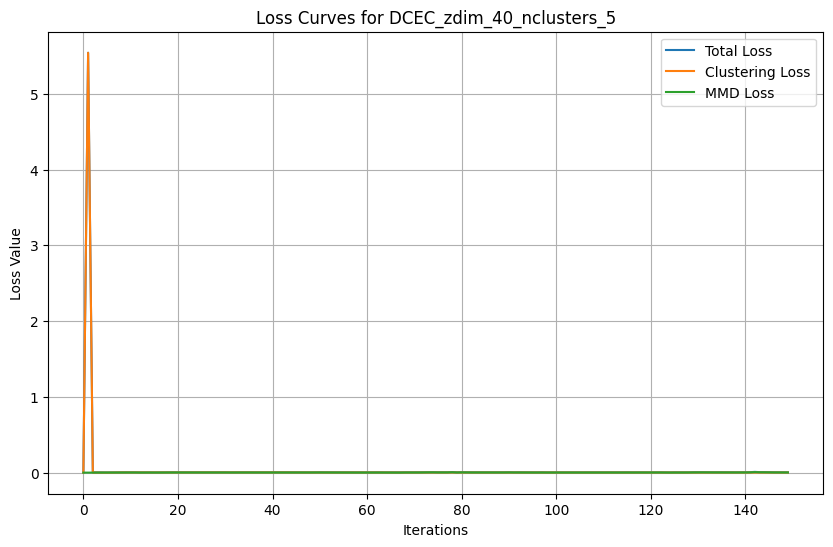

Model saved for z_dim=40 and n_clusters=5
Training DCEC with z_dim=40 and n_clusters=6...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2932 - loss_mmd: 0.0062 - loss_nll: 0.2870
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0211 - loss_mmd: 0.0023 - loss_nll: 0.0188
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0083 - loss_mmd: 0.0015 - loss_nll: 0.0068
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.0053 - loss_mmd: 0.0013 - loss_nll: 0.0040
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0042 - loss_mmd: 0.0012 - loss_nll: 0.0030
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00190222, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00190222
Iter 0, Weighted Total Loss: 0.00095111, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00095111
Training completed for z_dim=40 and n_clusters=6.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 8.06164551, Unweighted Clustering Loss: 8.05904675, Unweighted MMD Loss: 0.00259888
Iter 1, Weighted Total Loss: 4.03082275, Weighted Clustering Loss: 4.02952337, Weighted MMD Loss: 0.00129944
Training completed for z_dim=40 and n_clusters=6.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 11.08319092, Unweighted Clustering Loss: 11.08118916, Unweighted MMD Loss: 0.00200152
Iter 2, Weighted Total Loss: 0.00557204, Weighted Clustering Loss: 0.00357116, Weighted MMD Loss: 0.00200088
Training completed for z_dim=40 and n_clusters=6.
Model weights, training histor

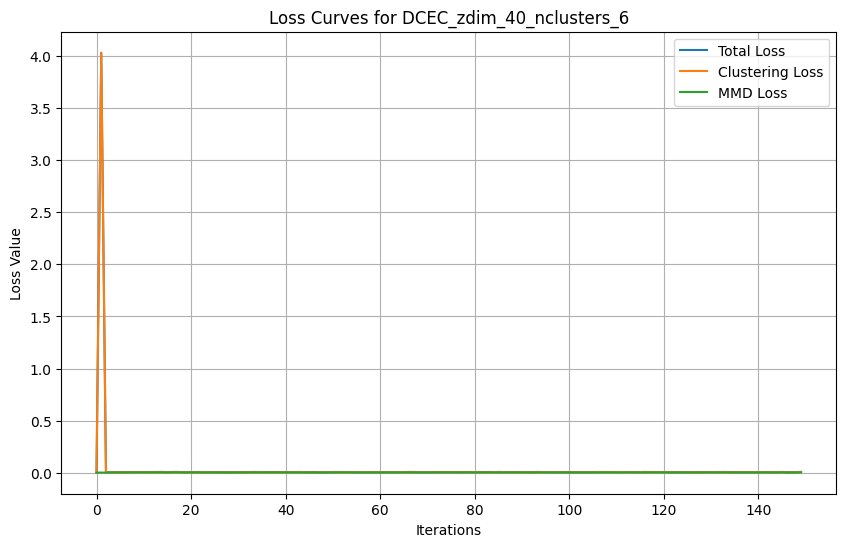

Model saved for z_dim=40 and n_clusters=6
Training DCEC with z_dim=40 and n_clusters=7...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.3150 - loss_mmd: 0.0033 - loss_nll: 0.3117
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0233 - loss_mmd: 0.0017 - loss_nll: 0.0216
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0077 - loss_mmd: 0.0013 - loss_nll: 0.0064
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0046 - loss_mmd: 0.0012 - loss_nll: 0.0035
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0035 - loss_mmd: 0.0011 - loss_nll: 0.0024
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0026 - loss_mmd: 0.0011 - loss_nll: 0.0015
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 1.00918162, Unweighted Clustering Loss: 1.00738132, Unweighted MMD Loss: 0.00180030
Iter 0, Weighted Total Loss: 0.50459081, Weighted Clustering Loss: 0.50369066, Weighted MMD Loss: 0.00090015
Training completed for z_dim=40 and n_clusters=7.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 11.70436668, Unweighted Clustering Loss: 11.70145988, Unweighted MMD Loss: 0.00290656
Iter 1, Weighted Total Loss: 5.85218334, Weighted Clustering Loss: 5.85072994, Weighted MMD Loss: 0.00145328
Training completed for z_dim=40 and n_clusters=7.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 13.09798717, Unweighted Clustering Loss: 13.09595108, Unweighted MMD Loss: 0.00203609
Iter 2, Weighted Total Loss: 0.00528692, Weighted Clustering Loss: 0.00325133, Weighted MMD Loss: 0.00203559
Training completed for z_dim=40 and n_clusters=7.
Model weights, training hist

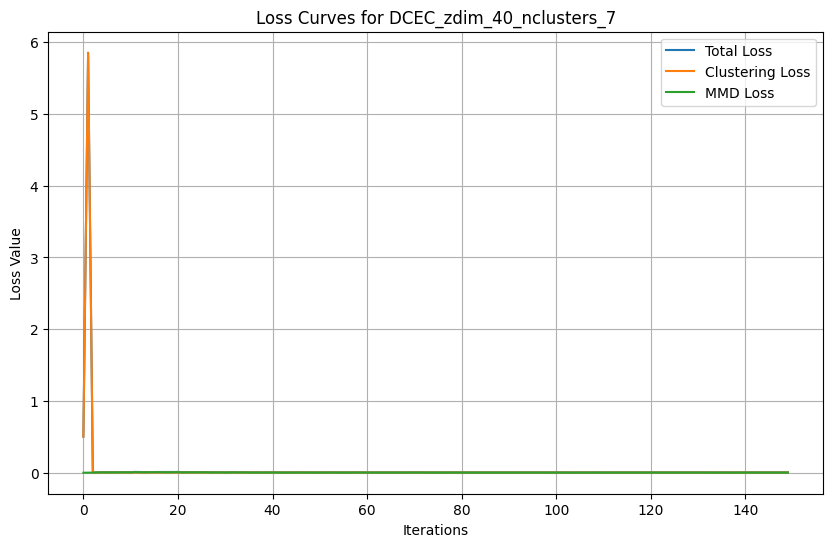

Model saved for z_dim=40 and n_clusters=7
Training DCEC with z_dim=40 and n_clusters=8...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2897 - loss_mmd: 0.0060 - loss_nll: 0.2837
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0254 - loss_mmd: 0.0021 - loss_nll: 0.0232
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0087 - loss_mmd: 0.0015 - loss_nll: 0.0073
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0053 - loss_mmd: 0.0013 - loss_nll: 0.0041
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0044 - loss_mmd: 0.0012 - loss_nll: 0.0032
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0026 - loss_mmd: 0.0011 - loss_nll: 0.0015
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.50659883, Unweighted Clustering Loss: 0.50417006, Unweighted MMD Loss: 0.00242877
Iter 0, Weighted Total Loss: 0.25329942, Weighted Clustering Loss: 0.25208503, Weighted MMD Loss: 0.00121439
Training completed for z_dim=40 and n_clusters=8.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 11.58662605, Unweighted Clustering Loss: 11.58487892, Unweighted MMD Loss: 0.00174701
Iter 1, Weighted Total Loss: 5.79331303, Weighted Clustering Loss: 5.79243946, Weighted MMD Loss: 0.00087351
Training completed for z_dim=40 and n_clusters=8.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 7.55786800, Unweighted Clustering Loss: 7.55535650, Unweighted MMD Loss: 0.00251150
Iter 2, Weighted Total Loss: 0.00365013, Weighted Clustering Loss: 0.00113901, Weighted MMD Loss: 0.00251112
Training completed for z_dim=40 and n_clusters=8.
Model weights, training histor

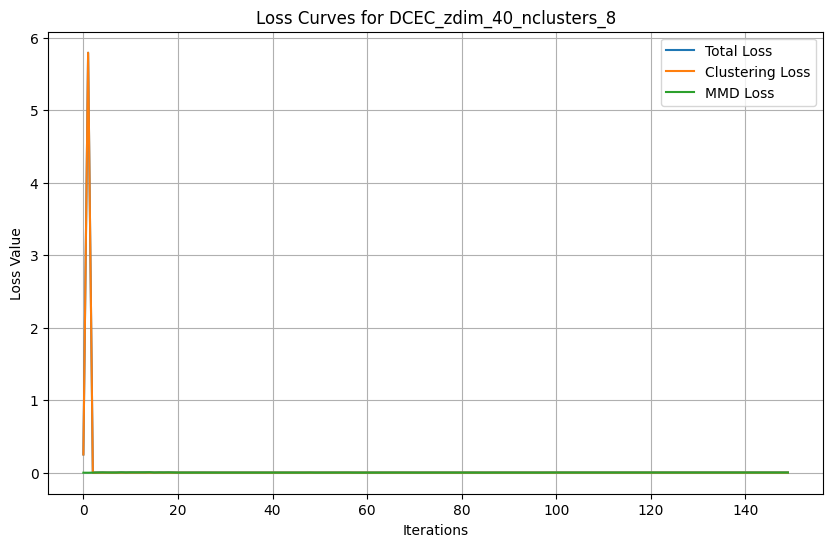

Model saved for z_dim=40 and n_clusters=8
Training DCEC with z_dim=40 and n_clusters=9...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.3322 - loss_mmd: 0.0023 - loss_nll: 0.3299
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0181 - loss_mmd: 0.0013 - loss_nll: 0.0168
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0069 - loss_mmd: 0.0012 - loss_nll: 0.0058
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0050 - loss_mmd: 0.0011 - loss_nll: 0.0038
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0034 - loss_mmd: 0.0011 - loss_nll: 0.0023
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0035 - loss_mmd: 0.0011 - loss_nll: 0.0024
Epoch 9/200
538/538 ━━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00229037, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00229037
Iter 0, Weighted Total Loss: 0.00114518, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00114518
Training completed for z_dim=40 and n_clusters=9.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 2.02570248, Unweighted Clustering Loss: 2.02375579, Unweighted MMD Loss: 0.00194681
Iter 1, Weighted Total Loss: 1.01285124, Weighted Clustering Loss: 1.01187789, Weighted MMD Loss: 0.00097340
Training completed for z_dim=40 and n_clusters=9.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 7.55781746, Unweighted Clustering Loss: 7.55535603, Unweighted MMD Loss: 0.00246167
Iter 2, Weighted Total Loss: 0.00971343, Weighted Clustering Loss: 0.00725412, Weighted MMD Loss: 0.00245931
Training completed for z_dim=40 and n_clusters=9.
Model weights, training history,

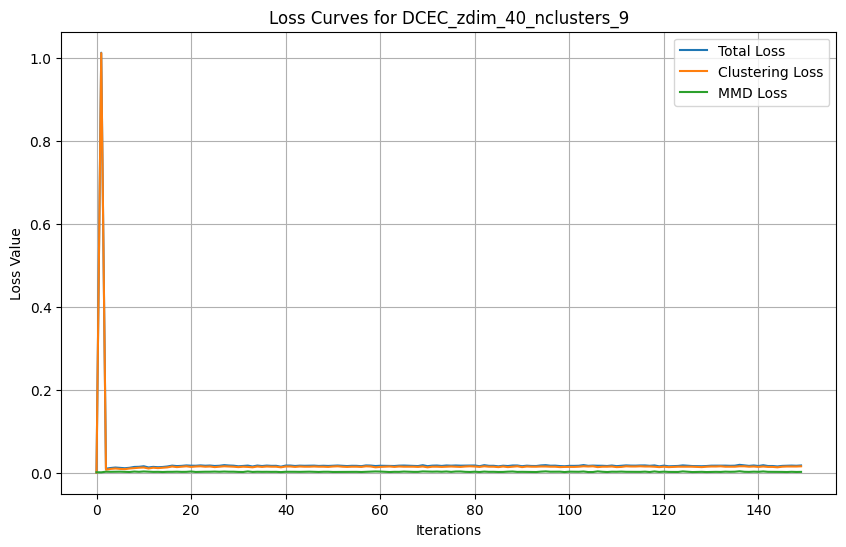

Model saved for z_dim=40 and n_clusters=9
Training DCEC with z_dim=40 and n_clusters=10...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.2978 - loss_mmd: 0.0024 - loss_nll: 0.2954
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0206 - loss_mmd: 0.0013 - loss_nll: 0.0192
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0066 - loss_mmd: 0.0011 - loss_nll: 0.0055
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0043 - loss_mmd: 0.0011 - loss_nll: 0.0032
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0034 - loss_mmd: 0.0011 - loss_nll: 0.0023
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0027 - loss_mmd: 0.0011 - loss_nll: 0.0016
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0023 - loss_mmd: 0.0011 - loss_nll: 0.0012
Epoch 9/200
538/538 ━━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00168276, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00168276
Iter 0, Weighted Total Loss: 0.00084138, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00084138
Training completed for z_dim=40 and n_clusters=10.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 6.04647541, Unweighted Clustering Loss: 6.04428482, Unweighted MMD Loss: 0.00219071
Iter 1, Weighted Total Loss: 3.02323771, Weighted Clustering Loss: 3.02214241, Weighted MMD Loss: 0.00109535
Training completed for z_dim=40 and n_clusters=10.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 8.55625534, Unweighted Clustering Loss: 8.55362511, Unweighted MMD Loss: 0.00263047
Iter 2, Weighted Total Loss: 0.00572748, Weighted Clustering Loss: 0.00309796, Weighted MMD Loss: 0.00262952
Training completed for z_dim=40 and n_clusters=10.
Model weights, training histo

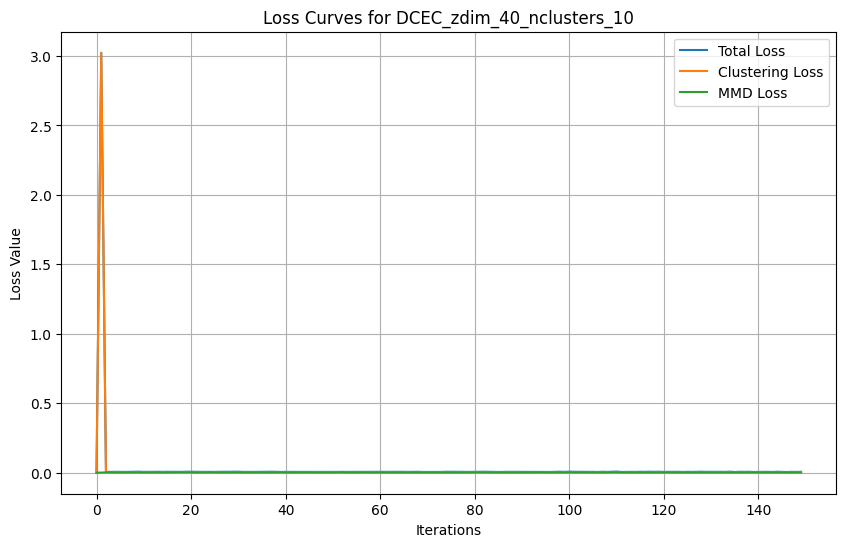

Model saved for z_dim=40 and n_clusters=10
Training DCEC with z_dim=40 and n_clusters=11...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2775 - loss_mmd: 0.0027 - loss_nll: 0.2749
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0221 - loss_mmd: 0.0015 - loss_nll: 0.0207
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0074 - loss_mmd: 0.0012 - loss_nll: 0.0062
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0046 - loss_mmd: 0.0011 - loss_nll: 0.0035
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0037 - loss_mmd: 0.0011 - loss_nll: 0.0026
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0024 - loss_mmd: 0.0011 - loss_nll: 0.0013
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00140023, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00140023
Iter 0, Weighted Total Loss: 0.00070012, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00070012
Training completed for z_dim=40 and n_clusters=11.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 1.51294184, Unweighted Clustering Loss: 1.51107121, Unweighted MMD Loss: 0.00187063
Iter 1, Weighted Total Loss: 0.75647092, Weighted Clustering Loss: 0.75553560, Weighted MMD Loss: 0.00093532
Training completed for z_dim=40 and n_clusters=11.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 3.52807689, Unweighted Clustering Loss: 3.52583313, Unweighted MMD Loss: 0.00224376
Iter 2, Weighted Total Loss: 0.00659502, Weighted Clustering Loss: 0.00435403, Weighted MMD Loss: 0.00224099
Training completed for z_dim=40 and n_clusters=11.
Model weights, training histo

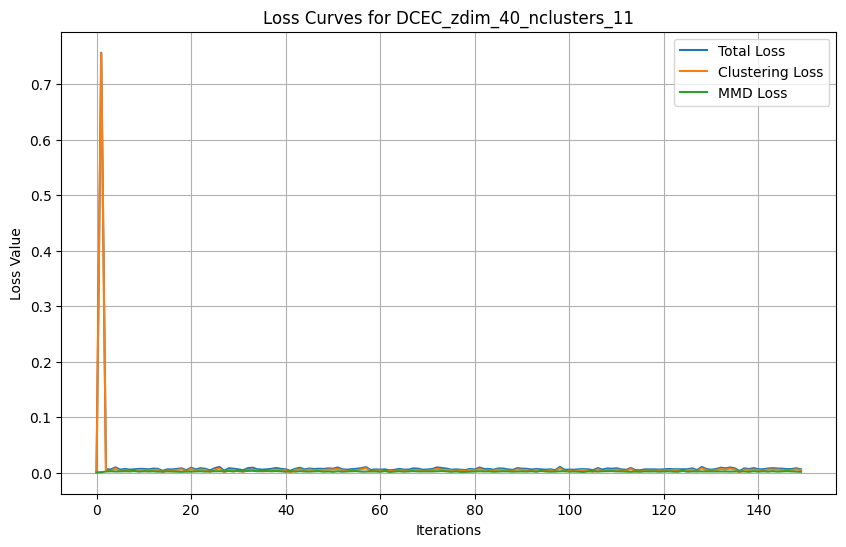

Model saved for z_dim=40 and n_clusters=11
Training DCEC with z_dim=40 and n_clusters=12...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.2719 - loss_mmd: 0.0058 - loss_nll: 0.2661
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0261 - loss_mmd: 0.0021 - loss_nll: 0.0240
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0087 - loss_mmd: 0.0015 - loss_nll: 0.0072
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0049 - loss_mmd: 0.0013 - loss_nll: 0.0037
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0038 - loss_mmd: 0.0012 - loss_nll: 0.0026
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00236809, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00236809
Iter 0, Weighted Total Loss: 0.00118405, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00118405
Training completed for z_dim=40 and n_clusters=12.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 5.51099110, Unweighted Clustering Loss: 5.50874567, Unweighted MMD Loss: 0.00224519
Iter 1, Weighted Total Loss: 2.75549555, Weighted Clustering Loss: 2.75437284, Weighted MMD Loss: 0.00112259
Training completed for z_dim=40 and n_clusters=12.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 9.06832027, Unweighted Clustering Loss: 9.06642723, Unweighted MMD Loss: 0.00189340
Iter 2, Weighted Total Loss: 0.00558480, Weighted Clustering Loss: 0.00369217, Weighted MMD Loss: 0.00189263
Training completed for z_dim=40 and n_clusters=12.
Model weights, training histo

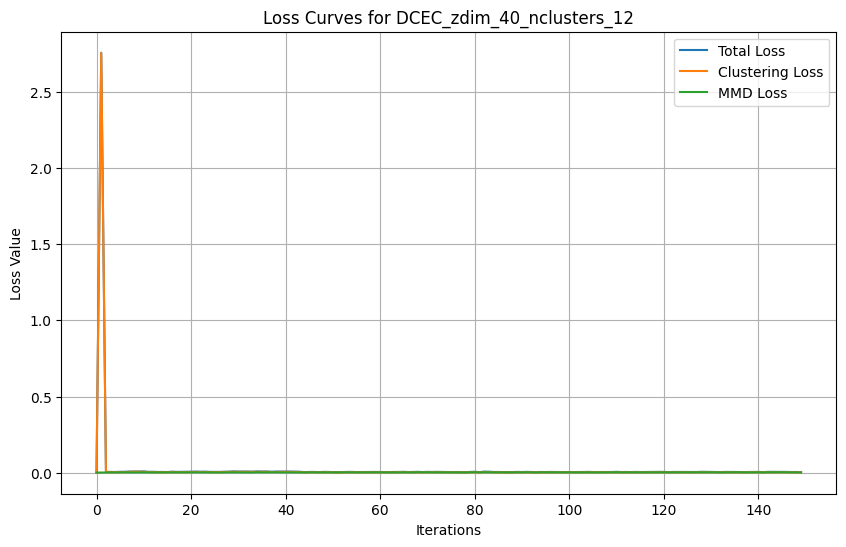

Model saved for z_dim=40 and n_clusters=12
Training DCEC with z_dim=40 and n_clusters=13...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2932 - loss_mmd: 0.0029 - loss_nll: 0.2902
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0184 - loss_mmd: 0.0014 - loss_nll: 0.0170
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0068 - loss_mmd: 0.0012 - loss_nll: 0.0056
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0042 - loss_mmd: 0.0011 - loss_nll: 0.0031
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0034 - loss_mmd: 0.0011 - loss_nll: 0.0023
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0026 - loss_mmd: 0.0011 - loss_nll: 0.0015
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00205911, Unweighted Clustering Loss: 0.00005866, Unweighted MMD Loss: 0.00200045
Iter 0, Weighted Total Loss: 0.00102955, Weighted Clustering Loss: 0.00002933, Weighted MMD Loss: 0.00100023
Training completed for z_dim=40 and n_clusters=13.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 14.60840607, Unweighted Clustering Loss: 14.60683441, Unweighted MMD Loss: 0.00157213
Iter 1, Weighted Total Loss: 7.30420303, Weighted Clustering Loss: 7.30341721, Weighted MMD Loss: 0.00078607
Training completed for z_dim=40 and n_clusters=13.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 15.09703922, Unweighted Clustering Loss: 15.09489441, Unweighted MMD Loss: 0.00214493
Iter 2, Weighted Total Loss: 0.00376901, Weighted Clustering Loss: 0.00162431, Weighted MMD Loss: 0.00214470
Training completed for z_dim=40 and n_clusters=13.
Model weights, training h

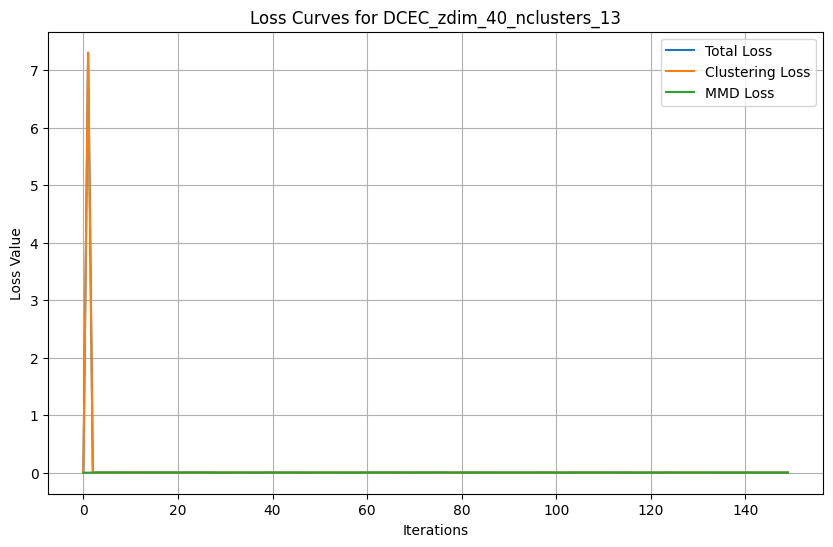

Model saved for z_dim=40 and n_clusters=13
Training DCEC with z_dim=40 and n_clusters=14...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.3007 - loss_mmd: 0.0044 - loss_nll: 0.2963
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0219 - loss_mmd: 0.0019 - loss_nll: 0.0200
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0079 - loss_mmd: 0.0013 - loss_nll: 0.0065
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0055 - loss_mmd: 0.0012 - loss_nll: 0.0043
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0039 - loss_mmd: 0.0012 - loss_nll: 0.0027
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0035 - loss_mmd: 0.0011 - loss_nll: 0.0024
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.38673136, Unweighted Clustering Loss: 0.38462076, Unweighted MMD Loss: 0.00211060
Iter 0, Weighted Total Loss: 0.19336568, Weighted Clustering Loss: 0.19231038, Weighted MMD Loss: 0.00105530
Training completed for z_dim=40 and n_clusters=14.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 15.62248802, Unweighted Clustering Loss: 15.61440277, Unweighted MMD Loss: 0.00808537
Iter 1, Weighted Total Loss: 7.81124401, Weighted Clustering Loss: 7.80720139, Weighted MMD Loss: 0.00404269
Training completed for z_dim=40 and n_clusters=14.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 15.13720894, Unweighted Clustering Loss: 15.11071205, Unweighted MMD Loss: 0.02649653
Iter 2, Weighted Total Loss: 0.03429928, Weighted Clustering Loss: 0.00781646, Weighted MMD Loss: 0.02648282
Training completed for z_dim=40 and n_clusters=14.
Model weights, training h

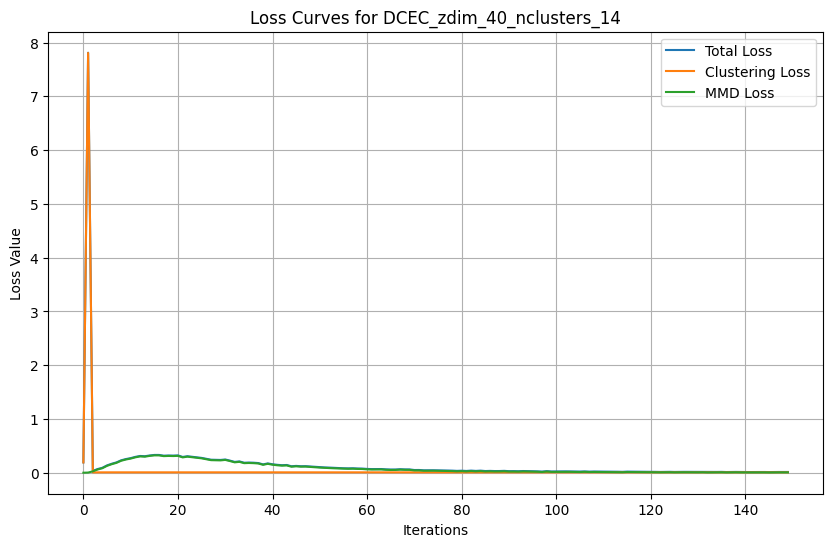

Model saved for z_dim=40 and n_clusters=14
Training DCEC with z_dim=40 and n_clusters=15...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.3200 - loss_mmd: 0.0028 - loss_nll: 0.3172
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0221 - loss_mmd: 0.0015 - loss_nll: 0.0206
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0074 - loss_mmd: 0.0012 - loss_nll: 0.0061
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0046 - loss_mmd: 0.0012 - loss_nll: 0.0034
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0036 - loss_mmd: 0.0011 - loss_nll: 0.0025
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0032 - loss_mmd: 0.0011 - loss_nll: 0.0021
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0027 - loss_mmd: 0.0011 - loss_nll: 0.0016
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00253273, Unweighted Clustering Loss: 0.00007177, Unweighted MMD Loss: 0.00246096
Iter 0, Weighted Total Loss: 0.00126636, Weighted Clustering Loss: 0.00003588, Weighted MMD Loss: 0.00123048
Training completed for z_dim=40 and n_clusters=15.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 9.57172585, Unweighted Clustering Loss: 9.57011795, Unweighted MMD Loss: 0.00160801
Iter 1, Weighted Total Loss: 4.78586292, Weighted Clustering Loss: 4.78505898, Weighted MMD Loss: 0.00080401
Training completed for z_dim=40 and n_clusters=15.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 12.59471607, Unweighted Clustering Loss: 12.59226036, Unweighted MMD Loss: 0.00245547
Iter 2, Weighted Total Loss: 0.00457016, Weighted Clustering Loss: 0.00211510, Weighted MMD Loss: 0.00245506
Training completed for z_dim=40 and n_clusters=15.
Model weights, training his

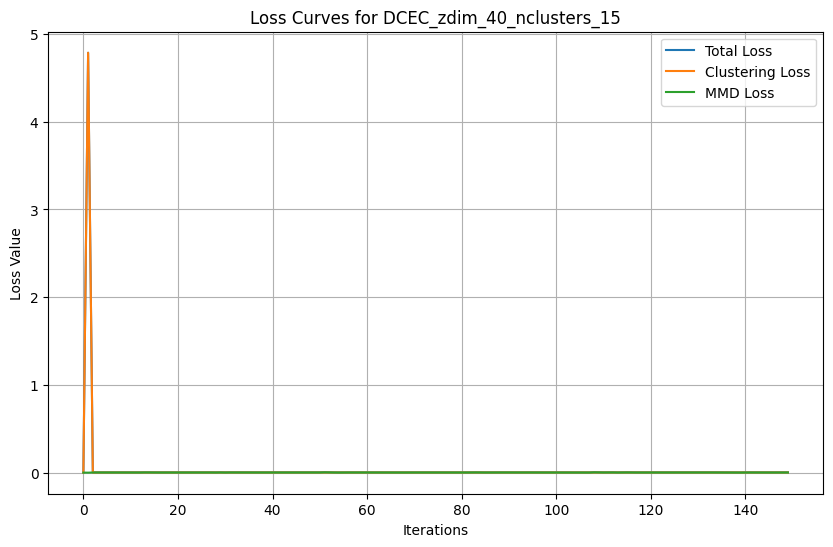

Model saved for z_dim=40 and n_clusters=15
Training DCEC with z_dim=40 and n_clusters=16...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2921 - loss_mmd: 0.0027 - loss_nll: 0.2894
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0179 - loss_mmd: 0.0014 - loss_nll: 0.0166
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0069 - loss_mmd: 0.0012 - loss_nll: 0.0057
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0047 - loss_mmd: 0.0011 - loss_nll: 0.0035
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0038 - loss_mmd: 0.0011 - loss_nll: 0.0027
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0033 - loss_mmd: 0.0011 - loss_nll: 0.0022
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0027 - loss_mmd: 0.0011 - loss_nll: 0.0016
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00246477, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00246477
Iter 0, Weighted Total Loss: 0.00123239, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00123239
Training completed for z_dim=40 and n_clusters=16.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 8.06217670, Unweighted Clustering Loss: 8.05904675, Unweighted MMD Loss: 0.00313032
Iter 1, Weighted Total Loss: 4.03108835, Weighted Clustering Loss: 4.02952337, Weighted MMD Loss: 0.00156516
Training completed for z_dim=40 and n_clusters=16.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 10.07604408, Unweighted Clustering Loss: 10.07380867, Unweighted MMD Loss: 0.00223553
Iter 2, Weighted Total Loss: 0.00614452, Weighted Clustering Loss: 0.00390986, Weighted MMD Loss: 0.00223466
Training completed for z_dim=40 and n_clusters=16.
Model weights, training his

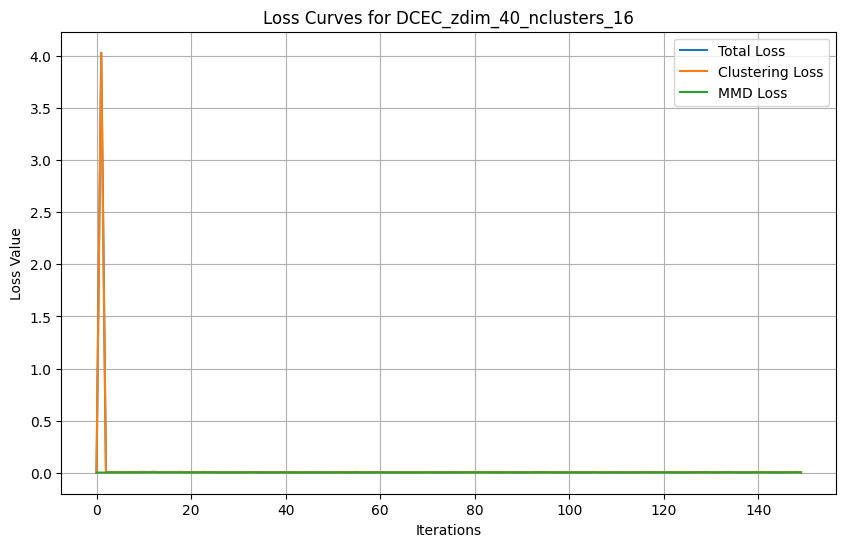

Model saved for z_dim=40 and n_clusters=16
Training DCEC with z_dim=40 and n_clusters=17...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 12s 8ms/step - loss: 0.3432 - loss_mmd: 0.0033 - loss_nll: 0.3399
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0216 - loss_mmd: 0.0013 - loss_nll: 0.0203
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0080 - loss_mmd: 0.0012 - loss_nll: 0.0068
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0055 - loss_mmd: 0.0011 - loss_nll: 0.0044
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0042 - loss_mmd: 0.0011 - loss_nll: 0.0031
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0031 - loss_mmd: 0.0011 - loss_nll: 0.0020
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.32411692, Unweighted Clustering Loss: 0.32194611, Unweighted MMD Loss: 0.00217080
Iter 0, Weighted Total Loss: 0.16205846, Weighted Clustering Loss: 0.16097306, Weighted MMD Loss: 0.00108540
Training completed for z_dim=40 and n_clusters=17.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 12.07605076, Unweighted Clustering Loss: 12.07311440, Unweighted MMD Loss: 0.00293636
Iter 1, Weighted Total Loss: 6.03802538, Weighted Clustering Loss: 6.03655720, Weighted MMD Loss: 0.00146818
Training completed for z_dim=40 and n_clusters=17.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 9.07051563, Unweighted Clustering Loss: 9.06642723, Unweighted MMD Loss: 0.00408852
Iter 2, Weighted Total Loss: 0.00629155, Weighted Clustering Loss: 0.00220402, Weighted MMD Loss: 0.00408753
Training completed for z_dim=40 and n_clusters=17.
Model weights, training his

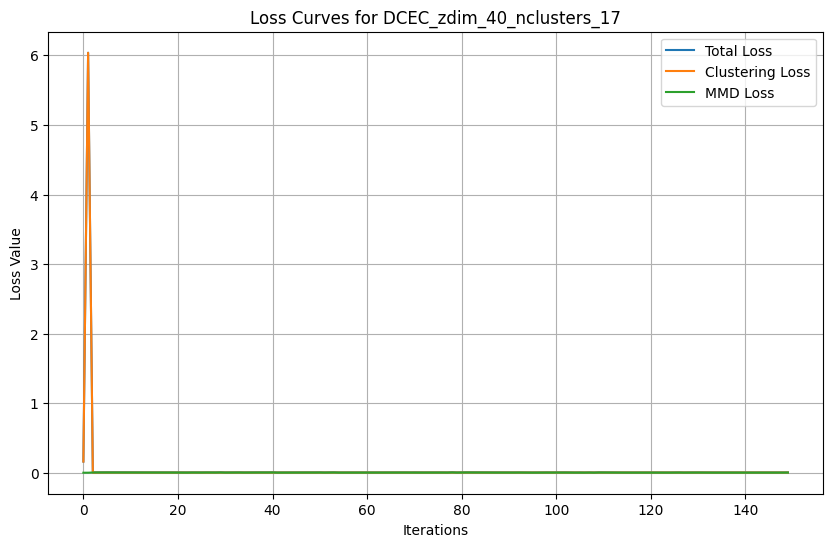

Model saved for z_dim=40 and n_clusters=17
Training DCEC with z_dim=40 and n_clusters=18...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.3196 - loss_mmd: 0.0025 - loss_nll: 0.3171
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0213 - loss_mmd: 0.0015 - loss_nll: 0.0198
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0068 - loss_mmd: 0.0012 - loss_nll: 0.0056
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0043 - loss_mmd: 0.0011 - loss_nll: 0.0032
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0035 - loss_mmd: 0.0011 - loss_nll: 0.0024
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0028 - loss_mmd: 0.0011 - loss_nll: 0.0017
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00216079, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00216079
Iter 0, Weighted Total Loss: 0.00108039, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00108039
Training completed for z_dim=40 and n_clusters=18.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 1.00966430, Unweighted Clustering Loss: 1.00738084, Unweighted MMD Loss: 0.00228345
Iter 1, Weighted Total Loss: 0.50483215, Weighted Clustering Loss: 0.50369042, Weighted MMD Loss: 0.00114173
Training completed for z_dim=40 and n_clusters=18.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 3.02380323, Unweighted Clustering Loss: 3.02214241, Unweighted MMD Loss: 0.00166082
Iter 2, Weighted Total Loss: 0.00847652, Weighted Clustering Loss: 0.00681945, Weighted MMD Loss: 0.00165708
Training completed for z_dim=40 and n_clusters=18.
Model weights, training histo

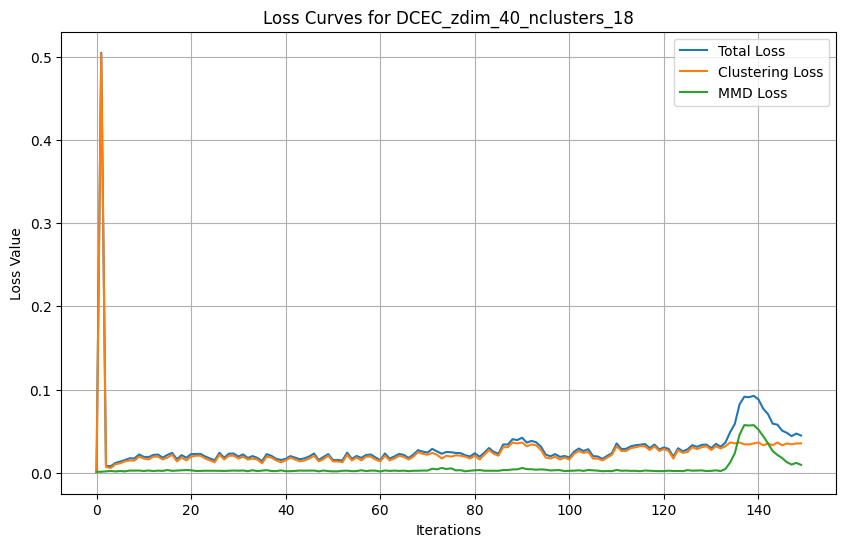

Model saved for z_dim=40 and n_clusters=18
Training DCEC with z_dim=40 and n_clusters=19...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 11s 8ms/step - loss: 0.2984 - loss_mmd: 0.0054 - loss_nll: 0.2930
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0209 - loss_mmd: 0.0020 - loss_nll: 0.0189
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0071 - loss_mmd: 0.0014 - loss_nll: 0.0057
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0046 - loss_mmd: 0.0012 - loss_nll: 0.0034
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0034 - loss_mmd: 0.0011 - loss_nll: 0.0023
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00237989, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00237989
Iter 0, Weighted Total Loss: 0.00118995, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00118995
Training completed for z_dim=40 and n_clusters=19.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 4.53560352, Unweighted Clustering Loss: 4.53321362, Unweighted MMD Loss: 0.00238979
Iter 1, Weighted Total Loss: 2.26780176, Weighted Clustering Loss: 2.26660681, Weighted MMD Loss: 0.00119489
Training completed for z_dim=40 and n_clusters=19.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 2.52026224, Unweighted Clustering Loss: 2.51845217, Unweighted MMD Loss: 0.00181007
Iter 2, Weighted Total Loss: 0.00313538, Weighted Clustering Loss: 0.00132626, Weighted MMD Loss: 0.00180912
Training completed for z_dim=40 and n_clusters=19.
Model weights, training histo

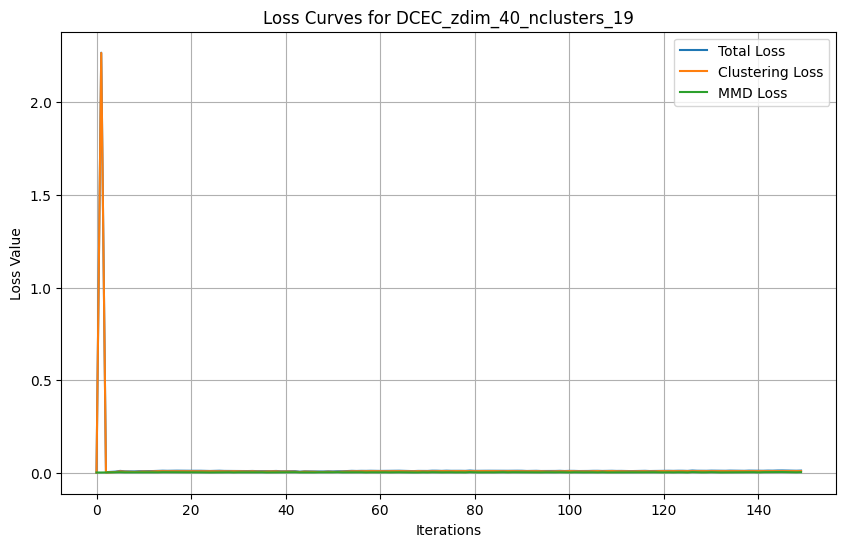

Model saved for z_dim=40 and n_clusters=19
Training DCEC with z_dim=40 and n_clusters=20...
...Pretraining autoencoder...
Epoch 1/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 10s 8ms/step - loss: 0.2996 - loss_mmd: 0.0031 - loss_nll: 0.2965
Epoch 2/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0176 - loss_mmd: 0.0015 - loss_nll: 0.0161
Epoch 3/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0069 - loss_mmd: 0.0012 - loss_nll: 0.0057
Epoch 4/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 0.0046 - loss_mmd: 0.0012 - loss_nll: 0.0035
Epoch 5/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0039 - loss_mmd: 0.0011 - loss_nll: 0.0027
Epoch 6/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0029 - loss_mmd: 0.0011 - loss_nll: 0.0018
Epoch 7/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0030 - loss_mmd: 0.0011 - loss_nll: 0.0019
Epoch 8/200
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.0025 - loss_mmd: 0.0011 - loss_nll: 0.0014
Epoch 9/200
538/538 ━━━━━━━━━

/usr/local/lib/python3.10/dist-packages/keras/src/optimizers/base_optimizer.py:678: UserWarning: Gradients do not exist for variables ['kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias', 'kernel', 'bias'] when minimizing the loss. If using `model.compile()`, did you forget to provide a `loss` argument?
  warnings.warn(


Iter 0, Unweighted Total Loss: 0.00236964, Unweighted Clustering Loss: 0.00000000, Unweighted MMD Loss: 0.00236964
Iter 0, Weighted Total Loss: 0.00118482, Weighted Clustering Loss: 0.00000000, Weighted MMD Loss: 0.00118482
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 1, Unweighted Total Loss: 6.34597635, Unweighted Clustering Loss: 6.34416866, Unweighted MMD Loss: 0.00180781
Iter 1, Weighted Total Loss: 3.17298818, Weighted Clustering Loss: 3.17208433, Weighted MMD Loss: 0.00090390
Training completed for z_dim=40 and n_clusters=20.
Model weights, training history, and cluster centroids saved to save_dir
Iter 2, Unweighted Total Loss: 9.06865978, Unweighted Clustering Loss: 9.06642723, Unweighted MMD Loss: 0.00223219
Iter 2, Weighted Total Loss: 0.00481362, Weighted Clustering Loss: 0.00258206, Weighted MMD Loss: 0.00223156
Training completed for z_dim=40 and n_clusters=20.
Model weights, training histo

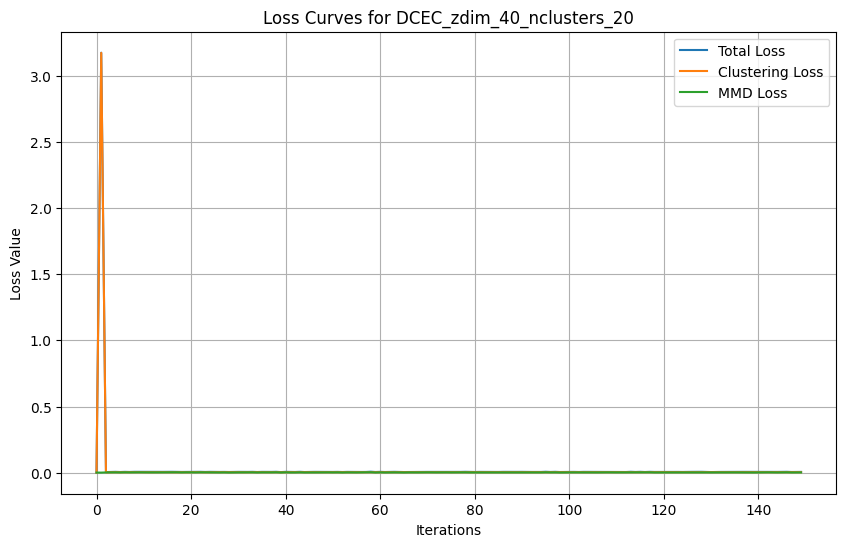

Model saved for z_dim=40 and n_clusters=20


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec, Input, Conv2D, LeakyReLU, Flatten, Dense, Lambda, Reshape, Conv2DTranspose
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import backend as K
import tensorflow.compat.v1 as tfd
import tensorflow_probability as tfp
from sklearn.cluster import KMeans
import os

save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
#model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

# Define GaussianClusteringLayer
class GaussianClusteringLayer(Layer):
    def __init__(self, n_clusters, input_dim, weights=None, **kwargs):
        super(GaussianClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.input_dim = z_dim
        self.initial_weights = weights
        self.distribution = tfp.distributions.MultivariateNormalDiag

    def build(self, input_shape):
        # Mean vectors for each cluster
        self.means = self.add_weight(
            name='means',
            shape=(self.n_clusters, input_shape[1]),
            initializer='glorot_uniform'
        )
        # Diagonal covariance matrices for each cluster
        self.covariances = self.add_weight(
            name='covariances',
            shape=(self.n_clusters, input_shape[1]),
            initializer='ones'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(GaussianClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        # Compute responsibilities (posterior probabilities) for each cluster
        batch_size = tf.shape(inputs)[0]
        responsibilities = []

        for i in range(self.n_clusters):
            # Define the Gaussian distribution for the current cluster
            gaussian = self.distribution(
                loc=self.means[i],
                scale_diag=self.covariances[i]
            )
            # Compute the log probability of the inputs under this Gaussian
            log_prob = gaussian.log_prob(inputs)
            responsibilities.append(log_prob)

        # Stack and normalize to form a soft assignment
        responsibilities = tf.stack(responsibilities, axis=1)
        q = tf.nn.softmax(responsibilities, axis=1)
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)

            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)
            loss_nll = tf.reduce_mean(tf.square(xr - x))

            # Dynamic weight adjustment
            # Scaling factor for NLL
            scale_factor = 400.0

            # Initial weight bias toward NLL
            initial_ratio = 0.10
            w1 = 0.5
            w2 = 1 - w1

            mmd_loss = w1*loss_mmd
            nll_loss =  w2 * (scale_factor * loss_nll)
            total_loss = mmd_loss + nll_loss
            # Dynamically scale NLL
            #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)

        # Compute gradients
        gradients = tape.gradient(total_loss, self.trainable_variables)
        # Apply gradients
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Log dynamic weights for debugging
        #tf.print("Epoch", self.current_epoch + 1, ": w1=", w1, ", w2=", w2, ", loss=", total_loss)
        # Return a dictionary mapping metric names to current value
        return {'loss': total_loss, 'loss_mmd': mmd_loss, 'loss_nll': nll_loss}

    def on_epoch_end(self, epoch, logs=None):
        # Update current epoch at the end of each epoch
        self.current_epoch += 1

    def test_step(self, data):
        x = data  # Validation data

        # Forward pass
        mu, sigma, latent_space = self.encoder(x)
        train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
        xr = self.decoder(latent_space)

        # Compute losses
        loss_mmd = compute_mmd(latent_space, train_z)
        loss_nll = tf.reduce_mean(tf.square(xr - x))

        # Scaling factor for NLL
        scale_factor = 400.0

        # Initial weight bias toward NLL
        #initial_ratio = 0.80
        #w1 = (self.current_epoch / self.total_epochs) * (1 - initial_ratio)
        w1 = 0.5
        w2 = 1 - w1

        mmd_loss = w1*loss_mmd
        nll_loss =  w2 * (scale_factor * loss_nll)
        total_loss = mmd_loss + nll_loss
        # Dynamically scale NLL
        #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)
        return {'loss': total_loss, 'loss_mmd': mmd_loss, 'loss_nll': nll_loss}

# Define DCEC class
class DCEC:
    def __init__(self, input_shape, z_dim=40, n_clusters=20, alpha=1.0, lambda_ = 0.5, optimizer_name='adam', learning_rate=0.001):
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.lambda_ = lambda_
        self.z_dim = z_dim

        # Build the encoder
        encoder_input = Input(shape=input_shape)
        en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(encoder_input)
        en_conv1 = BatchNormalization()(en_conv1)
        en_conv1 = LeakyReLU(0.1)(en_conv1)

        en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv1)
        en_conv2 = BatchNormalization()(en_conv2)
        en_conv2 = LeakyReLU(0.1)(en_conv2)

        en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same', kernel_regularizer=l2(0.01))(en_conv2)
        en_conv3 = BatchNormalization()(en_conv3)
        en_conv3 = LeakyReLU(0.1)(en_conv3)

        en_conv4 = Conv2D(filters=256, kernel_size=4, strides=2, padding='same',kernel_regularizer=l2(0.01))(en_conv3)
        en_conv4 = BatchNormalization()(en_conv4)
        en_conv4 = LeakyReLU(0.1)(en_conv4)

        en_fc1 = Flatten()(en_conv3)
        mu = Dense(z_dim)(en_fc1)
        sigma = Dense(z_dim)(en_fc1)

        def compute_latent(x):
            mu, sigma = x
            batch = tf.shape(mu)[0]
            eps = tf.random.normal(shape=(batch, self.z_dim), mean=0., stddev=1.)
            return mu + tf.exp(sigma) * eps

        latent_space = Lambda(compute_latent, name='latent_space')([mu, sigma])

        self.encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

        # Build the decoder
        decoder_input = Input(shape=(z_dim,))
        de_fc2 = Dense(
            en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu'
        )(decoder_input)
        de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
        de_conv1 = Conv2DTranspose(
            filters=128, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_fc2)
        de_conv2 = Conv2DTranspose(
            filters=64, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv1)
        de_conv3 = Conv2DTranspose(
            filters=32, kernel_size=4, strides=2, activation='relu', padding='same'
        )(de_conv2)
        decoder_output = Conv2DTranspose(
            filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same'
        )(de_conv2)

        self.decoder = Model(decoder_input, decoder_output, name='decoder')

        # Build the model
        self.optimizer = tf.keras.optimizers.Adam()
        self.clustering_layer = GaussianClusteringLayer(n_clusters=self.n_clusters, input_dim=z_dim,name='gaussian_clustering')
        self.current_epoch = 0

    def pretrain(self, x, batch_size=32, epochs=200, optimizer='adam', save_dir='save_dir'):
        print('...Pretraining autoencoder...')
        # Build autoencoder model for pretraining
        autoencoder = CustomLossLayer(self.encoder, self.decoder, total_epochs = epochs)
        autoencoder.compile(optimizer=optimizer)

        # Early stopping callback
        early_stopping = EarlyStopping(monitor='loss', patience=10, restore_best_weights=True)

        # Pretrain
        history = autoencoder.fit(x, epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=1)

        # Save weights and history
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        autoencoder.save_weights(f'{save_dir}/pretrained_autoencoder_weights.weights.h5')
        np.save(f'{save_dir}/pretrain_history.npy', dict(history.history))
        print(f'Pretrained weights are saved to {save_dir}/pretrained_autoencoder_weights.weights.h5')

        # Load weights into the encoder and decoder
        self.encoder.set_weights(autoencoder.encoder.get_weights())
        self.decoder.set_weights(autoencoder.decoder.get_weights())

    def target_distribution(self, q):
        # Compute the weight numerator: q ** 2
        weight_numerator = tf.square(q)
        # Compute the weight denominator: sum over samples for each cluster
        weight_denominator = tf.reduce_sum(q, axis=0, keepdims=True)
        # Compute weight: weight_numerator / weight_denominator
        weight = weight_numerator / weight_denominator
        # Compute the normalized weight: divide by sum over clusters for each sample
        weight_sum = tf.reduce_sum(weight, axis=1, keepdims=True)
        p = weight / weight_sum
        return p

    def fit(self, x, y=None, batch_size=32, maxiter=150, tol=1e-2, update_interval = 150, save_dir='save_dir', patience=5):
        print('...Initializing cluster centers with k-means...')
        # Get latent representations
        _, _, latent_space = self.encoder.predict(x)
        # Build the clustering layer by calling it once
        _ = self.clustering_layer(latent_space)
        # Run KMeans
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(latent_space)
        # Set cluster centers
        cluster_means = kmeans.cluster_centers_ # Storing the initial cluster weights for safety
        # Computing initial covariance
        cluster_covariances = np.array([
            np.var(latent_space[y_pred == i], axis=0) + 1e-6 # small value being used for stability])
            for i in range(self.n_clusters)
        ])

        self.clustering_layer.set_weights([cluster_means, cluster_covariances])

         # Save the means and covariances for later use
        centroids_path = os.path.join(save_dir, f'DCEC_zdim_{self.z_dim}_nclusters_{self.n_clusters}_cluster_centroids.npz')
        np.savez(centroids_path, means=cluster_means, covariances=cluster_covariances)
        print(f"Cluster centroids (means and covariances) saved to {centroids_path}")

        # Initialize variables
        index_array = np.arange(x.shape[0])
        index = 0

        # Initialize losses for plotting
        total_losses_list = []
        clustering_loss_list = []
        mmd_loss_list = []

        #loss value lists with weights applied
        w_total_loss_list = []
        w_clustering_loss_list = []
        w_mmd_loss_list = []

        # Ensure x is a float32 tensor
        if not isinstance(x, tf.Tensor):
            x = tf.convert_to_tensor(x, dtype=tf.float32)
        p = None  # Initialize p

        class CoVWeighting:
          def __init__(self, num_losses, mean_decay_param=0.9):
            self.num_losses = num_losses
            self.mean_decay_param = mean_decay_param
            self.current_iter = 0

            #initialize the stats
            self.alphas = tf.ones((num_losses,)) / num_losses
            self.running_mean_L = tf.zeros((num_losses,))
            self.running_mean_l = tf.zeros((num_losses,))
            self.running_S_l = tf.zeros((num_losses,))
            self.running_std_l = tf.zeros((num_losses,))

          def update_stats(self, L, l):
            #updating the sats forL and l using welfords algorithm
            #mean_param = (1, - 1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0
            #updated due to incorrect assignment of a tuple to mean_param
            mean_param = 1 - (1. / (self.current_iter + 1)) if self.current_iter > 0 else 0.0  # Calculate a single value

            # Update stats for l
            x_l = l
            new_mean_l = mean_param * self.running_mean_l + (1 - mean_param) * x_l
            self.running_S_l += (x_l - self.running_mean_l) * (x_l - new_mean_l)
            self.running_mean_l = new_mean_l
            running_variance_l = self.running_S_l / (self.current_iter + 1)
            self.running_std_l = tf.sqrt(running_variance_l + 1e-8)

            #update stats for L
            x_L = L
            self.running_mean_L = mean_param * self.running_mean_L + (1 - mean_param) * x_L

          def compute_weights(self):
            #computing weights based off of Coefficient of Variation
            ls = self.running_std_l / tf.maximum(self.running_mean_l, 1e-8)
            # Apply penalty to clustering loss weight
            penalty_factor = self.running_mean_l[1] / (self.running_mean_l[0] + 1e-8)  # index 1 is clustering loss
            ls = tf.tensor_scatter_nd_update(ls, [[1]], [ls[1] / (1 + penalty_factor)])  # Penalize clustering loss weight

            self.alphas = ls / tf.reduce_sum(ls)
            return self.alphas

          def compute_loss(self, unweighted_loss):
            L = tf.convert_to_tensor(unweighted_loss)
            l = L / tf.maximum(self.running_mean_l, 1e-8)

            #update running stats
            if self.current_iter == 0:
              self.running_mean_L = L
            else:
              self.update_stats(L, l)

            #computing weights
            if self.current_iter > 1:
              self.compute_weights()

            #Weighted Loss
            weighted_loss = [self.alphas[i] * unweighted_loss[i] for i in range(self.num_losses)]
            losses = tf.reduce_sum(weighted_loss)
            self.current_iter += 1
            return losses

          def get_weights(self):
              """Return the current weights for each loss."""
              return self.alphas.numpy()

        cov_weighting = CoVWeighting(num_losses=2)  # 2 because of the MMD and clustering losses


        # Training loop
        for ite in range(int(maxiter)):
            '''
            if ite % 50 == 0:  # Adjust every 50 iterations # manual adjustment of learning rate
                #new_lr = self.optimizer.learning_rate.numpy() * 0.9  # Reduce by 10%
                new_lr = self.optimizer.learning_rate.numpy() * 0.75  # Reduce by 20%
                self.optimizer.learning_rate.assign(new_lr)
                print(f"Iteration {ite}, Updated Learning Rate: {new_lr:.6f}")
            '''
            if ite % update_interval == 0:
                # Update target distribution p
                _, _, latent_space = self.encoder.predict(x)
                q = self.clustering_layer(latent_space)
                p = self.target_distribution(q)
                '''
                # Evaluate clustering performance if y is provided
                if y is not None:
                    y_pred = q.argmax(1)
                    acc = np.round(cluster_acc(y, y_pred), 5)
                    nmi = np.round(metrics.normalized_mutual_info_score(y, y_pred), 5)
                    ari = np.round(metrics.adjusted_rand_score(y, y_pred), 5)
                    print(f'Iter {ite}: Acc={acc}, nmi={nmi}, ari={ari}')
                '''

            # Dynamic lambda adjustment
            lambda_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
            self.lambda_ = lambda_values[ite % len(lambda_values)]  # Cycle through value

            # Sample a batch of data
            if (index + 1) * batch_size > x.shape[0]:
                idx = index_array[index * batch_size :]
                index = 0
            else:
                idx = index_array[index * batch_size : (index + 1) * batch_size]
                index += 1

            # Convert idx to a TensorFlow tensor
            idx_tensor = tf.convert_to_tensor(idx, dtype=tf.int32)

            # Use tf.gather to index x and p
            x_batch = tf.gather(x, idx_tensor)
            p_batch = tf.gather(p, idx_tensor)

            # Cast x_batch to float32 to ensure data type consistency
            x_batch = tf.cast(x_batch, dtype=tf.float32)

            with tf.GradientTape() as tape:
                # Forward pass
                mu, sigma, latent = self.encoder(x_batch)
                xr = self.decoder(latent)
                q_batch = self.clustering_layer(latent)
                # Sample from prior
                train_z = tf.random.normal(shape=(tf.shape(x_batch)[0], self.z_dim), mean=0.0, stddev=1.0)

                # Compute losses
                loss_mmd = compute_mmd(latent, train_z)
                loss_clustering = (tf.reduce_mean(tf.keras.losses.KLD(p_batch, q_batch)))
                total_losses = loss_mmd + loss_clustering

                 # Combine losses using CoVWeightingLoss
                unweighted_losses = [loss_mmd, loss_clustering]
                total_loss = cov_weighting.compute_loss(unweighted_losses)

                # Compute gradients
                variables = self.encoder.trainable_variables + self.decoder.trainable_variables + self.clustering_layer.trainable_variables
                gradients = tape.gradient(total_loss, variables)
                #clipped_gradients = [tf.clip_by_value(g, -1.0, 1.0) for g in gradients]  # Clip gradients
                self.optimizer.apply_gradients(zip(gradients, variables))

                # Track unweighted losses
                total_losses_list.append(total_losses.numpy())
                clustering_loss_list.append(loss_clustering.numpy())
                mmd_loss_list.append(loss_mmd.numpy())

                # Log losses
                print(f"Iter {ite}, Unweighted Total Loss: {total_losses.numpy():.8f}, "
                      f"Unweighted Clustering Loss: {loss_clustering.numpy():.8f}, Unweighted MMD Loss: {loss_mmd.numpy():.8f}")

                #track weighted losses
                weights = cov_weighting.get_weights()
                weight_clustering, weight_mmd = weights[1], weights[0]
                weighted_clustering_loss = weight_clustering * loss_clustering
                weighted_mmd_loss = weight_mmd * loss_mmd
                print(f"Iter {ite}, Weighted Total Loss: {total_loss:.8f}, Weighted Clustering Loss: {weighted_clustering_loss:.8f}, "
                      f"Weighted MMD Loss: {weighted_mmd_loss:.8f}")

                # Track unweighted losses
                w_total_loss_list.append(total_loss.numpy())
                w_clustering_loss_list.append(weighted_clustering_loss.numpy())
                w_mmd_loss_list.append(weighted_mmd_loss)

            # Plot losses at the end of training
            model_name = f"DCEC_zdim_{z_dim}_nclusters_{k}"
            print(f"Training completed for z_dim={self.z_dim} and n_clusters={self.n_clusters}.")

            # Save model weights and cluster centroids
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.encoder.save_weights(f'{save_dir}/{model_name}_encoder_weights.weights.h5')
            self.decoder.save_weights(f'{save_dir}/{model_name}_decoder_weights.weights.h5')
            #np.save(f'{save_dir}/{model_name}_training_history.npy', self.losses)
            cluster_centroids = self.clustering_layer.get_weights()[0]
            #np.save(f'{save_dir}/{model_name}_cluster_centroids.npy', cluster_centroids)

            print(f"Model weights, training history, and cluster centroids saved to {save_dir}")

        self.plot_losses(w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, save_dir, model_name)

        return cluster_means, cluster_covariances

    def plot_losses(self, w_total_loss_list, w_clustering_loss_list, w_mmd_loss_list, save_dir, model_name):
        """
        Plot and save loss curves after training.
        """
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        plt.figure(figsize=(10, 6))
        plt.plot(w_total_loss_list, label='Total Loss')
        plt.plot(w_clustering_loss_list, label='Clustering Loss')
        plt.plot(w_mmd_loss_list, label='MMD Loss')
        plt.xlabel('Iterations')
        plt.ylabel('Loss Value')
        plt.title(f'Loss Curves for {model_name}')
        plt.legend()
        plt.grid(True)

        plot_path = os.path.join(save_dir, f'{model_name}_loss_curves.png')
        plt.savefig(plot_path)
        print(f"Loss plot saved to {plot_path}")
        plt.show()


input_shape = (raw.shape[1], raw.shape[2], 1)
dimensions = [40]
K_values = range(2, 21)


for z_dim in dimensions:
    for k in K_values:
        print(f'Training DCEC with z_dim={z_dim} and n_clusters={k}...')

        # Initialize DCEC model with the current 'k'
        dcec = DCEC(input_shape=input_shape, z_dim=z_dim, n_clusters=k, alpha=1.0)

        # Pretrain the autoencoder
        dcec.pretrain(data_train, batch_size=32, epochs=200, save_dir='save_dir')

        # Fit the DCEC model
        cluster_means, cluster_covariances = dcec.fit(data_train, maxiter=150, batch_size=32, update_interval=150, save_dir='save_dir', patience=10)

        # Save the model, weights, and training history
        save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}_G'
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Save encoder and decoder models
        dcec.encoder.save(f'{save_dir}/{model_name}_encoder.h5')
        dcec.decoder.save(f'{save_dir}/{model_name}_decoder.h5')

        # Save clustering layer weights
        np.save(f'{save_dir}/{model_name}_clustering_weights.npy', dcec.clustering_layer.get_weights())

        # Save training history
        #np.save(f'{save_dir}/{model_name}_dcec_training_history.npy', self.losses)

        # Save cluster centroids
        cluster_centroids = dcec.clustering_layer.get_weights()[0]
        np.savez(f'{save_dir}/{model_name}_cluster_centroids.npz', means=cluster_means, covariances=cluster_covariances)

        print(f'Model saved for z_dim={z_dim} and n_clusters={k}')


In [ ]:
import pandas as pd

history_df = pd.DataFrame(history.history)
history_df.to_csv(f'/content/drive/MyDrive/Masters Dataset/New Results/dcec_dim{z_dim}_history.csv', index=False)


In [ ]:
# Load and verify
loaded_losses = np.load(f'{save_dir}/{model_name}dcec_training_history.npy', allow_pickle=True).item()
print(loaded_losses)


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_2dcec_training_history.npy'

### loss graphs

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

def plot_saved_losses(save_dir, z_dim, K_values):
    """
    Load and plot saved training losses for different cluster values (K).

    Args:
        save_dir (str): Directory where training histories are saved.
        z_dim (int): The dimensionality of the latent space (z_dim).
        K_values (range): The range of cluster values (K) to plot.
    """
    # Calculate the grid dimensions for subplots
    num_plots = len(K_values)
    num_cols = 2  # Number of columns in the grid
    num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate the number of rows

    # Create the subplots grid
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
    axs = axs.flatten()  # Flatten the array of axes for easier iteration

    for i, k in enumerate(K_values):
        # Construct the file path for the current K's history
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
        history_file_path = os.path.join(save_dir, f'{model_name}_training_history.npy')

        # Check if the file exists before loading
        if os.path.exists(history_file_path):
            # Load the history file
            losses = np.load(history_file_path, allow_pickle=True).item()

            # Extract loss values
            reconstruction_loss = losses['reconstruction_loss']
            clustering_loss = losses['clustering_loss']
            mmd_loss = losses['mmd_loss']
            nll_loss = losses['nll_loss']

            # Plot the losses
            axs[i].plot(reconstruction_loss, label='Reconstruction Loss')
            axs[i].plot(clustering_loss, label='Clustering Loss')
            axs[i].plot(mmd_loss, label='MMD Loss')
            axs[i].plot(nll_loss, label='NLL Loss')

            axs[i].set_title(f'Losses for K = {k}')
            axs[i].set_xlabel('Iterations')
            axs[i].set_ylabel('Loss Value')
            axs[i].legend()
            axs[i].grid(True)
        else:
            axs[i].text(0.5, 0.5, 'No data', ha='center', va='center', fontsize=12)
            axs[i].set_title(f'K = {k}')
            axs[i].set_xticks([])
            axs[i].set_yticks([])

    # Hide any unused subplots
    for j in range(len(K_values), len(axs)):
        fig.delaxes(axs[j])

    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()


In [ ]:
print("Reconstruction Losses:", self.losses['reconstruction_loss'])
print("Clustering Losses:", self.losses['clustering_loss'])
print("MMD Losses:", self.losses['mmd_loss'])
print("NLL Losses:", self.losses['nll_loss'])


NameError: name 'self' is not defined

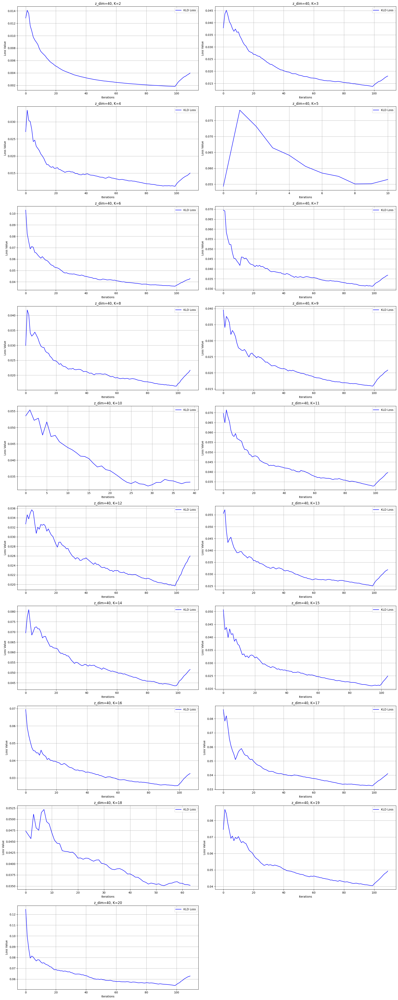

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define the directory where the histories are saved and the values for z_dim and K
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
z_dim = 40
K_values = range(2, 21)

# Calculate the number of rows and columns for the grid
num_plots = len(K_values)
num_cols = 2  # You can adjust this based on how wide you want the grid
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate the number of rows needed

# Create the subplots grid
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
axs = axs.flatten()  # Flatten the array of axes for easier iteration

# Loop through each K value and plot the respective losses in the grid
for i, k in enumerate(K_values):
    # Load the history for the current K
    history_file_path = f'{save_dir}/DCEC_zdim_{z_dim}_nclusters_{k}_history.npy'
    try:
        history = np.load(history_file_path, allow_pickle=True).item()
    except FileNotFoundError:
        print(f'History file for z_dim={z_dim}, K={k} not found. Skipping.')
        continue

    # Extract the losses
    kld_loss = history['kld_loss']


    # Plotting the losses
    axs[i].plot(kld_loss, label='KLD Loss', color='blue')
    axs[i].set_xlabel('Iterations')
    axs[i].set_ylabel('Loss Value')
    axs[i].set_title(f'z_dim={z_dim}, K={k}')
    axs[i].legend()
    axs[i].grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

# Adjust layout to ensure proper spacing
plt.tight_layout()
plt.show()


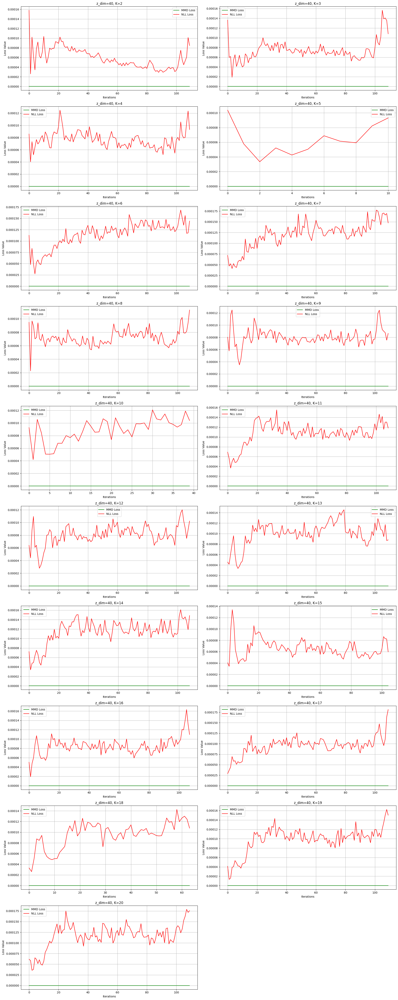

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define the directory where the histories are saved and the values for z_dim and K
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
z_dim = 40
K_values = range(2, 21)

# Calculate the number of rows and columns for the grid
num_plots = len(K_values)
num_cols = 2  # You can adjust this based on how wide you want the grid
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate the number of rows needed

# Create the subplots grid
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
axs = axs.flatten()  # Flatten the array of axes for easier iteration

# Loop through each K value and plot the respective losses in the grid
for i, k in enumerate(K_values):
    # Load the history for the current K
    history_file_path = f'{save_dir}/DCEC_zdim_{z_dim}_nclusters_{k}_history.npy'
    try:
        history = np.load(history_file_path, allow_pickle=True).item()
    except FileNotFoundError:
        print(f'History file for z_dim={z_dim}, K={k} not found. Skipping.')
        continue

    # Extract the losses
    mmd_loss = history['mmd_loss']
    nll_loss = history['nll_loss']

    # Plotting the losses
    axs[i].plot(mmd_loss, label='MMD Loss', color='green')
    axs[i].plot(nll_loss, label='NLL Loss', color='red')
    axs[i].set_xlabel('Iterations')
    axs[i].set_ylabel('Loss Value')
    axs[i].set_title(f'z_dim={z_dim}, K={k}')
    axs[i].legend()
    axs[i].grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

# Adjust layout to ensure proper spacing
plt.tight_layout()
plt.show()


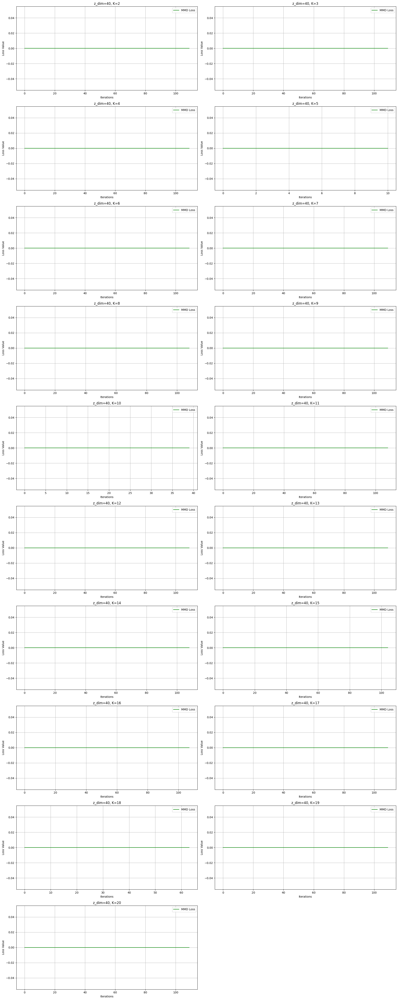

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define the directory where the histories are saved and the values for z_dim and K
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
z_dim = 40
K_values = range(2, 21)

# Calculate the number of rows and columns for the grid
num_plots = len(K_values)
num_cols = 2  # You can adjust this based on how wide you want the grid
num_rows = (num_plots + num_cols - 1) // num_cols  # Calculate the number of rows needed

# Create the subplots grid
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
axs = axs.flatten()  # Flatten the array of axes for easier iteration

# Loop through each K value and plot the respective losses in the grid
for i, k in enumerate(K_values):
    # Load the history for the current K
    history_file_path = f'{save_dir}/DCEC_zdim_{z_dim}_nclusters_{k}_history.npy'
    try:
        history = np.load(history_file_path, allow_pickle=True).item()
    except FileNotFoundError:
        print(f'History file for z_dim={z_dim}, K={k} not found. Skipping.')
        continue

    # Extract the losses
    mmd_loss = history['mmd_loss']

    # Plotting the losses
    axs[i].plot(mmd_loss, label='MMD Loss', color='green')
    axs[i].set_xlabel('Iterations')
    axs[i].set_ylabel('Loss Value')
    axs[i].set_title(f'z_dim={z_dim}, K={k}')
    axs[i].legend()
    axs[i].grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

# Adjust layout to ensure proper spacing
plt.tight_layout()
plt.show()


In [ ]:
# Print the absolute values of the MMD losses
print("Absolute MMD Loss Values over Iterations:")
for i, mmd_value in enumerate(history['mmd_loss']):
    print(f"Iteration {i}, Absolute MMD Loss: {abs(mmd_value)}")


In [ ]:
# Evaluate the performance of autoencoder for training, validation, and test data
predicted_wholedataset = dcec.predict(dataNormReshape).reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])
predicted_train = dcec.predict(data_train).reshape(-1, data_train.shape[1], data_train.shape[2])
predicted_test = dcec.predict(data_test).reshape(-1, data_test.shape[1], data_test.shape[2])

actual_train = data_train.reshape(-1, data_train.shape[1], data_train.shape[2])
actual_test = data_test.reshape(-1, data_test.shape[1], data_test.shape[2])

# Visualize actual and predicted image
fig, axes = plt.subplots(nrows=2, ncols=5, sharex=True, sharey=True, figsize=(20, 4))
for images, row in zip([actual_test[100:105], predicted_test[100:105]], axes):
    for img, ax in zip(images, row):
        ax.imshow(img.reshape((raw.shape[1], raw.shape[2])))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
plt.savefig('ActualPredicted5Images')

# Denormalize and compare topographic map from raw data with denormalized reconstructed topographic map
outputDenormalisedData = predicted_wholedataset * (raw.max() - raw.min()) + raw.min()
outputDenormalisedData = outputDenormalisedData.reshape(-1, outputDenormalisedData.shape[1], outputDenormalisedData.shape[2])

AttributeError: 'DCEC' object has no attribute 'predict'

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Number of images to compare
num_images = 100

data_train_filtered = data_train_filtered

# Randomly pick indices from the training and test sets
train_indices = np.random.choice(len(data_train_filtered), num_images // 2, replace=False)
test_indices = np.random.choice(len(data_test), num_images // 2, replace=False)

# Combine the selected indices from training and test sets
selected_train_images = data_train_filtered[train_indices]
selected_test_images = data_test[test_indices]

# Combine the selected images into one dataset
selected_images = np.concatenate([selected_train_images, selected_test_images], axis=0)

# Predict the reconstructed images using the vae_deep_clustering
predicted_images = vae_deep_clustering.predict(selected_images).reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])

# Reshape the actual images for comparison
actual_images = selected_images.reshape(-1, dataNormReshape.shape[1], dataNormReshape.shape[2])

# Plot 100 original images vs. reconstructed images in a 10x10 grid
fig, axes = plt.subplots(nrows=20, ncols=10, sharex=True, sharey=True, figsize=(20, 40))

for i in range(num_images):
    # Original images
    ax = axes[2 * (i // 10), i % 10]
    ax.imshow(actual_images[i].squeeze(), cmap='viridis')  # Set the colormap to 'viridis'
    ax.set_title(f'Original {i+1}', fontsize=8)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # Reconstructed images
    ax = axes[2 * (i // 10) + 1, i % 10]
    ax.imshow(predicted_images[i].squeeze(), cmap='viridis')  # Set the colormap to 'viridis'
    ax.set_title(f'Reconstructed {i+1}', fontsize=8)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

plt.tight_layout()
plt.savefig('ActualVsReconstructed100Images.png')
plt.show()

# Denormalize and compare topographic map from raw data with denormalized reconstructed topographic map
outputDenormalisedData = predicted_images * (raw.max() - raw.min()) + raw.min()


NameError: name 'data_train_filtered' is not defined

In [ ]:
from skimage import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from scipy import stats
#raw=np.load('testdata.npy')
raw=listOfTopographicMapsForAE
raw.shape

train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

#Normalise the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape=dataNorm.reshape(-1,raw.shape[1],raw.shape[2],1)

# First split: 70% training and 30% remaining (to be split into validation and test)
data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)

# Second split: 15% validation and 15% testing from the remaining 30%
data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)
#data_train.shape,data_test.shape,data_val.shape

# Flatten the data to make it easier to compute Z-scores
data_train_flat = data_train.reshape(data_train.shape[0], -1)

# Calculate Z-scores
z_scores = np.abs(stats.zscore(data_train_flat, axis=0))

# Set a Z-score threshold (e.g., 3)
threshold = 3

# Identify outliers
outliers = np.where(z_scores > threshold)

# Filter out the outliers
filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
data_train_filtered = data_train[filtered_indices]


## Model Metrics Table v3


In [ ]:
from skimage.metrics import structural_similarity, mean_squared_error
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from scipy import stats
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Layer
from tensorflow.keras import backend as K
from tensorflow.keras.utils import custom_object_scope
import csv
from datetime import datetime

# Register the custom function
@tf.keras.utils.register_keras_serializable()
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps

# Define functions for SSIM, MSE, MAE, MAPE, MdAPE with appropriate data_range for SSIM
def SSIM(actual, pred, data_range):
    ssimErrAllPair = 0
    for i in range(actual.shape[0]):
        ssimErrAllPair += structural_similarity(actual[i], pred[i], data_range=data_range) / actual.shape[0]
    return ssimErrAllPair


def MSE(actual, pred):
    mseErrAllPair = 0
    for i in range(actual.shape[0]):
        mseErrAllPair += mean_squared_error(actual[i], pred[i]) / actual.shape[0]
    return mseErrAllPair

def MAE(actual, pred):
    MA_error_all = 0
    for i in range(actual.shape[0]):
        MA_error_all += mean_absolute_error(actual[i], pred[i]) / actual.shape[0]
    return MA_error_all

def MAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.mean(percentage_errors)

def MdAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.median(percentage_errors)


'''
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

# Load and preprocess the data
raw = listOfTopographicMapsForAE
raw.shape

# Normalize the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

# Split the data
data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)

# Flatten the data to compute Z-scores
data_train_flat = data_train.reshape(data_train.shape[0], -1)

# Calculate Z-scores and filter outliers
z_scores = np.abs(stats.zscore(data_train_flat, axis=0))
threshold = 3
outliers = np.where(z_scores > threshold)
filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
data_train_filtered = data_train[filtered_indices]

results = []
plt.figure(figsize=(14, 8))


# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

@tf.keras.utils.register_keras_serializable()
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
    return mu + K.exp(sigma)*eps

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

        # Ensure the variables of encoder and decoder are tracked
        self._trainable_variables = self.encoder.trainable_variables + self.decoder.trainable_variables


    @property
    def trainable_variables(self):
        return self._trainable_variables

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)

            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)

            total_loss = loss_mmd
            # Dynamically scale NLL
            #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)

        # Compute gradients
        gradients = tape.gradient(total_loss, self.trainable_variables)
        # Apply gradients
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Log dynamic weights for debugging
        #tf.print("Epoch", self.current_epoch + 1, ": w1=", w1, ", w2=", w2, ", loss=", total_loss)
        # Return a dictionary mapping metric names to current value
        return {'loss': total_loss, 'loss_mmd': loss_mmd}

    def on_epoch_end(self, epoch, logs=None):
        # Update current epoch at the end of each epoch
        self.current_epoch += 1

    def test_step(self, data):
        x = data  # Validation data

        # Forward pass
        mu, sigma, latent_space = self.encoder(x)
        train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
        xr = self.decoder(latent_space)

        # Compute losses
        loss_mmd = compute_mmd(latent_space, train_z)

        total_loss = loss_mmd
        # Dynamically scale NLL
        #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)
        return {'loss': total_loss, 'loss_mmd': loss_mmd}
'''
# Set dimensions for evaluation
dimensions = [40]
K_values = range(2, 21)
results = []
plt.figure(figsize=(14, 8))

# Loop through dimensions and load models
for dim in dimensions:
    for k in K_values:
        start_time = datetime.now()

        # Load the encoder and decoder models
        encoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_encoder.h5'
        decoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_decoder.h5'
        clustering_weights_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_clustering_weights.npy'

        encoder = load_model(encoder_file_path, custom_objects={'compute_latent': compute_latent}, compile=False)
        decoder = load_model(decoder_file_path, compile=False)
        clustering_weights = np.load(clustering_weights_path, allow_pickle=True)

        # Predict using encoder and decoder
        latent_train = encoder.predict(data_train)[2]  # Obtain latent representation
        latent_test = encoder.predict(data_test)[2]
        reconstructed_train = decoder.predict(latent_train).reshape(-1, data_train.shape[1], data_train.shape[2])
        reconstructed_test = decoder.predict(latent_test).reshape(-1, data_test.shape[1], data_test.shape[2])
        # Compute SSIM, MSE, MAE, MAPE
        data_range = 1.0  # Since images are normalized to [0, 1]
        actual_train = data_train.reshape(-1, data_train.shape[1], data_train.shape[2])
        actual_test = data_test.reshape(-1, data_test.shape[1], data_test.shape[2])

        # Ensure that actual_train and predicted_train are denormalized before calculating MAPE
        actual_train_denorm = actual_train * (raw.max() - raw.min()) + raw.min()
        predicted_train_denorm = reconstructed_train * (raw.max() - raw.min()) + raw.min()

        actual_test_denorm = actual_test * (raw.max() - raw.min()) + raw.min()
        predicted_test_denorm = reconstructed_test * (raw.max() - raw.min()) + raw.min()

        SSIM_train = SSIM(actual_train, reconstructed_train, data_range)
        MSE_train = MSE(actual_train, reconstructed_train)
        MAE_train = MAE(actual_train, reconstructed_train)
        MAPE_train = MAPE(actual_train_denorm, predicted_train_denorm)
        MdAPE_train = MdAPE(actual_train_denorm, predicted_train_denorm)

        SSIM_test = SSIM(actual_test, reconstructed_test, data_range)
        MSE_test = MSE(actual_test, reconstructed_test)
        MAE_test = MAE(actual_test, reconstructed_test)
        MAPE_test = MAPE(actual_test_denorm, predicted_test_denorm)
        MdAPE_test = MdAPE(actual_test_denorm, predicted_test_denorm)

        # Store results
        results.append({
            'Dimension': dim,
            'Cluster': k,
            'Training SSIM': SSIM_train,
            'Training MSE': MSE_train,
            'Training MAE': MAE_train,
            'Training MAPE (%)': MAPE_train,
            'Training MdAPE (%)': MdAPE_train,
            'Testing SSIM': SSIM_test,
            'Testing MSE': MSE_test,
            'Testing MAE': MAE_test,
            'Testing MAPE (%)': MAPE_test,
            'Testing MdAPE (%)': MdAPE_test
        })

# Save results to a CSV file
header = ['Dimension', 'Cluster', 'Training SSIM', 'Training MSE', 'Training MAE', 'Training MAPE (%)', 'Training MdAPE (%)',
          'Testing SSIM', 'Testing MSE', 'Testing MAE', 'Testing MAPE (%)', 'Testing MdAPE (%)']
with open('/content/drive/MyDrive/Masters Dataset/DCEC/metrics_table.csv', 'w', newline='') as f:
    writer = csv.DictWriter(f, fieldnames=header)
    writer.writeheader()
    for result in results:
        writer.writerow(result)

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))
print("Execution finished")


538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
538/538 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
538/538 ━━━━━━━━

<Figure size 1400x800 with 0 Axes>

## Model Metrics Table v4


In [ ]:
from skimage.metrics import structural_similarity, mean_squared_error
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from scipy import stats
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Layer
from tensorflow.keras import backend as K
from tensorflow.keras.utils import custom_object_scope
import csv
from datetime import datetime

# Register the custom function
@tf.keras.utils.register_keras_serializable()
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps

# Define functions for SSIM, MSE, MAE, MAPE, MdAPE with appropriate data_range for SSIM
def SSIM(actual, pred, data_range):
    ssimErrAllPair = 0
    for i in range(actual.shape[0]):
        ssimErrAllPair += structural_similarity(actual[i], pred[i], data_range=data_range) / actual.shape[0]
    return ssimErrAllPair


def MSE(actual, pred):
    mseErrAllPair = 0
    for i in range(actual.shape[0]):
        mseErrAllPair += mean_squared_error(actual[i], pred[i]) / actual.shape[0]
    return mseErrAllPair

def MAE(actual, pred):
    MA_error_all = 0
    for i in range(actual.shape[0]):
        MA_error_all += mean_absolute_error(actual[i], pred[i]) / actual.shape[0]
    return MA_error_all

def MAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.mean(percentage_errors)

def MdAPE(actual, pred):
    epsilon = 1e-10  # Small constant to avoid division by zero or very small values
    non_zero_indices = actual != 0  # Mask for non-zero actual values
    actual_non_zero = actual[non_zero_indices]
    pred_non_zero = pred[non_zero_indices]

    percentage_errors = np.abs((actual_non_zero - pred_non_zero) / actual_non_zero) * 100
    return np.median(percentage_errors)


'''
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15

# Load and preprocess the data
raw = listOfTopographicMapsForAE
raw.shape

# Normalize the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

# Split the data
data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)

# Flatten the data to compute Z-scores
data_train_flat = data_train.reshape(data_train.shape[0], -1)

# Calculate Z-scores and filter outliers
z_scores = np.abs(stats.zscore(data_train_flat, axis=0))
threshold = 3
outliers = np.where(z_scores > threshold)
filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
data_train_filtered = data_train[filtered_indices]

results = []
plt.figure(figsize=(14, 8))


# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(
            name='clusters',
            shape=(self.n_clusters, input_dim),
            initializer='glorot_uniform'
        )
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (
            1.0
            + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha)
        )
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    x = tf.expand_dims(x, axis=1)  # Shape: (x_size, 1, dim)
    y = tf.expand_dims(y, axis=0)  # Shape: (1, y_size, dim)
    tiled_x = tf.tile(x, [1, y_size, 1])  # Shape: (x_size, y_size, dim)
    tiled_y = tf.tile(y, [x_size, 1, 1])  # Shape: (x_size, y_size, dim)
    return tf.exp(
        -tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32')
    )

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return (
        tf.reduce_mean(x_kernel)
        + tf.reduce_mean(y_kernel)
        - 2 * tf.reduce_mean(xy_kernel)
    )

@tf.keras.utils.register_keras_serializable()
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch,z_dim),mean=0., stddev=1.)
    return mu + K.exp(sigma)*eps

# Define the CustomLossLayer
# Custom model subclassing tf.keras.Model
class CustomLossLayer(tf.keras.Model):
    def __init__(self, encoder, decoder, total_epochs):
        super(CustomLossLayer, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
        self.total_epochs = total_epochs
        self.current_epoch = 0

        # Ensure the variables of encoder and decoder are tracked
        self._trainable_variables = self.encoder.trainable_variables + self.decoder.trainable_variables


    @property
    def trainable_variables(self):
        return self._trainable_variables

    def train_step(self, data):
        x = data  # Since we have no labels

        with tf.GradientTape() as tape:
            # Forward pass
            mu, sigma, latent_space = self.encoder(x)
            # Sample train_z from prior distribution
            train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
            xr = self.decoder(latent_space)

            # Custom loss
            loss_mmd = compute_mmd(latent_space, train_z)

            total_loss = loss_mmd
            # Dynamically scale NLL
            #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)

        # Compute gradients
        gradients = tape.gradient(total_loss, self.trainable_variables)
        # Apply gradients
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))

        # Log dynamic weights for debugging
        #tf.print("Epoch", self.current_epoch + 1, ": w1=", w1, ", w2=", w2, ", loss=", total_loss)
        # Return a dictionary mapping metric names to current value
        return {'loss': total_loss, 'loss_mmd': loss_mmd}

    def on_epoch_end(self, epoch, logs=None):
        # Update current epoch at the end of each epoch
        self.current_epoch += 1

    def test_step(self, data):
        x = data  # Validation data

        # Forward pass
        mu, sigma, latent_space = self.encoder(x)
        train_z = tf.random.normal(shape=(tf.shape(x)[0], z_dim), mean=0.0, stddev=1.0)
        xr = self.decoder(latent_space)

        # Compute losses
        loss_mmd = compute_mmd(latent_space, train_z)

        total_loss = loss_mmd
        # Dynamically scale NLL
        #total_loss = w1 * loss_mmd + w2 * (scale_factor * loss_nll)
        return {'loss': total_loss, 'loss_mmd': loss_mmd}

# Set dimensions for evaluation
dimensions = [40]
K_values = range(2, 21)
results = []
plt.figure(figsize=(14, 8))

# Loop through dimensions and load models
for dim in dimensions:
    for k in K_values:
        start_time = datetime.now()

        # Load the encoder and decoder models
        encoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_{dim}_nclusters_{k}_encoder.h5'
        decoder_file_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_{dim}_nclusters_{k}_decoder.h5'
        clustering_weights_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_{dim}_nclusters_{k}_clustering_weights.npy'

        encoder = load_model(encoder_file_path, custom_objects={'compute_latent': compute_latent}, compile=False)
        decoder = load_model(decoder_file_path, compile=False)
        clustering_weights = np.load(clustering_weights_path, allow_pickle=True)

        # Predict using encoder and decoder
        latent_train = encoder.predict(data_train)[2]  # Obtain latent representation
        latent_test = encoder.predict(data_test)[2]
        reconstructed_train = decoder.predict(latent_train).reshape(-1, data_train.shape[1], data_train.shape[2])
        reconstructed_test = decoder.predict(latent_test).reshape(-1, data_test.shape[1], data_test.shape[2])
        # Compute SSIM, MSE, MAE, MAPE
        data_range = 1.0  # Since images are normalized to [0, 1]
        actual_train = data_train.reshape(-1, data_train.shape[1], data_train.shape[2])
        actual_test = data_test.reshape(-1, data_test.shape[1], data_test.shape[2])

        # Ensure that actual_train and predicted_train are denormalized before calculating MAPE
        actual_train_denorm = actual_train * (raw.max() - raw.min()) + raw.min()
        predicted_train_denorm = reconstructed_train * (raw.max() - raw.min()) + raw.min()

        actual_test_denorm = actual_test * (raw.max() - raw.min()) + raw.min()
        predicted_test_denorm = reconstructed_test * (raw.max() - raw.min()) + raw.min()

        SSIM_train = SSIM(actual_train, reconstructed_train, data_range)
        MSE_train = MSE(actual_train, reconstructed_train)
        MAE_train = MAE(actual_train, reconstructed_train)
        MAPE_train = MAPE(actual_train_denorm, predicted_train_denorm)
        MdAPE_train = MdAPE(actual_train_denorm, predicted_train_denorm)

        SSIM_test = SSIM(actual_test, reconstructed_test, data_range)
        MSE_test = MSE(actual_test, reconstructed_test)
        MAE_test = MAE(actual_test, reconstructed_test)
        MAPE_test = MAPE(actual_test_denorm, predicted_test_denorm)
        MdAPE_test = MdAPE(actual_test_denorm, predicted_test_denorm)

        # Store results
        results.append({
            'Dimension': dim,
            'Cluster': k,
            'Training SSIM': SSIM_train,
            'Training MSE': MSE_train,
            'Training MAE': MAE_train,
            'Training MAPE (%)': MAPE_train,
            'Training MdAPE (%)': MdAPE_train,
            'Testing SSIM': SSIM_test,
            'Testing MSE': MSE_test,
            'Testing MAE': MAE_test,
            'Testing MAPE (%)': MAPE_test,
            'Testing MdAPE (%)': MdAPE_test
        })

# Save results to a CSV file
header = ['Dimension', 'Cluster', 'Training SSIM', 'Training MSE', 'Training MAE', 'Training MAPE (%)', 'Training MdAPE (%)',
          'Testing SSIM', 'Testing MSE', 'Testing MAE', 'Testing MAPE (%)', 'Testing MdAPE (%)']
with open('/content/drive/MyDrive/Masters Dataset/DCEC/metrics_table2.csv', 'w', newline='') as f:
    writer = csv.DictWriter(f, fieldnames=header)
    writer.writeheader()
    for result in results:
        writer.writerow(result)

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))
print("Execution finished")
'''

'\ntrain_ratio = 0.7\nval_ratio = 0.15\ntest_ratio = 0.15\n\n# Load and preprocess the data\nraw = listOfTopographicMapsForAE\nraw.shape\n\n# Normalize the data\ndataNorm = (raw - raw.min()) / (raw.max() - raw.min())\ndataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)\n\n# Split the data\ndata_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)\ndata_val, data_test = train_test_split(data_remaining, test_size=test_ratio/(test_ratio + val_ratio), random_state=42, shuffle=True)\n\n# Flatten the data to compute Z-scores\ndata_train_flat = data_train.reshape(data_train.shape[0], -1)\n\n# Calculate Z-scores and filter outliers\nz_scores = np.abs(stats.zscore(data_train_flat, axis=0))\nthreshold = 3\noutliers = np.where(z_scores > threshold)\nfiltered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]\ndata_train_filtered = data_train[filtered_indices]\n\nresults = []\nplt.figure(figsi

##Get Encoder output

### Test


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import cdist, pdist, squareform

# Define paths
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
z_dim = 40
n_clusters = 2
model_name = f'DCEC_zdim_{z_dim}_nclusters_{n_clusters}'
encoder_path = f'{save_dir}/{model_name}_encoder.h5'
latent_space_path = f'{save_dir}/{model_name}_latent_space.npy'
cluster_centroids_path = f'{save_dir}/{model_name}_cluster_centroids.npy'

# Load the saved encoder model
print(f'Loading encoder model from {encoder_path}...')
encoder = load_model(encoder_path, compile=False)

# Assuming your dataset is stored in `data_train`
# Load or prepare your dataset
# Ensure `data_train` is normalized to the same range as used during training
# Example: data_train = np.load('/path/to/data_train.npy')

# Extract latent space representations
print('Computing latent space representations...')
latent_mu, latent_sigma, latent_space = encoder.predict(data_train)

# Save the latent space to a file for later use
np.save(latent_space_path, latent_space)
print(f'Latent space saved to {latent_space_path}')

#Load cluster centroids
print(f'Loading cluster centroids from {cluster_centroids_path}...')
cluster_centroids = np.load(cluster_centroids_path)

# Assign clusters
print('Assigning clusters based on nearest centroids...')
cluster_labels = np.argmin(cdist(latent_space, cluster_centroids), axis=1)


# Assign clusters
print('Assigning clusters based on nearest centroids...')
cluster_labels = np.argmin(cdist(latent_space, cluster_centroids), axis=1)
# Define metric functions
# Define metric functions
def dunn_index(X, labels):
    unique_clusters = np.unique(labels)
    intra_distances = []
    inter_distances = []

    for cluster in unique_clusters:
        cluster_points = X[labels == cluster]
        if len(cluster_points) > 1:
            intra_distances.append(np.max(pairwise_distances(cluster_points)))
        else:
            intra_distances.append(0)  # Single-point clusters have no intra-cluster distance

    for i in range(len(unique_clusters)):
        for j in range(i + 1, len(unique_clusters)):
            cluster_i_points = X[labels == unique_clusters[i]]
            cluster_j_points = X[labels == unique_clusters[j]]
            inter_distances.append(np.min(cdist(cluster_i_points, cluster_j_points)))

    return np.min(inter_distances) / np.max(intra_distances)

def r_squared_index(latent_space, cluster_labels, cluster_centroids):
    total_ss = np.sum((latent_space - np.mean(latent_space, axis=0))**2)
    between_ss = np.sum([np.sum((latent_space[cluster_labels == k] - cluster_centroids[k])**2)
                         for k in range(len(cluster_centroids))])
    return 1 - between_ss / total_ss

def hubert_levin_c_index(latent_space, cluster_labels):
    pairwise_distances = squareform(pdist(latent_space))
    same_cluster_mask = np.equal.outer(cluster_labels, cluster_labels)
    within_cluster_distances = pairwise_distances[same_cluster_mask]
    return np.mean(within_cluster_distances)

# Calculate metrics
print('Calculating clustering metrics...')
silhouette = silhouette_score(latent_space, cluster_labels)
calinski_harabasz = calinski_harabasz_score(latent_space, cluster_labels)
davies_bouldin = davies_bouldin_score(latent_space, cluster_labels)
dunn = dunn_index(latent_space, cluster_labels)
r_squared = r_squared_index(latent_space, cluster_labels, cluster_centroids)
hubert_levin = hubert_levin_c_index(latent_space, cluster_labels)

# Print results
print(f'Silhouette Score: {silhouette:.4f}')
print(f'Calinski-Harabasz Score: {calinski_harabasz:.4f}')
print(f'Davies-Bouldin Score: {davies_bouldin:.4f}')
print(f'Dunn Index: {dunn:.4f}')
print(f'R-Squared Index: {r_squared:.4f}')
print(f'Hubert-Levin C-Index: {hubert_levin:.4f}')

# Save metrics to a file
results = {
    'Dimension': z_dim,
    'Cluster': k,
    'Silhouette Score': silhouette,
    'Calinski-Harabasz Score': calinski_harabasz,
    'Davies-Bouldin Score': davies_bouldin,
    'Dunn Index': dunn,
    'R-Squared Index': r_squared,
    'Hubert-Levin C-Index': hubert_levin
}

print(results)

'''
results_path = f'{save_dir}/{model_name}_clustering_metrics.npy'
np.save(results_path, results)
print(f'Clustering metrics saved to {results_path}')
'''

Loading encoder model from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_40_nclusters_2_encoder.h5...
Computing latent space representations...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Latent space saved to /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_40_nclusters_2_latent_space.npy
Loading cluster centroids from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_40_nclusters_2_cluster_centroids.npy...
Assigning clusters based on nearest centroids...
Assigning clusters based on nearest centroids...
Calculating clustering metrics...
Silhouette Score: 0.8080
Calinski-Harabasz Score: 56709.0047
Davies-Bouldin Score: 0.3406
Dunn Index: 0.0252
R-Squared Index: 0.7475
Hubert-Levin C-Index: 0.9748
{'Dimension': 40, 'Cluster': 2, 'Silhouette Score': 0.80796534, 'Calinski-Harabasz Score': 56709.00468516553, 'Davies-Bouldin Score': 0.3406194638766976, 'Dunn Index': 0.02515902353670906, 'R-Squared Index': 0.7474641501

"\nresults_path = f'{save_dir}/{model_name}_clustering_metrics.npy'\nnp.save(results_path, results)\nprint(f'Clustering metrics saved to {results_path}')\n"

In [ ]:
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, Lambda, LeakyReLU
import tensorflow.keras.backend as K

dimensions = [40]  # Different latent space dimensions
K_values = range(2, 21)

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(name='clusters', shape=(self.n_clusters, input_dim), initializer='glorot_uniform')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# Define the custom loss layer
@tf.keras.utils.register_keras_serializable()  # Registering the custom layer for model saving and loading
class CustomLossLayer(Layer):
    def call(self, inputs):
        train_z, train_xr, train_x = inputs
        loss_mmd = self.compute_mmd(train_z, train_z)
        loss_nll = K.mean(K.square(train_xr - train_x))
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def compute_mmd(self, x, y):
        x_size = K.shape(x)[0]
        y_size = K.shape(y)[0]
        dim = K.shape(x)[1]
        tiled_x = K.tile(K.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
        tiled_y = K.tile(K.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
        return K.exp(-K.mean(K.square(tiled_x - tiled_y), axis=2) / K.cast(dim, 'float32'))

# Define the custom function
@tf.keras.utils.register_keras_serializable()  # Registering the custom function for model saving and loading
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps

for z_dim in dimensions:
  for k in K_values:
    start_time = datetime.now()
    # Load the corresponding saved model
    # Load pre-trained model with custom objects
    model_file_path1 = f'/content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_{dim}_nclusters_{k}.h5'
    with custom_object_scope({'ClusteringLayer': ClusteringLayer, 'CustomLossLayer': CustomLossLayer, 'compute_latent': compute_latent}):
        dcec_load_model = load_model(model_file_path1, compile=False)
    # Rebuild the encoder with the correct z_dim
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))

    # Encoder architecture remains the same as described earlier, with the correct z_dim
    en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + K.exp(sigma) * eps

    latent_space = Lambda(compute_latent)([mu, sigma])

    # Build the encoder model
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')

    # Load the weights into the encoder from the full model
    for layer in encoder.layers:
        try:
            layer.set_weights(dcec_load_model.get_layer(layer.name).get_weights())
        except ValueError:
            pass

    # Now use the encoder to predict the latent space on your test data
    mu_train, sigma_train, latent_space_train = encoder.predict(data_train_filtered)

    # You can store or analyze the latent space output as needed
    # e.g., save latent space
    np.save(f'/content/drive/MyDrive/Masters Dataset/DCEC/dcec_latent_space_train_dim{z_dim}_nclusters_{k}.npy', latent_space_train)


486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


KeyboardInterrupt: 

## Clustering Metrics v4

In [ ]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import cdist, pdist, squareform

# Define paths and parameters
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4'
dimensions = [40]
K_values = range(2, 21)
results = []

# Metric Functions
def dunn_index(latent_space, cluster_labels):
    clusters = [latent_space[cluster_labels == k] for k in np.unique(cluster_labels)]
    min_intercluster_dist = np.min(
        [np.min(cdist(c1, c2)) for i, c1 in enumerate(clusters) for c2 in clusters[i + 1:]]
    )
    max_intracluster_dist = np.max([np.max(cdist(cluster, cluster)) for cluster in clusters])
    return min_intercluster_dist / max_intracluster_dist

def r_squared_index(latent_space, cluster_labels, cluster_centroids):
    total_ss = np.sum((latent_space - np.mean(latent_space, axis=0))**2)
    between_ss = np.sum([np.sum((latent_space[cluster_labels == k] - cluster_centroids[k])**2)
                         for k in range(len(cluster_centroids))])
    return 1 - between_ss / total_ss

def hubert_levin_c_index(latent_space, cluster_labels):
    pairwise_distances = squareform(pdist(latent_space))
    same_cluster_mask = np.equal.outer(cluster_labels, cluster_labels)
    within_cluster_distances = pairwise_distances[same_cluster_mask]
    return np.mean(within_cluster_distances)

# Loop through dimensions and number of clusters
for dim in dimensions:
    for k in K_values:
        model_name = f'DCEC2_zdim_{dim}_nclusters_{k}'
        encoder_path = f'{save_dir}/{model_name}_encoder.h5'
        latent_space_path = f'{save_dir}/{model_name}_latent_space.npy'
        cluster_centroids_path = f'{save_dir}/{model_name}_cluster_centroids.npy'

        try:
            # Load the encoder
            print(f'\nProcessing model: z_dim={dim}, n_clusters={k}')
            encoder = load_model(encoder_path, compile=False)

            # Load dataset (ensure normalization is consistent with training)
            # Example: data_train = np.load('/path/to/data_train.npy')

            # Extract latent space
            print('Computing latent space...')
            latent_mu, latent_sigma, latent_space = encoder.predict(data_train)
            np.save(latent_space_path, latent_space)
            print(f'Latent space saved to {latent_space_path}')

            # Load cluster centroids
            print(f'Loading cluster centroids from {cluster_centroids_path}...')
            cluster_centroids = np.load(cluster_centroids_path)

            # Assign clusters
            print('Assigning clusters...')
            cluster_labels = np.argmin(cdist(latent_space, cluster_centroids), axis=1)

            # Calculate metrics
            print('Calculating metrics...')
            silhouette = silhouette_score(latent_space, cluster_labels)
            calinski_harabasz = calinski_harabasz_score(latent_space, cluster_labels)
            davies_bouldin = davies_bouldin_score(latent_space, cluster_labels)
            dunn = dunn_index(latent_space, cluster_labels)
            r_squared = r_squared_index(latent_space, cluster_labels, cluster_centroids)
            hubert_levin = hubert_levin_c_index(latent_space, cluster_labels)

            # Store results
            results.append({
                'z_dim': dim,
                'n_clusters': k,
                'Silhouette Score': silhouette,
                'Calinski-Harabasz Score': calinski_harabasz,
                'Davies-Bouldin Score': davies_bouldin,
                'Dunn Index': dunn,
                'R-Squared Index': r_squared,
                'Hubert-Levin C-Index': hubert_levin
            })

            print(f'Results for z_dim={dim}, n_clusters={k}:')
            print(f'  Silhouette Score: {silhouette:.4f}')
            print(f'  Calinski-Harabasz Score: {calinski_harabasz:.4f}')
            print(f'  Davies-Bouldin Score: {davies_bouldin:.4f}')
            print(f'  Dunn Index: {dunn:.4f}')
            print(f'  R-Squared Index: {r_squared:.4f}')
            print(f'  Hubert-Levin C-Index: {hubert_levin:.4f}')

        except Exception as e:
            print(f'Error processing model z_dim={dim}, n_clusters={k}: {str(e)}')

# Convert the results to a DataFrame for easy viewing
results_df = pd.DataFrame(results)
print(results_df)



Processing model: z_dim=40, n_clusters=2
Computing latent space...
538/538 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step
Latent space saved to /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_40_nclusters_2_latent_space.npy
Loading cluster centroids from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_40_nclusters_2_cluster_centroids.npy...
Assigning clusters...
Calculating metrics...
Results for z_dim=40, n_clusters=2:
  Silhouette Score: 0.0022
  Calinski-Harabasz Score: 40.9227
  Davies-Bouldin Score: 20.1155
  Dunn Index: 0.1981
  R-Squared Index: -0.0193
  Hubert-Levin C-Index: 5.9772

Processing model: z_dim=40, n_clusters=3
Computing latent space...
538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
Latent space saved to /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_40_nclusters_3_latent_space.npy
Loading cluster centroids from /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCECV4/DCEC2_zdim_40_ncluste

### Ranked Table

In [ ]:
import pandas as pd

# Load the clustering evaluation results from the CSV file
csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/clustering_metrics_table2.csv'
df = pd.read_csv(csv_file_path)

# Rank the results based on each of the metrics
ranked_df = df.copy()
metrics_to_rank = ['Silhouette Index', 'Calinski-Harabasz Index', 'Davies-Bouldin Index', 'Dunn Index', 'R-Squared Index', 'Hubert-Levin C-Index']

# Assign rankings to each metric (higher values are better, except for Davies-Bouldin Index and C-Index)
for metric in metrics_to_rank:
    if metric in ['Davies-Bouldin Index', 'Hubert-Levin C-Index']:
        ranked_df[f'{metric} Rank'] = ranked_df[metric].rank(ascending=True)
    else:
        ranked_df[f'{metric} Rank'] = ranked_df[metric].rank(ascending=False)

# Save the ranked table to a new CSV file
ranked_csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/ranked_clustering_metrics_table2.csv'
ranked_df.to_csv(ranked_csv_file_path, index=False)

# Display the ranked DataFrame
print(ranked_df.head())


   Dimension  Cluster  Silhouette Index  Calinski-Harabasz Index  \
0         40        2          0.741054            144235.009194   
1         40        3          0.660015             76048.543362   
2         40        4          0.507080             39435.297255   
3         40        5          0.489632             39132.485159   
4         40        6          0.485382             30229.336052   

   Davies-Bouldin Index  Dunn Index  R-Squared Index  Hubert-Levin C-Index  \
0              0.349209    0.000113         0.854472              0.131422   
1              0.472653    0.001531         0.860953              0.127103   
2              0.640755    0.001028         0.828073              0.122767   
3              0.628703    0.002395         0.864367              0.095223   
4              0.718417    0.002686         0.860217              0.099620   

   Silhouette Index Rank  Calinski-Harabasz Index Rank  \
0                    1.0                           1.0   
1     

In [ ]:
import pandas as pd


# Rank each index (ascending or descending depending on the metric)
results_df['Silhouette Rank'] = results_df['Silhouette Score'].rank(ascending=False)
results_df['Dunn Rank'] = results_df['Dunn Index'].rank(ascending=False)
results_df['R-Squared Rank'] = results_df['R-Squared Index'].rank(ascending=False)
results_df['Hubert-Levin C-Rank'] = results_df['Hubert-Levin C-Index'].rank(ascending=False)
results_df['Davies-Bouldin Rank'] = results_df['Davies-Bouldin Score'].rank(ascending=True)
results_df['Calinski-Harabasz Rank'] = results_df['Calinski-Harabasz Score'].rank(ascending=False)

# Calculate the total rank (lower is better)
results_df['Total Rank'] = results_df[
    ['Silhouette Rank', 'Dunn Rank', 'R-Squared Rank', 'Hubert-Levin C-Rank', 'Davies-Bouldin Rank', 'Calinski-Harabasz Rank']
].sum(axis=1)

# Calculate the average and standard deviation of ranks
rank_columns = ['Silhouette Rank', 'Dunn Rank', 'R-Squared Rank', 'Hubert-Levin C-Rank', 'Davies-Bouldin Rank', 'Calinski-Harabasz Rank']
results_df['Average Rank'] = results_df[rank_columns].mean(axis=1).round(3)
results_df['Rank Std Dev'] = results_df[rank_columns].std(axis=1).round(3)

# Sort by total rank to determine the best clustering
results_sorted = results_df.sort_values('Total Rank')

# Print the sorted DataFrame with rankings
print(results_sorted[['z_dim', 'n_clusters', 'Total Rank', 'Average Rank', 'Rank Std Dev']])

# Save the ranked table to a new CSV file
ranked_csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/avg_ranked_clustering_metrics_table2.csv'
results_sorted.to_csv(ranked_csv_file_path, index=False)

# Display the top-ranked results
print(results_sorted.head())


    z_dim  n_clusters  Total Rank  Average Rank  Rank Std Dev
13     40          15        21.0         3.500         2.739
18     40          20        30.0         5.000         3.521
12     40          14        43.0         7.167         4.916
15     40          17        45.0         7.500         4.764
1      40           3        48.0         8.000         5.933
11     40          13        51.0         8.500         5.577
3      40           5        57.0         9.500         4.764
14     40          16        59.0         9.833         6.113
8      40          10        59.0         9.833         2.787
10     40          12        62.0        10.333         5.989
16     40          18        65.0        10.833         6.853
5      40           7        65.0        10.833         1.722
0      40           2        67.0        11.167         8.377
6      40           8        73.0        12.167         4.491
2      40           4        76.0        12.667         6.346
4      4

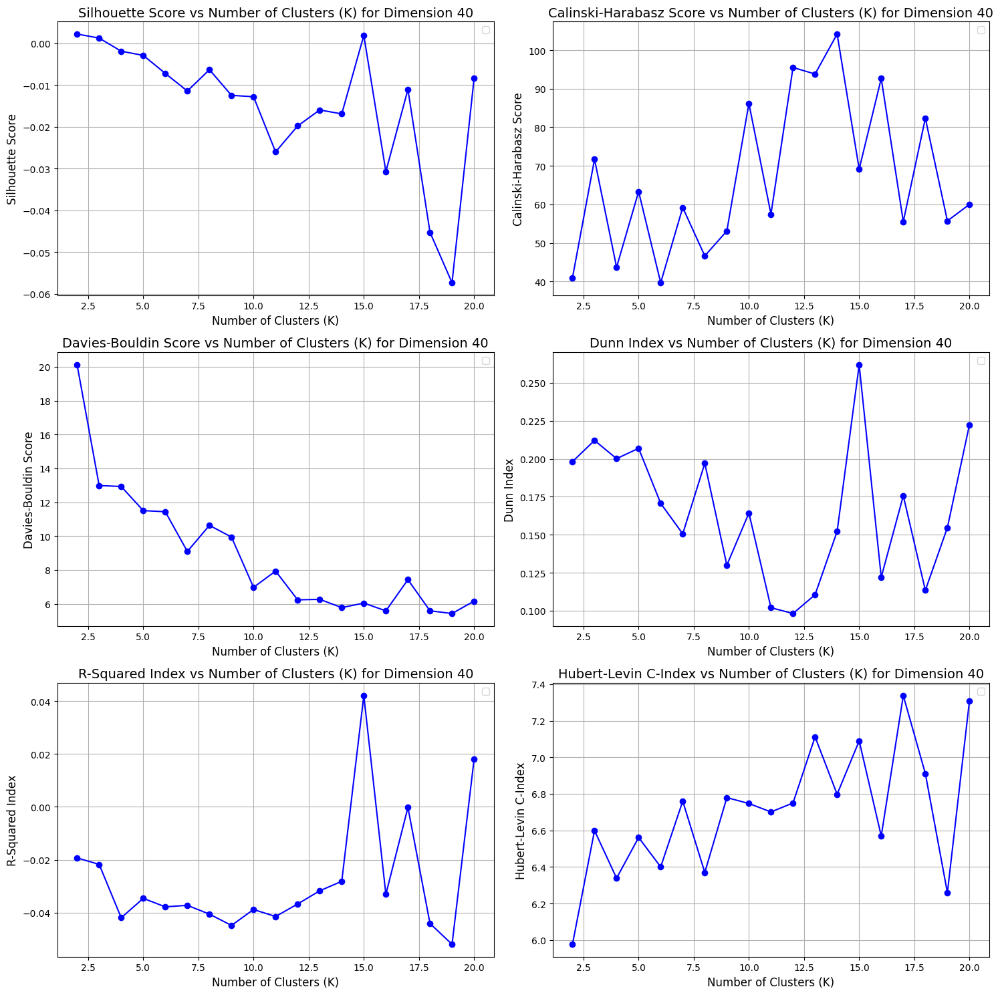

In [ ]:
import matplotlib.pyplot as plt

# Load the ranked clustering evaluation results from the CSV file
ranked_df = results_df
# List of metrics for plotting (updated to match the current column names)
metrics = [
    'Silhouette Score',
    'Calinski-Harabasz Score',
    'Davies-Bouldin Score',
    'Dunn Index',
    'R-Squared Index',
    'Hubert-Levin C-Index'
]

# Unique dimensions
dimensions = ranked_df['z_dim'].unique()

# Loop through each dimension and plot the metrics
for dim in dimensions:
    # Filter the data for the current dimension
    current_df = ranked_df[ranked_df['z_dim'] == dim]

    # Plot all metrics in a single grid layout for the current dimension
    fig, axs = plt.subplots(3, 2, figsize=(15, 15))  # 3 rows and 2 columns for 6 metrics

    # Flatten the axes for easier iteration
    axs = axs.flatten()

    # Plot each metric in a grid
    for i, metric in enumerate(metrics):
        axs[i].plot(current_df['n_clusters'], current_df[metric], marker='o', linestyle='-', color='b')

        # If there is an elbow method optimal cluster value for the current dimension, highlight it
        optimal_k = 27  # Replace with your logic to determine optimal_k for each dimension if applicable
        if optimal_k in current_df['n_clusters'].values:
            axs[i].axvline(x=optimal_k, color='r', linestyle='--', label='Elbow Method Optimal Cluster')
            axs[i].scatter(
                optimal_k,
                current_df[current_df['n_clusters'] == optimal_k][metric].values[0],
                color='red',
                s=100,
                zorder=5
            )

        axs[i].set_title(f'{metric} vs Number of Clusters (K) for Dimension {dim}', fontsize=14)
        axs[i].set_xlabel('Number of Clusters (K)', fontsize=12)
        axs[i].set_ylabel(metric, fontsize=12)
        axs[i].grid(True)

        # Add the legend to each subplot
        axs[i].legend()

    # Adjust layout to ensure everything fits
    plt.tight_layout()
    plt.show()


## Clustering Metrics v3

> Add blockquote



In [ ]:
!pip install scikit-learn-extra

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 31.6 MB/s eta 0:00:00


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import cdist, pdist, squareform

# Define paths and parameters
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
dimensions = [40]  # Replace with your desired dimensions
K_values = range(2, 21)  # Number of clusters to evaluate
results = []

# Metric Functions
def dunn_index(latent_space, cluster_labels):
    clusters = [latent_space[cluster_labels == k] for k in np.unique(cluster_labels)]
    min_intercluster_dist = np.min(
        [np.min(cdist(c1, c2)) for i, c1 in enumerate(clusters) for c2 in clusters[i + 1:]]
    )
    max_intracluster_dist = np.max([np.max(cdist(cluster, cluster)) for cluster in clusters])
    return min_intercluster_dist / max_intracluster_dist

def r_squared_index(latent_space, cluster_labels, cluster_centroids):
    total_ss = np.sum((latent_space - np.mean(latent_space, axis=0))**2)
    between_ss = np.sum([np.sum((latent_space[cluster_labels == k] - cluster_centroids[k])**2)
                         for k in range(len(cluster_centroids))])
    return 1 - between_ss / total_ss

def hubert_levin_c_index(latent_space, cluster_labels):
    pairwise_distances = squareform(pdist(latent_space))
    same_cluster_mask = np.equal.outer(cluster_labels, cluster_labels)
    within_cluster_distances = pairwise_distances[same_cluster_mask]
    return np.mean(within_cluster_distances)

# Loop through dimensions and number of clusters
for dim in dimensions:
    for k in K_values:
        full_model_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_full_model.h5'
        centroids_path = f'/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/DCEC_zdim_{dim}_nclusters_{k}_cluster_centroids.npy'

        # Load full model
        full_model = load_model(full_model_path, compile=False, custom_objects={"ClusteringLayer": ClusteringLayer})

        # Load cluster centroids
        cluster_centroids = np.load(centroids_path)

        # Load your test data
        #data_test = np.load('/path/to/your/test_data.npy')

        # Get clustering output (soft assignments) and reconstructed data
        print(f'getting clustering outputs')
        clustering_output, _ = full_model.predict(data_test)

        # Extract latent space from the encoder
        print('Computing latent space...')
        latent_space = full_model.get_layer('encoder')(data_test)[2].numpy()  # Extract third output (latent space)

        # Convert clustering output to hard labels
        print('Converting clustering output to hard labels...')
        cluster_labels = np.argmax(clustering_output, axis=1)



        # Calculate metrics
        print('Calculating metrics...')
        silhouette = silhouette_score(latent_space, cluster_labels)
        calinski_harabasz = calinski_harabasz_score(latent_space, cluster_labels)
        davies_bouldin = davies_bouldin_score(latent_space, cluster_labels)
        dunn = dunn_index(latent_space, cluster_labels)
        r_squared = r_squared_index(latent_space, cluster_labels, cluster_centroids)
        hubert_levin = hubert_levin_c_index(latent_space, cluster_labels)

        # Store results
        results.append({
            'z_dim': dim,
            'n_clusters': k,
            'Silhouette Score': silhouette,
            'Calinski-Harabasz Score': calinski_harabasz,
            'Davies-Bouldin Score': davies_bouldin,
            'Dunn Index': dunn,
            'R-Squared Index': r_squared,
            'Hubert-Levin C-Index': hubert_levin
        })

        print(f'Results for z_dim={dim}, n_clusters={k}:')
        print(f'  Silhouette Score: {silhouette:.4f}')
        print(f'  Calinski-Harabasz Score: {calinski_harabasz:.4f}')
        print(f'  Davies-Bouldin Score: {davies_bouldin:.4f}')
        print(f'  Dunn Index: {dunn:.4f}')
        print(f'  R-Squared Index: {r_squared:.4f}')
        print(f'  Hubert-Levin C-Index: {hubert_levin:.4f}')


# Convert the results to a DataFrame
results_df = pd.DataFrame(results)
print(results_df)


getting clustering outputs
116/116 ━━━━━━━━━━━━━━━━━━━━ 3s 16ms/step
Computing latent space...
Converting clustering output to hard labels...
Calculating metrics...
Results for z_dim=40, n_clusters=2:
  Silhouette Score: 0.7771
  Calinski-Harabasz Score: 3877.4380
  Davies-Bouldin Score: 0.6041
  Dunn Index: 0.0611
  R-Squared Index: 0.3907
  Hubert-Levin C-Index: 1.7546
getting clustering outputs
116/116 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step
Computing latent space...
Converting clustering output to hard labels...
Calculating metrics...
Results for z_dim=40, n_clusters=3:
  Silhouette Score: 0.1975
  Calinski-Harabasz Score: 2118.7454
  Davies-Bouldin Score: 1.3579
  Dunn Index: 0.0284
  R-Squared Index: 0.0748
  Hubert-Levin C-Index: 1.2354
getting clustering outputs
116/116 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step
Computing latent space...
Converting clustering output to hard labels...
Calculating metrics...
Results for z_dim=40, n_clusters=4:
  Silhouette Score: 0.2375
  Calinski-Harabasz Scor

In [ ]:
import pandas as pd


# Rank each index (ascending or descending depending on the metric)
results_df['Silhouette Rank'] = results_df['Silhouette Score'].rank(ascending=False)
results_df['Dunn Rank'] = results_df['Dunn Index'].rank(ascending=False)
results_df['R-Squared Rank'] = results_df['R-Squared Index'].rank(ascending=False)
results_df['Hubert-Levin C-Rank'] = results_df['Hubert-Levin C-Index'].rank(ascending=False)
results_df['Davies-Bouldin Rank'] = results_df['Davies-Bouldin Score'].rank(ascending=True)
results_df['Calinski-Harabasz Rank'] = results_df['Calinski-Harabasz Score'].rank(ascending=False)

# Calculate the total rank (lower is better)
results_df['Total Rank'] = results_df[
    ['Silhouette Rank', 'Dunn Rank', 'R-Squared Rank', 'Hubert-Levin C-Rank', 'Davies-Bouldin Rank', 'Calinski-Harabasz Rank']
].sum(axis=1)

# Calculate the average and standard deviation of ranks
rank_columns = ['Silhouette Rank', 'Dunn Rank', 'R-Squared Rank', 'Hubert-Levin C-Rank', 'Davies-Bouldin Rank', 'Calinski-Harabasz Rank']
results_df['Average Rank'] = results_df[rank_columns].mean(axis=1).round(3)
results_df['Rank Std Dev'] = results_df[rank_columns].std(axis=1).round(3)

# Sort by total rank to determine the best clustering
results_sorted = results_df.sort_values('Total Rank')

# Print the sorted DataFrame with rankings
print(results_sorted[['z_dim', 'n_clusters', 'Total Rank', 'Average Rank', 'Rank Std Dev']])

# Save the ranked table to a new CSV file
ranked_csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/avg_ranked_clustering_metrics_table.csv'
results_sorted.to_csv(ranked_csv_file_path, index=False)

# Display the top-ranked results
print(results_sorted.head())


    z_dim  n_clusters  Total Rank  Average Rank  Rank Std Dev
0      40           2        20.0         3.333         4.803
6      40           8        38.0         6.333         3.011
2      40           4        45.0         7.500         5.891
11     40          13        47.0         7.833         2.858
5      40           7        49.0         8.167         3.869
3      40           5        49.0         8.167         5.879
8      40          10        51.0         8.500         3.937
17     40          19        54.0         9.000         5.762
1      40           3        58.0         9.667         7.033
13     40          15        60.0        10.000         2.757
7      40           9        62.0        10.333         4.457
4      40           6        68.0        11.333         5.086
10     40          12        69.0        11.500         5.468
14     40          16        72.0        12.000         5.254
18     40          20        73.0        12.167         6.969
12     4

<ipython-input-31-8da91eff4cf4>:51: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axs[i].legend()


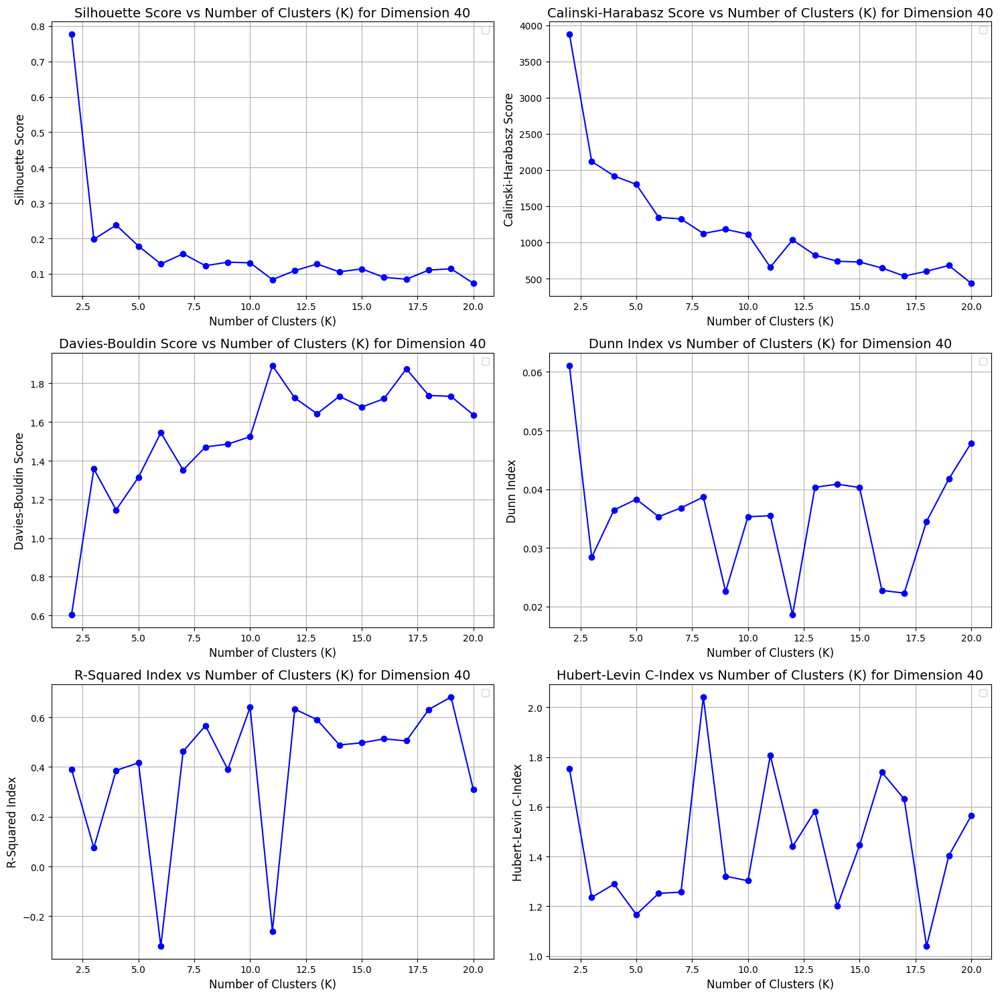

In [ ]:
import matplotlib.pyplot as plt

# Load the ranked clustering evaluation results from the CSV file
ranked_df = results_df
# List of metrics for plotting (updated to match the current column names)
metrics = [
    'Silhouette Score',
    'Calinski-Harabasz Score',
    'Davies-Bouldin Score',
    'Dunn Index',
    'R-Squared Index',
    'Hubert-Levin C-Index'
]

# Unique dimensions
dimensions = ranked_df['z_dim'].unique()

# Loop through each dimension and plot the metrics
for dim in dimensions:
    # Filter the data for the current dimension
    current_df = ranked_df[ranked_df['z_dim'] == dim]

    # Plot all metrics in a single grid layout for the current dimension
    fig, axs = plt.subplots(3, 2, figsize=(15, 15))  # 3 rows and 2 columns for 6 metrics

    # Flatten the axes for easier iteration
    axs = axs.flatten()

    # Plot each metric in a grid
    for i, metric in enumerate(metrics):
        axs[i].plot(current_df['n_clusters'], current_df[metric], marker='o', linestyle='-', color='b')

        # If there is an elbow method optimal cluster value for the current dimension, highlight it
        optimal_k = 27  # Replace with your logic to determine optimal_k for each dimension if applicable
        if optimal_k in current_df['n_clusters'].values:
            axs[i].axvline(x=optimal_k, color='r', linestyle='--', label='Elbow Method Optimal Cluster')
            axs[i].scatter(
                optimal_k,
                current_df[current_df['n_clusters'] == optimal_k][metric].values[0],
                color='red',
                s=100,
                zorder=5
            )

        axs[i].set_title(f'{metric} vs Number of Clusters (K) for Dimension {dim}', fontsize=14)
        axs[i].set_xlabel('Number of Clusters (K)', fontsize=12)
        axs[i].set_ylabel(metric, fontsize=12)
        axs[i].grid(True)

        # Add the legend to each subplot
        axs[i].legend()

    # Adjust layout to ensure everything fits
    plt.tight_layout()
    plt.show()


##Generate topographic maps

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from skimage.measure import block_reduce
import mne

'''
# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(name='clusters', shape=(self.n_clusters, input_dim), initializer='glorot_uniform')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q

# Define the custom loss layer
@tf.keras.utils.register_keras_serializable()  # Registering the custom layer for model saving and loading
class CustomLossLayer(Layer):
    def call(self, inputs):
        train_z, train_xr, train_x = inputs
        loss_mmd = self.compute_mmd(train_z, train_z)
        loss_nll = K.mean(K.square(train_xr - train_x))
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def compute_mmd(self, x, y):
        x_size = K.shape(x)[0]
        y_size = K.shape(y)[0]
        dim = K.shape(x)[1]
        tiled_x = K.tile(K.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
        tiled_y = K.tile(K.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
        return K.exp(-K.mean(K.square(tiled_x - tiled_y), axis=2) / K.cast(dim, 'float32'))

# Define the custom function
@tf.keras.utils.register_keras_serializable()  # Registering the custom function for model saving and loading
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps
'''
# Set up directories
base_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
os.makedirs(output_dir, exist_ok=True)

# Define parameters
dimensions = [40]  # Latent space dimensions
K_values = range(2, 21)  # Number of clusters
n_channels = 32  # EEG channels
batch_size = 20  # Batch size for processing clusters

# Set up MNE montage and info for EEG plotting
montage = mne.channels.make_standard_montage('biosemi32')  # Standard EEG montage
sfreq = 128  # Sampling frequency
ch_names = montage.ch_names[:n_channels]
ch_pos = montage.get_positions()['ch_pos']
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Define global min and max values
GLOBAL_MIN = -0.00020293263910059028
GLOBAL_MAX = 0.0005466895437634965

combined_dir = os.path.join(output_dir, "combined_maps")
os.makedirs(combined_dir, exist_ok=True)

# Loop through each model (z_dim, k)
for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCECv3_zdim_{z_dim}_nclusters_{k}'

        # Paths for saved data
        decoder_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_decoder.h5')  # Decoder model file
        centroids_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_cluster_centroids.npy')  # Adjust as needed

        # Check if all required files exist
        if not (os.path.exists(decoder_path) and os.path.exists(centroids_path)):
            print(f"Missing files for z_dim={z_dim}, k={k}. Skipping...")
            continue

        print(f"Processing z_dim={z_dim}, k={k}...")

        # Load decoder, latent space, and centroids
        with custom_object_scope({'ClusteringLayer': ClusteringLayer, 'CustomLossLayer': CustomLossLayer}):
            decoder = load_model(decoder_path, compile=False)
        cluster_centroids = np.load(centroids_path)
        num_maps = cluster_centroids.shape[0]
        print(f"Number of topographic maps that can be produced: {num_maps}")
        assert num_maps == k, f"Expected {k} centroids, but found {num_maps}."

        # Generate topographic maps for centroids
        topographic_maps_centroids = decoder.predict(cluster_centroids)

        # Create a figure with subplots for each cluster
        # Create a figure with subplots for each cluster
        fig, axes = plt.subplots(1, k, figsize=(k * 3, 3))  # Adjust figure size dynamically based on k
        fig.suptitle(f"Topographic Maps for z_dim={z_dim}, k={k}", fontsize=16)

        # Adjust the spacing between subplots
        plt.subplots_adjust(wspace=0.5, hspace=0.5)

        for cluster_idx, output_matrix in enumerate(topographic_maps_centroids):
            # Flatten and process the matrix
            flattened_map = output_matrix.flatten()
            if flattened_map.size != n_channels:
                flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

            rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
            data_for_mne = rescaled_map[:n_channels]
            data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
            evoked = mne.EvokedArray(data_for_mne, info)

            # Call plot_topomap and assign the result to im_map
            im_map, _ = mne.viz.plot_topomap(  # Assign the result to im_map
                data_for_mne.flatten(),
                pos=evoked.info,
                axes=axes[cluster_idx],
                show=False,
                cmap="jet",
            )
            axes[cluster_idx].set_title(f"Map {cluster_idx + 1}", fontsize=10)

        cbar_ax = fig.add_axes([0.92, 0.2, 0.02, 0.6])  # Add shared colorbar
        cbar = fig.colorbar(im_map, cax=cbar_ax)
        cbar.set_label("Value", fontsize=12)
        cbar.set_ticks([0, 0.5, 1])
        cbar.set_ticklabels([f"{GLOBAL_MIN:.8f}", f"{(GLOBAL_MIN + GLOBAL_MAX) / 2:.8f}", f"{GLOBAL_MAX:.8f}"])

        # Save the figure for later combination
        image_path = os.path.join(combined_dir, f"z_dim_{z_dim}_k_{k}.png")
        plt.savefig(image_path)
        plt.close(fig)  # Close the figure to save memory



Processing z_dim=40, k=2...
Number of topographic maps that can be produced: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
Processing z_dim=40, k=3...
Number of topographic maps that can be produced: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 388ms/step
Processing z_dim=40, k=4...
Number of topographic maps that can be produced: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 373ms/step
Processing z_dim=40, k=5...
Number of topographic maps that can be produced: 5


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
Processing z_dim=40, k=6...
Number of topographic maps that can be produced: 6


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
Processing z_dim=40, k=7...
Number of topographic maps that can be produced: 7
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Processing z_dim=40, k=8...
Number of topographic maps that can be produced: 8
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 361ms/step
Processing z_dim=40, k=9...
Number of topographic maps that can be produced: 9
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 370ms/step
Processing z_dim=40, k=10...
Number of topographic maps that can be produced: 10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 350ms/step
Processing z_dim=40, k=11...
Number of topographic maps that can be produced: 11
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 378ms/step
Processing z_dim=40, k=12...
Number of topographic maps that can be produced: 12
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step
Processing z_dim=40, k=13...
Number of topographic maps that can be produced: 13
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
Processing z_dim=40, k=14...
Number of topographic maps that can be produced: 14
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 338ms/step
Process

## Combination of outputs

In [ ]:
from PIL import Image
import os

# Directory where the individual images are saved
combined_dir = "/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/combined_maps"  # Replace with alternative directory for testing
output_image_path = "/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/v3_final_combined_topographic_maps.png"

# Get the list of image files sorted by k (ascending order)
image_files = sorted(
    [os.path.join(combined_dir, f) for f in os.listdir(combined_dir) if f.endswith(".png")],
    key=lambda x: int(x.split("_k_")[1].split(".png")[0])  # Extract k from filenames
)

# Open all images
images = [Image.open(img) for img in image_files]

# Determine the dimensions for consistent image size (based on k=20)
max_width = max(img.width for img in images)
max_height = max(img.height for img in images)

# Resize all images to the max dimensions while keeping aspect ratio
standardized_images = []
for img in images:
    img_aspect = img.width / img.height
    max_aspect = max_width / max_height

    # Adjust dimensions to maintain aspect ratio
    if img_aspect > max_aspect:
        new_width = max_width
        new_height = int(max_width / img_aspect)
    else:
        new_height = max_height
        new_width = int(max_height * img_aspect)

    # Resize the image
    resized_img = img.resize((new_width, new_height), Image.Resampling.LANCZOS)

    # Add padding to match max dimensions
    padded_img = Image.new("RGB", (max_width, max_height), (255, 255, 255))  # White background
    padded_img.paste(resized_img, ((max_width - new_width) // 2, (max_height - new_height) // 2))
    standardized_images.append(padded_img)

# Calculate the total height for vertical stacking
total_height = sum(img.height for img in standardized_images)

# Create a blank image with the total width and height
combined_image = Image.new("RGB", (max_width, total_height))

# Paste each image into the combined image
y_offset = 0
for img in standardized_images:
    combined_image.paste(img, (0, y_offset))
    y_offset += img.height

# Save the final combined image
combined_image.save(output_image_path)
print(f"Final combined image saved at {output_image_path}")

Final combined image saved at /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC/v3_final_combined_topographic_maps.png


#### Single K value

##Get Decoder

In [ ]:
from tensorflow.keras.models import load_model, Model
from tensorflow.keras.layers import Input, Dense, Conv2DTranspose, Reshape, LeakyReLU
from tensorflow.keras.utils import custom_object_scope
import os
import numpy as np
import tensorflow.keras.backend as K

# Define ClusteringLayer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(name='clusters', shape=(self.n_clusters, input_dim), initializer='glorot_uniform')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs, **kwargs):
        q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
        return q
'''
# Define the custom loss layer
@tf.keras.utils.register_keras_serializable()  # Registering the custom layer for model saving and loading
class CustomLossLayer(Layer):
    def call(self, inputs):
        train_z, train_xr, train_x = inputs
        loss_mmd = self.compute_mmd(train_z, train_z)
        loss_nll = K.mean(K.square(train_xr - train_x))
        self.add_loss(loss_mmd + loss_nll)
        return train_xr

    def compute_mmd(self, x, y):
        x_size = K.shape(x)[0]
        y_size = K.shape(y)[0]
        dim = K.shape(x)[1]
        tiled_x = K.tile(K.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
        tiled_y = K.tile(K.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
        return K.exp(-K.mean(K.square(tiled_x - tiled_y), axis=2) / K.cast(dim, 'float32'))
'''
# Define the custom function
@tf.keras.utils.register_keras_serializable()  # Registering the custom function for model saving and loading
def compute_latent(x):
    mu, sigma = x
    batch = K.shape(mu)[0]
    dim = K.int_shape(mu)[1]
    eps = K.random_normal(shape=(batch, dim), mean=0., stddev=1.)
    return mu + K.exp(sigma) * eps


# Decoder architecture definition
def build_decoder(z_dim, raw_shape):
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    return decoder

# Iterate over dimensions and k values to save decoders
dimensions = [40]  # Latent space dimensions
K_values = range(2, 21)  # Cluster values
raw_shape = dataNormReshape  # Input shape (replace with your raw input dimensions)

base_model_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'

for z_dim in dimensions:
    for k in K_values:
        model_file_path1 = f'{base_model_dir}/DCEC_zdim_{z_dim}_nclusters_{k}.h5'
        decoder_save_path = f'{base_model_dir}/DECODER_zdim_{z_dim}_nclusters_{k}.h5'

        if os.path.exists(model_file_path1):
            print(f"Processing model: dim={z_dim}, k={k}")

            # Load the saved model
            with custom_object_scope({'ClusteringLayer': ClusteringLayer, 'compute_latent': compute_latent}):
                dcec_load_model = load_model(model_file_path1, compile=False)

            # Build the decoder
            decoder = build_decoder(z_dim, raw_shape)

            # Load the weights into the decoder
            for layer in decoder.layers:
                try:
                    layer.set_weights(dcec_load_model.get_layer(layer.name).get_weights())
                except ValueError:
                    pass

            # Save the decoder
            decoder.save(decoder_save_path)
            print(f"Saved decoder for z_dim={z_dim}, k={k} at {decoder_save_path}")
        else:
            print(f"Model file not found: {model_file_path1}")


Processing model: dim=40, k=2


ValueError: Unknown layer: 'Custom>CustomLossLayer'. Please ensure you are using a `keras.utils.custom_object_scope` and that this object is included in the scope. See https://www.tensorflow.org/guide/keras/save_and_serialize#registering_the_custom_object for details.

### Ranked Table

In [ ]:
import pandas as pd

# Load the clustering evaluation results from the CSV file
csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/clustering_metrics_table1.csv'
df = pd.read_csv(csv_file_path)

# Rank the results based on each of the metrics
ranked_df = df.copy()
metrics_to_rank = ['Silhouette Index', 'Calinski-Harabasz Index', 'Davies-Bouldin Index', 'Dunn Index', 'R-Squared Index', 'Hubert-Levin C-Index']

# Assign rankings to each metric (higher values are better, except for Davies-Bouldin Index and C-Index)
for metric in metrics_to_rank:
    if metric in ['Davies-Bouldin Index', 'Hubert-Levin C-Index']:
        ranked_df[f'{metric} Rank'] = ranked_df[metric].rank(ascending=True)
    else:
        ranked_df[f'{metric} Rank'] = ranked_df[metric].rank(ascending=False)

# Save the ranked table to a new CSV file
ranked_csv_file_path = '/content/drive/MyDrive/Masters Dataset/DCEC/ranked_clustering_metrics_table1.csv'
ranked_df.to_csv(ranked_csv_file_path, index=False)

# Display the ranked DataFrame
print(ranked_df.head())


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/Masters Dataset/DCEC/clustering_metrics_table1.csv'

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from skimage.measure import block_reduce
import mne

# Set up directories
# for testing /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/Clustering Loss
# # for testing /content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC

base_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/Learning rates/DCEC'
os.makedirs(output_dir, exist_ok=True)

# Define parameters
dimensions = [40]  # Latent space dimensions
K_values = [20]  # Number of clusters
n_channels = 32  # EEG channels
batch_size = 20  # Batch size for processing clusters

# Set up MNE montage and info for EEG plotting
montage = mne.channels.make_standard_montage('biosemi32')  # Standard EEG montage
sfreq = 128  # Sampling frequency
ch_names = montage.ch_names[:n_channels]
ch_pos = montage.get_positions()['ch_pos']
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Define global min and max values
GLOBAL_MIN = -0.00020293263910059028
GLOBAL_MAX = 0.0005466895437634965

combined_dir = os.path.join(output_dir, "combined_maps")
os.makedirs(combined_dir, exist_ok=True)

# Loop through each model (z_dim, k)
for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

        # Paths for saved data
        decoder_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_decoder.h5')  # Decoder model file
        centroids_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_cluster_centroids.npy')  # Adjust as needed

        # Check if all required files exist
        if not (os.path.exists(decoder_path) and os.path.exists(centroids_path)):
            print(f"Missing files for z_dim={z_dim}, k={k}. Skipping...")
            continue

        print(f"Processing z_dim={z_dim}, k={k}...")

        # Load decoder, latent space, and centroids
        with custom_object_scope({'ClusteringLayer': ClusteringLayer, 'CustomLossLayer': CustomLossLayer}):
            decoder = load_model(decoder_path, compile=False)
        cluster_centroids = np.load(centroids_path)
        num_maps = cluster_centroids.shape[0]
        print(f"Number of topographic maps that can be produced: {num_maps}")
        assert num_maps == k, f"Expected {k} centroids, but found {num_maps}."

        # Generate topographic maps for centroids
        topographic_maps_centroids = decoder.predict(cluster_centroids)

        # Create a figure with subplots for each cluster
        # Create a figure with subplots for each cluster
        fig, axes = plt.subplots(1, k, figsize=(k * 3, 3))  # Adjust figure size dynamically based on k
        fig.suptitle(f"Topographic Maps for z_dim={z_dim}, k={k}", fontsize=16)

        # Adjust the spacing between subplots
        plt.subplots_adjust(wspace=0.5, hspace=0.5)

        for cluster_idx, output_matrix in enumerate(topographic_maps_centroids):
            # Flatten and process the matrix
            flattened_map = output_matrix.flatten()
            if flattened_map.size != n_channels:
                flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

            rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
            data_for_mne = rescaled_map[:n_channels]
            data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
            evoked = mne.EvokedArray(data_for_mne, info)

            # Call plot_topomap and assign the result to im_map
            im_map, _ = mne.viz.plot_topomap(  # Assign the result to im_map
                data_for_mne.flatten(),
                pos=evoked.info,
                axes=axes[cluster_idx],
                show=False,
                cmap="jet",
            )
            axes[cluster_idx].set_title(f"Map {cluster_idx + 1}", fontsize=10)

        cbar_ax = fig.add_axes([0.92, 0.2, 0.02, 0.6])  # Add shared colorbar
        cbar = fig.colorbar(im_map, cax=cbar_ax)
        cbar.set_label("Value", fontsize=12)
        cbar.set_ticks([0, 0.5, 1])
        cbar.set_ticklabels([f"{GLOBAL_MIN:.8f}", f"{(GLOBAL_MIN + GLOBAL_MAX) / 2:.8f}", f"{GLOBAL_MAX:.8f}"])

        # Save the figure for later combination
        image_path = os.path.join(combined_dir, f"z_dim_{z_dim}_k_{k}_15.png")
        plt.savefig(image_path)
        plt.close(fig)  # Close the figure to save memory



Processing z_dim=40, k=20...
Number of topographic maps that can be produced: 20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


### Generate 500 maps from a K value

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
import matplotlib.pyplot as plt
import mne
from skimage.measure import block_reduce

# Define directories
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/random_maps_k2'
os.makedirs(output_dir, exist_ok=True)

# Parameters
z_dim = 40  # Latent space dimension
k = 2       # Number of clusters
num_maps = 500  # Total maps to generate
maps_per_centroid = num_maps // k  # Maps per centroid
n_channels = 32  # EEG channels

# Set up MNE montage and info
montage = mne.channels.make_standard_montage('biosemi32')  # Standard EEG montage
sfreq = 128  # Sampling frequency
ch_names = montage.ch_names[:n_channels]
ch_pos = montage.get_positions()['ch_pos']
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Load decoder
model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
decoder_path = os.path.join(save_dir, f'{model_name}_decoder.h5')
clustering_weights_path = os.path.join(save_dir, f'{model_name}_clustering_weights.npy')

if not (os.path.exists(decoder_path) and os.path.exists(clustering_weights_path)):
    raise FileNotFoundError("Required files not found. Ensure decoder and clustering weights exist.")

with custom_object_scope({'ClusteringLayer': ClusteringLayer}):
    decoder = load_model(decoder_path, compile=False)

# Load cluster centroids
clustering_weights = np.load(clustering_weights_path)  # Shape: (1, k, z_dim)
centroids = clustering_weights[0]  # Remove extra dimension, shape: (k, z_dim)

# Generate maps
for cluster_idx, centroid in enumerate(centroids):
    print(f"Generating maps for centroid {cluster_idx}...")

    # Sample random latent vectors around the centroid
    random_latent_vectors = centroid + np.random.normal(
        loc=0, scale=0.1, size=(maps_per_centroid, z_dim)  # Adjust `scale` for noise level
    )

    # Decode latent vectors into topographic maps
    random_maps = decoder.predict(random_latent_vectors, batch_size=20)

    for i, output_matrix in enumerate(random_maps):
        # Flatten and process the matrix
        flattened_map = output_matrix.flatten()
        if flattened_map.size != n_channels:
            flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

        rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
        data_for_mne = rescaled_map[:n_channels]
        data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
        evoked = mne.EvokedArray(data_for_mne, info)

        # Create a figure for the topomap
        fig, ax = plt.subplots(figsize=(5, 5))
        im_map, _ = mne.viz.plot_topomap(
            data_for_mne.flatten(),
            pos=evoked.info,
            axes=ax,
            show=False,
            cmap="jet",
        )
        ax.set_title(f"Cluster {cluster_idx}, Map {i + 1}", fontsize=10)

        # Save the figure
        map_path = os.path.join(output_dir, f'cluster_{cluster_idx}_map_{i + 1}.png')
        plt.savefig(map_path)
        plt.close(fig)

print(f"Maps saved to {output_dir}")


Generating maps for cluster 0...
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Generating maps for cluster 1...
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
Maps saved to /content/drive/MyDrive/Masters Dataset/DCEC/random_maps_k2


### Alternative

In [ ]:
import os
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope

# Define directories
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
latent_space_save_path = os.path.join(save_dir, f'{model_name}_latent_space.npy')

# Load encoder
encoder_path = os.path.join(save_dir, f'{model_name}_encoder.h5')
if not os.path.exists(encoder_path):
    raise FileNotFoundError(f"Encoder model not found at {encoder_path}")

with custom_object_scope({'ClusteringLayer': ClusteringLayer}):
    encoder = load_model(encoder_path, compile=False)

# Compute latent space
latent_space = encoder.predict(data_train)[2]  # Use the correct encoder output (e.g., [2] for latent space)

# Save latent space
np.save(latent_space_save_path, latent_space)
print(f"Latent space saved to {latent_space_save_path}")


538/538 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
Latent space saved to /content/drive/MyDrive/Masters Dataset/DCEC/DCEC_zdim_40_nclusters_2_latent_space.npy


In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
import matplotlib.pyplot as plt
import mne
from skimage.measure import block_reduce

# Define directories
save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/random_maps_k2_v2'
os.makedirs(output_dir, exist_ok=True)

# Parameters
z_dim = 40  # Latent space dimension
k = 2       # Number of clusters
n_channels = 32  # EEG channels

# Set up MNE montage and info
montage = mne.channels.make_standard_montage('biosemi32')  # Standard EEG montage
sfreq = 128  # Sampling frequency
ch_names = montage.ch_names[:n_channels]
ch_pos = montage.get_positions()['ch_pos']
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Load decoder and cluster assignments
model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'
decoder_path = os.path.join(save_dir, f'{model_name}_decoder.h5')
cluster_assignments_path = os.path.join(save_dir, f'{model_name}_cluster_assignments.npy')
latent_space_path = os.path.join(save_dir, f'{model_name}_latent_space.npy')

if not (os.path.exists(decoder_path) and os.path.exists(cluster_assignments_path) and os.path.exists(latent_space_path)):
    raise FileNotFoundError("Required files not found. Ensure decoder, cluster assignments, and latent space exist.")

with custom_object_scope({'ClusteringLayer': ClusteringLayer}):
    decoder = load_model(decoder_path, compile=False)

# Load cluster assignments and latent space
cluster_assignments = np.load(cluster_assignments_path)  # Shape: (num_samples,)
latent_space = np.load(latent_space_path)  # Shape: (num_samples, z_dim)

# Validate shapes
assert len(cluster_assignments) == latent_space.shape[0], "Mismatch in cluster assignments and latent space."

# Aggregate latent vectors per cluster
aggregated_latent_vectors = []
for cluster_idx in range(k):
    cluster_data = latent_space[cluster_assignments == cluster_idx]  # Get all latent vectors for this cluster
    if len(cluster_data) > 0:
        aggregated_latent_vectors.append(np.mean(cluster_data, axis=0))  # Compute mean latent vector
    else:
        print(f"Cluster {cluster_idx} has no assigned points.")
        aggregated_latent_vectors.append(np.zeros(z_dim))  # Handle empty clusters gracefully

aggregated_latent_vectors = np.array(aggregated_latent_vectors)  # Shape: (k, z_dim)

# Decode aggregated latent vectors into topographic maps
aggregated_maps = decoder.predict(aggregated_latent_vectors)

# Save maps
for cluster_idx, output_matrix in enumerate(aggregated_maps):
    # Flatten and process the matrix
    flattened_map = output_matrix.flatten()
    if flattened_map.size != n_channels:
        flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

    rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
    data_for_mne = rescaled_map[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
    evoked = mne.EvokedArray(data_for_mne, info)

    # Create a figure for the topomap
    fig, ax = plt.subplots(figsize=(5, 5))
    im_map, _ = mne.viz.plot_topomap(
        data_for_mne.flatten(),
        pos=evoked.info,
        axes=ax,
        show=False,
        cmap="jet",
    )
    ax.set_title(f"Cluster {cluster_idx}, Aggregated Map", fontsize=10)

    # Save the figure
    map_path = os.path.join(output_dir, f'aggregated_cluster_{cluster_idx}.png')
    plt.savefig(map_path)
    plt.close(fig)

print(f"Aggregated maps saved to {output_dir}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
Aggregated maps saved to /content/drive/MyDrive/Masters Dataset/DCEC/random_maps_k2_v2


## V2 Topo maps

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from skimage.measure import block_reduce
import mne

# Set up directories
base_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
os.makedirs(output_dir, exist_ok=True)

# Define parameters
dimensions = [40]  # Latent space dimensions
K_values = range(2, 21)  # Number of clusters
n_channels = 32  # EEG channels
batch_size = 20  # Batch size for processing clusters

# Set up MNE montage and info for EEG plotting
montage = mne.channels.make_standard_montage('biosemi32')  # Standard EEG montage
sfreq = 128  # Sampling frequency
ch_names = montage.ch_names[:n_channels]
ch_pos = montage.get_positions()['ch_pos']
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Define global min and max values
GLOBAL_MIN = -0.00020293263910059028
GLOBAL_MAX = 0.0005466895437634965

combined_dir = os.path.join(output_dir, "combined_maps")
os.makedirs(combined_dir, exist_ok=True)

# Loop through each model (z_dim, k)
for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

        # Paths for saved data
        decoder_path = os.path.join(base_dir, f'DECODER_zdim_{z_dim}_nclusters_{k}.h5')  # Decoder model file
        centroids_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_cluster_centroids.npz')  # Adjust as needed

        # Check if all required files exist
        if not (os.path.exists(decoder_path) and os.path.exists(centroids_path)):
            print(f"Missing files for z_dim={z_dim}, k={k}. Skipping...")
            continue

        print(f"Processing z_dim={z_dim}, k={k}...")

        # Load decoder, latent space, and centroids
        with custom_object_scope({'GaussianClusteringLayer': GaussianClusteringLayer, 'CustomLossLayer': CustomLossLayer}):
            decoder = load_model(decoder_path, compile=False)
        centroids_data = np.load(centroids_path)
        cluster_means = centroids_data['means']
        cluster_centroids = cluster_means
        num_maps = cluster_centroids.shape[0]
        print(f"Number of topographic maps that can be produced: {num_maps}")
        assert num_maps == k, f"Expected {k} centroids, but found {num_maps}."

        # Generate topographic maps for centroids
        topographic_maps_centroids = decoder.predict(cluster_centroids)

        # Create a figure with subplots for each cluster
        # Create a figure with subplots for each cluster
        fig, axes = plt.subplots(1, k, figsize=(k * 3, 3))  # Adjust figure size dynamically based on k
        fig.suptitle(f"Topographic Maps for z_dim={z_dim}, k={k}", fontsize=16)

        # Adjust the spacing between subplots
        plt.subplots_adjust(wspace=0.5, hspace=0.5)

        for cluster_idx, output_matrix in enumerate(topographic_maps_centroids):
            # Flatten and process the matrix
            flattened_map = output_matrix.flatten()
            if flattened_map.size != n_channels:
                flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

            rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
            data_for_mne = rescaled_map[:n_channels]
            data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension
            evoked = mne.EvokedArray(data_for_mne, info)

            # Call plot_topomap and assign the result to im_map
            im_map, _ = mne.viz.plot_topomap(  # Assign the result to im_map
                data_for_mne.flatten(),
                pos=evoked.info,
                axes=axes[cluster_idx],
                show=False,
                cmap="jet",
            )
            axes[cluster_idx].set_title(f"Map {cluster_idx + 1}", fontsize=10)

        cbar_ax = fig.add_axes([0.92, 0.2, 0.02, 0.6])  # Add shared colorbar
        cbar = fig.colorbar(im_map, cax=cbar_ax)
        cbar.set_label("Value", fontsize=12)
        cbar.set_ticks([0, 0.5, 1])
        cbar.set_ticklabels([f"{GLOBAL_MIN:.8f}", f"{(GLOBAL_MIN + GLOBAL_MAX) / 2:.8f}", f"{GLOBAL_MAX:.8f}"])

        # Save the figure for later combination
        image_path = os.path.join(combined_dir, f"z_dim_{z_dim}_k_{k}.png")
        plt.savefig(image_path)
        plt.close(fig)  # Close the figure to save memory



Processing z_dim=40, k=2...
Number of topographic maps that can be produced: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Processing z_dim=40, k=3...
Number of topographic maps that can be produced: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
Processing z_dim=40, k=4...
Number of topographic maps that can be produced: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step
Processing z_dim=40, k=5...
Number of topographic maps that can be produced: 5


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
Processing z_dim=40, k=6...
Number of topographic maps that can be produced: 6


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Processing z_dim=40, k=7...
Number of topographic maps that can be produced: 7
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 359ms/step
Processing z_dim=40, k=8...
Number of topographic maps that can be produced: 8
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 351ms/step
Processing z_dim=40, k=9...
Number of topographic maps that can be produced: 9
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step
Processing z_dim=40, k=10...
Number of topographic maps that can be produced: 10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
Processing z_dim=40, k=11...
Number of topographic maps that can be produced: 11
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 357ms/step
Processing z_dim=40, k=12...
Number of topographic maps that can be produced: 12
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
Processing z_dim=40, k=13...
Number of topographic maps that can be produced: 13
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 365ms/step
Processing z_dim=40, k=14...
Number of topographic maps that can be produced: 14
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
Process

##Generating 500 maps from a K value

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import custom_object_scope
from skimage.measure import block_reduce
from PIL import Image  # Use Pillow for image saving
import mne

# Parameters
num_maps_to_generate = 500  # Total number of maps to generate
k = 10  # Number of clusters
z_dim = 40  # Latent space dimension
n_channels = 32  # EEG channels

# Set up directories
base_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
output_dir = '/content/drive/MyDrive/Masters Dataset/DCEC/random_maps'
os.makedirs(output_dir, exist_ok=True)

# Set up MNE montage
montage = mne.channels.make_standard_montage('biosemi32')
sfreq = 128
ch_names = montage.ch_names[:n_channels]
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')
info.set_montage(montage)

# Define global min and max values
GLOBAL_MIN = -0.00020293263910059028
GLOBAL_MAX = 0.0005466895437634965

# Paths for saved data
decoder_path = os.path.join(base_dir, f'DECODER_zdim_{z_dim}_nclusters_{k}.h5')
centroids_path = os.path.join(base_dir, f'DCEC_zdim_{z_dim}_nclusters_{k}_cluster_centroids.npz')

# Check if required files exist
if not (os.path.exists(decoder_path) and os.path.exists(centroids_path)):
    raise FileNotFoundError("Required decoder or centroids file is missing.")

# Load decoder and centroids
with custom_object_scope({'GaussianClusteringLayer': GaussianClusteringLayer, 'CustomLossLayer': CustomLossLayer}):
    decoder = load_model(decoder_path, compile=False)
centroids_data = np.load(centroids_path)
cluster_centroids = centroids_data['means']

# Ensure correct number of centroids
assert cluster_centroids.shape[0] == k, f"Expected {k} centroids, but found {cluster_centroids.shape[0]}."

# Generate 500 maps
map_counter = 1
while map_counter <= num_maps_to_generate:
    # Randomly pick one centroid from the k centroids
    selected_centroid = cluster_centroids[np.random.randint(0, k)]

    # Optionally add small perturbation to the centroid to introduce variability
    # Uncomment the next line to enable perturbation
    # selected_centroid += np.random.normal(scale=0.01, size=selected_centroid.shape)

    # Generate topographic map
    topographic_map = decoder.predict(np.expand_dims(selected_centroid, axis=0))[0]
    flattened_map = topographic_map.flatten()
    if flattened_map.size != n_channels:
        flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

    rescaled_map = (flattened_map - flattened_map.min()) / (flattened_map.max() - flattened_map.min() + 1e-10)
    data_for_mne = rescaled_map[:n_channels]


    # Plot topographic map
    fig, ax = plt.subplots(figsize=(4, 4))
    im_map, _ = mne.viz.plot_topomap(
        data_for_mne.flatten(),
        pos=evoked.info,
        axes=ax,
        show=False,
        cmap="jet",
    )
    ax.set_title(f"Map {map_counter}", fontsize=10)

    # Add colorbar
    cbar_ax = fig.add_axes([0.92, 0.2, 0.02, 0.6])
    cbar = fig.colorbar(im_map, cax=cbar_ax)
    cbar.set_label("Value", fontsize=12)
    cbar.set_ticks([0, 0.5, 1])
    cbar.set_ticklabels([f"{GLOBAL_MIN:.8f}", f"{(GLOBAL_MIN + GLOBAL_MAX) / 2:.8f}", f"{GLOBAL_MAX:.8f}"])

    # Save map
    image_path = os.path.join(output_dir, f"random_map_{map_counter}.png")
    plt.savefig(image_path)
    plt.close(fig)

    print(f"Saved map {map_counter} at {image_path}")
    map_counter += 1


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
Saved map 1 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_1.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Saved map 2 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_2.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Saved map 3 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_3.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Saved map 4 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_4.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Saved map 5 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_5.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Saved map 6 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_6.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Saved map 7 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_map_7.png
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Saved map 8 at /content/drive/MyDrive/Masters Dataset/DCEC/random_maps/random_m

In [ ]:
# Loop through each model (z_dim, k)
for z_dim in dimensions:
    for k in K_values:
        model_name = f'DCEC_zdim_{z_dim}_nclusters_{k}'

        # Paths for saved data
        decoder_path = os.path.join(base_dir, f'DECODER_zdim_{z_dim}_nclusters_{k}.h5')  # Decoder model file
        centroids_path = os.path.join(base_dir, f'{model_name}_cluster_centroids.npy')

        # Check if files exist
        if not (os.path.exists(decoder_path) and os.path.exists(centroids_path)):
            print(f"Missing files for z_dim={z_dim}, k={k}. Skipping...")
            continue

        print(f"Processing z_dim={z_dim}, k={k}...")

        # Load decoder and centroids
        with custom_object_scope({'ClusteringLayer': ClusteringLayer, 'CustomLossLayer': CustomLossLayer}):
            decoder = load_model(decoder_path, compile=False)
        cluster_centroids = np.load(centroids_path)

        # Run centroids through the decoder
        decoded_outputs = decoder.predict(cluster_centroids)

        # Print the decoder outputs
        print(f"Decoder outputs for z_dim={z_dim}, k={k}:")
        print(decoded_outputs)

        # Save the outputs to a file for inspection
        output_path = os.path.join(output_dir, f"decoder_outputs_zdim_{z_dim}_k_{k}.npy")
        np.save(output_path, decoded_outputs)
        print(f"Decoder outputs saved to: {output_path}")


Streaming output truncated to the last 5000 lines.
   [0.49984735]
   [0.5000589 ]
   [0.49990156]]

  ...

  [[0.500042  ]
   [0.5000509 ]
   [0.4998516 ]
   ...
   [0.50030947]
   [0.5000769 ]
   [0.50005454]]

  [[0.500172  ]
   [0.4999783 ]
   [0.5001652 ]
   ...
   [0.4997427 ]
   [0.5000165 ]
   [0.49991086]]

  [[0.50000846]
   [0.4998047 ]
   [0.4999392 ]
   ...
   [0.50009006]
   [0.4999954 ]
   [0.5000592 ]]]


 [[[0.5001533 ]
   [0.49980065]
   [0.49974823]
   ...
   [0.49978307]
   [0.5001339 ]
   [0.4998727 ]]

  [[0.49990216]
   [0.4999773 ]
   [0.49956754]
   ...
   [0.49974132]
   [0.49972692]
   [0.5001411 ]]

  [[0.5001817 ]
   [0.500102  ]
   [0.5001792 ]
   ...
   [0.49935222]
   [0.50004935]
   [0.50007623]]

  ...

  [[0.5001303 ]
   [0.5002236 ]
   [0.50064033]
   ...
   [0.5001343 ]
   [0.49971893]
   [0.50005823]]

  [[0.5003379 ]
   [0.49974918]
   [0.5005635 ]
   ...
   [0.50011206]
   [0.50016814]
   [0.4998147 ]]

  [[0.49996805]
   [0.500077  ]
   [0.49988

In [ ]:
for cluster_idx, output_matrix in enumerate(topographic_maps_centroids):
    # Flatten and reduce the matrix to 32 values (for 32 EEG channels)
    flattened_map = output_matrix.flatten()
    if flattened_map.size != n_channels:
        flattened_map = block_reduce(flattened_map, block_size=(int(flattened_map.size // n_channels),), func=np.mean)

    # Normalize to global min-max
    rescaled_map = (flattened_map - GLOBAL_MIN) / (GLOBAL_MAX - GLOBAL_MIN + 1e-10)

    # Print debug information
    print(f"Cluster {cluster_idx + 1} - Rescaled map values:")
    print(rescaled_map)
    print(f"Cluster {cluster_idx + 1} - Min: {rescaled_map.min()}, Max: {rescaled_map.max()}")

    # Prepare the data for MNE
    data_for_mne = rescaled_map[:n_channels]
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension

    # Create an EvokedArray for plotting
    evoked = mne.EvokedArray(data_for_mne, info)

    # Plot topographic map in the current subplot
    mne.viz.plot_topomap(data_for_mne.flatten(), pos=evoked.info, axes=axes[cluster_idx], show=False, cmap='jet')
    axes[cluster_idx].set_title(f"Cluster {cluster_idx + 1}")


Cluster 1 - Rescaled map values:
[667.20844 667.07007 667.1441  667.26416 666.95044 667.2462  667.06213
 667.0115  667.1623  667.2217  666.9705  667.2072  667.183   667.00757
 667.22577 667.2357  667.14777 667.0611  667.21155 667.0296  666.95135
 667.3396  667.11395 666.90576 667.4183  667.2647  666.9496  667.30615
 667.22003 667.1469  667.3918  667.251  ]
Cluster 1 - Min: 666.90576171875, Max: 667.4182739257812
Cluster 2 - Rescaled map values:
[667.2332  667.17694 667.1804  667.2777  667.0925  667.1713  667.2364
 667.1016  667.25775 667.30457 667.15015 667.2817  667.24725 667.1286
 667.25946 667.22656 667.23004 667.1868  667.23047 667.22656 667.17554
 667.30115 667.1919  667.13275 667.3411  667.22455 667.15753 667.27026
 667.2576  667.22925 667.28326 667.28125]
Cluster 2 - Min: 667.092529296875, Max: 667.3411254882812
Cluster 3 - Rescaled map values:
[667.2342  667.2009  667.2166  667.3049  667.1657  667.2446  667.2281
 667.1348  667.2768  667.2796  667.14984 667.27124 667.24786 667.2

In [ ]:
print(f"Cluster {cluster_idx + 1} - Rescaled map (forced global range):")
print(rescaled_map)
print(f"Cluster {cluster_idx + 1} - Min: {rescaled_map.min()}, Max: {rescaled_map.max()}")


Cluster 9 - Rescaled map (forced global range):
[0.41890427 0.2713211  0.2875402  0.79269576 0.19548866 0.45542413
 0.7967774  0.1276047  0.7278193  0.5020407  0.25155738 0.609452
 0.31578937 0.7828139  0.46960244 0.20042959 0.7830288  0.3037593
 0.3121374  0.9999997  0.05145004 0.6867882  0.6214821  0.
 0.62534887 0.5168634  0.33340484 0.64683115 0.3035445  0.6272823
 0.64704597 0.48421037]
Cluster 9 - Min: 0.0, Max: 0.9999997019767761


#topo map test

In [ ]:
for cluster_idx, output_matrix in enumerate(topographic_maps_centroids):
    # Assume the decoder output is already in a usable format for topographic visualization
    data_for_mne = np.array(output_matrix[:n_channels])[:n_channels]  # First 32 channels
    data_for_mne = np.expand_dims(data_for_mne, axis=1)  # Add the time dimension

    # Plot the topographic map directly
    evoked = mne.EvokedArray(data_for_mne, info)
    fig, ax = plt.subplots(figsize=(6, 6))
    mne.viz.plot_topomap(data_for_mne.flatten(), pos=evoked.info, axes=ax, show=False, cmap="jet")
    plt.title(f"Cluster {cluster_idx + 1}")
    plt.show()


ValueError: Data must be a 2D array of shape (n_channels, n_samples), got shape (32, 1, 40, 1)

## Attempt 2


In [ ]:
# Install necessary packages (if any missing)
# !pip install tensorflow scikit-learn matplotlib

# Import necessary libraries
from time import time
import numpy as np
import tensorflow as tf
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Dense, Conv2D, Conv2DTranspose, Flatten, Reshape, Lambda, Layer
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import CSVLogger
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, normalized_mutual_info_score, adjusted_rand_score
from sklearn.cluster import KMeans
from scipy import stats
import os


save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'
base_save_dir = '/content/drive/MyDrive/Masters Dataset/DCEC'


# Load and preprocess your data
# Replace 'listOfTopographicMapsForAE' with your actual data
raw = listOfTopographicMapsForAE  # Your data variable here

# Normalize the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

# Split the data
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15
data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=test_ratio / (test_ratio + val_ratio), random_state=42, shuffle=True)

# Remove outliers from training data
data_train_flat = data_train.reshape(data_train.shape[0], -1)
z_scores = np.abs(stats.zscore(data_train_flat, axis=0))
threshold = 3
outliers = np.where(z_scores > threshold)
filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
data_train_filtered = data_train[filtered_indices]

# Use filtered training data
x = data_train_filtered
y = None  # If labels are not available

# Define MMD Functions
def compute_kernel(x, y):
    x_size = tf.shape(x)[0]
    y_size = tf.shape(y)[0]
    dim = tf.shape(x)[1]
    tiled_x = tf.tile(tf.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
    tiled_y = tf.tile(tf.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
    return tf.exp(-tf.reduce_mean(tf.square(tiled_x - tiled_y), axis=2) / tf.cast(dim, 'float32'))

def compute_mmd(x, y):
    x_kernel = compute_kernel(x, x)
    y_kernel = compute_kernel(y, y)
    xy_kernel = compute_kernel(x, y)
    return tf.reduce_mean(x_kernel) + tf.reduce_mean(y_kernel) - 2 * tf.reduce_mean(xy_kernel)

# Define Custom Loss Layer
@tf.keras.utils.register_keras_serializable()
class CustomLossLayer(tf.keras.layers.Layer):
    def call(self, inputs):
        z, x_reconstructed, x_input = inputs
        # Sample from the prior distribution
        prior_z = tf.random.normal(tf.shape(z))
        # Compute MMD between z and prior_z
        loss_mmd = compute_mmd(z, prior_z)
        loss_nll = tf.reduce_mean(tf.square(x_reconstructed - x_input))
        self.add_loss(loss_mmd + loss_nll)
        return x_reconstructed

    def compute_output_shape(self, input_shape):
        return input_shape[1]

# Define the VAE Model
def create_conv_variational_autoencoder(input_shape, latent_dim):
    # Encoder
    inputs = Input(shape=input_shape)
    x = Conv2D(32, 3, activation='relu', padding='same')(inputs)
    x = Conv2D(64, 3, activation='relu', padding='same')(x)
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)

    # Mean and log variance for the latent space
    mu = Dense(latent_dim, name='mu')(x)
    log_sigma = Dense(latent_dim, name='log_sigma')(x)

    # Sampling function
    def sampling(args):
        mu, log_sigma = args
        epsilon = K.random_normal(shape=K.shape(mu), mean=0., stddev=1.)
        return mu + K.exp(log_sigma / 2) * epsilon

    # Latent space
    z = Lambda(sampling, output_shape=(latent_dim,), name='z')([mu, log_sigma])

    # Decoder
    x = Dense(128, activation='relu')(z)
    x = Dense(np.prod(input_shape), activation='relu')(x)
    x = Reshape(input_shape)(x)
    x = Conv2DTranspose(64, 3, activation='relu', padding='same')(x)
    x = Conv2DTranspose(32, 3, activation='relu', padding='same')(x)
    outputs = Conv2DTranspose(input_shape[2], 3, activation='sigmoid', padding='same', name='decoder_output')(x)

    # Define the VAE model
    vae = Model(inputs, outputs, name='vae')
    # Define the encoder model to output mu, log_sigma, and z
    encoder = Model(inputs, [mu, log_sigma, z], name='encoder')

    return vae, encoder

# Define Clustering Layer
class ClusteringLayer(Layer):
    def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
        super(ClusteringLayer, self).__init__(**kwargs)
        self.n_clusters = n_clusters
        self.alpha = alpha
        self.initial_weights = weights

    def build(self, input_shape):
        input_dim = input_shape[1]
        self.clusters = self.add_weight(shape=(self.n_clusters, input_dim),
                                        initializer='glorot_uniform',
                                        name='clusters')
        if self.initial_weights is not None:
            self.set_weights(self.initial_weights)
            del self.initial_weights
        super(ClusteringLayer, self).build(input_shape)

    def call(self, inputs):
        q = 1.0 / (1.0 + (tf.reduce_sum(tf.square(tf.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
        q **= (self.alpha + 1.0) / 2.0
        q = q / tf.reduce_sum(q, axis=1, keepdims=True)
        return q

    def compute_output_shape(self, input_shape):
        return (input_shape[0], self.n_clusters)

# Define DCEC Class
class DCEC(object):
    def __init__(self, input_shape, latent_dim, n_clusters=10, alpha=1.0):
        super(DCEC, self).__init__()

        self.n_clusters = n_clusters
        self.input_shape = input_shape
        self.alpha = alpha
        self.latent_dim = latent_dim
        self.pretrained = False
        self.y_pred = []

        # Initialize the convolutional variational autoencoder (CVAE)
        self.vae, self.encoder = create_conv_variational_autoencoder(input_shape, latent_dim)

        # Get the latent space 'z' from the encoder
        inputs = self.vae.input
        mu, log_sigma, z = self.encoder(inputs)

        # Clustering layer on top of the latent space 'z'
        clustering_layer = ClusteringLayer(self.n_clusters, name='clustering')(z)

        # Custom loss layer
        custom_loss_layer = CustomLossLayer(name='custom_loss')([z, self.vae.output, self.vae.input])

        # Define the model with inputs and outputs
        self.model = Model(inputs=inputs,outputs=[clustering_layer, custom_loss_layer])

        # Define the pretraining model (used during pretraining)
        self.pretrain_model = Model(inputs=inputs, outputs=custom_loss_layer)

    def pretrain(self, x, batch_size=256, epochs=200, optimizer='adam', save_dir='results/temp'):
        print('...Pretraining...')
        self.pretrain_model.compile(optimizer=optimizer)
        csv_logger = CSVLogger(os.path.join(save_dir, 'pretrain_log.csv'))

        # Begin pretraining
        t0 = time()
        self.pretrain_model.fit(x, x, batch_size=batch_size, epochs=epochs, callbacks=[csv_logger])
        print('Pretraining time: ', time() - t0)

        # Save the pretrained weights
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        self.pretrain_model.save_weights(os.path.join(save_dir, 'pretrain_model_weights.weights.h5'))
        print('Pretrained weights are saved to %s/pretrain_vae_weights.h5' % save_dir)
        self.pretrained = True


    def target_distribution(self, q):
        weight = q ** 2 / tf.reduce_sum(q, axis=0)
        return tf.transpose(tf.transpose(weight) / tf.reduce_sum(weight, axis=1))

    def compile(self, optimizer='adam'):
        self.model.compile(optimizer=optimizer, loss=['kld', None], loss_weights=[1, 0])

    def fit(self, x, y=None, batch_size=256, maxiter=200, tol=1e-3,
        update_interval=140, save_dir='./results/temp', vae_weights=None):
        print('Update interval', update_interval)
        save_interval = x.shape[0] // batch_size * 5
        print('Save interval', save_interval)

        # Step 1: Pretrain the VAE if necessary
        if not self.pretrained and vae_weights is None:
            print('...Pretraining VAE using default hyper-parameters:')
            print('   optimizer=\'adam\';   epochs=200')
            self.pretrain(x, batch_size=batch_size, save_dir=save_dir)
            self.pretrained = True
        elif vae_weights is not None:
            self.vae.load_weights(vae_weights)
            print('VAE weights loaded successfully.')

        # Initialize cluster centers using k-means
        t1 = time()
        print('Initializing cluster centers with k-means.')
        z = self.encoder.predict(x)[2]  # Get 'z' from encoder outputs
        kmeans = KMeans(n_clusters=self.n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(z)
        y_pred_last = np.copy(y_pred)
        self.model.get_layer(name='clustering').set_weights([kmeans.cluster_centers_])

        # Step 3: deep clustering
        # logging file
        import csv, os
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)
        logfile = open(save_dir + '/dcec_log.csv', 'w')
        logwriter = csv.DictWriter(logfile, fieldnames=['iter', 'acc', 'nmi', 'ari', 'L', 'Lc', 'Lr'])
        logwriter.writeheader()

        t2 = time()
        loss = [0, 0, 0]

        # Prepare to save history
        self.history = {'iter': [], 'loss': []}

        index = 0
        for ite in range(int(maxiter)):
            if ite % update_interval == 0:
                q, _ = self.model.predict(x, verbose=0)
                p = self.target_distribution(q)  # Update the auxiliary target distribution p

                # Evaluate the clustering performance if ground truth is available
                self.y_pred = q.argmax(1)
                if y is not None:
                    acc = np.round(metrics.acc(y, self.y_pred), 5)
                    nmi = np.round(metrics.nmi(y, self.y_pred), 5)
                    ari = np.round(metrics.ari(y, self.y_pred), 5)
                    print('Iter', ite, ': Acc', acc, ', nmi', nmi, ', ari', ari)

                # Check stop criterion
                delta_label = np.sum(self.y_pred != y_pred_last).astype(np.float32) / self.y_pred.shape[0]
                y_pred_last = np.copy(self.y_pred)
                if ite > 0 and delta_label < tol:
                    print('delta_label ', delta_label, '< tol ', tol)
                    print('Reached tolerance threshold. Stopping training.')
                    break

                # Record history
                # Evaluate the model loss on the entire dataset
                dummy_target = tf.zeros(shape=(x.shape[0], *self.input_shape), dtype=x.dtype)
                loss = self.model.evaluate(x=x, y=[p, dummy_target], verbose=0)
                self.history['iter'].append(ite)
                self.history['loss'].append(loss)

            # Train on batch
            if (index + 1) * batch_size > x.shape[0]:
                idx = np.arange(index * batch_size, x.shape[0])
                loss = self.model.train_on_batch(x=x[idx], y=[p[idx], None])
                index = 0
            else:
                idx = np.arange(index * batch_size, (index + 1) * batch_size)
                loss = self.model.train_on_batch(x=x[idx], y=[p[idx], None])
                index += 1

            # Save intermediate model
            if ite % save_interval == 0:
                # Save model weights
                model_path = os.path.join(save_dir, f'dcec_model_{ite}.h5')
                self.model.save_weights(model_path)
                print(f'Saved model weights at iteration {ite} to {model_path}')

    def predict(self, x):
        q, _ = self.model.predict(x, verbose=0)
        return q.argmax(1)


# Create the base directory if it doesn't exist
if not os.path.exists(base_save_dir):
    os.makedirs(base_save_dir)

# Define dimensions and cluster numbers to iterate over
dimensions = [25, 30, 35, 40]
K_values = range(3, 21)

for latent_dim in dimensions:
    for n_clusters in K_values:
        print(f'Training model with latent_dim={latent_dim}, n_clusters={n_clusters}')

        # Initialize the DCEC model with current parameters
        dcec = DCEC(input_shape=x.shape[1:], latent_dim=latent_dim, n_clusters=n_clusters)

        # Compile the model
        dcec.compile(optimizer='adam')

        # Define save directory
        save_dir = os.path.join(base_save_dir, f'dim_{latent_dim}_clusters_{n_clusters}')

        # Create the directory if it doesn't exist
        if not os.path.exists(save_dir):
            os.makedirs(save_dir)

        # Train the model
        dcec.fit(x, y=None, tol=0.001, maxiter=200,
                 update_interval=100,
                 save_dir=save_dir,
                  vae_weights=None)

        # Save the model and weights
        model_save_path = os.path.join(save_dir, 'dcec_model.h5')
        dcec.model.save(model_save_path)

        weights_save_path = os.path.join(save_dir, 'dcec_weights.h5')
        dcec.model.save_weights(weights_save_path)

        # Save cluster centroids
        cluster_centers = dcec.model.get_layer(name='clustering').get_weights()[0]
        centroids_save_path = os.path.join(save_dir, 'cluster_centroids.npy')
        np.save(centroids_save_path, cluster_centers)

        # Save training history
        history_save_path = os.path.join(save_dir, 'training_history.npy')
        np.save(history_save_path, dcec.history)

        print(f'Model, weights, centroids, and history saved to {save_dir}')


Training model with latent_dim=25, n_clusters=3
Update interval 140
Save interval 300
...Pretraining VAE using default hyper-parameters:
   optimizer='adam';   epochs=200
...Pretraining...
Epoch 1/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 12s 82ms/step - loss: 0.0289
Epoch 2/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0016
Epoch 3/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0013
Epoch 4/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0011
Epoch 5/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0011
Epoch 6/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0011
Epoch 7/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0011
Epoch 8/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0010
Epoch 9/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0010
Epoch 10/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 9.9070e-04
Epoch 11/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0010
Epoch 12/200
61/61 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - loss: 0.0010

TypeError: Only integers, slices (`:`), ellipsis (`...`), tf.newaxis (`None`) and scalar tf.int32/tf.int64 tensors are valid indices, got array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181,
       182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194,
       195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207,
       208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220,
       221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233,
       234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246,
       247, 248, 249, 250, 251, 252, 253, 254, 255])

## Attempt 1

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import math, os
import tensorflow as tf
from tensorflow.keras.layers import ELU, PReLU, LeakyReLU
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Input, Reshape, Flatten, Lambda, Layer, InputSpec
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.cluster import KMeans
from scipy import stats
from sklearn.model_selection import train_test_split

dimension = [25, 30, 35, 40]
K_values = range(3, 21)  # K from 3 to 20 inclusive

# Load and preprocess your data (outside the loops to avoid redundancy)
raw = listOfTopographicMapsForAE  # Replace with your actual data
# Normalize the data
dataNorm = (raw - raw.min()) / (raw.max() - raw.min())
dataNormReshape = dataNorm.reshape(-1, raw.shape[1], raw.shape[2], 1)

# Split the data
train_ratio = 0.7
val_ratio = 0.15
test_ratio = 0.15
data_train, data_remaining = train_test_split(dataNormReshape, test_size=(1 - train_ratio), random_state=42, shuffle=True)
data_val, data_test = train_test_split(data_remaining, test_size=test_ratio / (test_ratio + val_ratio), random_state=42, shuffle=True)

# Remove outliers
data_train_flat = data_train.reshape(data_train.shape[0], -1)
z_scores = np.abs(stats.zscore(data_train_flat, axis=0))
threshold = 3
outliers = np.where(z_scores > threshold)
filtered_indices = [i for i in range(data_train.shape[0]) if i not in outliers[0]]
data_train_filtered = data_train[filtered_indices]

for z_dim in dimension:
    epoch = 200
    batch_size = 32

    # Design the encoder
    encoder_input = Input(shape=(raw.shape[1], raw.shape[2], 1))
    en_conv1 = Conv2D(filters=32, kernel_size=4, strides=2, padding='same')(encoder_input)
    en_conv1 = LeakyReLU(0.1)(en_conv1)

    en_conv2 = Conv2D(filters=64, kernel_size=4, strides=2, padding='same')(en_conv1)
    en_conv2 = LeakyReLU(0.1)(en_conv2)

    en_conv3 = Conv2D(filters=128, kernel_size=4, strides=2, padding='same')(en_conv2)
    en_conv3 = LeakyReLU(0.1)(en_conv3)

    en_conv4 = Conv2D(filters=256, kernel_size=4, strides=2, padding='same')(en_conv3)
    en_conv4 = LeakyReLU(0.1)(en_conv4)

    en_fc1 = Flatten()(en_conv3)
    mu = Dense(z_dim)(en_fc1)
    sigma = Dense(z_dim)(en_fc1)

    # Compute latent using mean and variance
    @tf.keras.utils.register_keras_serializable()
    def compute_latent(x):
        mu, sigma = x
        batch = K.shape(mu)[0]
        dim = K.int_shape(mu)[1]
        eps = K.random_normal(shape=(batch, z_dim), mean=0., stddev=1.)
        return mu + K.exp(sigma) * eps

    latent_space = Lambda(compute_latent)([mu, sigma])

    # Build the encoder
    encoder = Model(encoder_input, [mu, sigma, latent_space], name='encoder')
    encoder.summary()

    # Design the decoder
    decoder_input = Input(shape=(z_dim,))
    de_fc2 = Dense(en_conv3.shape[1] * en_conv3.shape[2] * en_conv3.shape[3], activation='relu')(decoder_input)
    de_fc2 = Reshape((en_conv3.shape[1], en_conv3.shape[2], en_conv3.shape[3]))(de_fc2)
    de_conv1 = Conv2DTranspose(filters=128, kernel_size=4, strides=2, activation='relu', padding='same')(de_fc2)
    de_conv2 = Conv2DTranspose(filters=64, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv1)
    de_conv3 = Conv2DTranspose(filters=32, kernel_size=4, strides=2, activation='relu', padding='same')(de_conv2)
    decoder_output = Conv2DTranspose(filters=1, kernel_size=4, strides=2, activation='sigmoid', padding='same')(de_conv2)

    decoder = Model(decoder_input, decoder_output, name='decoder')
    decoder.summary()

    # Build the autoencoder for pre-training
    train_z = encoder(encoder_input)[2]
    train_xr = decoder(train_z)
    autoencoder = Model(encoder_input, train_xr)
    autoencoder.summary()

    # Compile and pre-train the autoencoder
    autoencoder.compile(optimizer='adam', loss='mse')
    myCallBacks = EarlyStopping(monitor='loss', patience=10, mode='min')
    history = autoencoder.fit(
        data_train_filtered,
        data_train_filtered,
        epochs=epoch,
        batch_size=batch_size,
        validation_data=(data_val, data_val),
        callbacks=[myCallBacks]
    )

    # Save the encoder and decoder
    encoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/encoder_dim{z_dim}.h5')
    decoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/decoder_dim{z_dim}.h5')

    # Compute latent representations
    train_mu, train_sigma, train_z_values = encoder.predict(data_train_filtered)
    val_mu, val_sigma, val_z = encoder.predict(data_val)

    for n_clusters in K_values:
        print(f"Training with z_dim={z_dim}, n_clusters={n_clusters}")

        # Perform K-means clustering to initialize cluster centers
        kmeans = KMeans(n_clusters=n_clusters, n_init=20)
        y_pred = kmeans.fit_predict(train_z_values)
        cluster_centers = kmeans.cluster_centers_

        # Define the ClusteringLayer
        class ClusteringLayer(Layer):
            def __init__(self, n_clusters, weights=None, alpha=1.0, **kwargs):
                super(ClusteringLayer, self).__init__(**kwargs)
                self.n_clusters = n_clusters
                self.alpha = alpha
                self.initial_weights = weights
                self.input_spec = InputSpec(ndim=2)

            def build(self, input_shape):
                assert len(input_shape) == 2
                input_dim = input_shape[1]
                self.input_spec = InputSpec(dtype=K.floatx(), shape=(None, input_dim))
                self.clusters = self.add_weight(shape=(self.n_clusters, input_dim),
                                                initializer='glorot_uniform',
                                                name='clusters')
                if self.initial_weights is not None:
                    self.set_weights(self.initial_weights)
                    del self.initial_weights
                super(ClusteringLayer, self).build(input_shape)

            def call(self, inputs, **kwargs):
                # Compute the Student's t-distribution
                q = 1.0 / (1.0 + (K.sum(K.square(K.expand_dims(inputs, axis=1) - self.clusters), axis=2) / self.alpha))
                q **= (self.alpha + 1.0) / 2.0
                q = K.transpose(K.transpose(q) / K.sum(q, axis=1))
                return q

            def compute_output_shape(self, input_shape):
                return (input_shape[0], self.n_clusters)

            def get_config(self):
                config = super(ClusteringLayer, self).get_config()
                config.update({
                    'n_clusters': self.n_clusters,
                    'alpha': self.alpha,
                })
                return config

            @classmethod
            def from_config(cls, config):
                return cls(**config)

        # Build the clustering layer
        #clustering_output = ClusteringLayer(n_clusters, weights=[cluster_centers], name='clustering')(train_z)

        # Define the target distribution function
        def target_distribution(q):
            weight = q ** 2 / K.sum(q, axis=0)
            return K.transpose(K.transpose(weight) / K.sum(weight, axis=1))

        ## MMD Functions
        def compute_kernel(x, y):
            x_size = K.shape(x)[0]
            y_size = K.shape(y)[0]
            dim = K.shape(x)[1]
            tiled_x = K.tile(K.reshape(x, [x_size, 1, dim]), [1, y_size, 1])
            tiled_y = K.tile(K.reshape(y, [1, y_size, dim]), [x_size, 1, 1])
            return K.exp(-K.mean(K.square(tiled_x - tiled_y), axis=2) / K.cast(dim, 'float32'))

        def compute_mmd(x, y):
            x_kernel = compute_kernel(x, x)
            y_kernel = compute_kernel(y, y)
            xy_kernel = compute_kernel(x, y)
            return K.mean(x_kernel) + K.mean(y_kernel) - 2 * K.mean(xy_kernel)

        # Modify the CustomLossLayer to include clustering loss
        @tf.keras.utils.register_keras_serializable()
        class CustomLossLayer(tf.keras.layers.Layer):
            def __init__(self, n_clusters, cluster_centers, **kwargs):
                super(CustomLossLayer, self).__init__(**kwargs)
                self.n_clusters = n_clusters
                self.cluster_centers = np.array(cluster_centers)
                self.clustering_layer = ClusteringLayer(n_clusters, weights=[cluster_centers], name='clustering')

            def call(self, inputs):
                train_z_input, train_xr_input, train_x_input = inputs
                loss_mmd = compute_mmd(train_z_input, train_z_input)
                loss_nll = K.mean(K.square(train_xr_input - train_x_input))
                # Compute clustering output
                q = self.clustering_layer(train_z_input)
                # Compute clustering loss
                p = target_distribution(q)
                loss_clustering = K.sum(p * K.log(p / (q + K.epsilon())), axis=-1)
                loss_clustering = K.mean(loss_clustering)
                self.add_loss(loss_mmd + loss_nll + 0.1 * loss_clustering)
                return train_xr_input

            def compute_output_shape(self, input_shape):
                return input_shape[1]  # Assuming train_xr is at index 1 in inputs

            def get_config(self):
                config = super(CustomLossLayer, self).get_config()
                config.update({
                    'n_clusters': self.n_clusters,
                    'cluster_centers': self.cluster_centers.tolist(),  # Convert to list for serialization
                })
                return config

            @classmethod
            def from_config(cls, config):
                # Convert cluster_centers back to NumPy array
                config['cluster_centers'] = np.array(config['cluster_centers'])
                return cls(**config)

        # Build the final model
        custom_loss_layer = CustomLossLayer(n_clusters=n_clusters, cluster_centers=cluster_centers, name='custom_loss_layer')
        outputs = custom_loss_layer([train_z, train_xr, encoder_input])
        dcec = Model(inputs=encoder_input, outputs=outputs)
        dcec.compile(optimizer='adam')
        dcec.summary()

        # Train the model
        history = dcec.fit(
            data_train_filtered,
            epochs=epoch,
            batch_size=batch_size,
            validation_data=(data_val, None),
            callbacks=[myCallBacks]
        )

        # Access the cluster centers
        custom_loss_layer_instance = dcec.get_layer('custom_loss_layer')
        clustering_layer = custom_loss_layer_instance.clustering_layer
        trained_cluster_centers = clustering_layer.get_weights()[0]
        # Save the cluster centers
        np.save(f'/content/drive/MyDrive/Masters Dataset/New Results/cluster_centers_dim{z_dim}_K{n_clusters}.npy', trained_cluster_centers)

        # Save the model
        dcec.save(f'/content/drive/MyDrive/Masters Dataset/New Results/dcec_dim{z_dim}_K{n_clusters}.h5')

        # Save the encoder and decoder after clustering training
        encoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/encoder_final_dim{z_dim}_K{n_clusters}.h5')
        decoder.save(f'/content/drive/MyDrive/Masters Dataset/New Results/decoder_final_dim{z_dim}_K{n_clusters}.h5')

        # Save the training history**
        history_df = pd.DataFrame(history.history)
        history_df.to_csv(f'/content/drive/MyDrive/Masters Dataset/New Results/dcec_dim{z_dim}_K{n_clusters}_history.csv', index=False)

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 20, 20, 32)     │            544 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_4 (LeakyReLU) │ (None, 20, 20, 32)     │              0 │ conv2d_4[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_5 (LeakyReLU) │ (None, 10, 10, 64)     │              0 │ conv2d_5[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_5[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_6 (LeakyReLU) │ (None, 5, 5, 128)      │              0 │ conv2d_6[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_1 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_6[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_3 (Dense)           │ (None, 15)             │         48,015 │ flatten_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_4 (Dense)           │ (None, 15)             │         48,015 │ flatten_1[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_1 (Lambda)         │ (None, 15)             │              0 │ dense_3[0][0],         │
│                           │                        │                │ dense_4[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 260,606 (1017.99 KB)

 Trainable params: 260,606 (1017.99 KB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)           │ (None, 15)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 3200)                │          51,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_4 (Conv2DTranspose) │ (None, 10, 10, 128)         │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_5 (Conv2DTranspose) │ (None, 20, 20, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_7 (Conv2DTranspose) │ (None, 40, 40, 1)           │           1,025 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 445,633 (1.70 MB)

 Trainable params: 445,633 (1.70 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 15), (None, 15),    │         260,606 │
│                                      │ (None, 15)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         445,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 706,239 (2.69 MB)

 Trainable params: 706,239 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0053 - val_loss: 5.5953e-04
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5516e-04 - val_loss: 2.8876e-04
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2491e-05 - val_loss: 2.1194e-04
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4792e-05 - val_loss: 1.8544e-04
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7731e-05 - val_loss: 1.8276e-04
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4017e-05 - val_loss: 1.6433e-04
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2707e-05 - val_loss: 1.5282e-04
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9922e-05 - val_loss: 1.4561e-04
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8904e-05 - val_loss: 1.3497e-04
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8065e-05 - val_loss: 1.2934e-04
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/ste

486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
Training with z_dim=15, n_clusters=3


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             45 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,284 (2.69 MB)

 Trainable params: 706,284 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 8.7897e-05 - val_loss: 5.1152e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5125e-05 - val_loss: 4.7073e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1821e-05 - val_loss: 4.2545e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0185e-05 - val_loss: 4.1497e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1429e-06 - val_loss: 4.0484e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5388e-06 - val_loss: 3.9236e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.6859e-06 - val_loss: 3.8034e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.3657e-06 - val_loss: 3.7947e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.8707e-06 - val_loss: 3.7697e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6545e-06 - val_loss: 3.9001e-05


Training with z_dim=15, n_clusters=4


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             60 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,299 (2.69 MB)

 Trainable params: 706,299 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 5.9881e-05 - val_loss: 4.9069e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7099e-05 - val_loss: 4.8836e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3814e-05 - val_loss: 4.5623e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1641e-05 - val_loss: 4.2865e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0357e-05 - val_loss: 4.1507e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.0066e-06 - val_loss: 4.0119e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.2012e-06 - val_loss: 3.9724e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7524e-06 - val_loss: 3.7686e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.1503e-06 - val_loss: 3.8063e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.8433e-06 - val_loss: 3.5917e-05


Training with z_dim=15, n_clusters=5


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             75 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,314 (2.69 MB)

 Trainable params: 706,314 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 2.9362e-05 - val_loss: 3.8155e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0466e-05 - val_loss: 3.7331e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.3481e-06 - val_loss: 3.6576e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9116e-06 - val_loss: 3.5740e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.4371e-06 - val_loss: 3.4630e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2755e-06 - val_loss: 3.3620e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.0689e-06 - val_loss: 3.3246e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.9259e-06 - val_loss: 3.2713e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8530e-06 - val_loss: 3.0530e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.5570e-06 - val_loss: 3.3165e-05


Training with z_dim=15, n_clusters=6


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             90 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,329 (2.69 MB)

 Trainable params: 706,329 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 3.8577e-05 - val_loss: 3.7009e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1490e-05 - val_loss: 3.3646e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.8494e-06 - val_loss: 3.3647e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7307e-06 - val_loss: 3.3838e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.8413e-06 - val_loss: 3.3360e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.0895e-06 - val_loss: 3.3752e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7628e-06 - val_loss: 3.5645e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.5803e-06 - val_loss: 2.9877e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3536e-06 - val_loss: 2.8685e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4940e-06 - val_loss: 2.8809e-05


Training with z_dim=15, n_clusters=7


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            105 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,344 (2.69 MB)

 Trainable params: 706,344 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.2186e-05 - val_loss: 3.1437e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.6687e-06 - val_loss: 2.8593e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9833e-06 - val_loss: 2.8512e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.0511e-06 - val_loss: 2.8393e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4066e-06 - val_loss: 2.8218e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1234e-06 - val_loss: 2.7490e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0769e-06 - val_loss: 2.6759e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1040e-06 - val_loss: 2.6005e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9470e-06 - val_loss: 2.5759e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9480e-06 - val_loss: 2.4750e-05


Training with z_dim=15, n_clusters=8


Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            120 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,359 (2.69 MB)

 Trainable params: 706,359 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.0712e-05 - val_loss: 3.0620e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9871e-06 - val_loss: 2.7121e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6854e-06 - val_loss: 2.7290e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7598e-06 - val_loss: 2.6733e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1887e-06 - val_loss: 2.6494e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9159e-06 - val_loss: 2.6239e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8188e-06 - val_loss: 2.5261e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7883e-06 - val_loss: 2.5446e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7886e-06 - val_loss: 2.4215e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5725e-06 - val_loss: 2.4170e-05


Training with z_dim=15, n_clusters=9


Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            135 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,374 (2.69 MB)

 Trainable params: 706,374 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.6945e-05 - val_loss: 2.7810e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9256e-06 - val_loss: 2.5828e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8532e-06 - val_loss: 2.4558e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1832e-06 - val_loss: 2.4688e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8179e-06 - val_loss: 2.4537e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6722e-06 - val_loss: 2.3336e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6308e-06 - val_loss: 2.3086e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4822e-06 - val_loss: 2.3013e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4890e-06 - val_loss: 2.2229e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4108e-06 - val_loss: 2.2237e-05


Training with z_dim=15, n_clusters=10


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            150 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,389 (2.69 MB)

 Trainable params: 706,389 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.5539e-05 - val_loss: 2.4718e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.5635e-06 - val_loss: 2.4507e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6354e-06 - val_loss: 2.4457e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.2734e-06 - val_loss: 2.3511e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6360e-06 - val_loss: 2.2916e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4697e-06 - val_loss: 2.2854e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4101e-06 - val_loss: 2.2183e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2712e-06 - val_loss: 2.2841e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2643e-06 - val_loss: 2.1014e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2205e-06 - val_loss: 2.0758e-05


Training with z_dim=15, n_clusters=11


Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            165 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,404 (2.69 MB)

 Trainable params: 706,404 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 1.2057e-05 - val_loss: 2.2593e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7589e-06 - val_loss: 2.2970e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0478e-06 - val_loss: 2.2430e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7671e-06 - val_loss: 2.2042e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4059e-06 - val_loss: 2.1326e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3042e-06 - val_loss: 2.0493e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1624e-06 - val_loss: 2.0881e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1360e-06 - val_loss: 2.0299e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0272e-06 - val_loss: 2.0400e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0676e-06 - val_loss: 2.1679e-05


Training with z_dim=15, n_clusters=12


Model: "functional_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            180 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,419 (2.69 MB)

 Trainable params: 706,419 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.2460e-05 - val_loss: 2.2522e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6666e-06 - val_loss: 2.2188e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0069e-06 - val_loss: 2.1464e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6981e-06 - val_loss: 2.2263e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3321e-06 - val_loss: 1.9952e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1955e-06 - val_loss: 2.0889e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1270e-06 - val_loss: 2.0269e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9230e-06 - val_loss: 1.9753e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9610e-06 - val_loss: 2.2501e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0677e-06 - val_loss: 1.8845e-05


Training with z_dim=15, n_clusters=13


Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            195 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,434 (2.69 MB)

 Trainable params: 706,434 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.1000e-05 - val_loss: 2.0395e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0857e-06 - val_loss: 2.0766e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7838e-06 - val_loss: 1.9668e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4391e-06 - val_loss: 1.8998e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1261e-06 - val_loss: 1.8551e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0070e-06 - val_loss: 2.0522e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8717e-06 - val_loss: 1.9331e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8036e-06 - val_loss: 1.8903e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8205e-06 - val_loss: 1.9315e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8160e-06 - val_loss: 1.9207e-05
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3m

Training with z_dim=15, n_clusters=14


Model: "functional_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            210 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,449 (2.69 MB)

 Trainable params: 706,449 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.0730e-04 - val_loss: 3.5445e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9330e-05 - val_loss: 3.4435e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5882e-05 - val_loss: 3.3866e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3640e-05 - val_loss: 3.0513e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2014e-05 - val_loss: 2.7377e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0702e-05 - val_loss: 2.6866e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.8423e-06 - val_loss: 2.5524e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1693e-06 - val_loss: 2.6019e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.3975e-06 - val_loss: 2.3203e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.8874e-06 - val_loss: 2.2498e-05


Training with z_dim=15, n_clusters=15


Model: "functional_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            225 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,464 (2.69 MB)

 Trainable params: 706,464 (2.69 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.0822e-05 - val_loss: 2.4852e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.0718e-06 - val_loss: 2.3082e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.3484e-06 - val_loss: 2.1392e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9718e-06 - val_loss: 2.0555e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6203e-06 - val_loss: 2.0114e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2381e-06 - val_loss: 1.9886e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.0510e-06 - val_loss: 1.8786e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.9750e-06 - val_loss: 1.8934e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7269e-06 - val_loss: 1.7419e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.5286e-06 - val_loss: 1.7583e-05


Training with z_dim=15, n_clusters=16


Model: "functional_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            240 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,479 (2.70 MB)

 Trainable params: 706,479 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.1509e-05 - val_loss: 1.9389e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6128e-06 - val_loss: 1.9801e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.9314e-06 - val_loss: 1.9431e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6971e-06 - val_loss: 1.9444e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3417e-06 - val_loss: 1.7772e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.2093e-06 - val_loss: 1.7200e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0560e-06 - val_loss: 1.6674e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0340e-06 - val_loss: 1.5465e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8521e-06 - val_loss: 1.5515e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8657e-06 - val_loss: 1.6773e-05


Training with z_dim=15, n_clusters=17


Model: "functional_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            255 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,494 (2.70 MB)

 Trainable params: 706,494 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 1.0558e-05 - val_loss: 1.8129e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.9534e-06 - val_loss: 1.8481e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4403e-06 - val_loss: 1.6814e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1128e-06 - val_loss: 1.6296e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8830e-06 - val_loss: 1.6722e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7652e-06 - val_loss: 1.5211e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6345e-06 - val_loss: 1.5209e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5817e-06 - val_loss: 1.4935e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4768e-06 - val_loss: 1.5078e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4499e-06 - val_loss: 1.4547e-05


Training with z_dim=15, n_clusters=18


Model: "functional_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            270 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,509 (2.70 MB)

 Trainable params: 706,509 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.6228e-06 - val_loss: 1.5918e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.2082e-06 - val_loss: 1.6533e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8536e-06 - val_loss: 1.6763e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6365e-06 - val_loss: 1.6635e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6519e-06 - val_loss: 1.4961e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4107e-06 - val_loss: 1.4739e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3270e-06 - val_loss: 1.4325e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2708e-06 - val_loss: 1.4518e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2965e-06 - val_loss: 1.4371e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1697e-06 - val_loss: 1.3952e-05


Training with z_dim=15, n_clusters=19


Model: "functional_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            285 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,524 (2.70 MB)

 Trainable params: 706,524 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.5586e-06 - val_loss: 1.7321e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9044e-06 - val_loss: 1.5531e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5894e-06 - val_loss: 1.5158e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4436e-06 - val_loss: 1.5098e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3652e-06 - val_loss: 1.5227e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1922e-06 - val_loss: 1.3849e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1573e-06 - val_loss: 1.3125e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0988e-06 - val_loss: 1.3832e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0317e-06 - val_loss: 1.3009e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9478e-06 - val_loss: 1.3381e-05


Training with z_dim=15, n_clusters=20


Model: "functional_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 15), (None,    │        260,606 │ input_layer_2[0][0]    │
│                           │ 15), (None, 15)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        445,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            300 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_2[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 706,539 (2.70 MB)

 Trainable params: 706,539 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 6.8503e-06 - val_loss: 1.5760e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6251e-06 - val_loss: 1.4685e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3649e-06 - val_loss: 1.4523e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2455e-06 - val_loss: 1.4157e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1728e-06 - val_loss: 1.3985e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1092e-06 - val_loss: 1.3762e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9432e-06 - val_loss: 1.3171e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9093e-06 - val_loss: 1.3149e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9876e-06 - val_loss: 1.3234e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8810e-06 - val_loss: 1.3372e-05


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, 20, 20, 32)     │            544 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_8 (LeakyReLU) │ (None, 20, 20, 32)     │              0 │ conv2d_8[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_9 (Conv2D)         │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_9 (LeakyReLU) │ (None, 10, 10, 64)     │              0 │ conv2d_9[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_10 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_9[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_10            │ (None, 5, 5, 128)      │              0 │ conv2d_10[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_2 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_10[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_6 (Dense)           │ (None, 20)             │         64,020 │ flatten_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_7 (Dense)           │ (None, 20)             │         64,020 │ flatten_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_2 (Lambda)         │ (None, 20)             │              0 │ dense_6[0][0],         │
│                           │                        │                │ dense_7[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 292,616 (1.12 MB)

 Trainable params: 292,616 (1.12 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)           │ (None, 20)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 3200)                │          67,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_2 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_8 (Conv2DTranspose) │ (None, 10, 10, 128)         │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_9 (Conv2DTranspose) │ (None, 20, 20, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_11                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 461,633 (1.76 MB)

 Trainable params: 461,633 (1.76 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 20), (None, 20),    │         292,616 │
│                                      │ (None, 20)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         461,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 754,249 (2.88 MB)

 Trainable params: 754,249 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - loss: 0.0056 - val_loss: 4.7964e-04
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5329e-04 - val_loss: 2.5908e-04
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.2970e-05 - val_loss: 1.7972e-04
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0580e-05 - val_loss: 1.5800e-04
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1566e-05 - val_loss: 1.4263e-04
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5470e-05 - val_loss: 1.3147e-04
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3200e-05 - val_loss: 1.3259e-04
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0843e-05 - val_loss: 1.2466e-04
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1026e-05 - val_loss: 1.2255e-04
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0592e-05 - val_loss: 1.1348e-04
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/ste

486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step
Training with z_dim=20, n_clusters=3


Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             60 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,309 (2.88 MB)

 Trainable params: 754,309 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 5.4413e-05 - val_loss: 4.8307e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9689e-06 - val_loss: 4.7481e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2701e-06 - val_loss: 4.5907e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4617e-06 - val_loss: 4.6517e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0178e-06 - val_loss: 4.5638e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8631e-06 - val_loss: 4.5904e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4940e-06 - val_loss: 4.4839e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2264e-06 - val_loss: 4.4726e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1950e-06 - val_loss: 4.4369e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.7750e-06 - val_loss: 4.3365e-05


Training with z_dim=20, n_clusters=4


Model: "functional_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             80 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,329 (2.88 MB)

 Trainable params: 754,329 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 4.8733e-05 - val_loss: 4.7033e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3043e-06 - val_loss: 4.9011e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.5399e-06 - val_loss: 4.5608e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.1882e-06 - val_loss: 4.8556e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3923e-06 - val_loss: 4.6730e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8077e-06 - val_loss: 4.3703e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3544e-06 - val_loss: 4.4090e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0734e-06 - val_loss: 4.4740e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8844e-06 - val_loss: 4.3111e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.5697e-06 - val_loss: 4.2102e-05


Training with z_dim=20, n_clusters=5


Model: "functional_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            100 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,349 (2.88 MB)

 Trainable params: 754,349 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 1.7997e-05 - val_loss: 4.4905e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7675e-06 - val_loss: 4.3673e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6398e-06 - val_loss: 4.2943e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0384e-06 - val_loss: 4.2156e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.6511e-06 - val_loss: 4.1916e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4050e-06 - val_loss: 4.0550e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4388e-06 - val_loss: 3.9073e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0547e-06 - val_loss: 3.8990e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0796e-06 - val_loss: 3.8243e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9110e-06 - val_loss: 3.7231e-05


Training with z_dim=20, n_clusters=6


Model: "functional_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            120 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,369 (2.88 MB)

 Trainable params: 754,369 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 1.4907e-05 - val_loss: 3.6396e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6986e-06 - val_loss: 3.5720e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8564e-06 - val_loss: 3.5476e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4176e-06 - val_loss: 3.3805e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3033e-06 - val_loss: 3.5606e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1215e-06 - val_loss: 3.3924e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9265e-06 - val_loss: 3.3127e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7845e-06 - val_loss: 3.2502e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8392e-06 - val_loss: 3.2343e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7029e-06 - val_loss: 3.1488e-05


Training with z_dim=20, n_clusters=7


Model: "functional_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            140 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,389 (2.88 MB)

 Trainable params: 754,389 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.4213e-05 - val_loss: 3.5782e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5392e-06 - val_loss: 3.4078e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.6401e-06 - val_loss: 3.3128e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.2336e-06 - val_loss: 3.2110e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8815e-06 - val_loss: 3.1633e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8610e-06 - val_loss: 3.0378e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7013e-06 - val_loss: 3.0280e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6241e-06 - val_loss: 2.9330e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5299e-06 - val_loss: 3.0757e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4505e-06 - val_loss: 2.8901e-05


Training with z_dim=20, n_clusters=8


Model: "functional_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            160 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,409 (2.88 MB)

 Trainable params: 754,409 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.1279e-05 - val_loss: 3.3052e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0331e-06 - val_loss: 3.2565e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4177e-06 - val_loss: 3.1937e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9993e-06 - val_loss: 3.1409e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6731e-06 - val_loss: 2.8197e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6718e-06 - val_loss: 2.7543e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5003e-06 - val_loss: 2.8414e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4811e-06 - val_loss: 2.6415e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3371e-06 - val_loss: 2.4839e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3432e-06 - val_loss: 2.6534e-05
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3m

Training with z_dim=20, n_clusters=9


Model: "functional_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            180 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,429 (2.88 MB)

 Trainable params: 754,429 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.0233e-04 - val_loss: 2.8148e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1462e-05 - val_loss: 2.6825e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9702e-06 - val_loss: 2.5804e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.4630e-06 - val_loss: 2.7010e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.4875e-06 - val_loss: 2.5940e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8307e-06 - val_loss: 2.9577e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1727e-06 - val_loss: 2.4961e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7101e-06 - val_loss: 2.5604e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5322e-06 - val_loss: 2.6524e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0608e-06 - val_loss: 2.6580e-05


Training with z_dim=20, n_clusters=10


Model: "functional_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            200 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,449 (2.88 MB)

 Trainable params: 754,449 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 8.3817e-06 - val_loss: 2.4527e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6475e-06 - val_loss: 2.4840e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9544e-06 - val_loss: 2.4780e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.6264e-06 - val_loss: 2.5370e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3003e-06 - val_loss: 2.4712e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0793e-06 - val_loss: 2.4507e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9538e-06 - val_loss: 2.3861e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7520e-06 - val_loss: 2.2434e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7029e-06 - val_loss: 2.1844e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6232e-06 - val_loss: 2.1638e-05


Training with z_dim=20, n_clusters=11


Model: "functional_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            220 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,469 (2.88 MB)

 Trainable params: 754,469 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.0121e-05 - val_loss: 2.1747e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0454e-06 - val_loss: 2.2721e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4833e-06 - val_loss: 2.2869e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1309e-06 - val_loss: 2.1427e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8580e-06 - val_loss: 2.0877e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6983e-06 - val_loss: 2.1668e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5344e-06 - val_loss: 2.1727e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4089e-06 - val_loss: 2.1398e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3455e-06 - val_loss: 2.0416e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3110e-06 - val_loss: 2.0119e-05


Training with z_dim=20, n_clusters=12


Model: "functional_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            240 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,489 (2.88 MB)

 Trainable params: 754,489 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.4462e-06 - val_loss: 2.2206e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3277e-06 - val_loss: 2.0952e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9947e-06 - val_loss: 2.0313e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7686e-06 - val_loss: 2.0250e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4374e-06 - val_loss: 1.9659e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3767e-06 - val_loss: 1.8794e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2565e-06 - val_loss: 2.0358e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1988e-06 - val_loss: 1.9062e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1845e-06 - val_loss: 1.9016e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1690e-06 - val_loss: 1.8607e-05


Training with z_dim=20, n_clusters=13


Model: "functional_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            260 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,509 (2.88 MB)

 Trainable params: 754,509 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.1936e-06 - val_loss: 1.9514e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9499e-06 - val_loss: 2.0715e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7355e-06 - val_loss: 1.8984e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5309e-06 - val_loss: 2.0484e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3859e-06 - val_loss: 2.0079e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3075e-06 - val_loss: 1.8538e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1995e-06 - val_loss: 1.8648e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1808e-06 - val_loss: 1.8087e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1210e-06 - val_loss: 1.7499e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9851e-06 - val_loss: 1.7232e-05


Training with z_dim=20, n_clusters=14


Model: "functional_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            280 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,529 (2.88 MB)

 Trainable params: 754,529 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 13s 13ms/step - loss: 5.3001e-06 - val_loss: 1.8622e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.7435e-06 - val_loss: 1.8843e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4430e-06 - val_loss: 1.7704e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3309e-06 - val_loss: 1.7211e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2635e-06 - val_loss: 1.8672e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1832e-06 - val_loss: 1.8336e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1542e-06 - val_loss: 1.7709e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9975e-06 - val_loss: 1.7324e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9610e-06 - val_loss: 1.6536e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9220e-06 - val_loss: 1.6269e-05


Training with z_dim=20, n_clusters=15


Model: "functional_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            300 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,549 (2.88 MB)

 Trainable params: 754,549 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 4.8514e-06 - val_loss: 1.8241e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5838e-06 - val_loss: 1.8523e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3918e-06 - val_loss: 1.7794e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2030e-06 - val_loss: 1.8189e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1481e-06 - val_loss: 1.7618e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0895e-06 - val_loss: 1.6965e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0306e-06 - val_loss: 1.7012e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0523e-06 - val_loss: 1.8286e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9447e-06 - val_loss: 1.6434e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9186e-06 - val_loss: 1.6418e-05


Training with z_dim=20, n_clusters=16


Model: "functional_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            320 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,569 (2.88 MB)

 Trainable params: 754,569 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 4.4535e-06 - val_loss: 1.8113e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4774e-06 - val_loss: 1.8092e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3285e-06 - val_loss: 1.8017e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1012e-06 - val_loss: 1.8046e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0691e-06 - val_loss: 1.9363e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0455e-06 - val_loss: 1.6702e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9037e-06 - val_loss: 1.7000e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9862e-06 - val_loss: 1.6390e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8988e-06 - val_loss: 1.6001e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8460e-06 - val_loss: 1.5845e-05


Training with z_dim=20, n_clusters=17


Model: "functional_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            340 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,589 (2.88 MB)

 Trainable params: 754,589 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.5877e-06 - val_loss: 1.6752e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2926e-06 - val_loss: 1.7939e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1352e-06 - val_loss: 1.7123e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0001e-06 - val_loss: 1.6389e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0331e-06 - val_loss: 1.7180e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9374e-06 - val_loss: 1.7419e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8546e-06 - val_loss: 1.6500e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9549e-06 - val_loss: 1.5713e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8251e-06 - val_loss: 1.5065e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8016e-06 - val_loss: 1.6025e-05


Training with z_dim=20, n_clusters=18


Model: "functional_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            360 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,609 (2.88 MB)

 Trainable params: 754,609 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.4010e-06 - val_loss: 1.6377e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1982e-06 - val_loss: 1.7041e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0759e-06 - val_loss: 1.6770e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0490e-06 - val_loss: 1.5521e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9194e-06 - val_loss: 1.6471e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8914e-06 - val_loss: 1.5699e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9259e-06 - val_loss: 1.4823e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7674e-06 - val_loss: 1.6068e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7687e-06 - val_loss: 1.5302e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7176e-06 - val_loss: 1.5114e-05


Training with z_dim=20, n_clusters=19


Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            380 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,629 (2.88 MB)

 Trainable params: 754,629 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.3577e-06 - val_loss: 1.5766e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0248e-06 - val_loss: 1.5983e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0066e-06 - val_loss: 1.6613e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9119e-06 - val_loss: 1.6924e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9593e-06 - val_loss: 1.6252e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8103e-06 - val_loss: 1.4923e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7960e-06 - val_loss: 1.5667e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7637e-06 - val_loss: 1.5619e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8003e-06 - val_loss: 1.4618e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6847e-06 - val_loss: 1.4906e-05


Training with z_dim=20, n_clusters=20


Model: "functional_39"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 20), (None,    │        292,616 │ input_layer_4[0][0]    │
│                           │ 20), (None, 20)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        461,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            400 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_4[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 754,649 (2.88 MB)

 Trainable params: 754,649 (2.88 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.8892e-06 - val_loss: 1.6069e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9552e-06 - val_loss: 1.7117e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9369e-06 - val_loss: 1.6040e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8152e-06 - val_loss: 1.5814e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8476e-06 - val_loss: 1.5448e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7737e-06 - val_loss: 1.4734e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8302e-06 - val_loss: 1.4669e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7250e-06 - val_loss: 1.4584e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7132e-06 - val_loss: 1.3993e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6332e-06 - val_loss: 1.4007e-05


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_12 (Conv2D)        │ (None, 20, 20, 32)     │            544 │ input_layer_6[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_12            │ (None, 20, 20, 32)     │              0 │ conv2d_12[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_13 (Conv2D)        │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_12[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_13            │ (None, 10, 10, 64)     │              0 │ conv2d_13[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_14 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_13[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_14            │ (None, 5, 5, 128)      │              0 │ conv2d_14[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_3 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_14[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_9 (Dense)           │ (None, 25)             │         80,025 │ flatten_3[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_10 (Dense)          │ (None, 25)             │         80,025 │ flatten_3[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_3 (Lambda)         │ (None, 25)             │              0 │ dense_9[0][0],         │
│                           │                        │                │ dense_10[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 324,626 (1.24 MB)

 Trainable params: 324,626 (1.24 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 25)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 3200)                │          83,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_3 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_12                  │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_13                  │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_15                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 477,633 (1.82 MB)

 Trainable params: 477,633 (1.82 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 25), (None, 25),    │         324,626 │
│                                      │ (None, 25)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         477,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 802,259 (3.06 MB)

 Trainable params: 802,259 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0048 - val_loss: 5.4196e-04
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8350e-04 - val_loss: 2.4703e-04
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1713e-05 - val_loss: 1.7156e-04
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5590e-05 - val_loss: 1.4891e-04
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6643e-05 - val_loss: 1.3886e-04
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3328e-05 - val_loss: 1.2496e-04
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.5319e-06 - val_loss: 1.2571e-04
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5539e-06 - val_loss: 1.1502e-04
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.3075e-06 - val_loss: 1.1009e-04
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.3707e-06 - val_loss: 1.0550e-04
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/ste

486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Training with z_dim=25, n_clusters=3


Model: "functional_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             75 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,334 (3.06 MB)

 Trainable params: 802,334 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 3.5328e-05 - val_loss: 5.2201e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1480e-06 - val_loss: 5.3380e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4050e-06 - val_loss: 5.1280e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9214e-06 - val_loss: 5.0367e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6321e-06 - val_loss: 5.0581e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3926e-06 - val_loss: 4.8968e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3734e-06 - val_loss: 4.8589e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0582e-06 - val_loss: 4.8644e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8590e-06 - val_loss: 4.8505e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7690e-06 - val_loss: 4.7497e-05


Training with z_dim=25, n_clusters=4


Model: "functional_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            100 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,359 (3.06 MB)

 Trainable params: 802,359 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.0362e-05 - val_loss: 5.2079e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9637e-06 - val_loss: 4.6842e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9853e-06 - val_loss: 4.6983e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5007e-06 - val_loss: 4.7011e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0498e-06 - val_loss: 4.6019e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9084e-06 - val_loss: 4.6045e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6570e-06 - val_loss: 4.5346e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5842e-06 - val_loss: 4.6183e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6184e-06 - val_loss: 4.5898e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4734e-06 - val_loss: 4.5750e-05


Training with z_dim=25, n_clusters=5


Model: "functional_43"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            125 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,384 (3.06 MB)

 Trainable params: 802,384 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 1.1753e-05 - val_loss: 4.6204e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9307e-06 - val_loss: 4.4113e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3613e-06 - val_loss: 4.2795e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8136e-06 - val_loss: 4.3789e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6225e-06 - val_loss: 4.3381e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4105e-06 - val_loss: 4.3433e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6479e-06 - val_loss: 4.2463e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3650e-06 - val_loss: 4.2976e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2554e-06 - val_loss: 4.2691e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3177e-06 - val_loss: 4.3517e-05


Training with z_dim=25, n_clusters=6


Model: "functional_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            150 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,409 (3.06 MB)

 Trainable params: 802,409 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 14s 13ms/step - loss: 1.1496e-05 - val_loss: 4.3705e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8603e-06 - val_loss: 4.2818e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4973e-06 - val_loss: 4.1107e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9714e-06 - val_loss: 4.0873e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8138e-06 - val_loss: 4.0152e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5668e-06 - val_loss: 3.9442e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4703e-06 - val_loss: 4.0533e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3239e-06 - val_loss: 4.0835e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2859e-06 - val_loss: 4.0532e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4526e-06 - val_loss: 4.0115e-05


Training with z_dim=25, n_clusters=7


Model: "functional_45"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            175 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,434 (3.06 MB)

 Trainable params: 802,434 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.8958e-06 - val_loss: 4.0514e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2794e-06 - val_loss: 3.9457e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8296e-06 - val_loss: 3.8199e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6379e-06 - val_loss: 3.9106e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4057e-06 - val_loss: 3.9607e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3269e-06 - val_loss: 3.9669e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3219e-06 - val_loss: 3.9560e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2676e-06 - val_loss: 3.9468e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1988e-06 - val_loss: 4.3084e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2801e-06 - val_loss: 4.0062e-05
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3m

Training with z_dim=25, n_clusters=8


Model: "functional_46"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            200 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,459 (3.06 MB)

 Trainable params: 802,459 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 7.1386e-05 - val_loss: 3.7372e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.6813e-06 - val_loss: 3.6302e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5178e-06 - val_loss: 3.6659e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.7893e-06 - val_loss: 3.7509e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.2066e-06 - val_loss: 3.7309e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8906e-06 - val_loss: 3.5143e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6489e-06 - val_loss: 3.4684e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3360e-06 - val_loss: 3.3577e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1251e-06 - val_loss: 3.2677e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9608e-06 - val_loss: 3.1480e-05


Training with z_dim=25, n_clusters=9


Model: "functional_47"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            225 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,484 (3.06 MB)

 Trainable params: 802,484 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 5.3480e-06 - val_loss: 3.2480e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2743e-06 - val_loss: 3.1533e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9236e-06 - val_loss: 3.2938e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7243e-06 - val_loss: 3.0933e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5045e-06 - val_loss: 3.0808e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4062e-06 - val_loss: 3.1024e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4092e-06 - val_loss: 3.0341e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2110e-06 - val_loss: 2.9672e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1747e-06 - val_loss: 3.0006e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0851e-06 - val_loss: 2.9308e-05


Training with z_dim=25, n_clusters=10


Model: "functional_48"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            250 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,509 (3.06 MB)

 Trainable params: 802,509 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 6.0513e-06 - val_loss: 2.8836e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9852e-06 - val_loss: 2.9017e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.7237e-06 - val_loss: 2.7860e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4756e-06 - val_loss: 2.8697e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3076e-06 - val_loss: 2.8568e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2203e-06 - val_loss: 2.8953e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1716e-06 - val_loss: 2.9159e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0989e-06 - val_loss: 2.7670e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0828e-06 - val_loss: 2.7887e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0022e-06 - val_loss: 2.7673e-05


Training with z_dim=25, n_clusters=11


Model: "functional_49"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            275 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,534 (3.06 MB)

 Trainable params: 802,534 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.5055e-06 - val_loss: 2.7228e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6000e-06 - val_loss: 2.7977e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.3545e-06 - val_loss: 2.7875e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2954e-06 - val_loss: 2.9594e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1636e-06 - val_loss: 2.7931e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2074e-06 - val_loss: 2.8450e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0912e-06 - val_loss: 2.8597e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.9801e-07 - val_loss: 2.8288e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.9459e-07 - val_loss: 2.8885e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.5818e-07 - val_loss: 2.7342e-05


Training with z_dim=25, n_clusters=12


Model: "functional_50"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            300 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,559 (3.06 MB)

 Trainable params: 802,559 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.0716e-06 - val_loss: 2.6842e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4377e-06 - val_loss: 2.7502e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2690e-06 - val_loss: 2.6464e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1652e-06 - val_loss: 2.7514e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0886e-06 - val_loss: 2.7852e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0655e-06 - val_loss: 2.7079e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0295e-06 - val_loss: 2.7375e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.7252e-07 - val_loss: 2.6953e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0054e-06 - val_loss: 2.7618e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1280e-07 - val_loss: 2.6423e-05


Training with z_dim=25, n_clusters=13


Model: "functional_51"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            325 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,584 (3.06 MB)

 Trainable params: 802,584 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.4980e-06 - val_loss: 2.4715e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2856e-06 - val_loss: 2.6112e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1970e-06 - val_loss: 2.6219e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1020e-06 - val_loss: 2.6801e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0549e-06 - val_loss: 2.7188e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.9009e-07 - val_loss: 2.7444e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.8655e-07 - val_loss: 2.8015e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0615e-06 - val_loss: 2.6483e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1939e-07 - val_loss: 2.6595e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.0837e-07 - val_loss: 2.5949e-05


Training with z_dim=25, n_clusters=14


Model: "functional_52"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            350 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,609 (3.06 MB)

 Trainable params: 802,609 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.3630e-06 - val_loss: 2.5945e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1654e-06 - val_loss: 2.5197e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1443e-06 - val_loss: 2.6986e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0222e-06 - val_loss: 2.5503e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0096e-06 - val_loss: 2.6187e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.6750e-07 - val_loss: 2.5726e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9289e-07 - val_loss: 2.7307e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3231e-07 - val_loss: 2.5521e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5916e-07 - val_loss: 2.5897e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.8062e-07 - val_loss: 2.5472e-05


Training with z_dim=25, n_clusters=15


Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            375 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,634 (3.06 MB)

 Trainable params: 802,634 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.9792e-06 - val_loss: 2.4385e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0812e-06 - val_loss: 2.5021e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1179e-06 - val_loss: 2.5742e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.8705e-07 - val_loss: 2.6041e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1162e-07 - val_loss: 2.4896e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9988e-07 - val_loss: 2.6110e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.0268e-07 - val_loss: 2.5303e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.6284e-07 - val_loss: 2.4761e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.8597e-07 - val_loss: 2.4949e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3358e-07 - val_loss: 2.5738e-05


Training with z_dim=25, n_clusters=16


Model: "functional_54"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            400 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,659 (3.06 MB)

 Trainable params: 802,659 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.1188e-06 - val_loss: 2.3464e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.5835e-07 - val_loss: 2.4592e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.4819e-07 - val_loss: 2.4776e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.8884e-07 - val_loss: 2.5511e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.0806e-07 - val_loss: 2.4459e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9662e-07 - val_loss: 2.3066e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.4557e-07 - val_loss: 2.4178e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.7019e-07 - val_loss: 2.4613e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9569e-07 - val_loss: 2.3913e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5431e-07 - val_loss: 2.3649e-05


Training with z_dim=25, n_clusters=17


Model: "functional_55"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            425 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,684 (3.06 MB)

 Trainable params: 802,684 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.7086e-06 - val_loss: 2.2984e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.4504e-07 - val_loss: 2.4281e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.6791e-07 - val_loss: 2.4603e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.6745e-07 - val_loss: 2.3423e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3813e-07 - val_loss: 2.4167e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.1250e-07 - val_loss: 2.3885e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5322e-07 - val_loss: 2.4000e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.1557e-07 - val_loss: 2.3847e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.4571e-07 - val_loss: 2.4268e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.4210e-07 - val_loss: 2.3040e-05


Training with z_dim=25, n_clusters=18


Model: "functional_56"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            450 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,709 (3.06 MB)

 Trainable params: 802,709 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 14s 13ms/step - loss: 1.6039e-06 - val_loss: 2.2080e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.4706e-07 - val_loss: 2.2626e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.1458e-07 - val_loss: 2.4833e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.4762e-07 - val_loss: 2.3229e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.2703e-07 - val_loss: 2.2309e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9515e-07 - val_loss: 2.2768e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.6669e-07 - val_loss: 2.3000e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.5428e-07 - val_loss: 2.1599e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.2215e-07 - val_loss: 2.3554e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.1246e-07 - val_loss: 2.3256e-05


Training with z_dim=25, n_clusters=19


Model: "functional_57"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            475 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,734 (3.06 MB)

 Trainable params: 802,734 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.0135e-06 - val_loss: 2.2194e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.6180e-07 - val_loss: 2.1460e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.5408e-07 - val_loss: 2.2284e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.3619e-07 - val_loss: 2.3814e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.4010e-07 - val_loss: 2.2466e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9025e-07 - val_loss: 2.2997e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.6334e-07 - val_loss: 2.3247e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.7689e-07 - val_loss: 2.3880e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9312e-07 - val_loss: 2.2487e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.0597e-07 - val_loss: 2.2583e-05


Training with z_dim=25, n_clusters=20


Model: "functional_58"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 25), (None,    │        324,626 │ input_layer_6[0][0]    │
│                           │ 25), (None, 25)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        477,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            500 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_6[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 802,759 (3.06 MB)

 Trainable params: 802,759 (3.06 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.5488e-06 - val_loss: 2.1166e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.4260e-07 - val_loss: 2.1556e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7135e-07 - val_loss: 2.0555e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7970e-07 - val_loss: 2.2224e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.0539e-07 - val_loss: 2.2430e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9778e-07 - val_loss: 2.1703e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.2869e-07 - val_loss: 2.1955e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.9356e-07 - val_loss: 2.2099e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.1328e-07 - val_loss: 2.2245e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.0438e-07 - val_loss: 2.1939e-05


Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_16 (Conv2D)        │ (None, 20, 20, 32)     │            544 │ input_layer_8[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_16            │ (None, 20, 20, 32)     │              0 │ conv2d_16[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_17 (Conv2D)        │ (None, 10, 10, 64)     │         32,832 │ leaky_re_lu_16[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_17            │ (None, 10, 10, 64)     │              0 │ conv2d_17[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_18 (Conv2D)        │ (None, 5, 5, 128)      │        131,200 │ leaky_re_lu_17[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_18            │ (None, 5, 5, 128)      │              0 │ conv2d_18[0][0]        │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten_4 (Flatten)       │ (None, 3200)           │              0 │ leaky_re_lu_18[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_12 (Dense)          │ (None, 30)             │         96,030 │ flatten_4[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_13 (Dense)          │ (None, 30)             │         96,030 │ flatten_4[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda_4 (Lambda)         │ (None, 30)             │              0 │ dense_12[0][0],        │
│                           │                        │                │ dense_13[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 356,636 (1.36 MB)

 Trainable params: 356,636 (1.36 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 30)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 3200)                │          99,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_4 (Reshape)                  │ (None, 5, 5, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_16                  │ (None, 10, 10, 128)         │         262,272 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_17                  │ (None, 20, 20, 64)          │         131,136 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_19                  │ (None, 40, 40, 1)           │           1,025 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 493,633 (1.88 MB)

 Trainable params: 493,633 (1.88 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_59"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)           │ (None, 40, 40, 1)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ encoder (Functional)                 │ [(None, 30), (None, 30),    │         356,636 │
│                                      │ (None, 30)]                 │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ decoder (Functional)                 │ (None, 40, 40, 1)           │         493,633 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 850,269 (3.24 MB)

 Trainable params: 850,269 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 9s 11ms/step - loss: 0.0047 - val_loss: 5.6359e-04
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8927e-04 - val_loss: 2.4258e-04
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7519e-05 - val_loss: 1.7181e-04
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4004e-05 - val_loss: 1.4433e-04
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6344e-05 - val_loss: 1.3144e-04
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0911e-05 - val_loss: 1.2261e-04
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.7377e-06 - val_loss: 1.1911e-04
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.4820e-06 - val_loss: 1.1255e-04
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.5969e-06 - val_loss: 1.0746e-04
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2970e-06 - val_loss: 1.0334e-04
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/ste

486/486 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
116/116 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Training with z_dim=30, n_clusters=3


Model: "functional_60"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │             90 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,359 (3.24 MB)

 Trainable params: 850,359 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 3.2645e-05 - val_loss: 5.5456e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1168e-06 - val_loss: 5.4305e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5403e-06 - val_loss: 5.3950e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4005e-06 - val_loss: 5.4049e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2645e-06 - val_loss: 5.3980e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.1737e-06 - val_loss: 5.3752e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0951e-06 - val_loss: 5.3752e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.6344e-07 - val_loss: 5.3908e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0055e-06 - val_loss: 5.4181e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.2966e-07 - val_loss: 5.1619e-05


Training with z_dim=30, n_clusters=4


Model: "functional_61"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            120 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,389 (3.24 MB)

 Trainable params: 850,389 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.0634e-05 - val_loss: 5.4002e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4034e-06 - val_loss: 5.1265e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8103e-06 - val_loss: 5.2192e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5420e-06 - val_loss: 5.1055e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2185e-06 - val_loss: 5.3616e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2459e-06 - val_loss: 5.2293e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0050e-06 - val_loss: 5.1779e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3107e-07 - val_loss: 5.2731e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.7631e-07 - val_loss: 5.1870e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7806e-07 - val_loss: 5.0916e-05


Training with z_dim=30, n_clusters=5


Model: "functional_62"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            150 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,419 (3.24 MB)

 Trainable params: 850,419 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 12ms/step - loss: 7.5830e-06 - val_loss: 5.0794e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6636e-06 - val_loss: 4.9968e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2139e-06 - val_loss: 4.9934e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0610e-06 - val_loss: 5.1162e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.0201e-07 - val_loss: 5.0522e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6354e-07 - val_loss: 5.1594e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.1871e-07 - val_loss: 5.0908e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.4114e-07 - val_loss: 4.9933e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.9123e-07 - val_loss: 4.9736e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4126e-07 - val_loss: 4.8553e-05


Training with z_dim=30, n_clusters=6


Model: "functional_63"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            180 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,449 (3.24 MB)

 Trainable params: 850,449 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 6.4810e-06 - val_loss: 4.7826e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2464e-06 - val_loss: 4.7248e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.8702e-07 - val_loss: 4.8522e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.7758e-07 - val_loss: 4.8629e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9935e-07 - val_loss: 4.8927e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.3819e-07 - val_loss: 4.8086e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3830e-07 - val_loss: 4.9348e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3838e-07 - val_loss: 4.7735e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8478e-07 - val_loss: 4.7006e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9974e-07 - val_loss: 4.6967e-05


Training with z_dim=30, n_clusters=7


Model: "functional_64"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            210 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,479 (3.24 MB)

 Trainable params: 850,479 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 4.8936e-06 - val_loss: 4.5056e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0832e-06 - val_loss: 4.5554e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0683e-06 - val_loss: 4.5613e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7205e-07 - val_loss: 4.7095e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.1099e-07 - val_loss: 4.6513e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.1090e-07 - val_loss: 4.6663e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.5727e-07 - val_loss: 4.5247e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8729e-07 - val_loss: 4.5699e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.3033e-07 - val_loss: 4.9627e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.0508e-07 - val_loss: 4.6203e-05
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3m

Training with z_dim=30, n_clusters=8


Model: "functional_65"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            240 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,509 (3.24 MB)

 Trainable params: 850,509 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.4014e-05 - val_loss: 3.9782e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9129e-06 - val_loss: 4.0744e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.4806e-06 - val_loss: 4.0725e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2003e-06 - val_loss: 4.1325e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0233e-06 - val_loss: 4.1562e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 9.3525e-07 - val_loss: 4.2282e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.9107e-07 - val_loss: 4.1082e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.2252e-07 - val_loss: 4.1878e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.0334e-07 - val_loss: 4.1907e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8489e-07 - val_loss: 4.4328e-05


Training with z_dim=30, n_clusters=9


Model: "functional_66"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            270 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,539 (3.24 MB)

 Trainable params: 850,539 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 4.5796e-06 - val_loss: 4.1175e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.7613e-07 - val_loss: 4.1426e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.3040e-07 - val_loss: 4.2284e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.7041e-07 - val_loss: 4.1971e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.2986e-07 - val_loss: 4.2344e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8682e-07 - val_loss: 4.1493e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4026e-07 - val_loss: 4.2361e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8240e-07 - val_loss: 4.1708e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.3530e-07 - val_loss: 4.0786e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.6897e-07 - val_loss: 4.0902e-05


Training with z_dim=30, n_clusters=10


Model: "functional_67"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            300 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,569 (3.24 MB)

 Trainable params: 850,569 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.5788e-06 - val_loss: 3.9455e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.1940e-07 - val_loss: 3.8265e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6146e-07 - val_loss: 3.9622e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.0823e-07 - val_loss: 4.0160e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1169e-07 - val_loss: 4.0304e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6977e-07 - val_loss: 4.1226e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9908e-07 - val_loss: 3.9743e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1477e-07 - val_loss: 4.3149e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2645e-07 - val_loss: 3.9168e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5071e-07 - val_loss: 4.0323e-05


Training with z_dim=30, n_clusters=11


Model: "functional_68"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            330 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,599 (3.24 MB)

 Trainable params: 850,599 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.1013e-06 - val_loss: 3.7149e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 7.1210e-07 - val_loss: 3.8466e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.6899e-07 - val_loss: 3.9480e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.4767e-07 - val_loss: 3.9424e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9554e-07 - val_loss: 3.8773e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1976e-07 - val_loss: 3.9350e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7276e-07 - val_loss: 3.8976e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1680e-07 - val_loss: 3.8705e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9023e-07 - val_loss: 3.8565e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.6577e-07 - val_loss: 3.9103e-05


Training with z_dim=30, n_clusters=12


Model: "functional_69"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            360 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,629 (3.24 MB)

 Trainable params: 850,629 (3.24 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 2.5547e-06 - val_loss: 3.6860e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 6.2517e-07 - val_loss: 3.8628e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.1609e-07 - val_loss: 4.0456e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.8073e-07 - val_loss: 3.8608e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9160e-07 - val_loss: 3.8122e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4324e-07 - val_loss: 3.9962e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8070e-07 - val_loss: 3.8710e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.7457e-07 - val_loss: 3.7693e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4443e-07 - val_loss: 3.7930e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1036e-07 - val_loss: 3.8095e-05


Training with z_dim=30, n_clusters=13


Model: "functional_70"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            390 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,659 (3.25 MB)

 Trainable params: 850,659 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.2496e-06 - val_loss: 3.5393e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.9674e-07 - val_loss: 3.5269e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7866e-07 - val_loss: 3.4695e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.7342e-07 - val_loss: 3.6661e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2173e-07 - val_loss: 3.6188e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3540e-07 - val_loss: 3.5700e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.7279e-07 - val_loss: 3.6903e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3114e-07 - val_loss: 3.6753e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0156e-07 - val_loss: 3.6757e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1954e-07 - val_loss: 3.5888e-05


Training with z_dim=30, n_clusters=14


Model: "functional_71"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            420 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,689 (3.25 MB)

 Trainable params: 850,689 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 15s 13ms/step - loss: 2.1646e-06 - val_loss: 3.4223e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4686e-07 - val_loss: 3.6291e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.7296e-07 - val_loss: 3.6471e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1760e-07 - val_loss: 3.5391e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.7952e-07 - val_loss: 3.5761e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.5386e-07 - val_loss: 3.5181e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.6023e-07 - val_loss: 3.5846e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0695e-07 - val_loss: 3.4359e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9874e-07 - val_loss: 3.5162e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9675e-07 - val_loss: 3.5547e-05


Training with z_dim=30, n_clusters=15


Model: "functional_72"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            450 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,719 (3.25 MB)

 Trainable params: 850,719 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.7685e-06 - val_loss: 3.4269e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.5712e-07 - val_loss: 3.4368e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.1723e-07 - val_loss: 3.4335e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.6599e-07 - val_loss: 3.4190e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.8092e-07 - val_loss: 3.2731e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1810e-07 - val_loss: 3.5376e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1693e-07 - val_loss: 3.4024e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8022e-07 - val_loss: 3.3530e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1057e-07 - val_loss: 3.4439e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8137e-07 - val_loss: 3.3576e-05


Training with z_dim=30, n_clusters=16


Model: "functional_73"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            480 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,749 (3.25 MB)

 Trainable params: 850,749 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.8650e-06 - val_loss: 3.2480e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9972e-07 - val_loss: 3.2985e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9203e-07 - val_loss: 3.2632e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3478e-07 - val_loss: 3.3105e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.1693e-07 - val_loss: 3.2357e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.9580e-07 - val_loss: 3.3029e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5106e-07 - val_loss: 3.2092e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.5955e-07 - val_loss: 3.3531e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3992e-07 - val_loss: 3.2300e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4426e-07 - val_loss: 3.2415e-05


Training with z_dim=30, n_clusters=17


Model: "functional_74"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            510 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,779 (3.25 MB)

 Trainable params: 850,779 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.6938e-06 - val_loss: 3.0766e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3968e-07 - val_loss: 3.1481e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.0076e-07 - val_loss: 3.1497e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.8502e-07 - val_loss: 3.1111e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0549e-07 - val_loss: 3.1715e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.4797e-07 - val_loss: 3.2462e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5141e-07 - val_loss: 3.1793e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4283e-07 - val_loss: 3.2046e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.2959e-07 - val_loss: 3.0337e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.3012e-07 - val_loss: 3.1443e-05


Training with z_dim=30, n_clusters=18


Model: "functional_75"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            540 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,809 (3.25 MB)

 Trainable params: 850,809 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 1.5722e-06 - val_loss: 3.0027e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.3996e-07 - val_loss: 2.9522e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9835e-07 - val_loss: 3.1217e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5542e-07 - val_loss: 3.0514e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1160e-07 - val_loss: 3.0255e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.4435e-07 - val_loss: 3.0288e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9028e-07 - val_loss: 2.9941e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1043e-07 - val_loss: 3.0630e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.1884e-07 - val_loss: 2.9790e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9760e-07 - val_loss: 2.9663e-05
Epoch 11/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3m

Training with z_dim=30, n_clusters=19


Model: "functional_76"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            570 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,839 (3.25 MB)

 Trainable params: 850,839 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 3.8193e-06 - val_loss: 2.2011e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 5.8490e-07 - val_loss: 2.1545e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.2212e-07 - val_loss: 2.3291e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 4.4652e-07 - val_loss: 2.2822e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.9134e-07 - val_loss: 2.4243e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.9044e-07 - val_loss: 2.3235e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8241e-07 - val_loss: 2.4060e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.5577e-07 - val_loss: 2.3900e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6121e-07 - val_loss: 2.4335e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.9845e-08 - val_loss: 2.4161e-05


Training with z_dim=30, n_clusters=20


Model: "functional_77"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 40, 40, 1)      │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ encoder (Functional)      │ [(None, 30), (None,    │        356,636 │ input_layer_8[0][0]    │
│                           │ 30), (None, 30)]       │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ decoder (Functional)      │ (None, 40, 40, 1)      │        493,633 │ encoder[0][2]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ custom_loss_layer         │ (None, 40, 40, 1)      │            600 │ encoder[0][2],         │
│ (CustomLossLayer)         │                        │                │ decoder[0][0],         │
│                           │                        │                │ input_layer_8[0][0]    │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 850,869 (3.25 MB)

 Trainable params: 850,869 (3.25 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - loss: 9.8216e-07 - val_loss: 2.3034e-05
Epoch 2/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 3.0856e-07 - val_loss: 2.4149e-05
Epoch 3/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.5579e-07 - val_loss: 2.4871e-05
Epoch 4/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 2.0155e-07 - val_loss: 2.3894e-05
Epoch 5/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.8179e-07 - val_loss: 2.5290e-05
Epoch 6/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6588e-07 - val_loss: 2.4195e-05
Epoch 7/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.6085e-07 - val_loss: 2.4415e-05
Epoch 8/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.2937e-07 - val_loss: 2.4184e-05
Epoch 9/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 1.0660e-07 - val_loss: 2.3688e-05
Epoch 10/200
486/486 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 8.2238e-08 - val_loss: 2.5119e-05


In [ ]:
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
